In [1]:
% matplotlib inline
from __future__ import (division, 
                        print_function)

import os
import sys
import copy
import fnmatch
import warnings
import collections

import numpy as np
import scipy
try:
    from scipy.stats import scoreatpercentile
except:
    scoreatpercentile = False
from scipy.interpolate import interp1d
import cPickle as pickle

# Astropy
from astropy.io import fits
from astropy    import units as u
from astropy.stats import sigma_clip
from astropy.table import Table, Column
from astropy.utils.console import ProgressBar
from astropy.convolution import convolve, Box1DKernel

# AstroML
from astroML.plotting import hist
from astroML.density_estimation import KNeighborsDensity
try:
    from sklearn.neighbors import KernelDensity
    use_sklearn_KDE = True
except:
    import warnings
    warnings.warn("KDE will be removed in astroML version 0.3.  Please "
                  "upgrade to scikit-learn 0.14+ and use "
                  "sklearn.neighbors.KernelDensity.", DeprecationWarning)
    from astroML.density_estimation import KDE
    use_sklearn_KDE = False
from sklearn.neighbors import KDTree
from sklearn.neighbors import BallTree

# Matplotlib related
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.patches import Ellipse
from matplotlib.ticker import NullFormatter, MaxNLocator, FormatStrFormatter
from matplotlib.collections import PatchCollection
tickFormat = FormatStrFormatter('$\mathbf{%g}$') 

# Personal
import hscUtils as hUtil
#import galSBP
import coaddCutoutGalfitSimple as gSimple 

# Cosmology
import cosmology
c=cosmology.Cosmo(H0=70.0, omega_m=0.3, omega_l=0.7, flat=1)

# Color map 
from palettable.colorbrewer.sequential import Greys_9, OrRd_9, Blues_9, Purples_9, YlGn_9
BLK = Greys_9.mpl_colormap
ORG = OrRd_9.mpl_colormap
BLU = Blues_9.mpl_colormap
GRN = YlGn_9.mpl_colormap
PUR = Purples_9.mpl_colormap

# Personal tools
from hscUtils import songPlotSetup, removeIsNullCol
from hscUtils import confidence_interval, ma_confidence_interval_1d, confidence_interval_1d

## Constants
# SDSS pivot wavelength 
sdss_u_pivot = 3551.0
sdss_g_pivot = 4686.0
sdss_r_pivot = 6165.0
sdss_i_pivot = 7481.0
sdss_z_pivot = 8931.0

# HSC pivot wavelength 
hsc_g_pivot = 4782.2
hsc_r_pivot = 6101.7 
hsc_i_pivot = 7648.0 
hsc_z_pivot = 8883.0
hsc_y_pivot = 9750.8

hscFiltWave = np.asarray([hsc_g_pivot, hsc_r_pivot, hsc_i_pivot, hsc_z_pivot, hsc_y_pivot])

"""
Absolute magnitude of the Sun in HSC filters
Right now, just use the DES filters
"""
SUN_G = 5.08
SUN_R = 4.62
SUN_I = 4.52
SUN_Z = 4.52
SUN_Y = 4.51

# Solar stellar metallicity 
Z_SUN = 0.02

# definitions for the axes
left, width    = 0.12, 0.66
right          = left + width 
bottom, height = 0.14, 0.85
bottom_h = left_h = left + width + 0.02
recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.21, height]
SBP1 = [0.13, 0.12, 0.865, 0.30]
SBP2 = [0.13, 0.42, 0.865, 0.54]
EC1 = [0.135, 0.066, 0.862, 0.30]
EC2 = [0.135, 0.366, 0.862, 0.30]
EC3 = [0.135, 0.666, 0.862, 0.30]
REC = [0.12, 0.11, 0.87, 0.87]
COG1 = [0.143, 0.10, 0.850, 0.43]
COG2 = [0.143, 0.53, 0.850, 0.43]

# Universal RSMA array
RSMA_COMMON = np.arange(0.4, 4.2, 0.01)
EMPTY = (RSMA_COMMON * np.nan)

# Color 
BLUE0 = "#92c5de"
BLUE1 = "#0571b0"
RED0 = "#f4a582"
RED1 = "#ca0020"
PURPLE0 = '#af8dc3'
PURPLE1 = '#762a83'
BROWN0 = '#bf812d'
BROWN1 = '#543005'
GREEN0 = '#7fbf7b'
GREEN1 = '#1b7837'

# 3-sigma
SIGMA1 = 0.3173
SIGMA2 = 0.0455
SIGMA3 = 0.0027

/usr/local/lib/python2.7/site-packages/matplotlib/__init__.py:1350: UserWarning:  This call to matplotlib.use() has no effect
because the backend has already been chosen;
matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


In [2]:
def normProf(sma, sbp, minSma, maxSma, integrate=True, 
             divide=False): 
    """
    Naive method to normalize the profile. 
    
    Parameters: 
        sbp    : Array for surface brightness profile 
        sma    : Radius range 
        minSma : Minimum SMA
        maxSma   Maximum SMA
    """
    if integrate: 
        indInt = np.where(sma <= minSma)
        isoArea = (np.pi * (sma[indInt] ** 2.0))
        isoRing = np.append(isoArea[1], [isoArea[1:] - isoArea[:-1]])
        intNorm = (np.log10(np.nansum((10.0 ** sbp[indInt]) * isoRing)))
    else:
        intNorm = np.nanmedian(sbp[(sma >= minSma) & 
                                   (sma <= maxSma)])
        
    if divide: 
        return (sbp / intNorm)
    else:
        return (sbp - intNorm)
    
    

def pixKpc(redshift, pix=0.168, show=True, npix=1.0):
    """
    Get the corresponding Kpc size of a pixel.  
    
    Parameters: 
    """
    pixKpc = pix * npix * hUtil.cosmoScale(redshift)

    if show:
        print("# %d pixel(s) = %6.3f Kpc" % (npix, pixKpc))
        
    return pixKpc

def logAdd(para1, para2):
    """ Useful for adding magnitudes. """
    return np.log10((10.0 ** np.asarray(para1)) + 
                    (10.0 ** np.asarray(para2)))

def errAdd(err1, err2):
    """Add error quadral..."""
    return np.sqrt((err1 ** 2.0) + 
                   (err2 ** 2.0))

def toColorArr(array, bottom=None, top=None):
    """ 
    Convert a data array to "color array" (between 0 and 1). 
    
    Parameters:
        bottom, top  : 
    """
    data = copy.deepcopy(array)
    
    colorArr = ((data - np.nanmin(data)) / 
                (np.nanmax(data) - np.nanmin(data))) 
    colorArr[colorArr <= 0] = 0.0
    
    if bottom is not None: 
        colorArr += bottom
    
    return colorArr

def toSizeArr(array, bottom=None, top=None, maxSize=40):
    """ 
    Convert a data array to "size array". 
    
    Parameters:
        bottom, top  : 
    """
    data = copy.deepcopy(array)
    if top is not None:
        data[data >= top] = top
    if bottom is not None:
        data[data <= bottom] = bottom
        
    return ((data - np.nanmin(data)) / 
            (np.nanmax(data) - np.nanmin(data))) * maxSize

def getLuminosity(mag, redshift, extinction=None, 
                  amag_sun=None):
    """Get the absolute magnitude or luminosity."""
    distmod = hUtil.cosmoDistMod(redshift)
    absMag = (mag - distmod)
    if extinction is not None: 
        absMag -= extinction 
    if amag_sun is not None: 
        absMag = ((amag_sun - absMag) / 2.5)
    
    return absMag

def getStackProfiles(sample, loc, name='GAMA', 
                     idCol='ID_USE', tabCol='sum_tab', save=True,
                     sedMod='fsps1'):
    """Get the stacks of the profiles."""
    print("## Sample %s : Will deal with %d galaxies" % (name, len(sample)))
    profiles = []
    with ProgressBar(len(sample), ipython_widget=True) as bar:
        for g in sample:
            try:
                gFile = os.path.join(loc, os.path.basename(g['sum_tab'].replace('./', '')).strip())
                gProf = Table.read(gFile, format='fits')
                """ Add extra information """
                #try: 
                gProf.meta['KCORRECT_I'] = g['KCORRECT_I']
                gProf.meta['KCORRECT_G'] = g['KCORRECT_G']
                gProf.meta['KCORRECT_R'] = g['KCORRECT_R']
                gProf.meta['KCORRECT_Z'] = g['KCORRECT_Z']
                gProf.meta['KCORRECT_Y'] = g['KCORRECT_Y']
                gProf.meta['LOGM2LI'] = g['LOGM2L_I_OBS']
                gProf.meta['LOGM2LG'] = g['LOGM2L_G_OBS']
                gProf.meta['LOGM2LR'] = g['LOGM2L_R_OBS']
                gProf.meta['LOGM2LZ'] = g['LOGM2L_Z_OBS']
                gProf.meta['LUM_10'] = g['lum_10']
                gProf.meta['LUM_15'] = g['lum_15']
                gProf.meta['LUM_25'] = g['lum_25']
                gProf.meta['LUM_30'] = g['lum_30']
                gProf.meta['LUM_40'] = g['lum_40']
                gProf.meta['LUM_50'] = g['lum_50']
                gProf.meta['LUM_60'] = g['lum_60']
                gProf.meta['LUM_75'] = g['lum_75']
                gProf.meta['LUM_100'] = g['lum_100']
                gProf.meta['LUM_120'] = g['lum_120']
                gProf.meta['LUM_150'] = g['lum_150']
                gProf.meta['LUM_MAX'] = g['lum_max']
                gProf.meta['R20_100'] = g['r20_100']
                gProf.meta['R50_100'] = g['r50_100']
                gProf.meta['R80_100'] = g['r80_100']
                gProf.meta['LOGM_10'] = g['logm_10']
                gProf.meta['LOGM_15'] = g['logm_15']
                gProf.meta['LOGM_25'] = g['logm_25']
                gProf.meta['LOGM_30'] = g['logm_30']
                gProf.meta['LOGM_40'] = g['logm_40']
                gProf.meta['LOGM_50'] = g['logm_50']
                gProf.meta['LOGM_60'] = g['logm_60']
                gProf.meta['LOGM_75'] = g['logm_75']
                gProf.meta['LOGM_100'] = g['logm_100']
                gProf.meta['LOGM_120'] = g['logm_120']
                gProf.meta['LOGM_150'] = g['logm_150']
                gProf.meta['LOGM_MAX'] = g['logm_max']
                #except Exception:
                #    print("## WARNING: Some metadata may not be available !")
                #    continue
            except Exception:
                print("## Missing: %s" % gFile)
                continue 
            profiles.append(gProf)
            bar.update()
    
    if save: 
        outPkl = os.path.join(loc, (name + '_profs.pkl'))
        hUtil.saveToPickle(profiles, outPkl)
        print("## Save %s to %s" % (name, outPkl))
        
    return profiles

def organizeSbp(profiles, col1='muI1', col2='KCORRECT_I', 
                kind='sbp', norm=False, r1=9.9, r2=10.1, divide=False,
                col3=None, col4=None, justStack=False, integrate=False,
                sun1=SUN_G, sun2=SUN_R, normArr=None,
                index=None, extCat=None):
    """ Get the stack of individual profiels, and their med/avg. """
    # Surface brightness profile / luminosity profiles
    if kind.strip() == 'sbp':
        if col2 is not None: 
            if norm:
                stack = np.vstack(normProf(p['rKpc'], 
                                           np.asarray(p[col1] + (p.meta[col2] / 2.5)), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1] + (p.meta[col2] / 2.5)) 
                                  for p in profiles)
        else: 
            print("## NO KCORRECTION APPLIED !!")            
            if norm:
                stack = np.vstack(normProf(p['rKpc'], p[col1], 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
    # Mass profiles
    elif kind.strip() == 'mass':
        if norm and (normArr is None):
            stack = np.vstack(normProf(p['rKpc'], 
                                       np.asarray(p[col1] + p.meta[col2]), 
                                       r1, r2, divide=divide, integrate=integrate) 
                              for p in profiles)
        elif norm and (normArr is not None):
            stack = np.vstack((np.asarray(p[col1] + p.meta[col2]) - normArr[i]) for (i, p) 
                              in enumerate(profiles))
        else: 
            stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
    # Color profiles
    elif kind.strip() == 'color':
        cSun = (sun1 - sun2)
        if col3 is None or col4 is None:
            print("## NO KCORRECTION APPLIED !!")
            if norm:
                stack = np.vstack(normProf(p['rKpc'], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2])), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 *(p[col1] - p[col2])) for p in profiles)
        else:
            if norm:
                stack = np.vstack(normProf(p['rKpc'], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                                      (p.meta[col3] - p.meta[col4])), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                             (p.meta[col3] - p.meta[col4])) 
                                  for p in profiles)
    # Luminosity or stellar mass curve of growth
    elif kind.strip() == 'cog':
        if col2 is None:
            # Luminosity
            if not norm:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
            else:
                if col3 is None: 
                    print("# No col3 found! Will not normalize!")
                stack = np.vstack(np.asarray(p[col1] - p.meta[col3]) for p in profiles)
        else: 
            # Stellar mass
            if not norm:
                stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
            else:
                if col3 is None: 
                    print("# No col3 found! Will not normalize!")
                stack = np.vstack(np.asarray(p[col1] + p.meta[col2] 
                                             - p.meta[col3]) for p in profiles)
    else: 
        raise Exception("## WRONG KIND !!")
        
    if index is not None: 
        stack = np.vstack(p[index] for p in stack)
        
    if not justStack:
        """ Get the median and 1-sigma confidence range """
        medProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                      metric=np.nanmedian, numResamples=1500, 
                                      interpolate=True) 
        avgProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                      metric=np.nanmean, numResamples=1500, 
                                      interpolate=False) 
        stdProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                      metric=np.nanstd, numResamples=1500, 
                                      interpolate=True) 
        return stack, medProf, avgProf, stdProf
    else: 
        return stack
    

def loadPkl(filename):
    try:
        import cPickle as pickle
    except:
        warnings.warn("## cPickle is not available!!")
        import pickle
    
    if os.path.isfile(filename):
        pklFile = open(filename, 'rb')
        data = pickle.load(pklFile)    
        pklFile.close()
    
        return data
    else: 
        warnings.warn("## Can not find %s, return None" % filename)
        return None
    
    
    

def updateKcorrect(cat, zCol='z_use', magType='mag_cmodel',
                   filters=['g', 'r', 'i', 'z', 'y']):
    """Update the K-correction for each band."""
    cat = copy.deepcopy(cat)
    for f in filters:
        magCol = f + magType
        extCol = 'a_' + f
        absCol = 'ABSMAG_' + f.upper()
        kcorCol = 'KCORRECT_' + f.upper()
        newKcor = getLuminosity(cat[magCol], cat[zCol], 
                                extinction=cat[extCol]) - cat[absCol]
        try: 
            cat[kcorCol] = newKcor
        except Exception:
            cat.add_column(Column(newKcor, name=kcorCol))
            
    return cat

def updateMass(cat, m2l='LOGM2L_I_OBS', 
               apertures = ['5', '10', '15', '25', '30', '40', 
                            '50', '60', '75', '100', '120', 
                            '150', 'max']):
    """Update the stellar masses at each aperture."""
    cat = copy.deepcopy(cat)
    for aper in apertures:
        try:
            cat.add_column(Column(cat['lum_' + aper] + cat[m2l], 
                                  name=('logm_' + aper)))
        except Exception:
            print("## Can not update mass for lum_%s" % aper)
            
    return cat

def kdtreeMatch(sample1, sample2, name='kdmatched',
                mlim1=11.50, mlim2=12.0, zlim1=0.20, zlim2=0.50, 
                massCol='logm_100', zCol='z_use', 
                k1=5, k2=5, k3=5, k4=5, leaf=7,
                lamLimit=None, lamCol='lambda_redm', 
                pcenLimit=None, pcenCol='p_cen_1_redm', 
                massCut=None, zCut=None, 
                massMargin1=0.005, massMargin2=0.010, 
                zMargin1=-0.01, zMargin2=-0.005, 
                plot=True, save=True, folder=None, 
                unique=True, ballTree=False, metric='l1', 
                figX=12, figY=18, 
                mmin=11.21, mmax=12.3, zmin=0.19, zmax=0.51, 
                sizeCol='logm_10', minSize=10.4,
                colorCol='lambda_redm', minColor=20, maxColor=65,
                xLabel='$\mathrm{Redshift}$', 
                yLabel='$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{kpc})$', 
                legend1='$\lambda \leq 20\ \mathrm{Cen}$',
                legend2='$\lambda > %d\ \mathrm{Cen}$',
                legend3='$\lambda \leq 20\ \mathrm{Cen;\ Matched}$',
                massKernel=0.06, zKernel=0.025,
                prefix1='redBCG', prefix2='nonBCG',
                mErrCol='MSTAR_ERR', mass2=None, figDir=None,
                color1a=BLK(0.4), color1b=BLK(0.7), cmap1=BLK, 
                color2a=ORG(0.4), color2b=ORG(0.7), cmap2=ORG, 
                xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                showRegion=True, onlyUnique=True):
    """Match two samples using K-Dtree."""
    # Sample1 used for matching (should be the smaller one, e.g. the redBCG)
    sampleUse1 = sample1[(sample1[massCol] >= mlim1) & 
                         (sample1[massCol] <= mlim2) & 
                         (sample1[zCol] >= zlim1) &
                         (sample1[zCol] <= zlim2)]
    # Additional parameter cut: By default is Lambda and P_CEN
    if lamLimit is not None:
        sampleUse1 = sampleUse1[(sampleUse1[lamCol] >= lamLimit)]
    if pcenLimit is not None:
        sampleUse1 = sampleUse1[(sampleUse1[pcenCol] >= pcenLimit)]
    
    print("# Sample 1 Size: ", len(sampleUse1))

    ## Sample2 used for matching (the larger sample)
    sampleUse2 = sample2[(sample2[massCol] >= (mlim1 + massMargin1)) & 
                         (sample2[massCol] <= (mlim2 + massMargin2)) & 
                         (sample2[zCol] >= (zlim1 + zMargin1)) &
                         (sample2[zCol] <= (zlim2 + zMargin2))]
    print("# Sample 2 Size: ", len(sampleUse2))
    

    ## Isolate the parameters used for matching 
    if mass2 is None:
        data2 = np.stack((np.asarray(sampleUse2[massCol]), 
                          np.asarray(sampleUse2[zCol])), axis=-1)
    else:
        data2 = np.stack((np.asarray(sampleUse2[massCol]), 
                          np.asarray(sampleUse2[mass2]),
                          np.asarray(sampleUse2[zCol])), axis=-1)
        
    if not BallTree: 
        dataTree = KDTree(data2, leaf_size=leaf, metric=metric)
    else: 
        dataTree = BallTree(data2, leaf_size=leaf, metric=metric)
        
    if massCut is None and zCut is None:
        if mass2 is None:
            data1 = np.stack((np.asarray(sampleUse1[massCol]), 
                              np.asarray(sampleUse1[zCol])), axis=-1)
        else:
            data1 = np.stack((np.asarray(sampleUse1[massCol]), 
                              np.asarray(sampleUse2[mass2]),
                              np.asarray(sampleUse1[zCol])), axis=-1)
        dist, indAll = dataTree.query(data1, k=k1)
        indAll = indAll.ravel()
    elif massCut is not None and zCut is None:   
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] > massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] > massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        indAll = np.hstack([ind1.ravel(), ind2.ravel()])
    elif massCut is None and zCut is not None:   
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] > zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] > zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        indAll = np.hstack([ind1.ravel(), ind2.ravel()])
    else:
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
            data1c = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1d = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
            data1c = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1d = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        dist3, ind3 = dataTree.query(data1c, k=k3)
        dist4, ind4 = dataTree.query(data1d, k=k4)
        indAll = np.hstack([ind1.ravel(), ind2.ravel(), ind3.ravel(), ind4.ravel()])
    
    ## Unique elements: 
    indUnique = np.unique(indAll)
    print("# All and Unique Matched Sample", len(indAll), len(indUnique))

    ## Matched samples: 
    sampleMatchA = sampleUse2[indAll]
    sampleMatchU = sampleUse2[indUnique]
    
    ## Save results: 
    if folder is None:
            folder = './'
    if save:
        sampleUse1.write(os.path.join(folder, prefix1 + '_' + name + '.fits'), 
                         format='fits', overwrite=True)
        if unique:
            sampleMatchU.write(os.path.join(folder, prefix2 + '_' + name + '.fits'), 
                               format='fits', overwrite=True)
        else:
            sampleMatchA.write(os.path.join(folder, prefix2 + '_' + name + '.fits'), 
                               format='fits', overwrite=True)

    ## Plot, now the plots are by default used for redBCG-nonBCG match
    if plot:
        fig1 = plt.figure(figsize=(figX, figY))
        fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                             bottom=0.05, top=0.995, hspace=0.24)

        mx = np.linspace(mmin, mmax, 100)
        zx = np.linspace(zmin, zmax, 100)

        # Redshift - Mass plot 
        ax1 = fig1.add_subplot(311)
        ax1 = songPlotSetup(ax1, xtickFormat='$\mathbf{%5.2f}$', ytickFormat=ytickFormat)

        ## Mass limits 
        if showRegion:
            ax1.fill_between([zlim1, zlim2], [mlim1, mlim1], [mlim2, mlim2],
                             c=cmap1(0.4), edgecolor=cmap1(0.4), alpha=0.4, 
                             zorder=0)

        ## Sample2
        p1 = ax1.scatter(sample2[zCol], sample2[massCol], 
                         alpha=0.30, c=color1a, edgecolor='none', 
                         label=legend1, zorder=1)
        ## Sample1 
        p2 = ax1.scatter(sample1[zCol], sample1[massCol], 
                         c='none', s=((sample1[sizeCol] - minSize) * 100.0), 
                         cmap=cmap2, alpha=0.60, marker='s', linewidth=2.0,
                         edgecolor=color2a, label=None)
        if lamLimit is None: 
            lamLimUse = 20
        else:
            lamLimUse = lamLimit
        p3 = ax1.scatter(sampleUse1[zCol], sampleUse1[massCol], 
                         edgecolor=color2b, 
                         s=((sampleUse1[sizeCol] - minSize) * 250.0), 
                         cmap=cmap2, alpha=1.00, 
                         c=sampleUse1[colorCol], 
                         label=legend2 % lamLimUse, marker='s', vmin=0.1)
        ## Matched GAMA sample
        p4 = ax1.scatter(sampleMatchU[zCol], sampleMatchU[massCol], 
                         alpha=0.50, c=color1b, edgecolor='none', s=90,
                         label=legend3)

        ## Legend
        ax1.legend(loc=(0.62, 0.035), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=22, scatterpoints=1, 
                   markerscale=0.9, borderpad=0.25, handletextpad=0.1)
        legend = ax1.get_legend()
        legend.legendHandles[1].set_color(color2b)
        legend.legendHandles[0].set_sizes([60])
        legend.legendHandles[0].set_alpha(0.8)
        legend.legendHandles[1].set_sizes([200])
        legend.legendHandles[2].set_sizes([150])

        ## Label
        ax1.set_xlabel(xLabel, size=28)
        ax1.set_ylabel(yLabel, size=25)

        ## Axis limits
        ax1.set_xlim(zmin, zmax)
        ax1.set_ylim((mmin - 0.44), mmax)

        # ------------------------------------------------------------------------------------------------------#
        # Mass Plot 
        ax2 = fig1.add_subplot(312)
        ax2 = songPlotSetup(ax2, xtickFormat=xtickFormat, ytickFormat=ytickFormat)

        ## KDE for sample 1
        sampleMKde = KernelDensity(massKernel, kernel='gaussian')
        sampleMKde.fit(sampleUse1[massCol][:, None])
        mDens1 = np.exp(sampleMKde.score_samples(mx[:, None]))

        ## KDE for sample 2
        sampleMKde = KernelDensity(massKernel, kernel='gaussian')
        sampleMKde.fit(sampleMatchA[massCol][:, None])
        mDens2A = np.exp(sampleMKde.score_samples(mx[:, None]))
        
        sampleMKde = KernelDensity(massKernel, kernel='gaussian')
        sampleMKde.fit(sampleMatchU[massCol][:, None])
        mDens2U = np.exp(sampleMKde.score_samples(mx[:, None]))

        ## Histogram 
        aa, _, _ = hist(sampleUse1[massCol], bins='knuth', ax=ax2, 
                        normed=True, zorder=1,
                        histtype='stepfilled', edgecolor='none', c=color2b, 
                        alpha=0.5, label=legend2 % lamLimUse)
        bb, _, _ = hist(sampleMatchU[massCol], bins='knuth', ax=ax2, 
                        normed=True, zorder=1,
                        histtype='stepfilled', edgecolor='none', c=color1b, 
                        alpha=0.3, label=legend3)

        ## Density plot 
        ax2.plot(mx, mDens1, '-', color=cmap2(0.8), zorder=3, linewidth=6.0, alpha=0.7)
        ax2.plot(mx, mDens2U, '-', color=cmap1(0.8), zorder=3, linewidth=4.0, alpha=0.7)
        if not onlyUnique:
            ax2.plot(mx, mDens2A, '--', color=cmap1(0.8), zorder=3, linewidth=3.0, alpha=0.5)

        ## X, Y Limits
        ax2.set_xlim(mmin, mmax)
        ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
        ax2.set_ylim(0.02, ylim)

        ## Legend
        ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=24, scatterpoints=1, 
                   markerscale=1.2, borderpad=0.3, handletextpad=0.2)

        ## X, Y Lables
        ax2.set_xlabel(yLabel, size=26)
        ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

        ## Highlight the median 
        ### sample 1
        ax2.plot([np.nanmedian(sampleUse1[massCol]), 
                  np.nanmedian(sampleUse1[massCol])],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8))
        ax2.plot([np.percentile(sampleUse1[massCol], 25), 
                  np.percentile(sampleUse1[massCol], 25)],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8), linestyle=':')
        ax2.plot([np.percentile(sampleUse1[massCol], 75), 
                  np.percentile(sampleUse1[massCol], 75)],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8), linestyle=':')
        ### sample 2
        ax2.plot([np.nanmedian(sampleMatchU[massCol]), 
                  np.nanmedian(sampleMatchU[massCol])],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8))
        ax2.plot([np.percentile(sampleMatchU[massCol], 25), 
                  np.percentile(sampleMatchU[massCol], 25)],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8), linestyle=':')
        ax2.plot([np.percentile(sampleMatchU[massCol], 75), 
                  np.percentile(sampleMatchU[massCol], 75)],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8), linestyle=':')
        ax2.yaxis.set_major_formatter(NullFormatter())

        # ------------------------------------------------------------------------------------------------------#
        # Redshift Plot 
        ax3 = fig1.add_subplot(313)
        ax3 = songPlotSetup(ax3, xtickFormat='$\mathbf{%5.2f}$', ytickFormat=ytickFormat)

        ## KDE for Sample1
        sampleMKde = KernelDensity(zKernel, kernel='gaussian')
        sampleMKde.fit(sampleUse1[zCol][:, None])
        zDens1 = np.exp(sampleMKde.score_samples(zx[:, None]))

        ## KDE for Sample2
        sampleMKde = KernelDensity(zKernel, kernel='gaussian')
        sampleMKde.fit(sampleMatchA[zCol][:, None])
        zDens2A = np.exp(sampleMKde.score_samples(zx[:, None]))

        sampleMKde = KernelDensity(zKernel, kernel='gaussian')
        sampleMKde.fit(sampleMatchU[zCol][:, None])
        zDens2U = np.exp(sampleMKde.score_samples(zx[:, None]))

        ## Histogram 
        aa, _, _ = hist(sampleUse1[zCol], bins='knuth', ax=ax3, normed=True, zorder=1,
                        histtype='stepfilled', edgecolor='none', c=color2b, 
                        alpha=0.5)
        bb, _, _ = hist(sampleMatchU[zCol], bins='knuth', ax=ax3, normed=True, zorder=1,
                        histtype='stepfilled', edgecolor='none', c=color1b, 
                        alpha=0.3)

        ## Density plot 
        ax3.plot(zx, zDens1, '-', color=cmap2(0.8), zorder=3, linewidth=6.0, alpha=0.7)
        ax3.plot(zx, zDens2U, '-', color=cmap1(0.8), zorder=3, linewidth=4.0, alpha=0.7)
        if not onlyUnique:
            ax3.plot(zx, zDens2A, '--', color=cmap1(0.8), zorder=3, linewidth=3.0, alpha=0.5)

        ## X, Y Limits
        ax3.set_xlim(zmin, zmax)
        ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
        ax3.set_ylim(0.02, ylim)

        ## X, Y Lables
        ax3.set_xlabel(xLabel, size=28)
        ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

        ## Highlight the median 
        ### Sample 1
        ax3.plot([np.nanmedian(sampleUse1[zCol]), 
                  np.nanmedian(sampleUse1[zCol])],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9))
        ax3.plot([np.percentile(sampleUse1[zCol], 25), 
                  np.percentile(sampleUse1[zCol], 25)],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9), linestyle=':')
        ax3.plot([np.percentile(sampleUse1[zCol], 75), 
                  np.percentile(sampleUse1[zCol], 75)],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9), linestyle=':')
        ### Sample 2
        ax3.plot([np.nanmedian(sampleMatchU[zCol]), 
                  np.nanmedian(sampleMatchU[zCol])],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9))
        ax3.plot([np.percentile(sampleMatchU[zCol], 25), 
                  np.percentile(sampleMatchU[zCol], 25)],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9), linestyle=':')
        ax3.plot([np.percentile(sampleMatchU[zCol], 75), 
                  np.percentile(sampleMatchU[zCol], 75)],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9), linestyle=':')
        ax3.yaxis.set_major_formatter(NullFormatter())
        # ------------------------------------------------------------------------------------------------------#
        plt.show()
        
        if figDir is not None:
            name = os.path.join(figDir, name)
            
        fig1.savefig(name + '_a.pdf', dpi=160)
    
    ## Return results
    if unique: 
        return sampleUse1, sampleMatchU
    else:
        return sampleUse1, sampleMatchA
    

def plotMassGrowth(parent1, parent2,
                   sample1a, sample1b, sample1c, 
                   sample2a, sample2b, sample2c, 
                   col1='logm_100', col2='logm_100', col3='logm_10', 
                   nResample=500, xSep1=11.55, xSep2=11.75, xSep3=11.95, 
                   lamLimit=30, pcenLimit=0.7, sizeCol1=None, sizeNorm=0.1,
                   colorCol1='z_use', colorLow=0.2, colorUpp=0.55, 
                   showBin1=True, showBin2=True, 
                   showHist1=False, showHist2=True, yKernel=0.05,
                   xMin=11.35, xMax=12.39, yMin=0.01, yMax=0.79,
                   xLabel='$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{kpc})$',
                   yLabel='$\Delta(\log M{\star})_{\mathrm{100\ kpc}-\mathrm{10\ kpc}}$',
                   outPng='mass_growth', save=True, outlineBin1=True,
                   color1a=BLK(0.2), color1b=BLK(0.6), cmap1=BLK, 
                   color2a=ORG(0.2), color2b=ORG(0.6), cmap2=ORG,
                   figDir=None, colorMin=None, colorMax=None,
                   xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                   xLegend=0.68, yLegend=0.025):
    """Plot logM v.s. mass growth."""
    # Statistics of the two subsamples
    med_1ax = confidence_interval(sample1a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
    if col3 is not None:
        med_1ay = confidence_interval((sample1a[col2] - sample1a[col3]), 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    else:
        med_1ay = confidence_interval(sample1a[col2], 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    
    med_2ax = confidence_interval(sample2a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
    if col3 is not None:
        med_2ay = confidence_interval((sample2a[col2] - sample2a[col3]), 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    else:
        med_2ay = confidence_interval(sample2a[col2], 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    
    med_1bx = confidence_interval(sample1b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
    if col3 is not None:
        med_1by = confidence_interval((sample1b[col2] - sample1b[col3]), 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    else:
        med_1by = confidence_interval(sample1b[col2], 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    
    med_2bx = confidence_interval(sample2b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
    if col3 is not None:
        med_2by = confidence_interval((sample2b[col2] - sample2b[col3]), 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    else:
        med_2by = confidence_interval(sample2b[col2], 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)

    # ------------------------------------------------------------------------------------ #
    fig = plt.figure(figsize=(13, 10))
    ax1 = plt.axes(recScat)
    ax2 = plt.axes(recHist)
    ax1 = songPlotSetup(ax1, xtickFormat=xtickFormat, ytickFormat=ytickFormat)
    ax2 = songPlotSetup(ax2, xtickFormat=xtickFormat, ytickFormat=ytickFormat)

    # ---------------------------------------------------------------------------
    # Scatter plot
    ## Mass separation of two bins
    ax1.axvline(xSep1, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ax1.axvline(xSep2, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ax1.axvline(xSep3, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ## Horizontal line for 0.0
    ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)
    
    # Parent samples 
    if col3 is not None:
        p1 = ax1.scatter(parent2[col1], 
                         parent2[col2] - parent2[col3], s=20.0, 
                         alpha=0.50, c=color1a, edgecolor='none', 
                         label='$\lambda \leq 20\ \mathrm{Cen;\ All}$')
    else:
        p1 = ax1.scatter(parent2[col1], 
                         parent2[col2], s=20.0, 
                         alpha=0.50, c=color1a, edgecolor='none', 
                         label='$\lambda \leq 20\ \mathrm{Cen;\ All}$')
    
    if sizeCol1 is None: 
        size1 = 200.0
    else:
        size1 = ((parent1[sizeCol1] - sizeNorm) * 600.0)
    if col3 is not None:
        p3 = ax1.scatter(parent1[col1], 
                         parent1[col2] - parent1[col3], edgecolor=color2a,
                         s=size1, alpha=0.7, c='none', 
                         label='$\lambda > %d\ \mathrm{Cen;\ All}$' % lamLimit, 
                         marker='s', linewidth=1.5)
    else:
        p3 = ax1.scatter(parent1[col1], 
                         parent1[col2], edgecolor=color2a,
                         s=size1, alpha=0.7, c='none', 
                         label='$\lambda > %d\ \mathrm{Cen;\ All}$' % lamLimit, 
                         marker='s', linewidth=1.5)

    # Matched ones
    if col3 is not None:
        p2 = ax1.scatter(sample2c[col1], 
                         sample2c[col2] - sample2c[col3], s=40.0, 
                         alpha=0.80, c=color1b, edgecolor=color1b, 
                         label='$\lambda \leq 20\ \mathrm{Cen;\ Use}$')
    else:
        p2 = ax1.scatter(sample2c[col1], 
                         sample2c[col2], s=40.0, 
                         alpha=0.80, c=color1b, edgecolor=color1b, 
                         label='$\lambda \leq 20\ \mathrm{Cen;\ Use}$')

    if sizeCol1 is None: 
        size2 = 200.0
    else:
        size2 = ((parent1[sizeCol1] - sizeNorm) * 600.0)
    if colorCol1 is None: 
        scatterColor = color2b
    else:
        scatterColor = sample1c[colorCol1] 
        
    if col3 is not None:
        p4 = ax1.scatter(sample1c[col1], 
                         sample1c[col2] - sample1c[col3], edgecolor=color2b,
                         s=size2, cmap=cmap2, alpha=0.80, 
                         c=scatterColor, vmin=colorLow, vmax=colorUpp,
                         label='$\lambda > %d\ \mathrm{Cen;\ Use}$' % lamLimit, 
                         marker='s')
    else: 
        p4 = ax1.scatter(sample1c[col1], 
                         sample1c[col2], edgecolor=color2b,
                         s=size2, cmap=cmap2, alpha=0.80, 
                         c=scatterColor, vmin=colorLow, vmax=colorUpp,
                         label='$\lambda > %d\ \mathrm{Cen;\ Use}$' % lamLimit, 
                         marker='s')

    # Median values
    if showBin1:
        ax1.errorbar(med_2ax[2], med_2ay[2], marker='+', ms=1, mec='k',
                     yerr=0.01, mfc=cmap1(0.95), ecolor=cmap1(0.95), 
                     capthick=3.5, capsize=8, 
                     alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
                     zorder=100)
        ax1.errorbar(med_1ax[2], med_1ay[2], marker='+', ms=1, mec='k', linewidth=4.0,
                     yerr=0.02, mfc=cmap2(0.95), ecolor=cmap2(0.95), 
                     capthick=3.5, capsize=8, 
                     alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
        if outlineBin1:
            ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=400, c=cmap1(0.95),
                        edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
                        label=None)
            ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=420, c=cmap2(0.95),
                        edgecolor='k', linewidth=3.0, zorder=102,
                        label=None)
        else:
            ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=400, c=cmap1(0.95),
                        edgecolor='none', linewidth=3.0, zorder=102, alpha=0.9,
                        label=None)
            ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=420, c=cmap2(0.95),
                        edgecolor='none', linewidth=3.0, zorder=102,
                        label=None)
    if showBin2:
        ax1.errorbar(med_2bx[2], med_2by[2], marker='+', ms=1, mec='k',
                     yerr=0.01, mfc=cmap1(0.95), ecolor=cmap1(0.95), 
                     capthick=3.5, capsize=8, 
                     alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
        ax1.errorbar(med_1bx[2], med_1by[2], marker='+', ms=1, mec='k',
                     yerr=0.03, mfc=cmap2(0.95), ecolor=cmap2(0.95), 
                     capthick=3.5, capsize=8, 
                     alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
        ax1.scatter(med_2bx[2], med_2by[2], marker='^', s=420, 
                    c=cmap1(0.95), edgecolor='k', linewidth=3.0, 
                    zorder=102, alpha=0.9, label='$[\lambda \leq 20]$')
        ax1.scatter(med_1bx[2], med_1by[2], marker='p', s=420, 
                    c=cmap2(0.95), edgecolor='k', linewidth=3.0, 
                    zorder=102, alpha=0.9, label='$[\lambda > %d]$' % lamLimit)

    # Legend
    ax1.legend(loc=(xLegend, yLegend), shadow=True, fancybox=True, 
               numpoints=1, fontsize=18, scatterpoints=1, 
               markerscale=0.9, borderpad=0.25, handletextpad=0.1)
    legend = ax1.get_legend()
    legend.legendHandles[0].set_color(BLK(0.2))
    legend.legendHandles[0].set_alpha(0.5)
    legend.legendHandles[2].set_color(BLK(0.5))
    legend.legendHandles[2].set_alpha(0.9)
    legend.legendHandles[3].set_color(ORG(0.8))
    legend.legendHandles[0].set_sizes([25])
    legend.legendHandles[2].set_sizes([80])
    legend.legendHandles[3].set_sizes([200])

    # Label
    ax1.set_xlabel(xLabel, size=41)
    ax1.set_ylabel(yLabel, size=41)

    # Axis limits
    ax1.set_xlim(xMin, xMax)
    ax1.set_ylim(yMin, yMax)

    # ---------------------------------------------------------------------------
    # Histogram 
    ax2.set_ylim(ax1.get_ylim())
    ## Horizonatal line for 0
    ax2.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)
    
    # Parameters used for histograms
    if col3 is not None:
        Y1a = sample1a[col2] - sample1a[col3]
        Y2a = sample2a[col2] - sample2a[col3]
        Y1b = sample1b[col2] - sample1b[col3]
        Y2b = sample2b[col2] - sample2b[col3]
        Y1c = sample2c[col2] - sample2c[col3]
        Y2c = sample1c[col2] - sample1c[col3]
    else:
        Y1a = sample1a[col2]
        Y2a = sample2a[col2]
        Y1b = sample1b[col2]
        Y2b = sample2b[col2]
        Y1c = sample2c[col2]
        Y2c = sample1c[col2]
        
    yy = np.linspace(yMin, yMax, 200)
    MKde = KernelDensity(yKernel, kernel='gaussian')
    
    # Show underlying historgrams of combined sample
    n, bins, patches = hist(Y1c, bins='knuth', ax=ax2, edgecolor='none',
                            orientation='horizontal', histtype='stepfilled', 
                            c=color1b, alpha=0.70, normed=1)
    n, bins, patches = hist(Y2c, bins='knuth', ax=ax2, edgecolor='none',
                            orientation='horizontal', histtype='stepfilled', 
                            c=color2b, alpha=0.40, normed=1, linewidth=4.0)

    # KDE densities for bin1 
    if showHist1:
        MKde.fit(Y1a[:, None])
        MDens1 = np.exp(MKde.score_samples(yy[:, None]))
        MKde.fit(Y2a[:, None])
        MDens2 = np.exp(MKde.score_samples(yy[:, None]))
        ax2.plot(MDens1, yy, '--', color=cmap2(0.9), zorder=3, linewidth=5.0, alpha=0.7)
        ax2.plot(MDens2, yy, '--', color=cmap1(0.9), zorder=3, linewidth=5.0, alpha=0.7)
        
    # KDE densities for bin2 
    if showHist2:
        MKde.fit(Y1b[:, None])
        MDens3 = np.exp(MKde.score_samples(yy[:, None]))
        MKde.fit(Y2b[:, None])
        MDens4 = np.exp(MKde.score_samples(yy[:, None]))
        ax2.plot(MDens3, yy, '-', color=cmap2(0.7), zorder=3, linewidth=5.0, alpha=0.7)
        ax2.plot(MDens4, yy, '-', color=cmap1(0.7), zorder=3, linewidth=5.0, alpha=0.7)

    # Setup axis
    ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
    ax2.yaxis.set_major_formatter(NullFormatter())
    ax2.xaxis.set_major_formatter(NullFormatter())

    plt.show()

    if figDir is not None:
        outPng = os.path.join(figDir, outPng)
    if save:
        fig.savefig(outPng + '.pdf', dpi=160)
        
    return fig

def plotMassProfile(profSample1, profSample2, 
                    col1='muI1', col2='LOGM2LI', matchR=100.0,
                    norm=False, integrate=False, divide=True, 
                    normR1=10.0, normR2=12.0, 
                    diffColor1=RED0, diffColor2=RED1, showLMask=False, 
                    xmin=1.02, xmax=4.25, ymin=4.01, ymax=9.79,
                    dmin=-0.199, dmax=0.399,
                    vline1=10.0, vline2=100.0, alpha1=0.20, alpha2=0.50,
                    lw1=2.5, lw2=2.5, smooth=True, boxSize=3,
                    highlight1=False, highlight2=True, lamLimit=30, 
                    mass1=11.55, mass2=11.95, z1=0.2, z2=0.5,
                    label1="$\lambda \leq 20;\ \mathrm{Cen}$", 
                    label2="$\lambda > 30;\ \mathrm{Cen}$",
                    showInfo1=True, showInfo2=True, showLegend=True, 
                    rPsfKpc=5.5, kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0], 
                    save=True, outPng='mass_prof', figDir=None,
                    color1a=BLK(0.5), color1b=BLK(0.7), cmap1=BLK, 
                    color2a=ORG(0.5), color2b=ORG(0.7), cmap2=ORG,
                    xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                    ytickFormat2='$\mathbf{%g}$', showMean=True):
    """Plot the median mass profiles."""
    # Median profiles
    bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(profSample1, col1=col1, 
                                                col2=col2, kind='mass', 
                                                norm=norm, r1=normR1, r2=normR2, 
                                                divide=divide, integrate=integrate)
    gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(profSample2, col1=col1, 
                                                col2=col2, kind='mass', 
                                                norm=norm, r1=normR1, r2=normR2, 
                                                divide=divide, integrate=integrate)
    if showLMask:
        # Larger mask
        bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(profSample1, col1=col1, 
                                                            col2=col2, kind='mass', 
                                                            norm=norm, r1=normR1, r2=normR2, 
                                                            divide=divide, integrate=integrate)
        gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(profSample2, col1=col1, 
                                                            col2=col2, kind='mass', 
                                                            norm=norm, r1=normR1, r2=normR2, 
                                                            divide=divide, integrate=integrate)
    # Random mix sample 
    mixM_sm = np.vstack([gu_sm, bm_sm])
    randM_sm = []
    ii = 0
    while ii < 2000:
        mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                      replace=False)], axis=0)
        randM_sm.append(mprof)
        ii += 1 
    
    # Integration check
    indInt = np.where((RSMA_COMMON ** 4.0) <= matchR)
    isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
    isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
    isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
    isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])
    print("# Sample1: ", np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
    print("# Sample2: ", np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

    # --------------------------------------------------------------------------------------- #
    ## Setup up figure
    fig = plt.figure(figsize=(14.5, 18))
    ax1 = plt.axes(SBP2)
    ax1 = songPlotSetup(ax1, ylabel=42, xlabel=42, xtickFormat=xtickFormat, ytickFormat=ytickFormat)
    ax3 = plt.axes(SBP1)
    ax3 = songPlotSetup(ax3, ylabel=24, xlabel=42, xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
    # --------------------------------------------------------------------------------------- #
    ## Mark the two interesting radius
    if highlight1:
        ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    if highlight2:
        ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Individual profiles
    for gg in gu_sm:
        ax1.plot(RSMA_COMMON, gg, c=color1a, alpha=alpha1, linewidth=lw1)
    for bb in bm_sm:
        ax1.plot(RSMA_COMMON, bb, c=color2a, alpha=alpha2, linewidth=lw2)
    # --------------------------------------------------------------------------------------- #
    ## Median profiles
    if showMean:
        ax1.fill_between(RSMA_COMMON, gu_amg[0], gu_amg[1], 
                         c=cmap1(0.80), edgecolor='none', alpha=0.7, 
                         zorder=5, label=label1)
        ax1.fill_between(RSMA_COMMON, bm_amg[0], bm_amg[1], 
                         c=cmap2(0.80), edgecolor='none', alpha=0.7, 
                         zorder=6, label=label2)
        ax1.plot(RSMA_COMMON, gu_amg[2], linestyle='-', linewidth=8.0, 
                 c=cmap1(0.9), alpha=0.9, zorder=7)
        ax1.plot(RSMA_COMMON, bm_amg[2], linestyle='-', linewidth=7.0, 
                 c=cmap2(0.9), alpha=0.9, zorder=8)
    else:
        if smooth:
            ## Smoothed median profiles 
            gm_low = convolve(gu_mm[0], Box1DKernel(boxSize))    
            gm_upp = convolve(gu_mm[1], Box1DKernel(boxSize)) 
            gm_med = convolve(gu_mm[2], Box1DKernel(boxSize))

            bm_low = convolve(bm_mm[0], Box1DKernel(boxSize))    
            bm_upp = convolve(bm_mm[1], Box1DKernel(boxSize)) 
            bm_med = convolve(bm_mm[2], Box1DKernel(boxSize))
        else:
            gm_low, gm_upp, gm_med = gu_mm[0], gu_mm[1], gu_mm[2]
            bm_low, bm_upp, bm_med = bu_mm[0], bu_mm[1], bu_mm[2]
        
        ax1.fill_between(RSMA_COMMON, gm_low, gm_upp, 
                         c=cmap1(0.80), edgecolor='none', alpha=0.7, 
                         zorder=5, label=label1)
        ax1.fill_between(RSMA_COMMON, bm_low, bm_upp, 
                         c=cmap2(0.80), edgecolor='none', alpha=0.7, 
                         zorder=6, label=label2)
        ax1.plot(RSMA_COMMON, gm_med, linestyle='-', linewidth=8.0, 
                 c=cmap1(0.9), alpha=0.9, zorder=7)
        ax1.plot(RSMA_COMMON, bm_med, linestyle='-', linewidth=7.0, 
                 c=cmap2(0.9), alpha=0.9, zorder=8)
        
    if showLMask:
        if showMean:
            ax1.plot(RSMA_COMMON, gu_amg_b[2], linestyle='--', linewidth=7.0, 
                     c=cmap1(0.9), alpha=0.9, zorder=9)
            ax1.plot(RSMA_COMMON, bm_amg_b[2], linestyle='--', linewidth=6.0, 
                     c=cmap2(0.9), alpha=0.9, zorder=10)
        else:
            ax1.plot(RSMA_COMMON, gu_mm_b[2], linestyle='--', linewidth=7.0, 
                     c=cmap1(0.9), alpha=0.9, zorder=9)
            ax1.plot(RSMA_COMMON, bm_mm_b[2], linestyle='--', linewidth=6.0, 
                     c=cmap2(0.9), alpha=0.9, zorder=10)
    # --------------------------------------------------------------------------------------- #
    ## Y Lables
    if norm:
        ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                       size=41)
    else:
        ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=45)
    ## Remove the X-axis label
    ax1.xaxis.set_major_formatter(NullFormatter())
    # --------------------------------------------------------------------------------------- #
    ## X, Y limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    # --------------------------------------------------------------------------------------- #
    ## Region affected by PSF
    # z = 0.4 : 1"=5.4 Kpc
    # z = 0.5 : 1"=6.1 Kpc
    ySep = (ymax - ymin) / 5.0
    ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                     [ymin - ySep, ymin - ySep], 
                     [ymax + ySep, ymax + ySep], 
                     c='k', edgecolor='k', alpha=0.15, zorder=0)
    ## Label the PSF region 
    ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
             verticalalignment='bottom', horizontalalignment='left',
             fontsize=50.0, transform=ax1.transAxes, weight='bold', 
             color='k', alpha=0.4)
    # --------------------------------------------------------------------------------------- #
    ## Legend
    if showLegend:
        ax1.legend(loc=(0.675, 0.675), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=30, scatterpoints=1, 
                   markerscale=1.2, borderpad=0.3, handletextpad=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Information of the sample 
    if showInfo1:
        ax1.text(0.97, 0.83, '$%5.2f < z < %5.2f$' % (z1, z2), 
                 verticalalignment='bottom', horizontalalignment='right',
                 fontsize=40.0, transform=ax1.transAxes, weight='bold', 
                 color='k', backgroundcolor='w')
    if showInfo2:
        matchStr = str(int(matchR)).strip()
        ax1.text(0.97, 0.90, 
                 '$%5.2f < \log\ (M_{\star, %s}/M_{\odot}) < %5.2f$' % (mass1, matchStr, mass2), 
                 verticalalignment='bottom', horizontalalignment='right',
                 fontsize=40.0, transform=ax1.transAxes, weight='bold', 
                 color='k', backgroundcolor='w')
    # --------------------------------------------------------------------------------------- #
    ## Secondary Axis 
    ax2 = ax1.twiny()
    kpcs = np.asarray(kpcArr)
    kpcTicks= (kpcs ** 0.25)
    ax2.set_xlim(xmin, xmax)
    ax2.set_xticks(kpcTicks)
    ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=30)
    for tick in ax2.xaxis.get_major_ticks():
        tick.label.set_fontsize(30) 
    for tick in ax2.yaxis.get_major_ticks():
        tick.label.set_fontsize(30) 
    ax2.text(0.92, 1.0035, '$\mathrm{kpc}$', 
             verticalalignment='bottom', horizontalalignment='left',
             fontsize=32.0, transform=ax2.transAxes)
    # --------------------------------------------------------------------------------------- #
    ## Highlight zero 
    ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)
    ## Mark the two interesting radius
    if highlight1:
        ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    if highlight2:
        ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Random Mixed Sample
    ax3.fill_between(RSMA_COMMON, 
                     np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                     np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                     c='k', edgecolor='k', alpha=0.15, zorder=0)
    ax3.fill_between(RSMA_COMMON, 
                     np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                     np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                     c='k', edgecolor='k', alpha=0.25, zorder=0)
    ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
             c='k', linewidth=3.0, linestyle='-', alpha=0.9)
    # --------------------------------------------------------------------------------------- #
    ## Difference between sample1 and sample2
    diffLabel = '$[$' + label2 + '$]-[$' + label1 + '$]$'
    if showMean:
        ax3.fill_between(RSMA_COMMON, 
                         (bm_amg[0] - gu_amg[1]), (bm_amg[1] - gu_amg[0]),
                         c=diffColor1, edgecolor='k', alpha=0.50, zorder=1)
        ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=diffColor2, linewidth=5.5, 
                 linestyle='-', label=diffLabel)
    else:
        if smooth:
            ## Smoothed median profiles 
            diff_low = convolve((bm_mm[0] - gu_mm[1]), Box1DKernel(boxSize))    
            diff_upp = convolve((bm_mm[1] - gu_mm[0]), Box1DKernel(boxSize)) 
            diff_med = convolve((bm_mm[2] - gu_mm[2]), Box1DKernel(boxSize))
        else:
            diff_low = (bm_mm[0] - gu_mm[1])
            diff_upp = (bm_mm[1] - gu_mm[0])
            diff_med = (bm_mm[2] - gu_mm[2])
            
        ax3.fill_between(RSMA_COMMON, diff_low, diff_upp,
                         c=diffColor1, edgecolor='k', alpha=0.50, zorder=1)
        ax3.plot(RSMA_COMMON, diff_med, c=diffColor2, linewidth=5.5, 
                 linestyle='-', label=diffLabel)
    if showLMask:
        if showMean:
            ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=diffColor2, linewidth=4.5, 
                     linestyle='--')
        else:
            ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=diffColor2, linewidth=4.5, 
                     linestyle='--')
    # --------------------------------------------------------------------------------------- #
    ## X, Y- Label
    ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=40)
    ax3.set_ylabel('$\Delta$', size=32)
    # --------------------------------------------------------------------------------------- #
    ## X, Y Limits
    ax3.set_xlim(xmin, xmax)
    ax3.set_ylim(dmin, dmax)
    # --------------------------------------------------------------------------------------- #
    ## Region affected by PSF
    # z = 0.4 : 1"=5.4 Kpc
    # z = 0.5 : 1"=6.1 Kpc
    dSep = (dmax - dmin) / 8.0
    ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                     [dmin - dSep, dmin - dSep], [dmax + dSep, dmax + dSep], 
                     c='k', edgecolor='k', alpha=0.15, zorder=0)
    # --------------------------------------------------------------------------------------- #
    ## Legend
    if showLegend:
        ax3.legend(loc=(0.255, 0.86), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=20, scatterpoints=1, 
                   markerscale=1.2, borderpad=0.3, handletextpad=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Axes setup
    ax3.minorticks_on()
    ax3.tick_params(axis='y', which='minor', left='off', right='off')
    # --------------------------------------------------------------------------------------- #
    plt.show()

    if figDir is not None:
        outPng = os.path.join(figDir, outPng)
    if save:
        fig.savefig(outPng + '_b.pdf', dpi=160)
        
    return fig

def plotKcorrection(cat, alphaUse=0.6, sizeUse=60, 
                    ylim0=-0.5, ylim1=3.0, save=True, 
                    outDir='./', catStr='hsc_massive', 
                    xlabel=40.0, ylabel=40.0, 
                    xtickFormat='$\mathbf{%g}$', 
                    ytickFormat='$\mathbf{%g}$'):
    """Make a summary: redshift-kcorrection figure."""
    fig = plt.figure(figsize=(12, 12))
    fig.subplots_adjust(left=0.14, right=0.99, 
                        bottom=0.095, top=0.99,
                        wspace=0.00, hspace=0.00)
    ax1 = plt.subplot(111)
    ax1 = songPlotSetup(ax1, xlabel=xlabel, ylabel=ylabel, 
                        xtickFormat=xtickFormat, ytickFormat=ytickFormat)
    # ---------------------------------------------------------------------------
    # Mark a few redshift
    ax1.axvline(0.2, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ax1.axvline(0.3, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ax1.axvline(0.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    
    # Scatter plots
    ax1.scatter(cat['Z'], cat['KCORRECT_G'] + 0.1, c='b', 
                marker='o', c='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-}g$')

    ax1.scatter(cat['Z'], cat['KCORRECT_R'] + 0.1, c='c', 
                marker='o', c='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-}r$')

    ax1.scatter(cat['Z'], cat['KCORRECT_I'] + 0.1, c='g', 
                marker='o', c='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-}i$')

    ax1.scatter(cat['Z'], cat['KCORRECT_Z'] + 0.1, c='orange', 
                marker='o', c='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-}z$')

    ax1.scatter(cat['Z'], cat['KCORRECT_Y'] + 0.1, c='r', 
                marker='o', c='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-Y}$')
    # Label
    ax1.set_xlabel('$\mathrm{Redshift}$',  size=40)
    ax1.set_ylabel('$\mathrm{K-correction}\ (\mathrm{mag})$', size=40)
    # Axis limits
    xmin, xmax = np.nanmin(cat['Z']), np.nanmax(cat['Z'])
    xsep = (xmax - xmin) / 8.0
    kcorAll = np.asarray([cat['KCORRECT_G'], cat['KCORRECT_R'], cat['KCORRECT_I'], 
               cat['KCORRECT_Z'], cat['KCORRECT_Y']])
    ymin, ymax = np.nanmin(kcorAll), np.nanmax(kcorAll)
    ymin = ymin if ymin > ylim0 else ylim0
    ymax = ymax if ymax < ylim1 else ylim1
    ysep = (ymax - ymin) / 8.0
    ax1.set_xlim(xmin - xsep, xmax + xsep)
    ax1.set_ylim(ymin - ysep / 2.0, ymax + ysep)

    # Legend
    ax1.legend(loc=(0.023, 0.75), shadow=True, fancybox=True, 
               numpoints=1, fontsize=22, scatterpoints=1, 
               markerscale=1.3, borderpad=0.3, handletextpad=0.2)
    legend = ax1.get_legend()
    legend.legendHandles[0].set_alpha(1.0)
    legend.legendHandles[1].set_alpha(1.0)
    legend.legendHandles[2].set_alpha(1.0)
    legend.legendHandles[3].set_alpha(1.0)
    legend.legendHandles[4].set_alpha(1.0)

    ## Running median 
    XX = cat['z_use']
    medBins = np.linspace(XX.min(), XX.max(), 20)
    dltBins = (medBins[1] - medBins[0])
    indBins = np.digitize(XX, medBins)

    YY1 = (cat['KCORRECT_G'] + 0.1)
    medRunG = [np.nanmedian(YY1[indBins == kk]) for kk in range(20)]

    YY2 = (cat['KCORRECT_R'] + 0.1)
    medRunR = [np.nanmedian(YY2[indBins == kk]) for kk in range(20)]

    YY3 = (cat['KCORRECT_I'] + 0.1)
    medRunI = [np.nanmedian(YY3[indBins == kk]) for kk in range(20)]

    YY4 = (cat['KCORRECT_Z'] + 0.1)
    medRunZ = [np.nanmedian(YY4[indBins == kk]) for kk in range(20)]

    YY5 = (cat['KCORRECT_Y'] + 0.1)
    medRunY = [np.nanmedian(YY5[indBins == kk]) for kk in range(20)]

    ax1.plot((medBins - 0.5 * dltBins), medRunG, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunG, c='b', linestyle='--', linewidth=3.0)

    ax1.plot((medBins - 0.5 * dltBins), medRunR, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunR, c='c', linestyle='--', linewidth=3.0)
    
    ax1.plot((medBins - 0.5 * dltBins), medRunI, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunI, c='g', linestyle='--', linewidth=3.0)
    
    ax1.plot((medBins - 0.5 * dltBins), medRunZ, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunZ, c='orange', linestyle='--', linewidth=3.0)
    
    ax1.plot((medBins - 0.5 * dltBins), medRunY, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunY, c='r', linestyle='--', linewidth=3.0)

    plt.show()

    if save:
        fig.savefig(os.path.join(outDir, catStr + '_z_kcorrect.pdf'), dpi=200)
        
        
    
    

def doubleSchechter(logm, logm0=10.91, 
                    logphi1=-2.97, logphi2=-2.79, 
                    alpha1=-0.46, alpha2=-1.58):
    
    phi1 = (10.0 ** logphi1)
    phi2 = (10.0 ** logphi2)
    dlogm = (logm - logm0)
    
    term1 = np.log(10.0) * np.exp(-1.0 * (10.0 ** dlogm))
    term2 = phi1 * (10.0 ** ((alpha1 + 1.0) * dlogm))
    term3 = phi2 * (10.0 ** ((alpha2 + 1.0) * dlogm))
    
    return term1 * (term2 + term3)

def bernardiLF(logL, model):
    L = (10.0 ** logL)
    if model is 'cmodel':
        phi1 = 0.928E-2 
        L1 = 0.3077E9 
        alpha = 1.918
        beta = 0.433
        phi2 = 0.964E-2
        L2 = 1.8763E9 
        gamma = 0.479
    elif model is 'sersic':
        phi1 = 1.343E-2 
        L1 = 0.0187E9 
        alpha = 1.678
        beta = 0.300
        phi2 = 0.843E-2
        L2 = 0.8722E9 
        gamma = 1.058
    elif model is 'serexp':
        phi1 = 1.348E-2
        L1 = 0.3223E9 
        alpha = 1.297
        beta = 0.398 
        phi2 = 0.820E-2
        L2 = 0.9081E9 
        gamma = 1.131
    elif model is 'serg2d':
        phi1 = 1.902E-2 
        L1 = 6.2456E9 
        alpha = 0.497
        beta = 0.589 
        phi2 = 0.530E-2
        L2 = 0.8263E9 
        gamma = 1.260
    else: 
        raise Exception("# Wrong model!")
        
    term1 = phi1 * beta * ((L / L1) ** alpha)
    term2 = (np.exp(-1.0 * ((L / L1) ** beta))) / (scipy.special.gamma(alpha / beta))
    term3 = phi2 * ((L / L2) ** gamma) * (np.exp(-1.0 * L / L2))
    
    return term1 * term2 + term3

def singleMassFunction(massArr, dV, bins=20, binSize=0.1,
                       massLow=10.4, binCenter=False,
                       minVal=1.0E-8):
    """Return a single mass function."""
    massUpp = (massLow + bins * binSize)
    massHist, massEdge = np.histogram(massArr, bins=bins, 
                                      range=[massLow, massUpp])
    dnMass = (massHist / (dV * binSize))
    dnMass[~np.isfinite(dnMass)] = minVal
    dnMass[(dnMass <= minVal)] = minVal
    
    logDnMass = np.log10(dnMass)
    
    if binCenter:
        binMass = ((massEdge[1:] + massEdge[0:-1]) / 2.0)
        return binMass, logDnMass
    else:
        return logDnMass

    

def getMassFunction(sample, zCol='z_use', zLow=0.20, zUpp=0.50, 
                    area=120.0, verbose=False, massCol='MSTAR', 
                    massErrCol='MSTAR_ERR', nResample=5000, bins=20, 
                    massLow=10.4, binSize=0.1, errValue=None,
                    returnAll=False, minVal=1.0E-8):
    """Estimate the mass function."""
    massUpp = massLow + bins * binSize
    binMass = np.linspace(massLow, massUpp, bins+1) + (binSize / 2.0)
    binMass = binMass[:-1]
    
    if errValue is not None:
        if verbose:
            print("# Use fixed error value: %5.2f" % errValue)
        errArr = np.full(len(sample[massCol]), errValue)
        sampleUse = sample[(sample[zCol] >= zLow) & 
                           (sample[zCol] <= zUpp) & 
                           (sample[massCol] >= massLow-0.05) &
                           (sample[massCol] <= massUpp+0.05) &
                           np.isfinite(sample[massCol])]
    else:
        sampleUse = sample[(sample[zCol] >= zLow) & 
                           (sample[zCol] <= zUpp) & 
                           (sample[massCol] >= massLow-0.05) &
                           (sample[massCol] <= massUpp+0.05) &
                           np.isfinite(sample[massCol]) & 
                           np.isfinite(sample[massErrCol]) & 
                           (sample[massErrCol] > 0.0)]
        errArr = sampleUse[massErrCol].data
    massArr = sampleUse[massCol]
    
    dV = (c.V(np.nanmin(sampleUse[zCol]), 
              np.nanmax(sampleUse[zCol])) / ((360.0 ** 2.0) / np.pi)) * area
    
    if verbose: 
        print("# Sample include %d / %d galaxies" % (len(sampleUse), len(sample)))
        print("# The deltaVolume is %14.3f Mpc^3" % dV)
        
    massTemp = np.asarray(map(lambda mass, err: np.random.normal(mass, err, nResample), 
                              massArr, errArr))
    
    dnMassResample = np.vstack(singleMassFunction(massTemp[:, ii], dV, bins=bins,
                                                  binSize=binSize, 
                                                  massLow=massLow,
                                                  minVal=minVal) for ii in range(nResample))
    
    if returnAll:
        return binMass, dnMassResample
    else:
        dnMassMed = np.nanmedian(dnMassResample, axis=0)
        dnMassLow = np.nanpercentile(dnMassResample, 3, axis=0, 
                                     interpolation='midpoint')
        dnMassUpp = np.nanpercentile(dnMassResample, 97, axis=0,
                                     interpolation='midpoint')
        
        return binMass, dnMassMed, dnMassLow, dnMassUpp

## External Data

In [3]:
ancilDir = 'ancil'
if not os.path.isdir(ancilDir):
    raise Exception("# Can not find the ancil/ folder !")

### Mass size relation from Huertas-Company et al. (2013)

* http://adsabs.harvard.edu/abs/2013ApJ...779...29H

In [4]:
logmC_hc13 = np.asarray([10.8, 11.2, 11.4, 11.6, 11.8])
logrC_hc13 = np.asarray([0.49, 0.774, 0.877, 1.101, 1.264])

logmS_hc13 = np.asarray([10.6, 10.8, 11.0, 11.2, 11.4, 11.6])
logrS_hc13 = np.asarray([0.389, 0.485, 0.616, 0.759, 0.891, 1.112])

### Mass-size relation from van der Wel et al. (2014)

* http://adsabs.harvard.edu/abs/2014ApJ...788...28V

$\log(R/\mathrm{kpc}) = \log(A) + \alpha \times \log(M_{\star}/{5\times 10^{10} M_{\odot}})$

In [5]:
# z = 0.25 
logA_etg_z1_vdW14, a_etg_z1_vdW14 = 0.60, 0.75
logAerr_etg_z1_vdW14, aerr_etg_z1_vdW14 = 0.02, 0.06
logA_ltg_z1_vdW14, a_ltg_z1_vdW14 = 0.86, 0.25
logAerr_ltg_z1_vdW14, aerr_ltg_z1_vdW14 = 0.02, 0.02

# z = 1.75 
logA_etg_z2_vdW14, a_etg_z2_vdW14 = 0.09, 0.76
logAerr_etg_z2_vdW14, aerr_etg_z2_vdW14 = 0.01, 0.04
logA_ltg_z2_vdW14, a_ltg_z2_vdW14 = 0.65, 0.23
logAerr_ltg_z2_vdW14, aerr_ltg_z2_vdW14 = 0.01, 0.01

logM_etg_arr = np.asarray([10.0, 10.75, 11.25, 12.2]) 
logM_ltg_arr = np.asarray([10.0, 10.75, 11.25, 11.4]) 

logR_etg_z1_vdW14 = logA_etg_z1_vdW14 + a_etg_z1_vdW14 * np.log10((10.0 ** logM_etg_arr) / (5.0e10))
logR_ltg_z1_vdW14 = logA_ltg_z1_vdW14 + a_ltg_z1_vdW14 * np.log10((10.0 ** logM_ltg_arr) / (5.0e10))

logR_etg_z2_vdW14 = logA_etg_z2_vdW14 + a_etg_z2_vdW14 * np.log10((10.0 ** logM_etg_arr) / (5.0e10))
logR_ltg_z2_vdW14 = logA_ltg_z2_vdW14 + a_ltg_z2_vdW14 * np.log10((10.0 ** logM_ltg_arr) / (5.0e10))

### i-band Luminosity function from Baldry et al. (2012)

In [6]:
i_lf_B12 = Table.read(os.path.join(ancilDir, 'iband-lf-B12.txt'), 
                      format='ascii')

### Stellar mass functions from previous works:

In [7]:
mf_M13 = Table.read(os.path.join(ancilDir, 'smf_Moustakas_13.txt'), 
                    format='ascii')

mf_B13 = Table.read(os.path.join(ancilDir, 'smf_Bernardi_13_serExp.txt'), 
                    format='ascii')

mf_D15 = Table.read(os.path.join(ancilDir, 'smf_dSouza_15.txt'), 
                    format='ascii')

massCommon = np.arange(7.0, 13.0, 0.1)

### Ellipticity and Color profiles from previous works of stacking SDSS galaxies

In [8]:
# Stacked color profiles
## d'Souza 2015 g-r color profile 
dsouza15_gr = Table.read(os.path.join(ancilDir, 'dsouza15_gr_c26_11.0_11.4.txt'), 
                         format='ascii')

## La Babera 2014 g-r; Using Re as unit 
lababera14_gi = Table.read(os.path.join(ancilDir, 'lababera14_gi_avg.txt'), 
                           format='ascii')
lababera14_gr = Table.read(os.path.join(ancilDir, 'lababera14_gr_avg.txt'), 
                           format='ascii')
lababera14_gz = Table.read(os.path.join(ancilDir, 'lababera14_gz_avg.txt'), 
                           format='ascii')

## Tal & van Dokkum 2011; g-z; 
tal11_gz = Table.read(os.path.join(ancilDir, 'tal11_stack_gz.txt'), 
                      format='ascii')
## Tal & van Dokkum 2011; r-i
tal11_ri = Table.read(os.path.join(ancilDir, 'tal11_stack_ri.txt'), 
                      format='ascii')

# Stacked ellipticity profiles
## d'Souza 2015 
dsouza15_ell = Table.read(os.path.join(ancilDir, 'dsouza15_massive_ell.txt'), 
                          format='ascii')

## Tal & van Dokkum 2011l ell 
tal11_ell_1 = Table.read(os.path.join(ancilDir, 'tal11_stack_ell_nopsf.txt'), 
                         format='ascii')
tal11_ell_2 = Table.read(os.path.join(ancilDir, 'tal11_stack_ell_psf.txt'), 
                         format='ascii')

### Stellar mass density profiles 

In [9]:
# From CGS survey
cgs_mprof_full = Table.read(os.path.join(ancilDir, 'cgs_mprof_full.dat'), 
                            format='ascii')
cgs_mprof_inner = Table.read(os.path.join(ancilDir, 'cgs_mprof_inner.dat'), 
                             format='ascii')
cgs_mprof_outer = Table.read(os.path.join(ancilDir, 'cgs_mprof_outer.dat'), 
                             format='ascii')

# From Cooper+13 particle tagging methods
cooper13_mprof_all = Table.read(os.path.join(ancilDir, 'cooper13_13.5-14.0_all.dat'), 
                                format='ascii')
cooper13_mprof_ins = Table.read(os.path.join(ancilDir, 'cooper13_13.5-14.0_insitu.dat'), 
                                format='ascii')
cooper13_mprof_acc = Table.read(os.path.join(ancilDir, 'cooper13_13.5-14.0_accreted.dat'), 
                                format='ascii')

# From Patel+12 observations
patel10_mprof = Table.read(os.path.join(ancilDir, 'patel10_mprof.csv'),
                           format='csv')

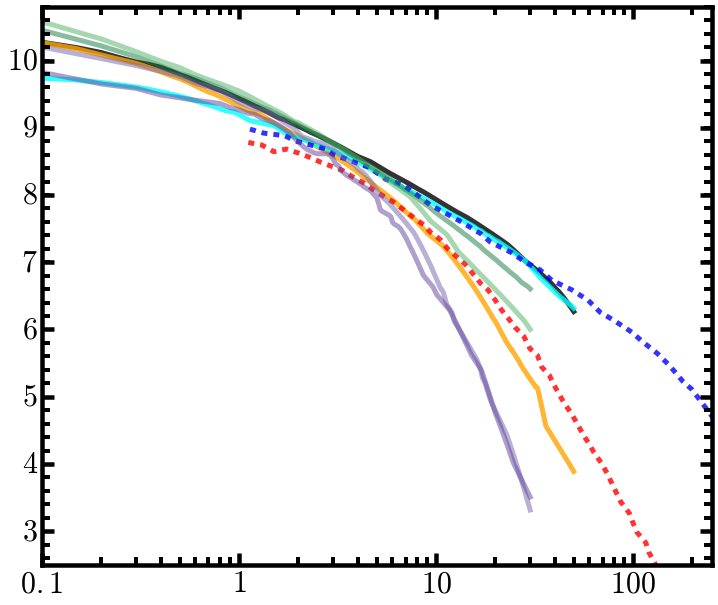

In [10]:
ax = plt.subplot(111)
ax.set_xscale("log", nonposy='clip')
ax = songPlotSetup(ax)

ax.plot(cgs_mprof_full['col1'], cgs_mprof_full['col2'], linestyle='-', c='k', 
        linewidth=5.0, alpha=0.8)
ax.plot(cgs_mprof_inner['col1'], cgs_mprof_inner['col2'], linestyle='-', c='orange',
        linewidth=5.0, alpha=0.8)
ax.plot(cgs_mprof_outer['col1'], cgs_mprof_outer['col2'], linestyle='-', c='cyan', 
        linewidth=5.0, alpha=0.8)

#ax.plot(10.0 ** cooper13_mprof_all['col1'], cooper13_mprof_all['col2'], 
#        linestyle='--', c='k')
ax.plot(10.0 ** cooper13_mprof_ins['col1'], cooper13_mprof_ins['col2'], 
        linestyle='--', c='r', linewidth=5.0, alpha=0.8)
ax.plot(10.0 ** cooper13_mprof_acc['col1'], cooper13_mprof_acc['col2'], 
        linestyle='--', c='b', linewidth=5.0, alpha=0.8)

#ax.plot(patel10_mprof['rkpc'], patel10_mprof['z0'], linestyle='-', c=GRN(0.9))
ax.plot(patel10_mprof['rkpc'], patel10_mprof['z1'], linestyle='-', c=GRN(0.8),
        linewidth=5.0, alpha=0.5)
#ax.plot(patel10_mprof['rkpc'], patel10_mprof['z2'], linestyle='-', c=GRN(0.7))
ax.plot(patel10_mprof['rkpc'], patel10_mprof['z3'], linestyle='-', c=GRN(0.6),
        linewidth=5.0, alpha=0.5)
#ax.plot(patel10_mprof['rkpc'], patel10_mprof['z4'], linestyle='-', c=PUR(0.6))
ax.plot(patel10_mprof['rkpc'], patel10_mprof['z5'], linestyle='-', c=PUR(0.7),
        linewidth=5.0, alpha=0.5)
ax.plot(patel10_mprof['rkpc'], patel10_mprof['z6'], linestyle='-', c=PUR(0.8),
        linewidth=5.0, alpha=0.5)

ax.set_xlim(0.1, 250.0)
ax.set_ylim(2.5, 10.8)

plt.show()

# Find and read in the catalogs

* Also update stellar masses at each aperture, and fix the K-corrections

In [14]:
# Location of the data
homeDir = os.getenv('HOME')
sbpDir = os.path.join(homeDir, 'astro4/massive/dr15b/sbp/')

# Location for figures
figDir = os.path.join(sbpDir, 'figure')
# Location for subsamples
sampleDir = os.path.join(sbpDir, 'catalog')

# The SED models 
# 'fsps1', 'fsps2', 'fsps3', 'fsps4', 'bc03a'
sedMod = 'bc03a'
# 'imgsub', 'img'
sbpType = 'imgsub'

# Catalog files for BCG and NonBCG
redbcgStr = 'dr1_redbcg_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'
nonbcgStr = 'dr1_nonbcg_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'
redmemStr = 'dr1_redmem_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'

redbcgFile = redbcgStr + '.fits' 
nonbcgFile = nonbcgStr + '.fits' 
redmemFile = redmemStr + '.fits'

# Output
redbcgPrep = redbcgFile.replace('.fits', '_prep.fits')
nonbcgPrep = nonbcgFile.replace('.fits', '_prep.fits')
redmemPrep = redmemFile.replace('.fits', '_prep.fits')

try:
    redbcgTab
except NameError:
    pass
else:
    del redbcgTab     
try:
    nonbcgTab
except NameError:
    pass
else:
    del nonbcgTab
    
# Location for the SBP summary file
redbcgDir = os.path.join(sbpDir, 'redbcg')
nonbcgDir = os.path.join(sbpDir, 'nonbcg')
redmemDir = os.path.join(sbpDir, 'redmem')

# Two summary catalogs
redbcgCat = os.path.join(sampleDir, redbcgFile)
nonbcgCat = os.path.join(sampleDir, nonbcgFile)
redmemCat = os.path.join(sampleDir, redmemFile)

prefix1 = 'redbcg'
prefix2 = 'nonbcg'
prefix3 = 'redmem'

# Find and read in the catalogs
if not os.path.isfile(redbcgCat):
    raise Exception("## Can not find catalog for redBCG galaxies: %s" % redbcgCat)
else: 
    redbcgTab = Table.read(redbcgCat, format='fits')

if not os.path.isfile(nonbcgCat):
    raise Exception("## Can not find catalog for nonBCG galaxies: %s" % nonbcgCat)
else: 
    nonbcgTab = Table.read(nonbcgCat, format='fits')
    
if not os.path.isfile(redmemCat):
    raise Exception("## Can not find catalog for redmem galaxies: %s" % redmemCat)
else: 
    redmemTab = Table.read(redmemCat, format='fits')
    
print("## Deal with %i galaxies in redBCG sample" % len(redbcgTab))
print("## Deal with %i galaxies in nonBCG sample" % len(nonbcgTab))
print("## Deal with %i galaxies in redMem sample" % len(redmemTab))

# For redBCG sample
redbcgTab = updateMass(redbcgTab, m2l='LOGM2L_I_OBS')
redbcgTab = updateKcorrect(redbcgTab, zCol='z_use', magType='mag_cmodel')

# For nonBCG sample
nonbcgTab = updateMass(nonbcgTab, m2l='LOGM2L_I_OBS')
nonbcgTab = updateKcorrect(nonbcgTab, zCol='z_use', magType='mag_cmodel')

# For redMem sample
redmemTab = updateMass(redmemTab, m2l='LOGM2L_I_OBS')
redmemTab = updateKcorrect(redmemTab, zCol='z_use', magType='mag_cmodel')

# Save the results
redbcgTab.write(os.path.join(sampleDir, redbcgPrep), format='fits', 
                overwrite=True)
nonbcgTab.write(os.path.join(sampleDir, nonbcgPrep), format='fits', 
                overwrite=True)
redmemTab.write(os.path.join(sampleDir, redmemPrep), format='fits', 
                overwrite=True)

## Deal with 300 galaxies in redBCG sample
## Deal with 11672 galaxies in nonBCG sample
## Deal with 1572 galaxies in redMem sample


/usr/local/lib/python2.7/site-packages/astropy/table/column.py:1095: MaskedArrayFutureWarning: setting an item on a masked array which has a shared mask will not copy the mask and also change the original mask array in the future.
Check the NumPy 1.11 release notes for more information.
  ma.MaskedArray.__setitem__(self, index, value)


In [16]:
redbcgLab1 = '$\lambda > 20;\ \mathrm{CEN}$'
redbcgLab2 = '$\lambda > 30;\ \mathrm{CEN}$'
nonbcgLab = '$\lambda \leq 20;\ \mathrm{CEN}$'
redmemLab = '$\lambda > 20;\ \mathrm{SAT}$'

## Remove the problematic objects 

In [17]:
redProblem1 = [3978, 7565, 8954, 11684, 7557, 8005, 10168, 13673, 14403, 16935, 17056, 
               21257, 22054, 22827, 23427, 24206, 35360, 58217, 78695]
redProblem2 = [5, 12, 14, 16, 26, 64, 87, 93, 100, 126, 127, 137, 159, 161, 165, 168, 
               182, 192, 201, 211, 214, 215, 221, 236, 256, 263, 266, 272, 277, 289, 
               297, 312, 321, 350, 363, 372]

redbcgCheck1 = copy.deepcopy(redbcgTab)

for ii in redProblem1:
    try:
        redbcgCheck1.remove_row(np.where(redbcgCheck1['redmapper_id'] == ii)[0][0])
    except Exception: 
        continue 
        
print("# %d redBCGs left" % len(redbcgCheck1))

redbcgCheck2 = copy.deepcopy(redbcgCheck1)

for jj in redProblem2:
    try:
        redbcgCheck2.remove_row(np.where(redbcgCheck2['index'] == jj)[0][0])
    except Exception: 
        continue 
        
print("# %d redBCGs left" % len(redbcgCheck2))

# 281 redBCGs left
# 256 redBCGs left


In [18]:
nonbcgProblem = Table.read(os.path.join(sampleDir, 'nonbcg_remove'), format='ascii')

nonbcgCheck = copy.deepcopy(nonbcgTab)

for ii in nonbcgProblem['ISEDFIT_ID']:
    try:
        nonbcgCheck.remove_row(np.where(nonbcgCheck['ISEDFIT_ID'] == ii)[0][0])
    except Exception: 
        continue 
        
print("# %d nonBCGs left" % len(nonbcgCheck))

# 11672 nonBCGs left


In [19]:
redbcgTab = copy.deepcopy(redbcgCheck2)
nonbcgTab = copy.deepcopy(nonbcgCheck)
print("# %d objects in redbcgTab" % len(redbcgTab))
print("# %d objects in nonbcgTab" % len(nonbcgTab))

# 256 objects in redbcgTab
# 11672 objects in nonbcgTab


# Quality control selection of the useful sample, and basic properties 

## Check the K-correction

/usr/local/lib/python2.7/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/usr/local/lib/python2.7/site-packages/numpy/ma/core.py:4144: UserWarning: Warning: converting a masked element to nan.
  warnings.warn("Warning: converting a masked element to nan.")


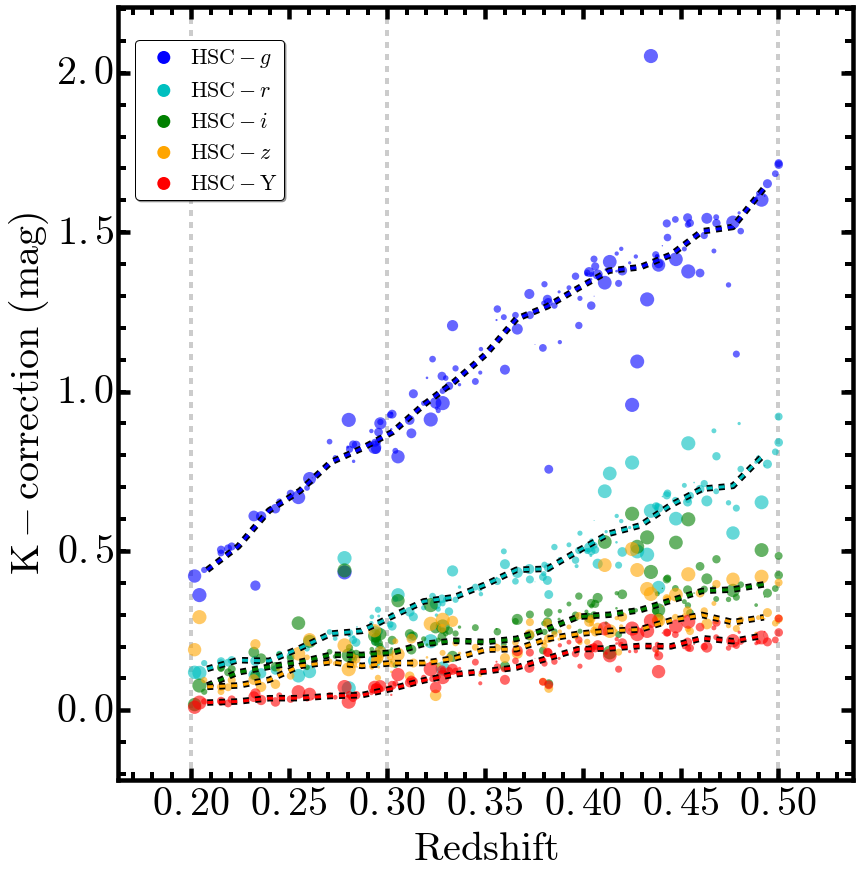

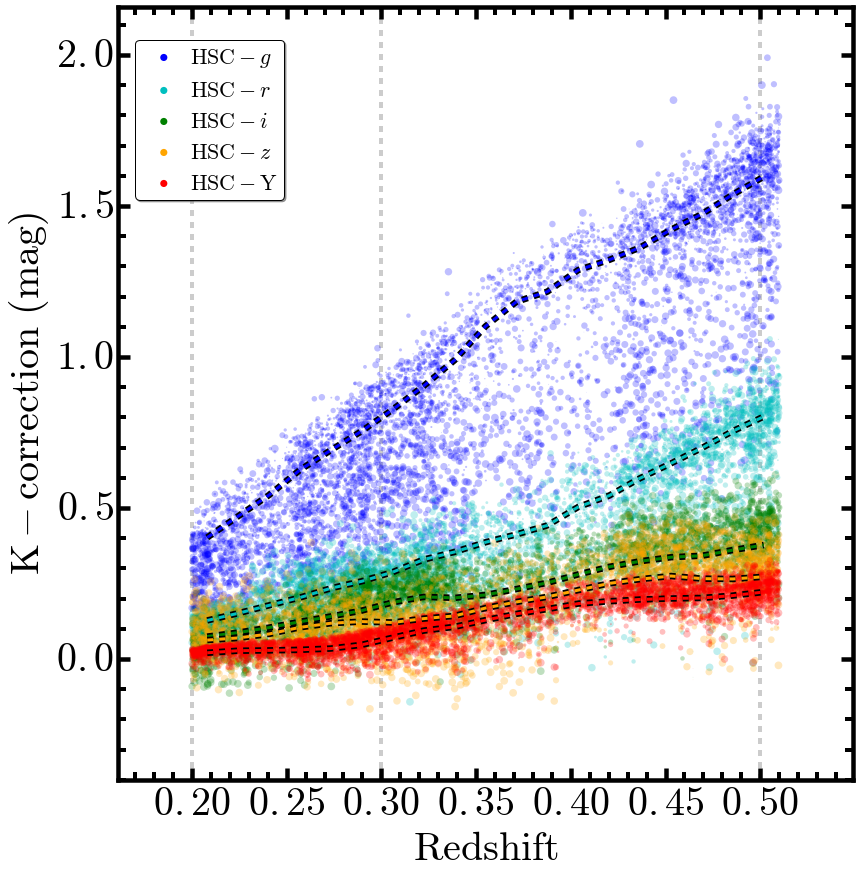

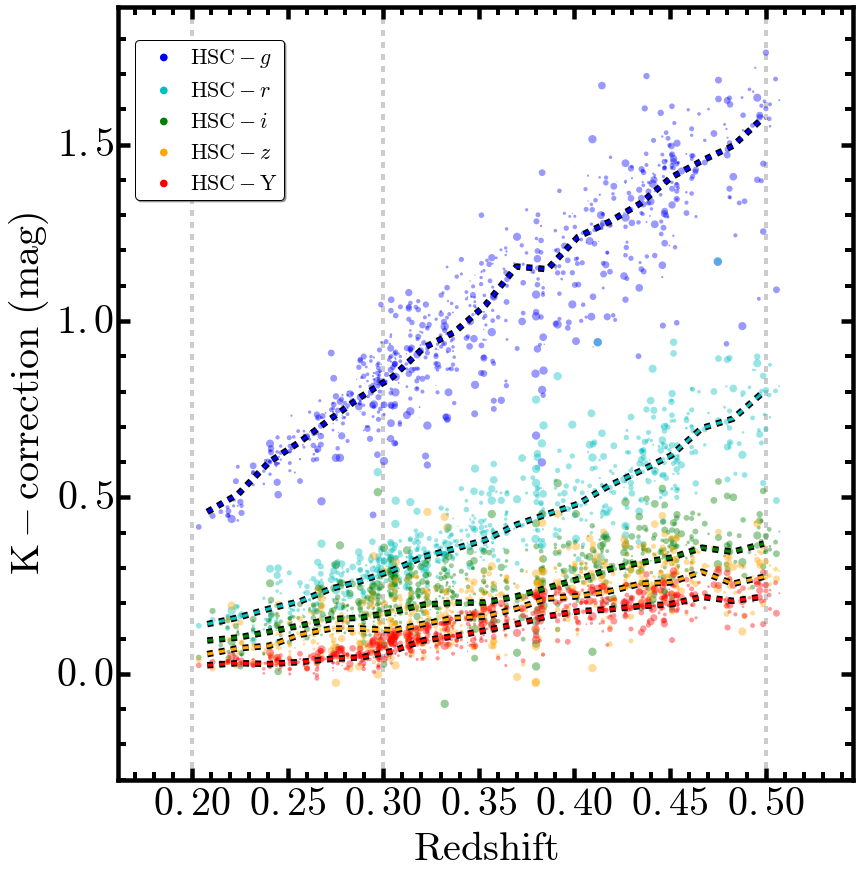

In [20]:
plotKcorrection(redbcgTab, alphaUse=0.60, sizeUse=200, 
                outDir=figDir, catStr=redbcgStr, 
                xtickFormat='$\mathbf{%4.2f}$', ytickFormat='$\mathbf{%3.1f}$')

plotKcorrection(nonbcgTab, alphaUse=0.25, sizeUse=60,
                outDir=figDir, catStr=nonbcgStr,
                xtickFormat='$\mathbf{%4.2f}$', ytickFormat='$\mathbf{%3.1f}$')

plotKcorrection(redmemTab, alphaUse=0.40, sizeUse=70,
                outDir=figDir, catStr=redmemStr,
                xtickFormat='$\mathbf{%4.2f}$', ytickFormat='$\mathbf{%3.1f}$')

## Mass Growth-Size Increasment cut plot

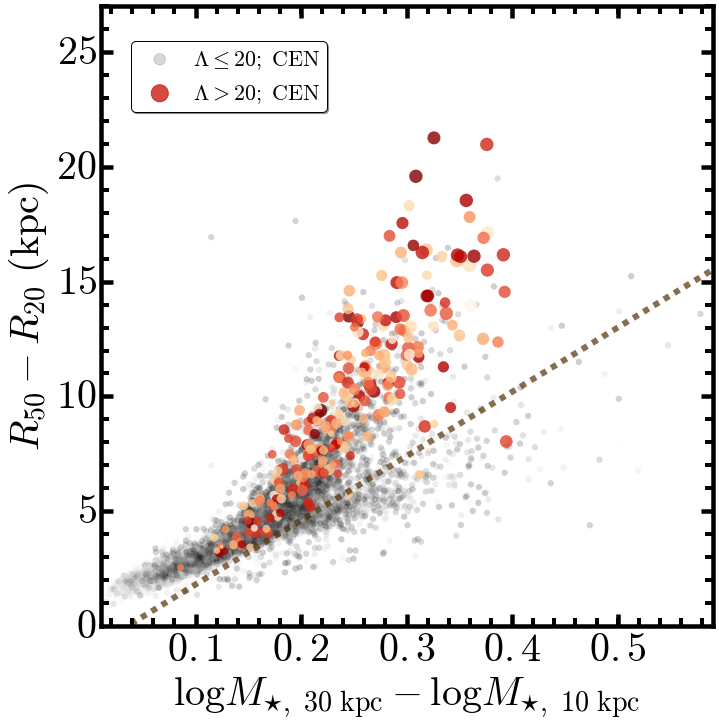

In [21]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.13, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM30 - logM10 v.s. r50 - r20
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40)

ax1.scatter((nonbcgTab['logm_30'] - nonbcgTab['logm_10']), 
            (nonbcgTab['r50_100'] - nonbcgTab['r20_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgTab['z_use'], 
                                 bottom=0.1), alpha=0.2)
ax1.scatter((redbcgTab['logm_30'] - redbcgTab['logm_10']), 
            (redbcgTab['r50_100'] - redbcgTab['r20_100']), 
            marker='o', edgecolor='none', cmap=ORG, 
            label=redbcgLab1,
            s=toSizeArr(redbcgTab['logm_100'], bottom=11.0, top=11.90, 
                        maxSize=180),
            c=toColorArr(redbcgTab['z_use'], bottom=0.1), alpha=0.8)

# X, Y Label
ax1.set_xlabel('$\log {M_{\star,\ 30\ \mathrm{kpc}}} - \log {M_{\star,\ 10\ \mathrm{kpc}}}$', 
               size=40)
ax1.set_ylabel('$R_{50} - R_{20}\ (\mathrm{kpc})$', size=40)

# X, Y limits
ax1.set_xlim(0.01, 0.59)
ax1.set_ylim(0.01, 27.0)

# Morphology Cut
xarr = np.arange(100) / 10.0 
yarr = 28.0 * xarr - 1.0 
ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.05, 0.83),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

fig.savefig(os.path.join(figDir, redbcgStr + '_logmdiff_rdiff.pdf'), dpi=150)

plt.show()

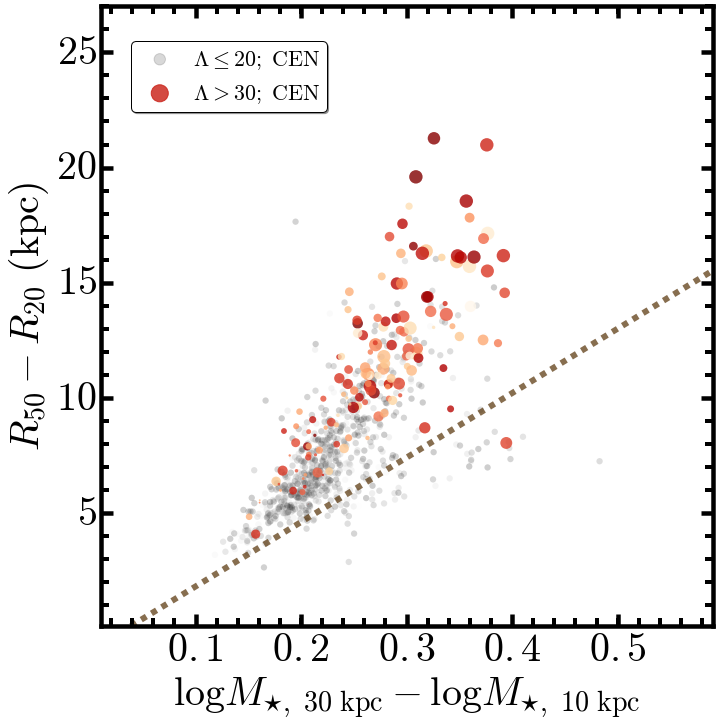

In [22]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.13, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

nonbcgTest = nonbcgTab[(nonbcgTab['z_use'] <= 0.5) & 
                       (nonbcgTab['z_use'] >= 0.2) &
                       (nonbcgTab['logm_100'] >= 11.50)]
redbcgTest = redbcgTab[(redbcgTab['z_use'] <= 0.5) & 
                       (redbcgTab['z_use'] >= 0.2) &
                       (redbcgTab['logm_100'] >= 11.50)]

# logM30 - logM10 v.s. r50 - r20
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40)

ax1.scatter((nonbcgTest['logm_30'] - nonbcgTest['logm_10']), 
            (nonbcgTest['r50_100'] - nonbcgTest['r20_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgTest['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgTest['logm_30'] - redbcgTest['logm_10']), 
            (redbcgTest['r50_100'] - redbcgTest['r20_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            label=redbcgLab2,
            s=toSizeArr(redbcgTest['logm_100'], bottom=11.0, top=11.90, 
                        maxSize=180),
            c=toColorArr(redbcgTest['z_use'], bottom=0.1), alpha=0.8)

# X, Y Label
ax1.set_xlabel('$\log {M_{\star,\ 30\ \mathrm{kpc}}} - \log {M_{\star,\ 10\ \mathrm{kpc}}}$', 
               size=40)
ax1.set_ylabel('$R_{50} - R_{20}\ (\mathrm{kpc})$', size=40)

# X, Y limits
ax1.set_xlim(0.01, 0.59)
ax1.set_ylim(0.1, 27.0)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.05, 0.83),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

# Morphology Cut
xarr = np.arange(100) / 10.0 
yarr = 28.0 * xarr - 1.0 
ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

fig.savefig(os.path.join(figDir, redbcgStr + '_logmdiff_rdiff_massive.pdf'), dpi=150)

plt.show()

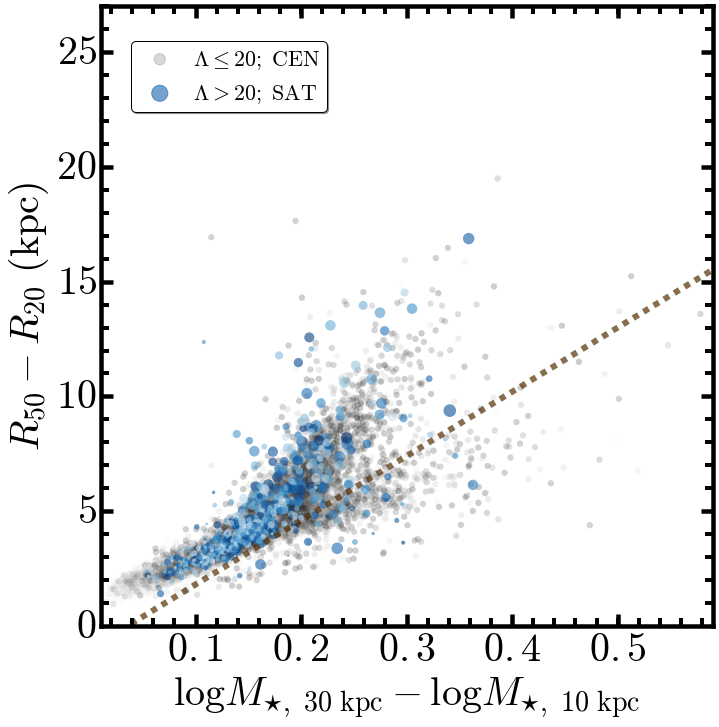

In [23]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.13, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM30 - logM10 v.s. r50 - r20
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40)

ax1.scatter((nonbcgTab['logm_30'] - nonbcgTab['logm_10']), 
            (nonbcgTab['r50_100'] - nonbcgTab['r20_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgTab['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redmemTab['logm_30'] - redmemTab['logm_10']), 
            (redmemTab['r50_100'] - redmemTab['r20_100']), 
            marker='o', edgecolor='none', cmap=BLU,
            label=redmemLab,
            s=toSizeArr(redmemTab['logm_100'], bottom=11.0, top=11.90, 
                        maxSize=160),
            c=toColorArr(redmemTab['z_use'], bottom=0.1), alpha=0.6)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log {M_{\star,\ 30\ \mathrm{kpc}}} - \log {M_{\star,\ 10\ \mathrm{kpc}}}$', 
               size=40)
ax1.set_ylabel('$R_{50} - R_{20}\ (\mathrm{kpc})$', size=40)

# X, Y limits
ax1.set_xlim(0.01, 0.59)
ax1.set_ylim(0.01, 27.0)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.05, 0.83),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(BLU(0.8))

# Morphology Cut
xarr = np.arange(100) / 10.0 
yarr = 28.0 * xarr - 1.0 
ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

fig.savefig(os.path.join(figDir, redmemStr + '_logmdiff_rdiff.pdf'), dpi=150)

plt.show()

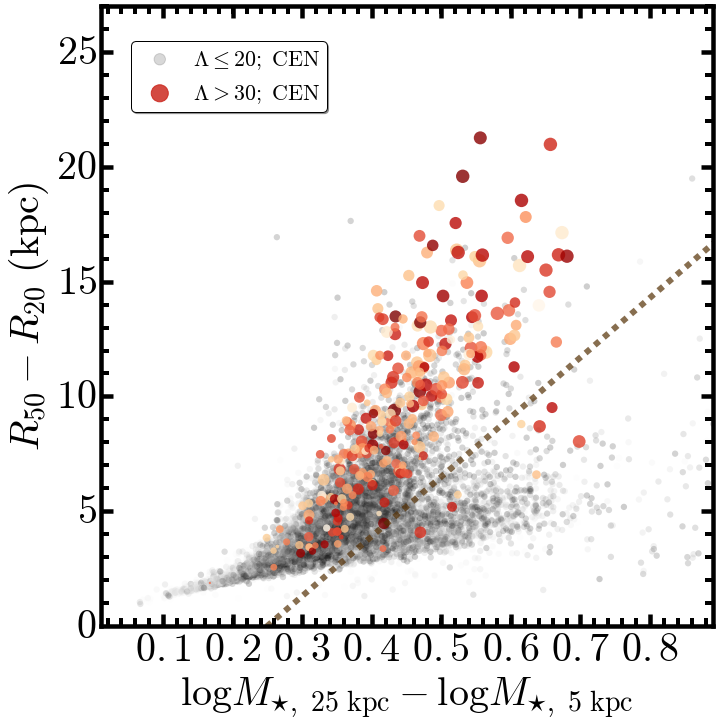

In [25]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.13, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM30 - logM10 v.s. r50 - r20
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40)

ax1.scatter((nonbcgTab['logm_25'] - nonbcgTab['logm_5']), 
            (nonbcgTab['r50_100'] - nonbcgTab['r20_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgTab['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgTab['logm_25'] - redbcgTab['logm_5']), 
            (redbcgTab['r50_100'] - redbcgTab['r20_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            label=redbcgLab2,
            s=toSizeArr(redbcgTab['logm_100'], bottom=11.0, top=11.90, 
                        maxSize=180),
            c=toColorArr(redbcgTab['z_use'], bottom=0.1), alpha=0.8)

# X, Y Label
ax1.set_xlabel('$\log {M_{\star,\ 25\ \mathrm{kpc}}} - \log {M_{\star,\ 5\ \mathrm{kpc}}}$', 
               size=40)
ax1.set_ylabel('$R_{50} - R_{20}\ (\mathrm{kpc})$', size=40)

# X, Y limits
ax1.set_xlim(0.01, 0.89)
ax1.set_ylim(0.01, 27.0)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.05, 0.83),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

# Morphology Cut
xarr = np.arange(100) / 10.0 
yarr = 26.0 * xarr - 6.5 
ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

fig.savefig(os.path.join(figDir, redbcgStr + '_logmdiff_rdiff_2.pdf'), dpi=150)

plt.show()

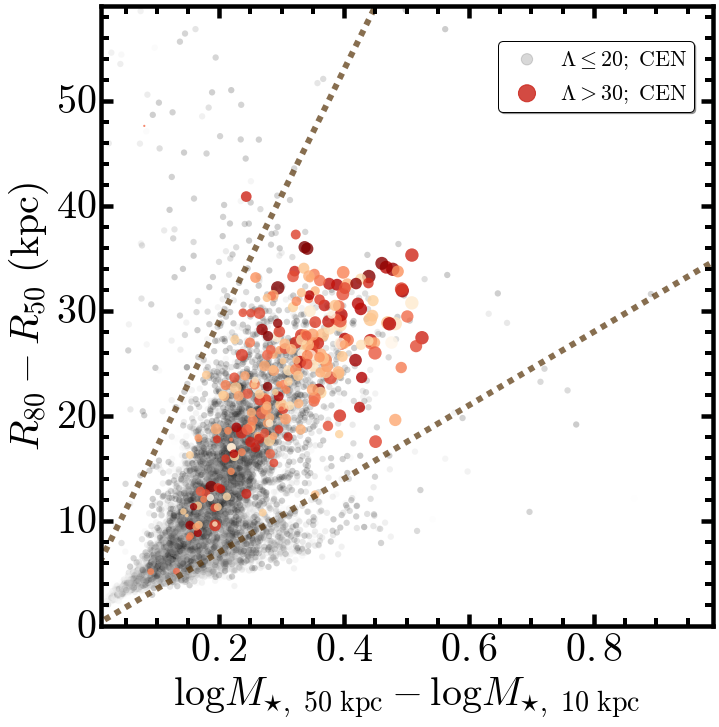

In [26]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.13, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM30 - logM10 v.s. r50 - r20
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40)

ax1.scatter((nonbcgTab['logm_50'] - nonbcgTab['logm_10']), 
            (nonbcgTab['r80_100'] - nonbcgTab['r50_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgTab['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgTab['logm_50'] - redbcgTab['logm_10']), 
            (redbcgTab['r80_100'] - redbcgTab['r50_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            label=redbcgLab2,
            s=toSizeArr(redbcgTab['logm_100'], bottom=11.0, top=11.90, 
                        maxSize=180),
            c=toColorArr(redbcgTab['z_use'], bottom=0.1), alpha=0.8)

# X, Y Label
ax1.set_xlabel('$\log {M_{\star,\ 50\ \mathrm{kpc}}} - \log {M_{\star,\ 10\ \mathrm{kpc}}}$', 
               size=40)
ax1.set_ylabel('$R_{80} - R_{50}\ (\mathrm{kpc})$', size=40)

# X, Y limits
ax1.set_xlim(0.01, 0.99)
ax1.set_ylim(0.01, 59.0)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.65, 0.83),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

# Morphology Cut
xarr = np.arange(100) / 10.0 
yarr = 35.0 * xarr + 0.0 
ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

xarr = np.arange(100) / 10.0 
yarr = 120.0 * xarr + 5.0
ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

fig.savefig(os.path.join(figDir, redbcgStr + '_logmdiff_rdiff_3.pdf'), dpi=150)

plt.show()

## Mass-Concentration index plot

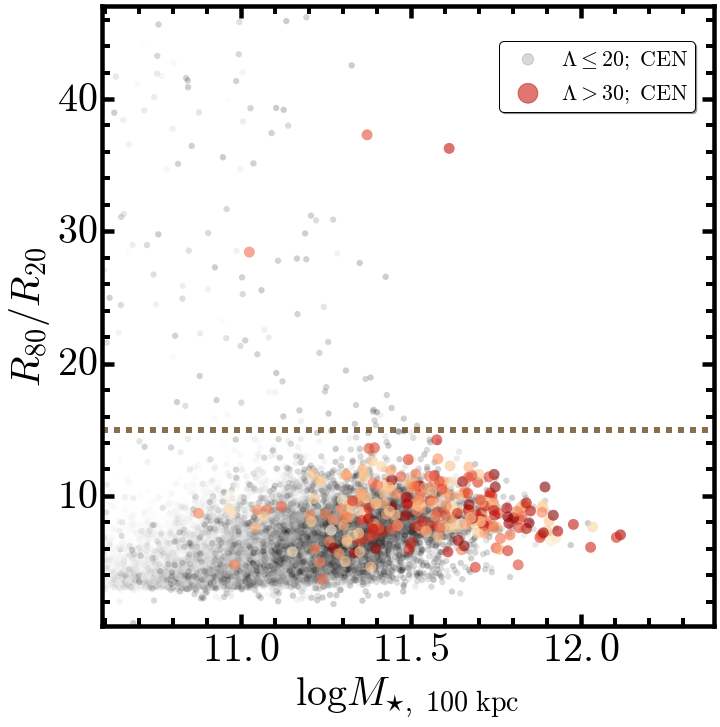

In [27]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.13, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40.0, ylabel=40.0, 
                    xtickFormat='$\mathbf{%4.1f}$')

ax1.scatter((nonbcgTab['logm_100']), 
            (nonbcgTab['c82_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgTab['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgTab['logm_100']), 
            (redbcgTab['c82_100']), 
            marker='o', edgecolor='none', cmap=ORG, s=120,
            label=redbcgLab2,
            c=toColorArr(redbcgTab['z_use'], bottom=0.1), alpha=0.6)

# X, Y Label
ax1.set_xlabel('$\log {M_{\star,\ 100\ \mathrm{kpc}}}$', 
               size=40)
ax1.set_ylabel('$R_{80} / R_{20}$', size=40)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.65, 0.83),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(0.2, 47.0)

# Concentration Cut
ax1.axhline(15.0, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_c82.pdf'), dpi=150)

plt.show()

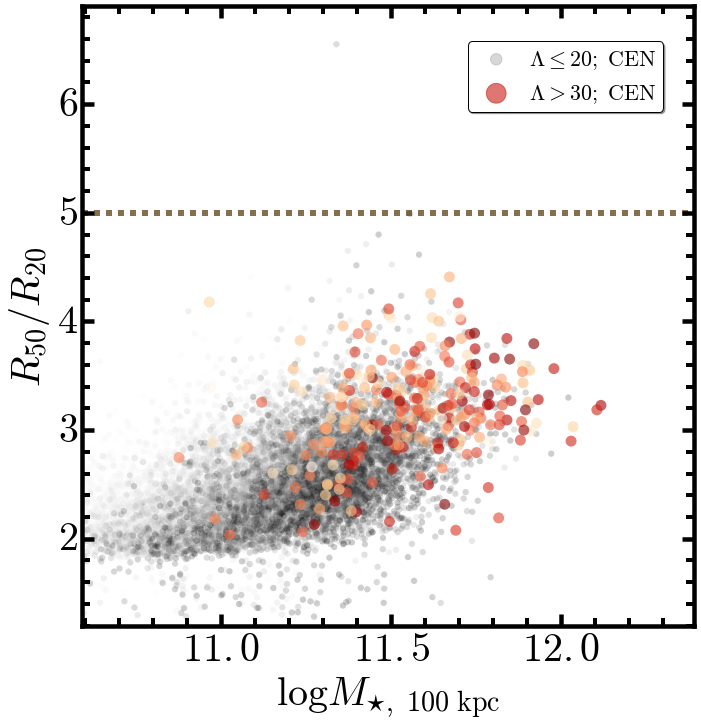

In [28]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.13, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40.0, ylabel=40.0,
                    xtickFormat='$\mathbf{%4.1f}$')

ax1.scatter((nonbcgTab['logm_100']), 
            (nonbcgTab['r50_100'] / nonbcgTab['r20_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgTab['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgTab['logm_100']), 
            (redbcgTab['r50_100'] / redbcgTab['r20_100']), 
            marker='o', edgecolor='none', cmap=ORG, s=120,
            label=redbcgLab2,
            c=toColorArr(redbcgTab['z_use'], bottom=0.1), alpha=0.6)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log {M_{\star,\ 100\ \mathrm{kpc}}}$', 
               size=40)
ax1.set_ylabel('$R_{50} / R_{20}$', size=40)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.63, 0.83),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(1.2, 6.9)

# Concentration Cut
ax1.axhline(5.0, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_c52.pdf'), dpi=150)

plt.show()

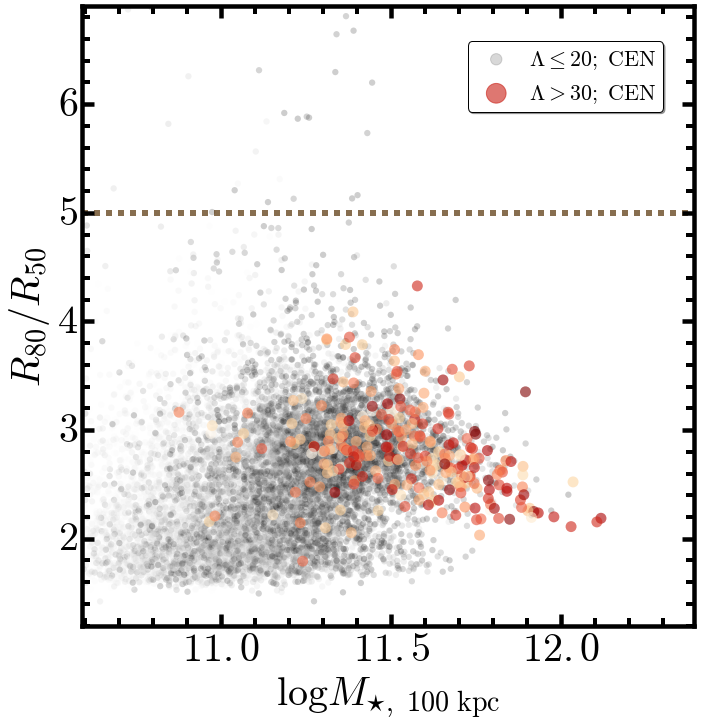

In [30]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.13, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM100 - C85
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40.0, ylabel=40.0,
                    xtickFormat='$\mathbf{%4.1f}$')

ax1.scatter((nonbcgTab['logm_100']), 
            (nonbcgTab['r80_100'] / nonbcgTab['r50_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgTab['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgTab['logm_100']), 
            (redbcgTab['r80_100'] / redbcgTab['r50_100']), 
            marker='o', edgecolor='none', cmap=ORG, s=120,
            label=redbcgLab2,
            c=toColorArr(redbcgTab['z_use'], bottom=0.1), alpha=0.6)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log {M_{\star,\ 100\ \mathrm{kpc}}}$', 
               size=40)
ax1.set_ylabel('$R_{80} / R_{50}$', size=40)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.63, 0.83),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(1.2, 6.9)

# Concentration Cut
ax1.axhline(5.0, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_c85.pdf'), dpi=150)

plt.show()

## Select the "Clean" samples

### Select the samples for the comparisons

* With reasonable stellar mass: $\log (M_{\star}/M_{\odot}) > 10.8$
* With reasonable R80: $\log (R_{80}/\mathrm{kpc}) < 1.9$
* With reasonable C82: $(R_{80}/R_{20}) < 15.0$
* Mass-Growth v.s. Size-Increasement cut: $(R_{50} - R_{20}) \leq 28.0 \times (\log M_{\star,30}-\log M_{\star,10}) - 1.0$
* For BCG: 
    - $\mathrm{P\_CEN\_1} > 0.7$
    
- Optional:
    * Color-cut: $1.4 \leq (g-z)_{K-\mathrm{correct}} \leq 2.0$

In [31]:
# Clean up the redBCG sample
redbcgClean = redbcgTab[(redbcgTab['logm_100'] >= 10.8) & 
                        (redbcgTab['c82_100'] >= 5.5) &
                        (redbcgTab['c82_100'] <= 15.0) &
                        (np.log10(redbcgTab['r80_100']) <= 1.9) &
                        ((redbcgTab['r50_100'] - redbcgTab['r20_100']) >= 
                        (28.0 * (redbcgTab['logm_30'] - redbcgTab['logm_10']) - 1.0)) &
                        ((redbcgTab['r80_100'] - redbcgTab['r50_100']) <= 
                        (120.0 * (redbcgTab['logm_50'] - redbcgTab['logm_10']) + 5.0)) &
                        (redbcgTab['p_cen_1_redm'] >= 0.7) &
                        (redbcgTab['ABSMAG_G'] - redbcgTab['ABSMAG_R'] >= 0.75) &
                        (redbcgTab['ABSMAG_G'] - redbcgTab['ABSMAG_R'] <= 0.98)]

print("# Clean redBCG sample: %d out of %d" % (len(redbcgClean), len(redbcgTab)))

# Clean up the redMem sample
redmemClean = redmemTab[(redmemTab['logm_100'] >= 10.8) & 
                        (redmemTab['c82_100'] >= 5.5) &
                        (redmemTab['c82_100'] <= 15.0) &
                        (np.log10(redmemTab['r80_100']) <= 1.9) &
                        ((redmemTab['r80_100'] - redmemTab['r50_100']) <= 
                        (120.0 * (redmemTab['logm_50'] - redmemTab['logm_10']) + 5.0)) &
                        ((redmemTab['r50_100'] - redmemTab['r20_100']) >= 
                        (28.0 * (redmemTab['logm_30'] - redmemTab['logm_10']) - 1.0))]

                        #(redmemTab['ABSMAG_G'] - redmemTab['ABSMAG_Z'] >= 1.4) &
                        #(redmemTab['ABSMAG_G'] - redmemTab['ABSMAG_Z'] <= 2.0) &

print("# Clean redMem sample: %d out of %d" % (len(redmemClean), len(redmemTab)))

# Clean up the nonBCG sample
nonbcgClean = nonbcgTab[(nonbcgTab['logm_100'] >= 10.8) & 
                        (nonbcgTab['c82_100'] >= 5.5) &
                        (nonbcgTab['c82_100'] <= 15.0) &
                        (np.log10(nonbcgTab['r80_100']) <= 1.9) &
                        ((nonbcgTab['r80_100'] - nonbcgTab['r50_100']) <= 
                        (120.0 * (nonbcgTab['logm_50'] - nonbcgTab['logm_10']) + 5.0)) &
                        ((nonbcgTab['r50_100'] - nonbcgTab['r20_100']) >= 
                        (28.0 * (nonbcgTab['logm_30'] - nonbcgTab['logm_10']) - 1.0))]

                        #(nonbcgTab['ABSMAG_G'] - nonbcgTab['ABSMAG_Z'] >= 1.4) &
                        #(nonbcgTab['ABSMAG_G'] - nonbcgTab['ABSMAG_Z'] <= 2.0) &

print("# Clean nonBCG sample: %d out of %d" % (len(nonbcgClean), len(nonbcgTab)))

# Save the clean catalogs
redbcgClean.write(os.path.join(sampleDir, redbcgFile.replace('.fits', '_clean.fits')), 
                  format='fits', overwrite=True)
nonbcgClean.write(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_clean.fits')), 
                  format='fits', overwrite=True)
redmemClean.write(os.path.join(sampleDir, redmemFile.replace('.fits', '_clean.fits')), 
                  format='fits', overwrite=True)

# Clean redBCG sample: 198 out of 256
# Clean redMem sample: 641 out of 1572
# Clean nonBCG sample: 5973 out of 11672


In [32]:
# The nonBCG samples to use
nonbcgUse = nonbcgClean[(nonbcgClean['z_use'] >= 0.20) &
                        (nonbcgClean['z_use'] <= 0.50)]
print("# nonBCG sample 1: %d" % len(nonbcgUse))

# The redMem samples to use
redmemUse = redmemClean[(redmemClean['z_use'] >= 0.20) &
                        (redmemClean['z_use'] <= 0.50)]
print("# redMem sample 1: %d" % len(redmemUse))

# The redBCG samples to use 
redbcgUse = redbcgClean[(redbcgClean['z_use'] >= 0.20) &
                        (redbcgClean['z_use'] <= 0.50) &
                        (redbcgClean['lambda_redm'] >= 25.0)]
print("# redBCG sample 1: %d" % len(redbcgUse))

# Save the clean catalogs
redbcgUse.write(os.path.join(sampleDir, redbcgFile.replace('.fits', '_use.fits')), 
                format='fits', overwrite=True)
nonbcgUse.write(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_use.fits')), 
                format='fits', overwrite=True)
redmemUse.write(os.path.join(sampleDir, redmemFile.replace('.fits', '_use.fits')), 
                format='fits', overwrite=True)

# nonBCG sample 1: 5611
# redMem sample 1: 633
# redBCG sample 1: 148


### Get the sample within the 3 GAMA fields.

In [33]:
# GAMA09
raG09 = [126.0, 143.0]
decG09 = [-2.0, 4.0]
redbcgG09 = redbcgUse[(redbcgUse['ra_hsc'] >= raG09[0]) & 
                      (redbcgUse['ra_hsc'] <= raG09[1]) &
                      (redbcgUse['dec_hsc'] >= decG09[0]) & 
                      (redbcgUse['dec_hsc'] <= decG09[1])]
nonbcgG09 = nonbcgUse[(nonbcgUse['ra_hsc'] >= raG09[0]) & 
                      (nonbcgUse['ra_hsc'] <= raG09[1]) &
                      (nonbcgUse['dec_hsc'] >= decG09[0]) & 
                      (nonbcgUse['dec_hsc'] <= decG09[1])]
print("G09: %d and %d" % (len(redbcgG09), len(nonbcgG09)))

# GAMA15
raG15 = [212.0, 224.0]
decG15 = [-3.0, 3.0]
redbcgG15 = redbcgUse[(redbcgUse['ra_hsc'] >= raG15[0]) & 
                      (redbcgUse['ra_hsc'] <= raG15[1]) &
                      (redbcgUse['dec_hsc'] >= decG15[0]) & 
                      (redbcgUse['dec_hsc'] <= decG15[1])]
nonbcgG15 = nonbcgUse[(nonbcgUse['ra_hsc'] >= raG15[0]) & 
                      (nonbcgUse['ra_hsc'] <= raG15[1]) &
                      (nonbcgUse['dec_hsc'] >= decG15[0]) & 
                      (nonbcgUse['dec_hsc'] <= decG15[1])]
print("G15: %d and %d" % (len(redbcgG15), len(nonbcgG15)))

# WIDE12
raW12 = [176.0, 184.0]
decW12 = [-3.0, 3.0]
redbcgW12 = redbcgUse[(redbcgUse['ra_hsc'] >= raW12[0]) & 
                      (redbcgUse['ra_hsc'] <= raW12[1]) &
                      (redbcgUse['dec_hsc'] >= decW12[0]) & 
                      (redbcgUse['dec_hsc'] <= decW12[1])]
nonbcgW12 = nonbcgUse[(nonbcgUse['ra_hsc'] >= raW12[0]) & 
                      (nonbcgUse['ra_hsc'] <= raW12[1]) &
                      (nonbcgUse['dec_hsc'] >= decW12[0]) & 
                      (nonbcgUse['dec_hsc'] <= decW12[1])]
print("W12: %d and %d" % (len(redbcgW12), len(nonbcgW12)))

G09: 36 and 932
G15: 22 and 1537
W12: 19 and 936


In [34]:
from astropy.table import vstack

redbcgGama = vstack([redbcgG09, redbcgG15, redbcgW12])
nonbcgGama = vstack([nonbcgG09, nonbcgG15, nonbcgW12])

print("In GAMA fields: %d and %d" % (len(redbcgGama), len(nonbcgGama)))

# Save the clean catalogs
redbcgGama.write(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gama.fits')), 
                 format='fits', overwrite=True)
nonbcgGama.write(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gama.fits')), 
                 format='fits', overwrite=True)

In GAMA fields: 77 and 3405


### Get the sample with spec-z from GAMA

In [35]:
redbcgGamaZ = redbcgUse[redbcgUse['z_gama'] >= 0.05]
nonbcgGamaZ = nonbcgUse[nonbcgUse['z_gama'] >= 0.05]

print("With GAMA spec-z: %d and %d" % (len(redbcgGamaZ), len(nonbcgGamaZ)))

# Save the clean catalogs
redbcgGamaZ.write(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gamaz.fits')), 
                  format='fits', overwrite=True)
nonbcgGamaZ.write(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gamaz.fits')), 
                  format='fits', overwrite=True)

/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:1: RuntimeWarning: invalid value encountered in greater_equal
  if __name__ == '__main__':
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:2: RuntimeWarning: invalid value encountered in greater_equal
  from ipykernel import kernelapp as app


With GAMA spec-z: 49 and 2245


## Load the saved catalogs if possible

In [13]:
# The CLEAN sample: 
redbcgClean = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_clean.fits')), 
                         format='fits')
nonbcgClean = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_clean.fits')), 
                         format='fits')
redmemClean = Table.read(os.path.join(sampleDir, redmemFile.replace('.fits', '_clean.fits')), 
                         format='fits')

# The USE samples: 
redbcgUse = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_use.fits')), 
                         format='fits')
nonbcgUse = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_use.fits')), 
                         format='fits')
redmemUse = Table.read(os.path.join(sampleDir, redmemFile.replace('.fits', '_use.fits')), 
                         format='fits')

# The GAMA sample
redbcgGama = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gama.fits')), 
                        format='fits')
nonbcgGama = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gama.fits')), 
                        format='fits')

redbcgGamaZ = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gamaz.fits')), 
                         format='fits')
nonbcgGamaZ = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gamaz.fits')), 
                         format='fits')

## Histogram of redshift, stellar mass, and color 

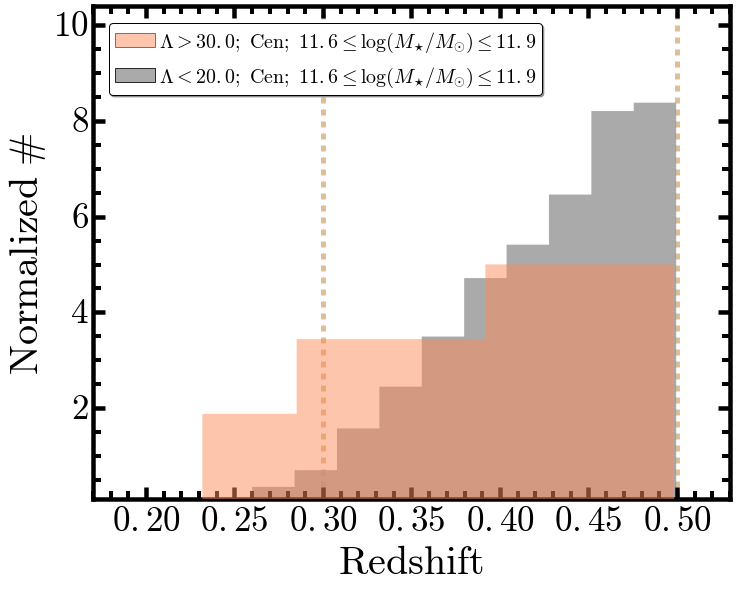

In [37]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 8))
fig.subplots_adjust(left=0.105, right=0.99, 
                    bottom=0.135, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=35, ylabel=35, xtickFormat='$\mathbf{%4.2f}$')

nonbcgBin = nonbcgUse[(nonbcgUse['logm_100'] >= 11.6) & 
                      (nonbcgUse['logm_100'] <= 11.9)]
redbcgBin = redbcgUse[(redbcgUse['logm_100'] >= 11.6) & 
                      (redbcgUse['logm_100'] <= 11.9)]

temp = hist(redbcgBin['z_use'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3, 
            label='$\lambda > 30.0;\ \mathrm{Cen};\ 11.6\leq \log(M_{\star}/M_{\odot}) \leq 11.9$')
#temp = hist(redbcgUse['z_use'], 
#            bins='knuth', histtype='step', 
#            alpha=0.7, color=ORG(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=1)
temp = hist(nonbcgBin['z_use'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=2, 
            label='$\lambda < 20.0;\ \mathrm{Cen};\ 11.6\leq \log(M_{\star}/M_{\odot}) \leq 11.9$')
#temp = hist(nonbcgUse['z_use'], 
#            bins='knuth', histtype='step', 
#            alpha=0.9, color=BLK(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=1)

ax1.set_xlim(0.17, 0.53)
ax1.set_ylim(0.1, 10.4)

ax1.axvline(0.30, linestyle='--', alpha=0.5, color=BROWN0, linewidth=5.0, zorder=0)
ax1.axvline(0.50, linestyle='--', alpha=0.5, color=BROWN0, linewidth=5.0, zorder=0)

ax1.set_xlabel('$\mathrm{Redshift}$', fontsize=40)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=40)

# Legend
ax1.legend(loc=(0.025, 0.82), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.2)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_redshift_hist.pdf'), dpi=150)

plt.show()

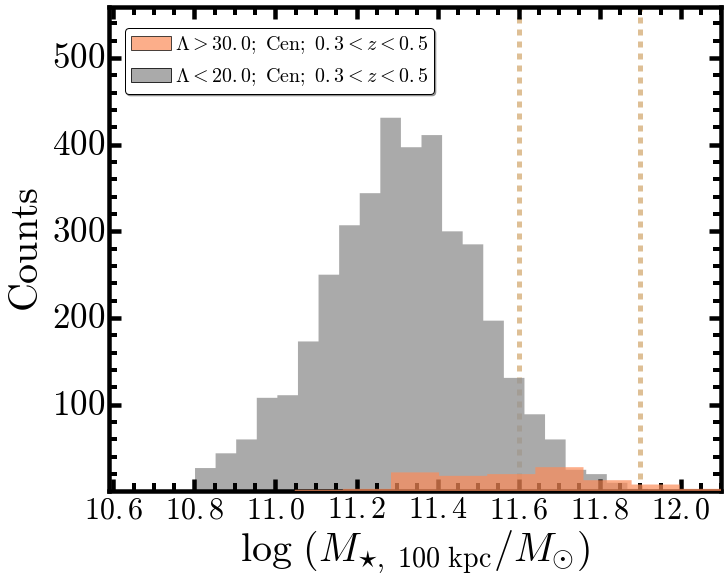

In [42]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 8))
fig.subplots_adjust(left=0.14, right=0.99, 
                    bottom=0.15, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=30, ylabel=35, xtickFormat='$\mathbf{%4.1f}$')

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

temp = hist(redbcgBin['logm_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.7, color=ORG(0.5), edgecolor='none',
            normed=False, ax=ax1, zorder=3, 
            label='$\lambda > 30.0;\ \mathrm{Cen};\ 0.3 < z < 0.5$')
#temp = hist(redbcgUse['logm_100'], 
#            bins='knuth', histtype='step', 
#            alpha=0.9, color=ORG(0.8), linewidth=6.0,
#            normed=False, ax=ax1, zorder=5)
temp = hist(nonbcgBin['logm_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=BLK(0.5), edgecolor='none',
            normed=False, ax=ax1, zorder=1,
            label='$\lambda < 20.0;\ \mathrm{Cen};\ 0.3 < z < 0.5$')
#temp = hist(nonbcgUse['logm_100'], 
#            bins='knuth', histtype='step', 
#            alpha=0.8, color=BLK(0.8), linewidth=6.0,
#            normed=False, ax=ax1, zorder=6)

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)

ax1.set_xlim(10.59, 12.1)
ax1.set_ylim(1.0, 559.0)

ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=40)
ax1.set_ylabel('$\mathrm{Counts}$', fontsize=40)

# Legend
ax1.legend(loc=(0.025, 0.82), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.2)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_hist.pdf'), dpi=150)

plt.show()

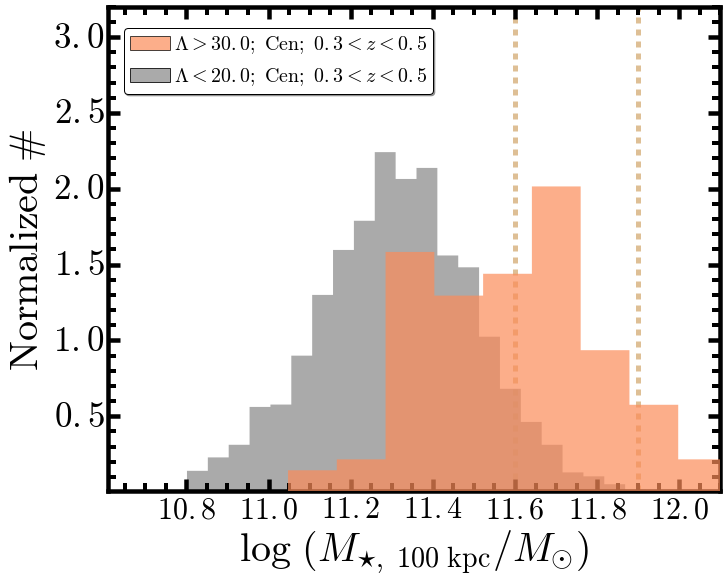

In [43]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 8))
fig.subplots_adjust(left=0.14, right=0.99, 
                    bottom=0.15, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=30, ylabel=35, 
                    xtickFormat='$\mathbf{%4.1f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

temp = hist(redbcgBin['logm_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.7, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3, 
            label='$\lambda > 30.0;\ \mathrm{Cen};\ 0.3 < z < 0.5$')
#temp = hist(redbcgUse['logm_100'], 
#            bins='knuth', histtype='step', 
#            alpha=0.9, color=ORG(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=5)
temp = hist(nonbcgBin['logm_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=1,
            label='$\lambda < 20.0;\ \mathrm{Cen};\ 0.3 < z < 0.5$')
#temp = hist(nonbcgUse['logm_100'], 
#            bins='knuth', histtype='step', 
#            alpha=0.8, color=BLK(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=6)

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)

ax1.set_xlim(10.61, 12.1)
ax1.set_ylim(0.01, 3.2)

ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=40)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=40)

# Legend
ax1.legend(loc=(0.025, 0.82), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.2)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_hist_norm.pdf'), dpi=150)

plt.show()

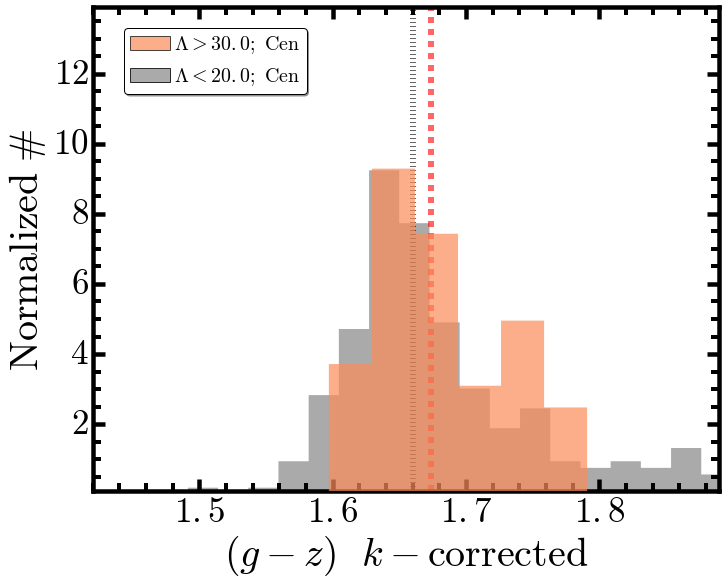

In [44]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 8))
fig.subplots_adjust(left=0.12, right=0.99, 
                    bottom=0.15, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=35, ylabel=35)

nonbcgBin = nonbcgUse[(nonbcgUse['logm_100'] >= 11.60) & 
                      (nonbcgUse['logm_100'] <= 11.90) & 
                      (nonbcgUse['z_use'] > 0.3) &
                      (nonbcgUse['z_use'] <= 0.5)]
redbcgBin = redbcgUse[(redbcgUse['logm_100'] >= 11.60) & 
                      (redbcgUse['logm_100'] <= 11.90) & 
                      (redbcgUse['z_use'] > 0.3) &
                      (redbcgUse['z_use'] <= 0.5)]

temp = hist(redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_Z'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.7, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3,
            label='$\lambda > 30.0;\ \mathrm{Cen}$')
#temp = hist(redbcgUse['ABSMAG_G'] - redbcgUse['ABSMAG_Z'], 
#            bins='knuth', histtype='step', 
#            alpha=0.9, color=ORG(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=5)
temp = hist(nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_Z'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=2,
            label='$\lambda < 20.0;\ \mathrm{Cen}$')
#temp = hist(nonbcgUse['ABSMAG_G'] - nonbcgUse['ABSMAG_Z'], 
#            bins='knuth', histtype='step', 
#            alpha=0.8, color=BLK(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=6)

ax1.set_xlim(1.42, 1.89)
ax1.set_ylim(0.1, 13.9)

ax1.axvline(np.nanmedian(redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_Z']), 
            linestyle='--', linewidth=6.0, color='r', alpha=0.6)
ax1.axvline(np.nanmedian(nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_Z']), 
            linestyle=':', linewidth=6.0, color='k', alpha=0.6)

ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=40)
ax1.set_xlabel('$(g-z)\  \ k-\mathrm{corrected}$', fontsize=40)

# Legend
ax1.legend(loc=(0.05, 0.82), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.2)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_gzKcor_hist.pdf'), dpi=200)

plt.show()

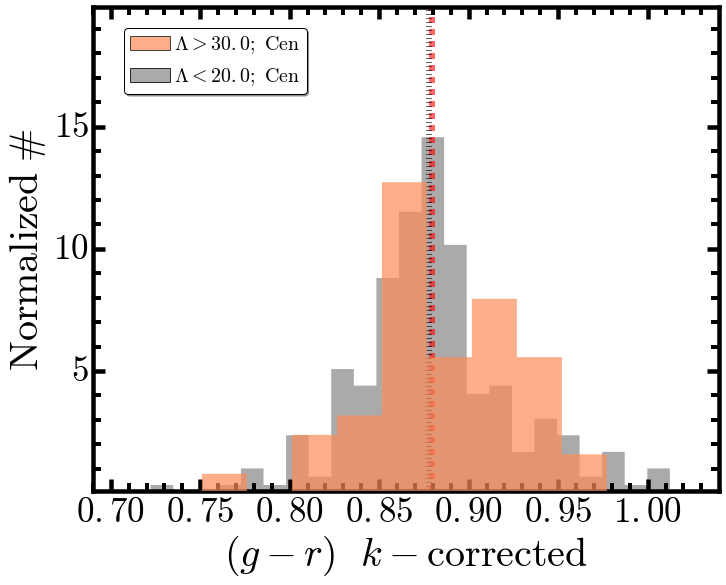

In [45]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 8))
fig.subplots_adjust(left=0.12, right=0.99, 
                    bottom=0.15, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=35, ylabel=35,
                    ytickFormat='$\mathbf{%d}$',
                    xtickFormat='$\mathbf{%4.2f}$')

nonbcgBin = nonbcgUse[(nonbcgUse['logm_100'] >= 11.60) & 
                      (nonbcgUse['logm_100'] <= 11.90) & 
                      (nonbcgUse['z_use'] > 0.3) &
                      (nonbcgUse['z_use'] <= 0.5)]
redbcgBin = redbcgUse[(redbcgUse['logm_100'] >= 11.60) & 
                      (redbcgUse['logm_100'] <= 11.90) & 
                      (redbcgUse['z_use'] > 0.3) &
                      (redbcgUse['z_use'] <= 0.5)]

temp = hist(redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_R'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.7, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3,
            label='$\lambda > 30.0;\ \mathrm{Cen}$')
#temp = hist(redbcgUse['ABSMAG_G'] - redbcgUse['ABSMAG_R'], 
#            bins='knuth', histtype='step', 
#            alpha=0.9, color=ORG(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=5)
temp = hist(nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_R'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=2,
            label='$\lambda < 20.0;\ \mathrm{Cen}$')
#temp = hist(nonbcgUse['ABSMAG_G'] - nonbcgUse['ABSMAG_R'], 
#            bins='knuth', histtype='step', 
#            alpha=0.8, color=BLK(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=6)

ax1.axvline(np.nanmedian(redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_R']), 
            linestyle='--', linewidth=6.0, color='r', alpha=0.6)
ax1.axvline(np.nanmedian(nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_R']), 
            linestyle=':', linewidth=6.0, color='k', alpha=0.6)

ax1.set_xlim(0.69, 1.04)
ax1.set_ylim(0.1, 19.9)

ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=40)
ax1.set_xlabel('$(g-r)\  \ k-\mathrm{corrected}$', fontsize=40)

# Legend
ax1.legend(loc=(0.05, 0.82), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.2)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_grKcor_hist.pdf'), dpi=200)

plt.show()

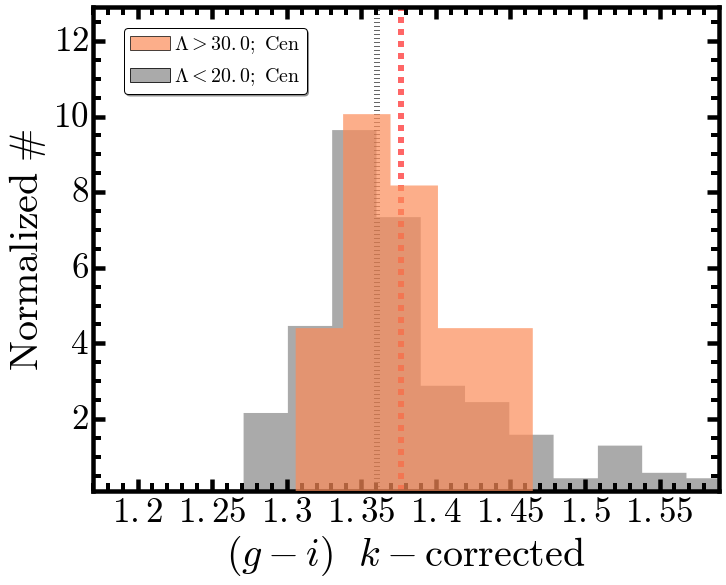

In [46]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 8))
fig.subplots_adjust(left=0.12, right=0.99, 
                    bottom=0.15, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=35, ylabel=35)

nonbcgBin = nonbcgUse[(nonbcgUse['logm_100'] >= 11.60) & 
                      (nonbcgUse['logm_100'] <= 11.90) & 
                      (nonbcgUse['z_use'] > 0.3) &
                      (nonbcgUse['z_use'] <= 0.5)]
redbcgBin = redbcgUse[(redbcgUse['logm_100'] >= 11.60) & 
                      (redbcgUse['logm_100'] <= 11.90) & 
                      (redbcgUse['z_use'] > 0.3) &
                      (redbcgUse['z_use'] <= 0.5)]

temp = hist(redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_I'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.7, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3,
            label='$\lambda > 30.0;\ \mathrm{Cen}$')
#temp = hist(redbcgUse['ABSMAG_G'] - redbcgUse['ABSMAG_I'], 
#            bins='knuth', histtype='step', 
#            alpha=0.9, color=ORG(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=5)
temp = hist(nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_I'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=2,
            label='$\lambda < 20.0;\ \mathrm{Cen}$')
#temp = hist(nonbcgUse['ABSMAG_G'] - nonbcgUse['ABSMAG_I'], 
#            bins='knuth', histtype='step', 
#            alpha=0.8, color=BLK(0.8), linewidth=6.0,
#            normed=True, ax=ax1, zorder=6)

ax1.set_xlim(1.17, 1.59)
ax1.set_ylim(0.1, 12.9)

ax1.axvline(np.nanmedian(redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_I']), 
            linestyle='--', linewidth=6.0, color='r', alpha=0.6)
ax1.axvline(np.nanmedian(nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_I']), 
            linestyle=':', linewidth=6.0, color='k', alpha=0.6)

ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=40)
ax1.set_xlabel('$(g-i)\  \ k-\mathrm{corrected}$', fontsize=40)

# Legend
ax1.legend(loc=(0.05, 0.82), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.2)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_giKcor_hist.pdf'), dpi=200)

plt.show()

## Plot the Mass - K-corrected Color relations

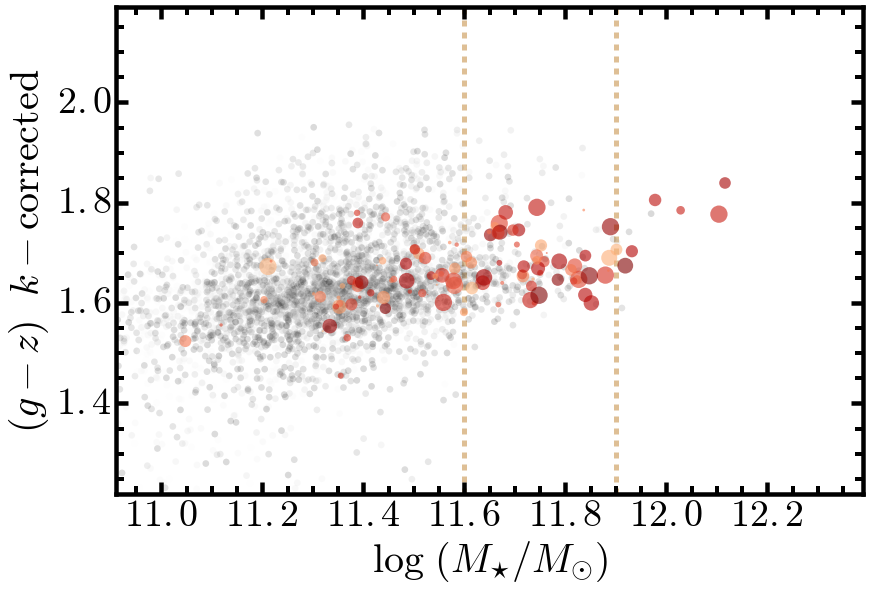

In [47]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(12, 8))
fig.subplots_adjust(left=0.13, right=0.995, 
                    bottom=0.15, top=0.995,
                    wspace=0.00, hspace=0.00)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM - (g-r) Color
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=38, ylabel=38, 
                    xtickFormat='$\mathrm{%4.1f}$', 
                    ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter(nonbcgBin['logm_100'], (nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=BLK, s=45,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.15)
ax1.scatter(redbcgBin['logm_100'], (redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=ORG, 
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60.0, 
                        maxSize=300),
            c=toColorArr(redbcgBin['z_use'], bottom=0.05), 
            alpha=0.6, vmin=-0.6)

ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})$', size=40)
ax1.set_ylabel('$(g-z)\ \ k-\mathrm{corrected}$', size=40)
ax1.set_xlim(10.91, 12.39)
ax1.set_ylim(1.22, 2.19)

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)
#ax1.axhline(1.9, linestyle='-', linewidth=5.0, alpha=0.3, c=BROWN0)
#ax1.axhline(1.5, linestyle='-', linewidth=5.0, alpha=0.3, c=BROWN0)

fig.savefig(os.path.join(figDir, redbcgStr + '_mass_gzKcor.pdf'), dpi=150)

plt.show()

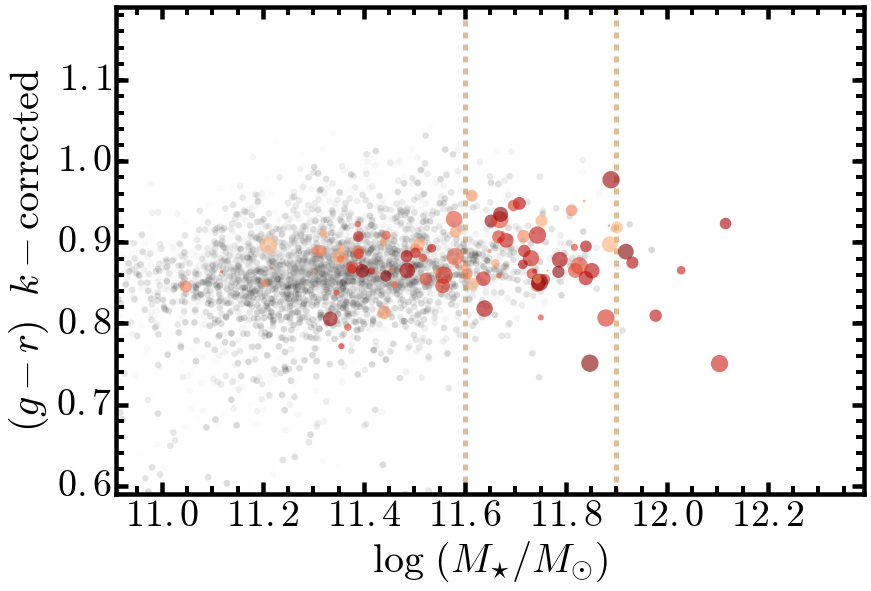

In [48]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(12, 8))
fig.subplots_adjust(left=0.13, right=0.995, 
                    bottom=0.15, top=0.995,
                    wspace=0.00, hspace=0.00)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM - (g-r) Color
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=38, ylabel=38, 
                    xtickFormat='$\mathrm{%4.1f}$', 
                    ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter(nonbcgBin['logm_100'], (nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_R']), 
            marker='o', edgecolor='none', cmap=BLK, s=45,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.15)
ax1.scatter(redbcgBin['logm_100'], (redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_R']), 
            marker='o', edgecolor='none', cmap=ORG, 
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=300),
            c=toColorArr(redbcgBin['z_use'], bottom=0.05), alpha=0.6,
            vmin=-0.6)

ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})$', size=40)
ax1.set_ylabel('$(g-r)\ \ k-\mathrm{corrected}$', size=40)
ax1.set_xlim(10.91, 12.39)
ax1.set_ylim(0.59, 1.19)

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)
#ax1.axhline(0.98, linestyle='-', linewidth=5.0, alpha=0.3, c=BROWN0)
#ax1.axhline(0.75, linestyle='-', linewidth=5.0, alpha=0.3, c=BROWN0)

fig.savefig(os.path.join(figDir, redbcgStr + '_mass_grKcor.pdf'), dpi=150)

plt.show()

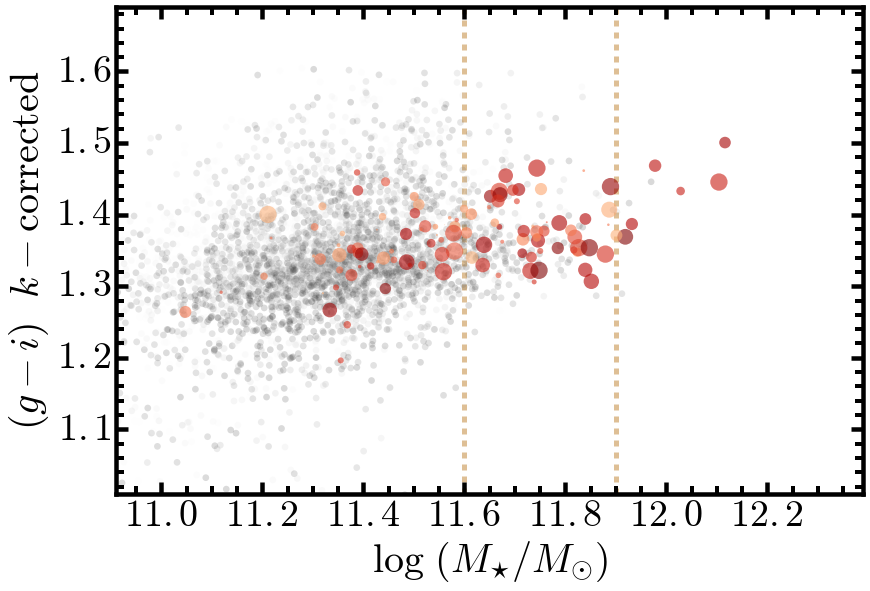

In [49]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(12, 8))
fig.subplots_adjust(left=0.13, right=0.995, 
                    bottom=0.15, top=0.995,
                    wspace=0.00, hspace=0.00)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM - (g-r) Color
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=38, ylabel=38, 
                    xtickFormat='$\mathrm{%4.1f}$', 
                    ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter(nonbcgBin['logm_100'], (nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_I']), 
            marker='o', edgecolor='none', cmap=BLK, s=45,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.15)
ax1.scatter(redbcgBin['logm_100'], (redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_I']), 
            marker='o', edgecolor='none', cmap=ORG, 
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=300),
            c=toColorArr(redbcgBin['z_use'], bottom=0.05), alpha=0.6, 
            vmin=-0.6)

ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})$', size=40)
ax1.set_ylabel('$(g-i)\ \ k-\mathrm{corrected}$', size=40)
ax1.set_xlim(10.91, 12.39)
ax1.set_ylim(1.01, 1.69)

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, 
            c=BROWN0, zorder=0)
#ax1.axhline(1.65, linestyle='-', linewidth=5.0, alpha=0.3, c=BROWN0)
#ax1.axhline(1.20, linestyle='-', linewidth=5.0, alpha=0.3, c=BROWN0)

fig.savefig(os.path.join(figDir, redbcgStr + '_mass_giKcor.pdf'), dpi=150)

plt.show()

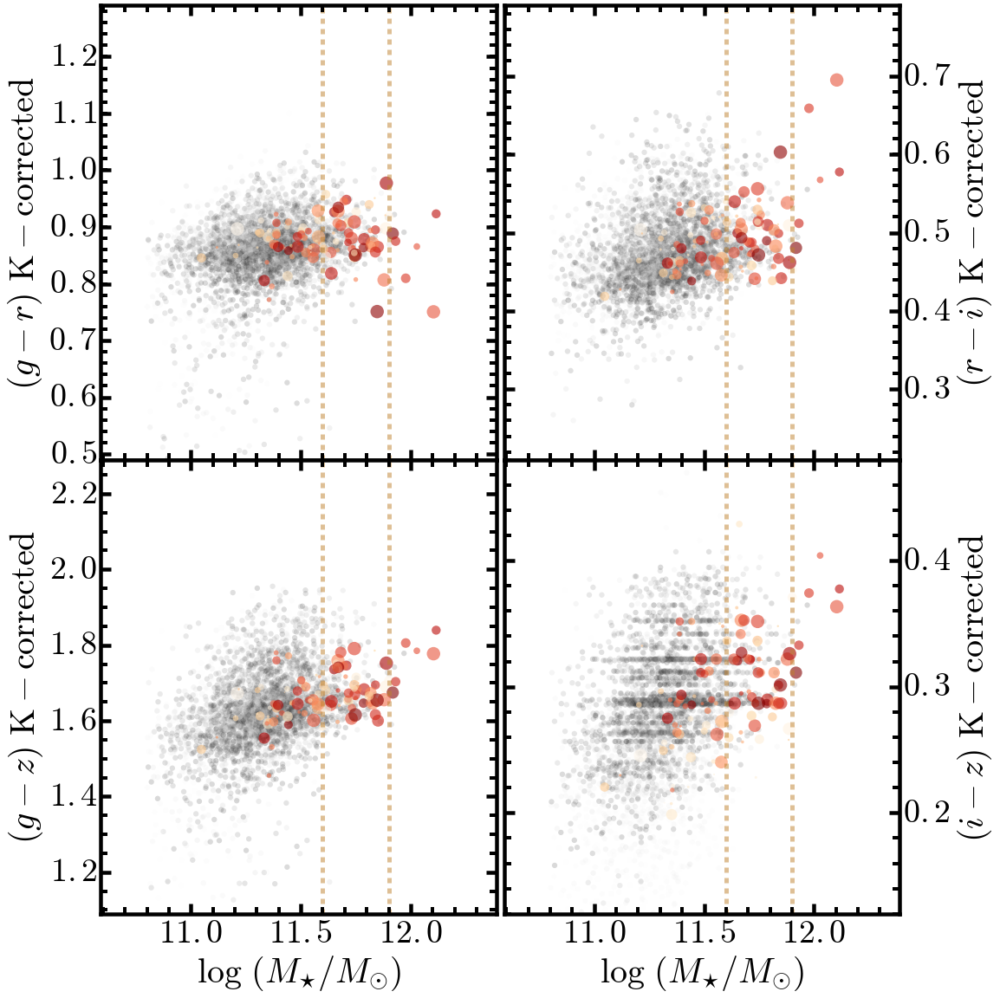

In [50]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(16, 16))
fig.subplots_adjust(left=0.10, right=0.90, 
                    bottom=0.08, top=0.99,
                    wspace=0.02, hspace=0.00)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM - (g-r) Color
ax1 = fig.add_subplot(221)
ax1 = songPlotSetup(ax1, xlabel=38, ylabel=38, 
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')
ax1.scatter(nonbcgBin['logm_100'], (nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_R']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.15)
ax1.scatter(redbcgBin['logm_100'], (redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_R']), 
            marker='o', edgecolor='none', cmap=ORG, 
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=240),
            c=toColorArr(redbcgBin['z_use'], bottom=0.1), alpha=0.6)
ax1.tick_params(axis='x', which='both', labelbottom='off')
ax1.set_ylabel('$(g-r)\ \mathrm{K-corrected}$', size=40)
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(0.49, 1.29)
ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)

# logM - (g-z) Color
ax2 = fig.add_subplot(223)
ax2 = songPlotSetup(ax2, xlabel=38, ylabel=38,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')
ax2.scatter(nonbcgBin['logm_100'], (nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.15)
ax2.scatter(redbcgBin['logm_100'], (redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=240),
            c=toColorArr(redbcgBin['z_use'], bottom=0.1), alpha=0.6)
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})$', size=40)
ax2.set_ylabel('$(g-z)\ \mathrm{K-corrected}$', size=40)
ax2.set_xlim(10.59, 12.39)
ax2.set_ylim(1.09, 2.29)
ax2.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)
ax2.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)

# logM - (r-z) Color
ax3 = fig.add_subplot(222)
ax3.yaxis.set_label_position("right")
ax3 = songPlotSetup(ax3, xlabel=38, ylabel=38,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')
ax3.scatter(nonbcgBin['logm_100'], (nonbcgBin['ABSMAG_R'] - nonbcgBin['ABSMAG_I']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.15)
ax3.scatter(redbcgBin['logm_100'], (redbcgBin['ABSMAG_R'] - redbcgBin['ABSMAG_I']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=240),
            c=toColorArr(redbcgBin['z_use'], bottom=0.1), alpha=0.6)
ax3.tick_params(axis='y', which='both', labelsize=30,
                labelleft='off', labelright='on')
ax3.set_ylabel('$(r-i)\ \mathrm{K-corrected}$', size=40)
ax3.xaxis.set_tick_params(labelsize=38)
ax3.yaxis.set_tick_params(labelsize=38)
ax3.set_xlim(10.59, 12.39)
ax3.set_ylim(0.21, 0.79)
ax3.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)
ax3.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)

# logM - (i-y) Color
ax4 = fig.add_subplot(224)
ax4.yaxis.set_label_position("right")
ax4 = songPlotSetup(ax4, xlabel=38, ylabel=38,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')
ax4.scatter(nonbcgBin['logm_100'], (nonbcgBin['ABSMAG_I'] - nonbcgBin['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.15)
ax4.scatter(redbcgBin['logm_100'], (redbcgBin['ABSMAG_I'] - redbcgBin['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=240),
            c=toColorArr(redbcgBin['z_use'], bottom=0.1), alpha=0.6)
ax4.tick_params(axis='y', which='both', labelsize=30,
                labelleft='off' , labelright='on')
ax4.set_xlabel('$\log\ (M_{\star}/M_{\odot})$', size=40)
ax4.set_ylabel('$(i-z)\ \mathrm{K-corrected}$', size=40)
ax4.xaxis.set_tick_params(labelsize=38)
ax4.yaxis.set_tick_params(labelsize=38)
ax4.set_xlim(10.59, 12.39)
ax4.set_ylim(0.21, 0.39)
ax4.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)
ax4.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)

fig.savefig(os.path.join(figDir, redbcgStr + '_mass_color.pdf'), dpi=150)

plt.show()

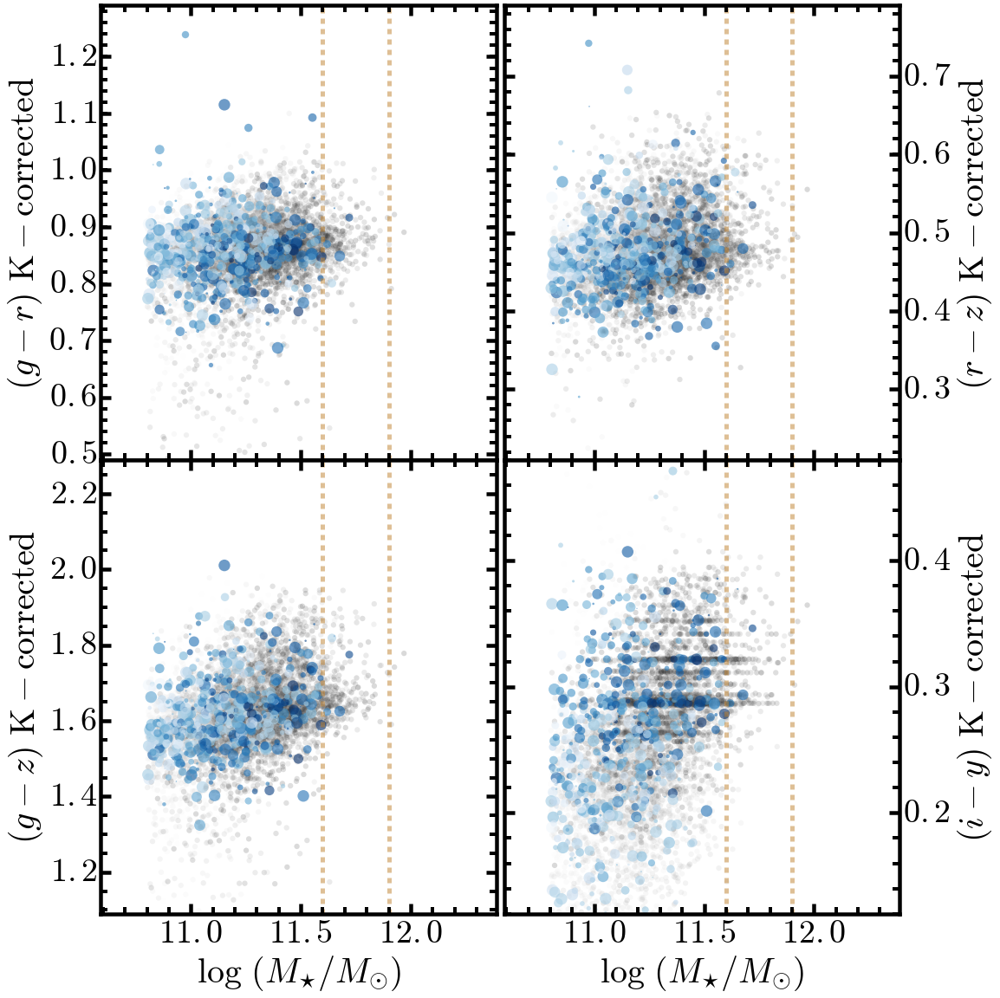

In [51]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(16, 16))
fig.subplots_adjust(left=0.10, right=0.90, 
                    bottom=0.08, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM - (g-r) Color
ax1 = fig.add_subplot(221)
ax1 = songPlotSetup(ax1, xlabel=38, ylabel=38,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')
ax1.scatter(nonbcgUse['logm_100'], (nonbcgUse['ABSMAG_G'] - nonbcgUse['ABSMAG_R']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgUse['z_use'], bottom=0.1), alpha=0.15)
ax1.scatter(redmemUse['logm_100'], (redmemUse['ABSMAG_G'] - redmemUse['ABSMAG_R']), 
            marker='o', edgecolor='none', cmap=BLU, 
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=180),
            c=toColorArr(redmemUse['z_use'], bottom=0.1), alpha=0.6)
ax1.tick_params(axis='x', which='both', labelbottom='off')
ax1.set_ylabel('$(g-r)\ \mathrm{K-corrected}$', size=40)
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(0.49, 1.29)
ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)

# logM - (g-z) Color
ax2 = fig.add_subplot(223)
ax2 = songPlotSetup(ax2, xlabel=38, ylabel=38,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')
ax2.scatter(nonbcgUse['logm_100'], (nonbcgUse['ABSMAG_G'] - nonbcgUse['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgUse['z_use'], bottom=0.1), alpha=0.15)
ax2.scatter(redmemUse['logm_100'], (redmemUse['ABSMAG_G'] - redmemUse['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=BLU,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=180),
            c=toColorArr(redmemUse['z_use'], bottom=0.1), alpha=0.6)
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})$', size=40)
ax2.set_ylabel('$(g-z)\ \mathrm{K-corrected}$', size=40)
ax2.set_xlim(10.59, 12.39)
ax2.set_ylim(1.09, 2.29)
ax2.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)
ax2.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)

# logM - (r-z) Color
ax3 = fig.add_subplot(222)
ax3.yaxis.set_label_position("right")
ax3 = songPlotSetup(ax3, xlabel=38, ylabel=38,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')
ax3.scatter(nonbcgUse['logm_100'], (nonbcgUse['ABSMAG_R'] - nonbcgUse['ABSMAG_I']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgUse['z_use'], bottom=0.1), alpha=0.15)
ax3.scatter(redmemUse['logm_100'], (redmemUse['ABSMAG_R'] - redmemUse['ABSMAG_I']), 
            marker='o', edgecolor='none', cmap=BLU,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=180),
            c=toColorArr(redmemUse['z_use'], bottom=0.1), alpha=0.6)
ax3.tick_params(axis='y', which='both', labelsize=30,
                labelleft='off', labelright='on')
ax3.set_ylabel('$(r-z)\ \mathrm{K-corrected}$', size=40)
ax3.xaxis.set_tick_params(labelsize=38)
ax3.yaxis.set_tick_params(labelsize=38)
ax3.set_xlim(10.59, 12.39)
ax3.set_ylim(0.21, 0.79)
ax3.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)
ax3.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)

# logM - (i-y) Color
ax4 = fig.add_subplot(224)
ax4.yaxis.set_label_position("right")
ax4 = songPlotSetup(ax4, xlabel=38, ylabel=38,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')
ax4.scatter(nonbcgUse['logm_100'], (nonbcgUse['ABSMAG_I'] - nonbcgUse['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgUse['z_use'], bottom=0.1), alpha=0.15)
ax4.scatter(redmemUse['logm_100'], (redmemUse['ABSMAG_I'] - redmemUse['ABSMAG_Z']), 
            marker='o', edgecolor='none', cmap=BLU,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5., top=60., 
                        maxSize=180),
            c=toColorArr(redmemUse['z_use'], bottom=0.1), alpha=0.6)
ax4.tick_params(axis='y', which='both', labelsize=30,
                labelleft='off' , labelright='on')
ax4.set_xlabel('$\log\ (M_{\star}/M_{\odot})$', size=40)
ax4.set_ylabel('$(i-y)\ \mathrm{K-corrected}$', size=40)
ax4.xaxis.set_tick_params(labelsize=38)
ax4.yaxis.set_tick_params(labelsize=38)
ax4.set_xlim(10.59, 12.39)
ax4.set_ylim(0.21, 0.39)
ax4.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)
ax4.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.5, c=BROWN0)

fig.savefig(os.path.join(figDir, redmemStr + '_mass_color.pdf'), dpi=150)

plt.show()

## Mass - R50 / R80 / R20 relation

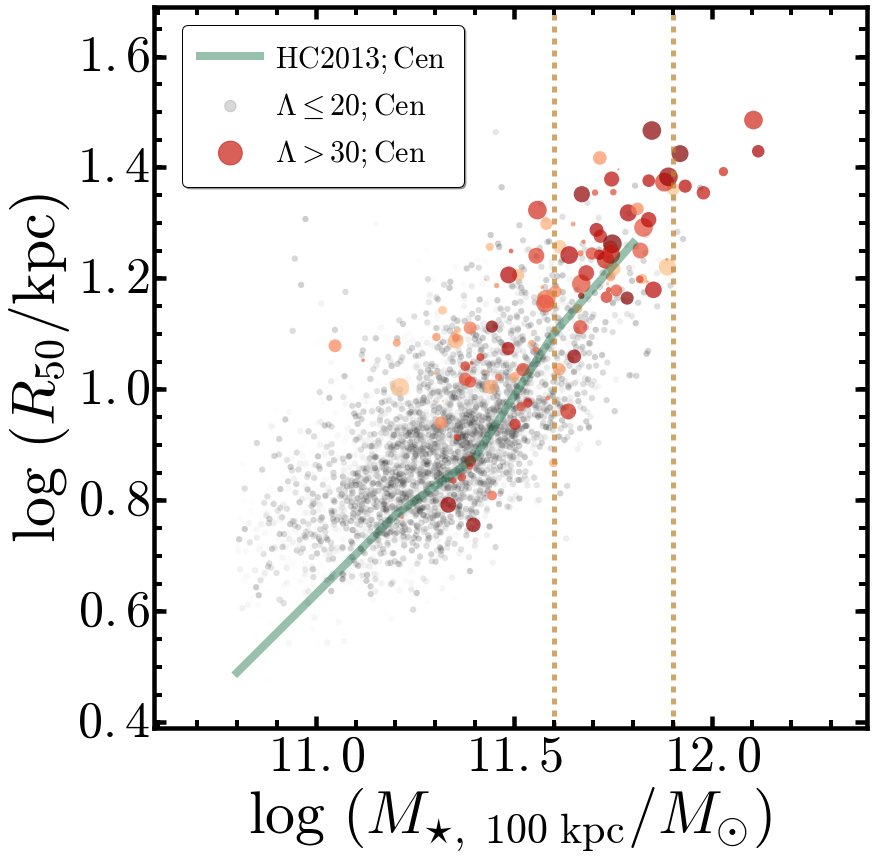

In [52]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.17, right=0.995, 
                    bottom=0.16, top=0.995,
                    wspace=0.00, hspace=0.00)

#-----------------------------------------------------------------#
#-----------------------------------------------------------------#
nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=50, ylabel=50,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter((nonbcgBin['logm_100']), 
            np.log10(nonbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), 
            alpha=0.2, label='$\lambda\leq 20; \mathrm{Cen}$')
ax1.scatter((redbcgBin['logm_100']), 
            np.log10(redbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=1.0, top=60.0, 
                        maxSize=350),
            c=toColorArr(redbcgBin['z_use']), vmin=-0.5,
            alpha=0.7, label='$\lambda> 30; \mathrm{Cen}$')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=60)
ax1.set_ylabel('$\log\ (R_{50} / \mathrm{kpc})$', size=60)

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(0.39, 1.69)

# Overplot Mass-Size relation from Huertas-Company+13: 
ax1.plot(logmC_hc13, logrC_hc13, linestyle='-', linewidth=8.0, alpha=0.4,
         c=GRN(0.9), label='$\mathrm{HC2013; Cen}$')
#ax1.plot(logmS_hc13, logrS_hc13, linestyle='--', linewidth=8.0, alpha=0.6,
#         c=PURPLE0)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.04, 0.75),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.8, borderpad=0.6, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(BLK(0.8))
legend.legendHandles[2].set_color(ORG(0.8))

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

#-----------------------------------------------------------------#
fig.savefig(os.path.join(figDir, 'mass_size_r50.pdf'), dpi=150)

plt.show()

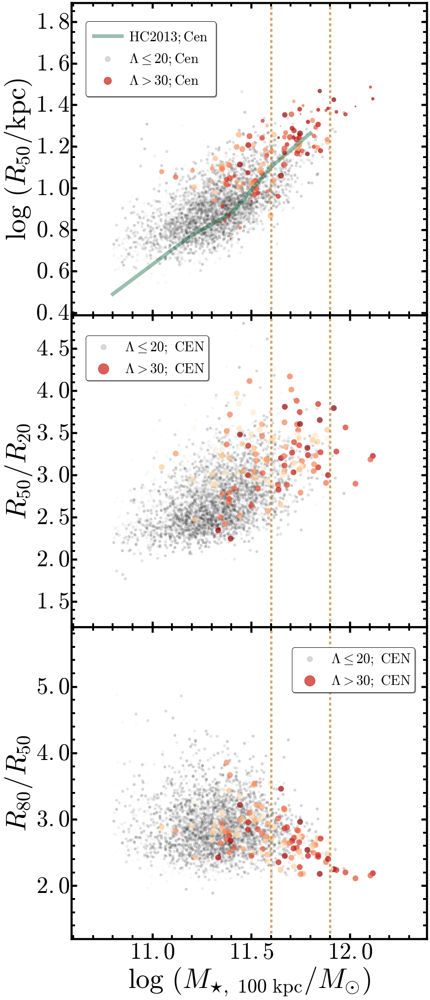

In [53]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(13, 30))
fig.subplots_adjust(left=0.17, right=0.99, 
                    bottom=0.06, top=0.995,
                    wspace=0.00, hspace=0.00)

#-----------------------------------------------------------------#
#-----------------------------------------------------------------#
nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM100 - C82
ax1 = fig.add_subplot(311)
ax1 = songPlotSetup(ax1, xlabel=50, ylabel=50,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter((nonbcgBin['logm_100']), 
            np.log10(nonbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), 
            alpha=0.2, label='$\lambda\leq 20; \mathrm{Cen}$')
ax1.scatter((redbcgBin['logm_100']), 
            np.log10(redbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgBin['c82_100'], bottom=3.0, top=10.0, 
                        maxSize=160),
            c=toColorArr(redbcgBin['z_use']), vmin=-0.5,
            alpha=0.7, label='$\lambda> 30; \mathrm{Cen}$')

# X, Y Label
#ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
#               size=40)
ax1.set_ylabel('$\log\ (R_{50} / \mathrm{kpc})$', size=60)
ax1.xaxis.set_major_formatter(NullFormatter())

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(0.39, 1.89)

# Overplot Mass-Size relation from Huertas-Company+13: 
ax1.plot(logmC_hc13, logrC_hc13, linestyle='-', linewidth=8.0, alpha=0.4,
         c=GRN(0.9), label='$\mathrm{HC2013; Cen}$')
#ax1.plot(logmS_hc13, logrS_hc13, linestyle='--', linewidth=8.0, alpha=0.6,
#         c=PURPLE0)

# Overplot Mass-Size relation from van der Wel+14
#ax1.plot(logM_arr, logR_etg_z1_vdW14, linestyle='-', linewidth=6.0, alpha=0.5,
#         c=BROWN1)
#ax1.plot(logM_arr, logR_ltg_z1_vdW14, linestyle='-', linewidth=6.0, alpha=0.5,
#         c=BLUE1)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.04, 0.70),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.8, borderpad=0.6, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(BLK(0.8))
legend.legendHandles[2].set_color(ORG(0.8))

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

#-----------------------------------------------------------------#
#-----------------------------------------------------------------#
# logM100 - C82
ax2 = fig.add_subplot(312)
ax2 = songPlotSetup(ax2, xlabel=50.0, ylabel=50.0,
                    xtickFormat='$\mathbf{%4.1f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

ax2.scatter((nonbcgBin['logm_100']), 
            (nonbcgBin['r50_100'] / nonbcgBin['r20_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.2)
ax2.scatter((redbcgBin['logm_100']), 
            (redbcgBin['r50_100'] / redbcgBin['r20_100']), 
            marker='o', edgecolor='none', cmap=ORG, s=160,
            label=redbcgLab2,
            c=toColorArr(redbcgBin['z_use'], bottom=0.1), alpha=0.7)
#ax2.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
#ax2.set_xlabel('$\log {M_{\star,\ 100\ \mathrm{kpc}}}$', 
#               size=40)
ax2.set_ylabel('$R_{50} / R_{20}$', size=60)
ax2.xaxis.set_major_formatter(NullFormatter())

# Legend
l_handles, l_labels = ax2.get_legend_handles_labels()
ax2.legend(l_handles, l_labels, loc=(0.04, 0.79),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax2.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

# X, Y limits
ax2.set_xlim(10.59, 12.39)
ax2.set_ylim(1.2, 4.9)

ax2.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax2.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

# Concentration Cut
#ax2.axhline(5.0, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

#-----------------------------------------------------------------#
#-----------------------------------------------------------------#
# logM100 - C85
ax3 = fig.add_subplot(313)
ax3 = songPlotSetup(ax3, xlabel=50.0, ylabel=50.0,
                    xtickFormat='$\mathbf{%4.1f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

ax3.scatter((nonbcgBin['logm_100']), 
            (nonbcgBin['r80_100'] / nonbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            label=nonbcgLab,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.2)
ax3.scatter((redbcgBin['logm_100']), 
            (redbcgBin['r80_100'] / redbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=ORG, s=160,
            label=redbcgLab2,
            c=toColorArr(redbcgBin['z_use'], bottom=0.1), alpha=0.7)
#ax3.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax3.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=60)
ax3.set_ylabel('$R_{80} / R_{50}$', size=60)

# Legend
l_handles, l_labels = ax3.get_legend_handles_labels()
ax3.legend(l_handles, l_labels, loc=(0.62, 0.79),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax3.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

# X, Y limits
ax3.set_xlim(10.59, 12.39)
ax3.set_ylim(1.2, 5.9)

ax3.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax3.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

# Concentration Cut
#ax3.axhline(5.0, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

#-----------------------------------------------------------------#
#-----------------------------------------------------------------#
fig.savefig(os.path.join(figDir, 'mass_size_concentration.pdf'), dpi=150)

plt.show()

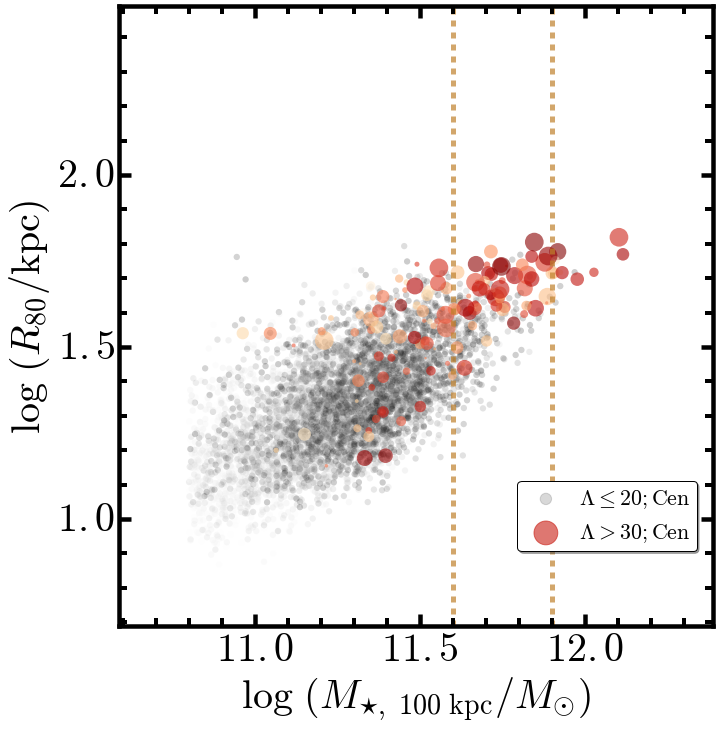

In [54]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.155, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter((nonbcgUse['logm_100']), 
            np.log10(nonbcgUse['r80_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgUse['z_use'], bottom=0.1), 
            alpha=0.2, label='$\lambda\leq 20; \mathrm{Cen}$')
ax1.scatter((redbcgUse['logm_100']), 
            np.log10(redbcgUse['r80_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgUse['lambda_redm'], bottom=1.0, top=60.0, 
                        maxSize=350),
            c=toColorArr(redbcgUse['z_use'], bottom=0.1), 
            alpha=0.6, label='$\lambda> 30; \mathrm{Cen}$')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=40)
ax1.set_ylabel('$\log\ (R_{80} / \mathrm{kpc})$', size=40)

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(0.69, 2.49)

# Morphology Cut
# xarr = np.arange(140) / 10.0 
# yarr = 0.85 * xarr - 7.95
# ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.67, 0.12),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_r80.pdf'), dpi=150)

plt.show()

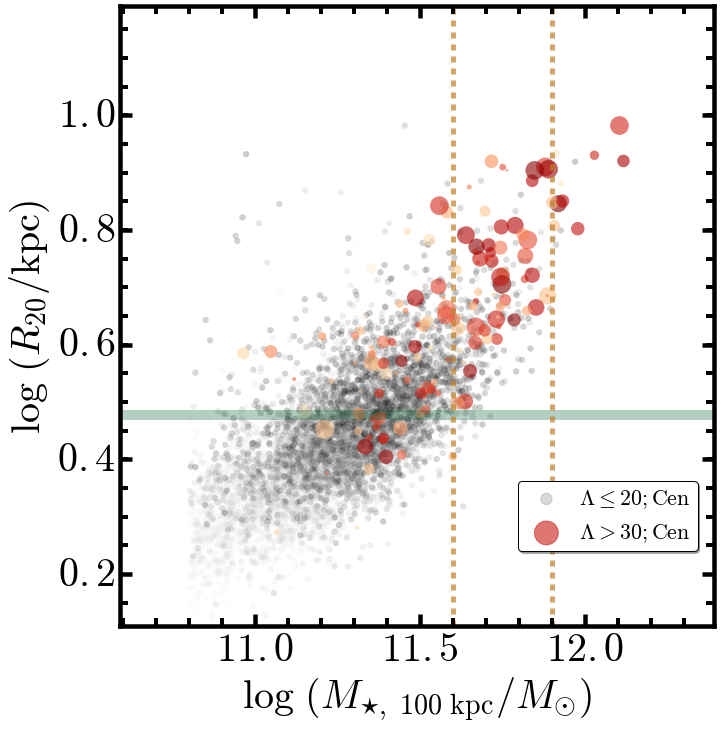

In [55]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.155, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter((nonbcgUse['logm_100']), 
            np.log10(nonbcgUse['r20_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgUse['z_use'], bottom=0.1), 
            alpha=0.2, label='$\lambda\leq 20; \mathrm{Cen}$')
ax1.scatter((redbcgUse['logm_100']), 
            np.log10(redbcgUse['r20_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgUse['lambda_redm'], bottom=1.0, top=60.0, 
                        maxSize=350),
            c=toColorArr(redbcgUse['z_use'], bottom=0.1), 
            alpha=0.6, label='$\lambda> 30; \mathrm{Cen}$')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=40)
ax1.set_ylabel('$\log\ (R_{20} / \mathrm{kpc})$', size=40)

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(0.11, 1.19)

ax1.axhline(np.log10(3.0), linestyle='-', linewidth=10, alpha=0.3, color=GRN(0.9))

# Morphology Cut
# xarr = np.arange(140) / 10.0 
# yarr = 0.85 * xarr - 7.95
# ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.67, 0.12),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_r20.pdf'), dpi=150)

plt.show()

## Plot the correlation with richness

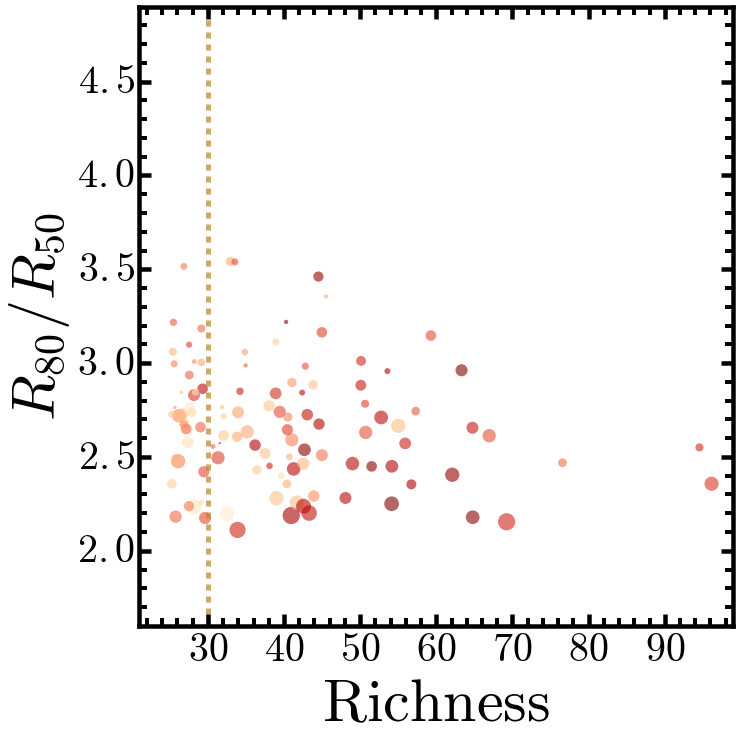

In [56]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.155, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40,
                    xtickFormat='$\mathrm{%d}$', 
                    ytickFormat='$\mathrm{%3.1f}$')

#ax1.scatter((nonbcgUse['lambda_redm']), 
#            np.log10(nonbcgUse['r20_100']), 
#            marker='o', edgecolor='none', cmap=BLK, s=40,
#            c=toColorArr(nonbcgUse['z_use'], bottom=0.1), 
#            alpha=0.2, label='$\lambda\leq 20; \mathrm{Cen}$')
ax1.scatter((redbcgUse['lambda_redm']), 
            (redbcgUse['r80_100'] / redbcgUse['r50_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgUse['logm_100'], bottom=11.4, top=12.2, 
                        maxSize=300),
            c=toColorArr(redbcgUse['z_use'], bottom=0.1), 
            alpha=0.6, label='$\lambda> 30; \mathrm{Cen}$')

# X, Y Label
ax1.set_xlabel('$\mathrm{Richness}$', size=60)
ax1.set_ylabel('$R_{80} / R_{50}$', size=60)

# X, Y limits
ax1.set_xlim(21, 99)
ax1.set_ylim(1.6, 4.9)

# Morphology Cut
# xarr = np.arange(140) / 10.0 
# yarr = 0.85 * xarr - 7.95
# ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

# Legend
#l_handles, l_labels = ax1.get_legend_handles_labels()
#ax1.legend(l_handles, l_labels, loc=(0.67, 0.12),
#           shadow=True, fancybox=True, 
#           numpoints=1, fontsize=22, scatterpoints=1, 
#           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
#legend = ax1.get_legend()
#legend.legendHandles[0].set_color(BLK(0.8))
#legend.legendHandles[1].set_color(ORG(0.8))

ax1.axvline(30.0, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

#fig.savefig(os.path.join(figDir, redbcgStr + '_logm_r20.pdf'), dpi=150)

plt.show()

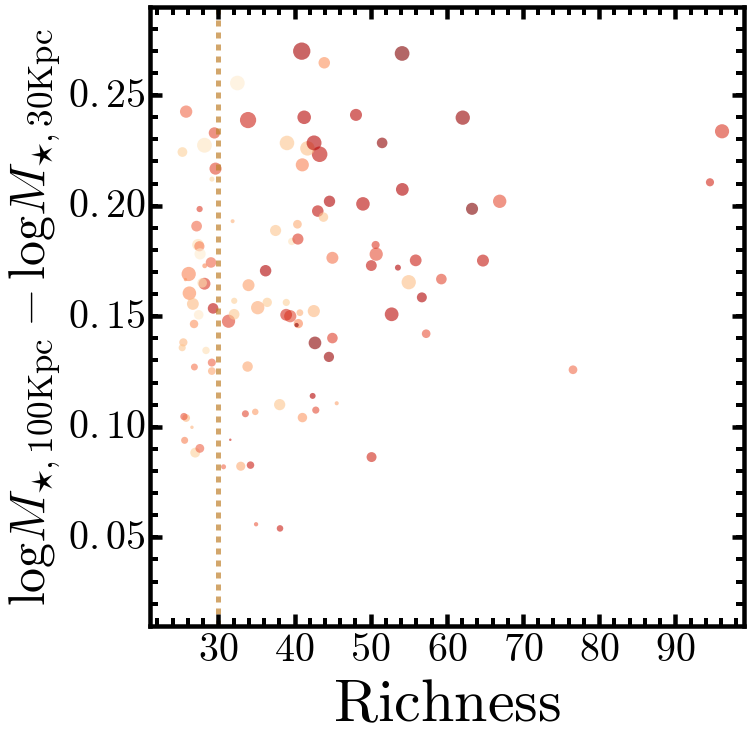

In [57]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.155, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40,
                    xtickFormat='$\mathrm{%d}$', 
                    ytickFormat='$\mathrm{%4.2f}$')

#ax1.scatter((nonbcgUse['lambda_redm']), 
#            np.log10(nonbcgUse['r20_100']), 
#            marker='o', edgecolor='none', cmap=BLK, s=40,
#            c=toColorArr(nonbcgUse['z_use'], bottom=0.1), 
#            alpha=0.2, label='$\lambda\leq 20; \mathrm{Cen}$')
ax1.scatter((redbcgUse['lambda_redm']), 
            (redbcgUse['logm_100'] - redbcgUse['logm_30']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgUse['logm_100'], bottom=11.4, top=12.2, 
                        maxSize=300),
            c=toColorArr(redbcgUse['z_use'], bottom=0.1), 
            alpha=0.6, label='$\lambda> 30; \mathrm{Cen}$')

# X, Y Label
ax1.set_xlabel('$\mathrm{Richness}$', size=60)
ax1.set_ylabel('$\log{M_{\star, {100\mathrm{kpc}}}} - \log{M_{\star, {30\mathrm{kpc}}}}$', size=50)

# X, Y limits
ax1.set_xlim(21, 99)
ax1.set_ylim(0.01, 0.29)

# Morphology Cut
# xarr = np.arange(140) / 10.0 
# yarr = 0.85 * xarr - 7.95
# ax1.plot(xarr, yarr, linestyle='--', linewidth=6.0, c=BROWN1, alpha=0.7)

# Legend
#l_handles, l_labels = ax1.get_legend_handles_labels()
#ax1.legend(l_handles, l_labels, loc=(0.67, 0.12),
#           shadow=True, fancybox=True, 
#           numpoints=1, fontsize=22, scatterpoints=1, 
#           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
#legend = ax1.get_legend()
#legend.legendHandles[0].set_color(BLK(0.8))
#legend.legendHandles[1].set_color(ORG(0.8))

ax1.axvline(30.0, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

#fig.savefig(os.path.join(figDir, redbcgStr + '_logm_r20.pdf'), dpi=150)

plt.show()

## Plot the Mass - Size Growth relation

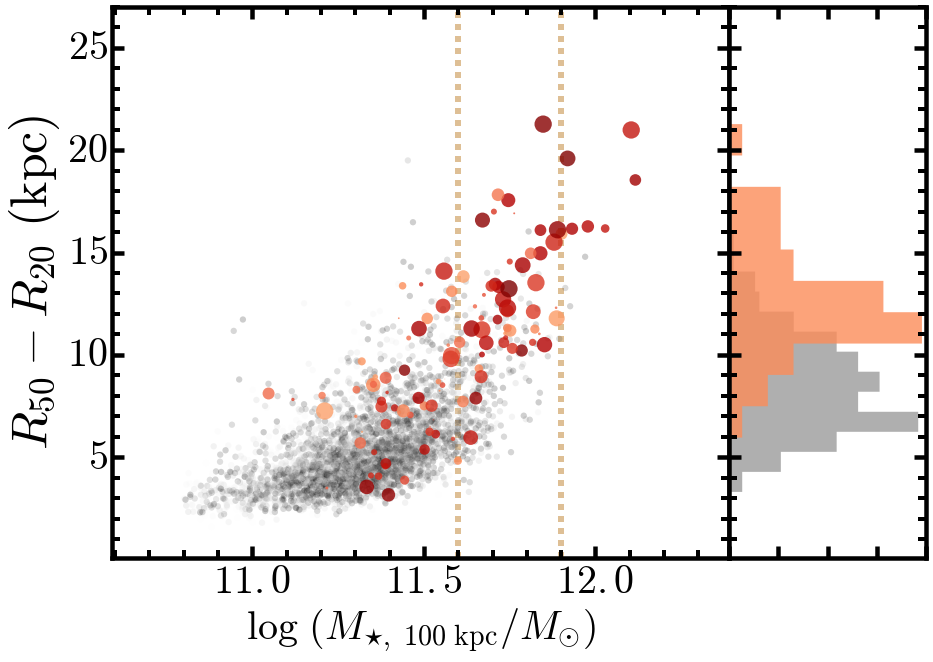

In [58]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(13, 9))
fig.subplots_adjust(left=0.09, right=0.98, 
                    bottom=0.14, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3d}$')
ax2 = songPlotSetup(ax2)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM30 - logM10 v.s. r50 - r20
ax1.scatter((nonbcgBin['logm_100']), 
            (nonbcgBin['r50_100'] - nonbcgBin['r20_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgBin['logm_100']), 
            (redbcgBin['r50_100'] - redbcgBin['r20_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=1.0, top=60.0, 
                        maxSize=300),
            c=toColorArr(redbcgBin['z_use'], bottom=0.2), 
            alpha=0.8, vmin=-0.6)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=40)
ax1.set_ylabel('$R_{50} - R_{20}\ (\mathrm{kpc})$', size=50)

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(0.1, 27.0)

# Mass limits 
ax1.axvline(11.6, linestyle='--', linewidth=6.0, zorder=0, c=BROWN0,
            alpha=0.5)
ax1.axvline(11.9, linestyle='--', linewidth=6.0, zorder=0, c=BROWN0,
            alpha=0.5)

#-----------------------------------------------------------------#

# Histogram
ax2.set_ylim(ax1.get_ylim())

nonbcgBin = nonbcgBin[(nonbcgBin['logm_100'] >= 11.6) & 
                      (nonbcgBin['logm_100'] <= 11.9)]
redbcgBin = redbcgBin[(redbcgBin['logm_100'] >= 11.6) & 
                      (redbcgBin['logm_100'] <= 11.9)]

temp = hist(redbcgBin['r50_100'] - redbcgBin['r20_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax2,
            orientation='horizontal', zorder=2)
temp = hist(nonbcgBin['r50_100'] - nonbcgBin['r20_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.6, color=BLK(0.6), edgecolor='none',
            normed=True, ax=ax2,
            orientation='horizontal', zorder=1)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

#ax2.set_xlim(0.1, 0.1)

#-----------------------------------------------------------------#

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_r50-20_noMatch.pdf'), dpi=150)

plt.show()

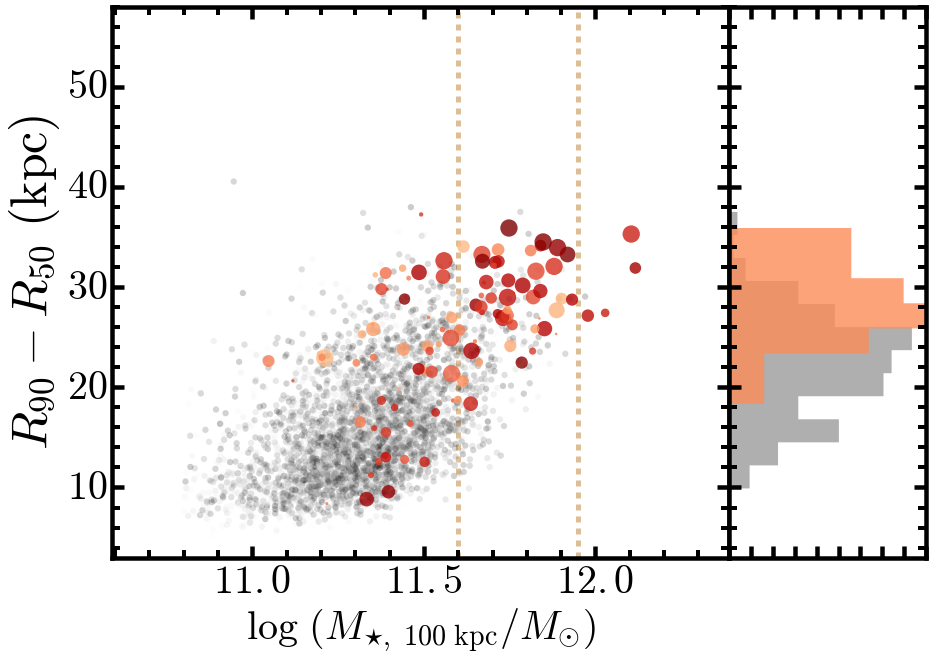

In [59]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(13, 9))
fig.subplots_adjust(left=0.09, right=0.98, 
                    bottom=0.14, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=40,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3d}$')
ax2 = songPlotSetup(ax2)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM30 - logM10 v.s. r50 - r20
ax1.scatter((nonbcgBin['logm_100']), 
            (nonbcgBin['r90_100'] - nonbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgBin['logm_100']), 
            (redbcgBin['r90_100'] - redbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=1.0, top=60.0, 
                        maxSize=300),
            c=toColorArr(redbcgBin['z_use']), 
            alpha=0.8, vmin=-0.6)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=40)
ax1.set_ylabel('$R_{90} - R_{50}\ (\mathrm{kpc})$', size=50)

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(3.0, 58.0)

# Mass limits 
ax1.axvline(11.6, linestyle='--', linewidth=5.0, zorder=0, c=BROWN0,
            alpha=0.5)
ax1.axvline(11.95, linestyle='--', linewidth=5.0, zorder=0, c=BROWN0,
            alpha=0.5)

#-----------------------------------------------------------------#

# Histogram
ax2.set_ylim(ax1.get_ylim())

nonbcgBin = nonbcgBin[(nonbcgBin['logm_100'] >= 11.6) & 
                      (nonbcgBin['logm_100'] <= 11.9)]
redbcgBin = redbcgBin[(redbcgBin['logm_100'] >= 11.6) & 
                      (redbcgBin['logm_100'] <= 11.9)]

temp = hist(redbcgBin['r90_100'] - redbcgBin['r50_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax2,
            orientation='horizontal', zorder=2)
temp = hist(nonbcgBin['r90_100'] - nonbcgBin['r50_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.6, color=BLK(0.6), edgecolor='none',
            normed=True, ax=ax2,
            orientation='horizontal', zorder=1)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

#-----------------------------------------------------------------#

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_r90-50_noMatch.pdf'), dpi=150)

plt.show()

# The stellar mass "function"

## Luminosity and Stellar mass differences 

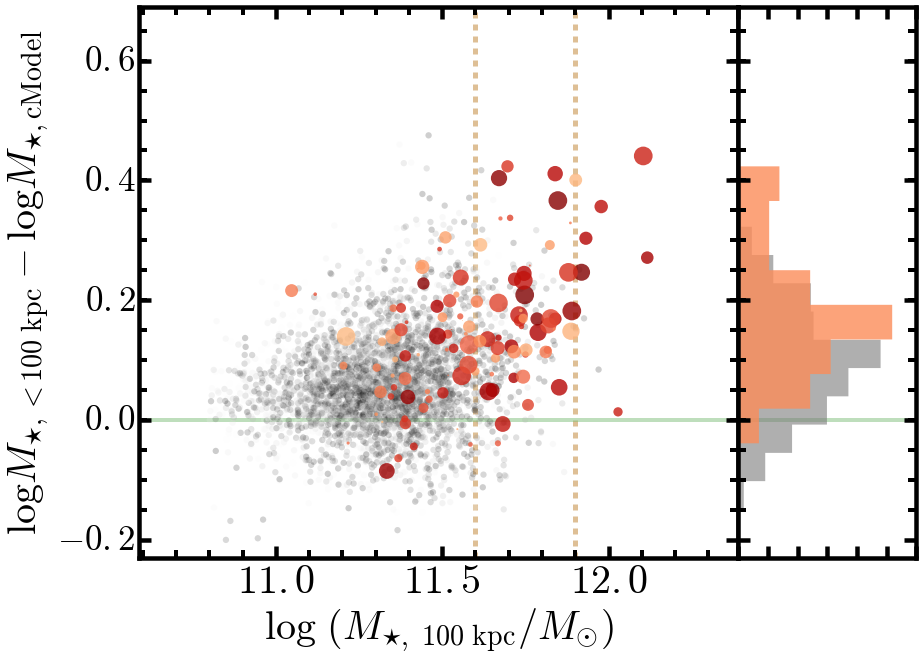

In [60]:
# definitions for the axes
left, width    = 0.16, 0.64
right          = left + width 
bottom, height = 0.14, 0.85
bottom_h = left_h = left + width + 0.02
recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.19, height]
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(13, 9))
fig.subplots_adjust(left=0.38, right=0.98, 
                    bottom=0.13, top=0.99,
                    wspace=0.02, hspace=0.00)
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=35,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%4.1f}$')
ax2 = songPlotSetup(ax2)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM30 - logM10 v.s. r50 - r20
ax1.scatter((nonbcgBin['logm_100']), 
            (nonbcgBin['logm_100'] - nonbcgBin['MSTAR']), 
            marker='o', edgecolor='none', cmap=BLK, s=40,
            c=toColorArr(nonbcgBin['z_use'], bottom=0.1), alpha=0.2)
ax1.scatter((redbcgBin['logm_100']), 
            (redbcgBin['logm_100'] - redbcgBin['MSTAR']), 
            marker='o', edgecolor='none', cmap=ORG,
            s=toSizeArr(redbcgBin['lambda_redm'], bottom=5.0, top=60.0, 
                        maxSize=350),
            c=toColorArr(redbcgBin['z_use']), alpha=0.8,
            vmin=-0.6)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=40)
ax1.set_ylabel('$\logM_{\star,<100\ \mathrm{kpc}}-\logM_{\star, \mathrm{cModel}}$', 
               size=40)

# X, Y limits
ax1.set_xlim(10.59, 12.39)
ax1.set_ylim(-0.23, 0.69)

# Mass limits 
ax1.axvline(11.6, linestyle='--', linewidth=5.0, zorder=0, c=BROWN0,
            alpha=0.5)
ax1.axvline(11.9, linestyle='--', linewidth=5.0, zorder=0, c=BROWN0,
            alpha=0.5)

ax1.axhline(0.0, linestyle='-', linewidth=4.0, zorder=0, c=GREEN0,
            alpha=0.5)

#-----------------------------------------------------------------#

# Histogram
ax2.set_ylim(ax1.get_ylim())

nonbcgBin = nonbcgBin[(nonbcgBin['logm_100'] >= 11.6) & 
                      (nonbcgBin['logm_100'] <= 11.9)]
redbcgBin = redbcgBin[(redbcgBin['logm_100'] >= 11.6) & 
                      (redbcgBin['logm_100'] <= 11.9)]

temp = hist(redbcgBin['logm_100'] - redbcgBin['MSTAR'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.8, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax2,
            orientation='horizontal', zorder=2)
temp = hist(nonbcgBin['logm_100'] - nonbcgBin['MSTAR'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.6, color=BLK(0.6), edgecolor='none',
            normed=True, ax=ax2,
            orientation='horizontal', zorder=1)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

ax2.axhline(0.0, linestyle='-', linewidth=4.0, zorder=0, c=GREEN0,
            alpha=0.5)


#-----------------------------------------------------------------#

fig.savefig(os.path.join(figDir, redbcgStr + '_logm100_increase.pdf'), dpi=150)

plt.show()

## i-Band luminosity volumne density distributions 

* Try to match with the ones from Baldry+2012 in the low mass end.

In [61]:
redbcgArea = 99.4
redmemArea = 99.4
nonbcgArea = 99.4 

zLow, zUpp = 0.30, 0.50

In [62]:
# Luminosity function using cModel luminosity
mbin, nonbcgLAll1 = getMassFunction(nonbcgTab, massCol='LOGLUM_I_OBS', 
                                    area=nonbcgArea, errValue=0.06, 
                                    returnAll=True, zLow=zLow, zUpp=zUpp,
                                    verbose=True)
nonbcgLLow1 = np.nanpercentile(nonbcgLAll1, 3.0, axis=0)
nonbcgLUpp1 = np.nanpercentile(nonbcgLAll1, 97.0, axis=0)
nonbcgLMed1 = np.nanmedian(nonbcgLAll1, axis=0)

mbin, redbcgLAll1 = getMassFunction(redbcgTab, massCol='LOGLUM_I_OBS', 
                                    area=redbcgArea, errValue=0.06, 
                                    returnAll=True, zLow=zLow, zUpp=zUpp,
                                    verbose=True)
redbcgLLow1 = np.nanpercentile(redbcgLAll1, 3.0, axis=0)
redbcgLUpp1 = np.nanpercentile(redbcgLAll1, 97.0, axis=0)
redbcgLMed1 = np.nanmedian(redbcgLAll1, axis=0)

# Use fixed error value:  0.06
# Sample include 6326 / 11672 galaxies
# The deltaVolume is   50784881.769 Mpc^3


/usr/local/lib/python2.7/site-packages/numpy/lib/function_base.py:583: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= mn)
/usr/local/lib/python2.7/site-packages/numpy/lib/function_base.py:584: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= mx)


# Use fixed error value:  0.06
# Sample include 191 / 256 galaxies
# The deltaVolume is   49981539.439 Mpc^3


In [63]:
# Luminosity function using integrated luminosity out to 100 kpc 
mbin, nonbcgLAll2 = getMassFunction(nonbcgTab, massCol='lum_100', 
                                    area=nonbcgArea, errValue=0.06, 
                                    returnAll=True, zLow=zLow, zUpp=zUpp,
                                    verbose=True)
nonbcgLLow2 = np.nanpercentile(nonbcgLAll2, 3.0, axis=0)
nonbcgLUpp2 = np.nanpercentile(nonbcgLAll2, 97.0, axis=0)
nonbcgLMed2 = np.nanmedian(nonbcgLAll2, axis=0)

mbin, redbcgLAll2 = getMassFunction(redbcgTab, massCol='lum_100', 
                                    area=redbcgArea, errValue=0.06, 
                                    returnAll=True, zLow=zLow, zUpp=zUpp,
                                    verbose=True)
redbcgLLow2 = np.nanpercentile(redbcgLAll2, 3.0, axis=0)
redbcgLUpp2 = np.nanpercentile(redbcgLAll2, 97.0, axis=0)
redbcgLMed2 = np.nanmedian(redbcgLAll2, axis=0)

# Use fixed error value:  0.06
# Sample include 6280 / 11672 galaxies
# The deltaVolume is   50784881.769 Mpc^3
# Use fixed error value:  0.06
# Sample include 191 / 256 galaxies
# The deltaVolume is   49981539.439 Mpc^3


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:11: RuntimeWarning: divide by zero encountered in log10


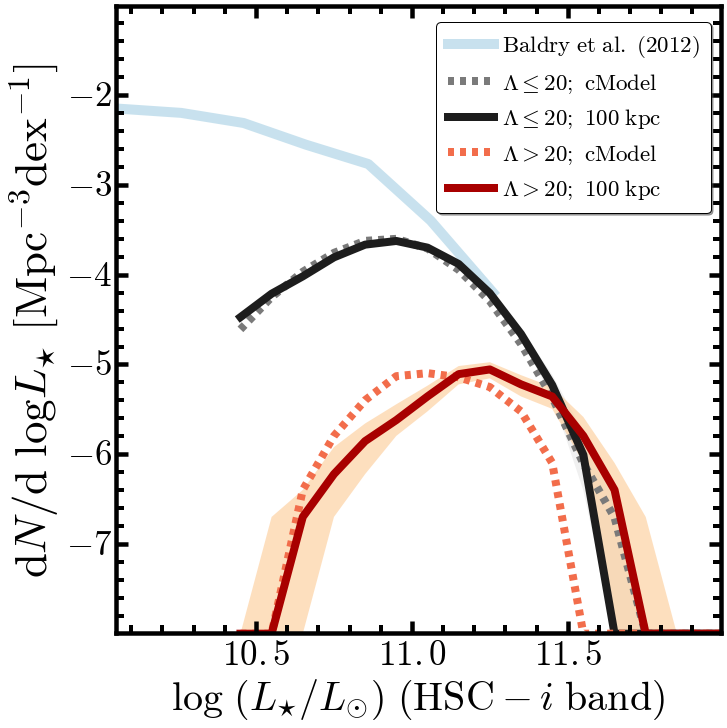

In [64]:
fig = plt.figure(figsize=(10, 10))
ax1 = fig.add_subplot(111)
fig.subplots_adjust(left=0.15, right=0.99, 
                    bottom=0.12, top=0.99,
                    wspace=0.02, hspace=0.00)

ax1 = songPlotSetup(ax1, xlabel=35.0, ylabel=35.0, 
                    xtickFormat='$\mathbf{%4.1f}$') 

# Baldry+2012
ax1.plot(i_lf_B12['col1'] - 0.04, np.log10(i_lf_B12['col3']), 
         c=BLUE0, linestyle='-', 
         linewidth=10.0, alpha=0.5, 
         label='$\mathrm{Baldry\ et\ al.\ (2012)}$')

# nonbcg
ax1.fill_between(mbin, nonbcgLLow2, nonbcgLUpp2, c=BLK(0.3), 
                 edgecolor='none', alpha=0.3)
ax1.plot(mbin, nonbcgLMed1, c=BLK(0.6), linestyle='--', linewidth=8.0,
         label='$\lambda \leq 20;\ \mathrm{cModel}$')
ax1.plot(mbin, nonbcgLMed2, c=BLK(0.9), linewidth=8.0,
         label='$\lambda \leq 20;\ \mathrm{100\ kpc}$')

# redbcg
ax1.fill_between(mbin, redbcgLLow2, redbcgLUpp2, c=ORG(0.3), 
                 edgecolor='none', alpha=0.6)
ax1.plot(mbin, redbcgLMed1, c=ORG(0.6), linestyle='--', linewidth=8.0,
         label='$\lambda > 20;\ \mathrm{cModel}$')
ax1.plot(mbin, redbcgLMed2, c=ORG(0.9), linewidth=8.0,
         label='$\lambda > 20;\ \mathrm{100\ kpc}$')

ax1.legend(loc=(0.53, 0.67), shadow=True, fancybox=True, 
           numpoints=1, fontsize=23, scatterpoints=1, 
           markerscale=1.2, borderpad=0.5, handletextpad=0.34)

ax1.set_xlim(10.05, 11.99)
ax1.set_ylim(-7.99, -1.01)

# Label
ax1.set_xlabel('$\log\ (L_{\star}/L_{\odot})\ (\mathrm{HSC}-i\ \mathrm{band})}$', size=40)
ax1.set_ylabel('$\mathrm{d}N/\mathrm{d}\ {\logL_{\star}}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=45)

fig.savefig(os.path.join(figDir, redbcgStr + '_lum_distribution.pdf'), dpi=200)

plt.show()

## Stellar mass volume density distributions

In [65]:
# Stellar mass function using cModel luminosity
mbin, nonbcgMAll1 = getMassFunction(nonbcgUse, massCol='MSTAR', 
                                    area=nonbcgArea, errValue=0.12, 
                                    returnAll=True, minVal=1.0E-9,
                                    verbose=True, zLow=zLow, zUpp=zUpp)
nonbcgMLow1 = np.nanpercentile(nonbcgMAll1, 3.0, axis=0)
nonbcgMUpp1 = np.nanpercentile(nonbcgMAll1, 97.0, axis=0)
nonbcgMMed1 = np.nanmedian(nonbcgMAll1, axis=0)

mbin, redbcgMAll1 = getMassFunction(redbcgUse, massCol='MSTAR', 
                                    area=redbcgArea, errValue=0.12, 
                                    returnAll=True, minVal=1.0E-9,
                                    verbose=True, zLow=zLow, zUpp=zUpp)
redbcgMLow1 = np.nanpercentile(redbcgMAll1, 3.0, axis=0)
redbcgMUpp1 = np.nanpercentile(redbcgMAll1, 97.0, axis=0)
redbcgMMed1 = np.nanmedian(redbcgMAll1, axis=0)

# Use fixed error value:  0.12
# Sample include 3785 / 5611 galaxies
# The deltaVolume is   50762652.680 Mpc^3
# Use fixed error value:  0.12
# Sample include 117 / 148 galaxies
# The deltaVolume is   49981539.439 Mpc^3


In [66]:
# Test for S82 region: 
nonbcgS82 = Table.read(os.path.join(sampleDir, 'dr1_nonbcg_s82_match.fits'),
                       format='fits')

mbin, nonbcgMS82 = getMassFunction(nonbcgS82, massCol='logm_100', 
                                   area=12.0, errValue=0.12, 
                                   returnAll=True, minVal=1.0E-9,
                                   verbose=True, zLow=zLow, zUpp=zUpp)
nonbcgMLowS82 = np.nanpercentile(nonbcgMS82, 3.0, axis=0)
nonbcgMUppS82 = np.nanpercentile(nonbcgMS82, 97.0, axis=0)
nonbcgMMedS82 = np.nanmedian(nonbcgMS82, axis=0)

# Use fixed error value:  0.12
# Sample include 596 / 760 galaxies
# The deltaVolume is    6126667.065 Mpc^3


In [67]:
# Stellar mass function using integrated luminosity out to 100 kpc 
mbin, nonbcgMAll2 = getMassFunction(nonbcgUse, massCol='logm_100', 
                                    area=nonbcgArea, errValue=0.12, 
                                    returnAll=True, minVal=1.0E-9, 
                                    zLow=zLow, zUpp=zUpp)
nonbcgMLow2 = np.nanpercentile(nonbcgMAll2, 3.0, axis=0)
nonbcgMUpp2 = np.nanpercentile(nonbcgMAll2, 97.0, axis=0)
nonbcgMMed2 = np.nanmedian(nonbcgMAll2, axis=0)

mbin, redbcgMAll2 = getMassFunction(redbcgUse, massCol='logm_100', 
                                    area=redbcgArea, errValue=0.12, 
                                    returnAll=True, minVal=1.0E-9, 
                                    zLow=zLow, zUpp=zUpp)
redbcgMLow2 = np.nanpercentile(redbcgMAll2, 3.0, axis=0)
redbcgMUpp2 = np.nanpercentile(redbcgMAll2, 97.0, axis=0)
redbcgMMed2 = np.nanmedian(redbcgMAll2, axis=0)

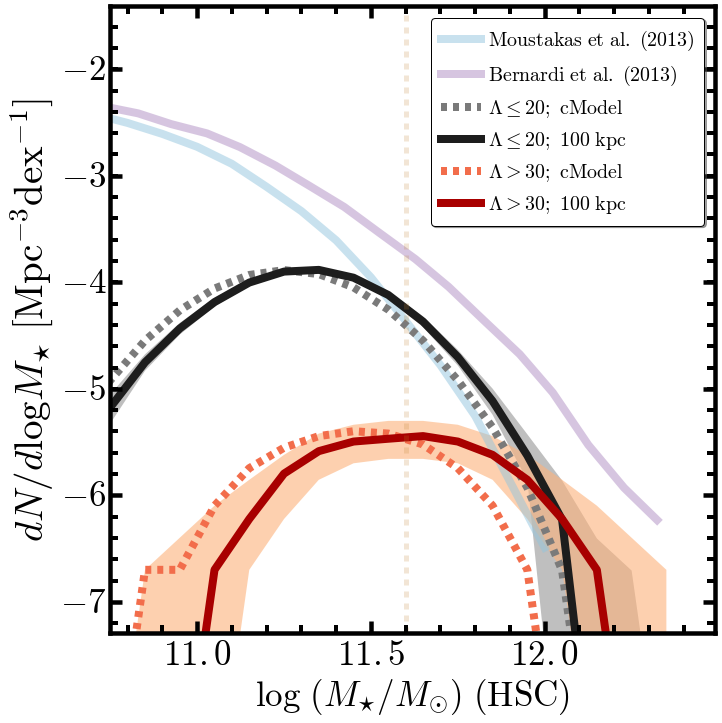

In [68]:
fig = plt.figure(figsize=(10, 10))
ax1 = fig.add_subplot(111)
fig.subplots_adjust(left=0.15, right=0.99, 
                    bottom=0.12, top=0.99,
                    wspace=0.02, hspace=0.00)

ax1 = songPlotSetup(ax1, xlabel=35.0, ylabel=35.0, 
                    xtickFormat='$\mathbf{%4.1f}$') 

# Leauthaud+2015
#ax1.plot(massCommon + 0.15, np.log10(doubleSchechter(massCommon)), c=GREEN0,
#         linestyle='-', linewidth=8.0, alpha=0.2, 
#         label='$\mathrm{Leauthaud\ et\ al.\ (2015)}$')

# Moustakas+2013 
ax1.plot(mf_M13['logM'], mf_M13['logPhi'], linestyle='-', 
         linewidth=8.0, alpha=0.5, 
         c=BLUE0, label='$\mathrm{Moustakas\ et\ al.\ (2013)}$')

# Bernardi+2013; SerExp
hTerm1 = (2.0 * np.log10(0.72))
hTerm2 = (3.0 * np.log10(0.72))
ax1.plot(mf_B13['col1'] - hTerm1, mf_B13['col2'] + hTerm2, linestyle='-', 
         linewidth=8.0, alpha=0.5, 
         c=PURPLE0, label='$\mathrm{Bernardi\ et\ al.\ (2013)}$')

# d'Souza+2015; 
#ax1.plot(mf_D15['col1'], mf_D15['col2'], linestyle='-', linewidth=13.0, 
#         alpha=0.3, c='orange', label='$\mathrm{d\'Souza\ et\ al.\ (2015)}$')

# nonbcg
ax1.fill_between(mbin, nonbcgMLow2, nonbcgMUpp2, c=BLK(0.5), 
                 edgecolor='none', alpha=0.6)
ax1.plot(mbin, nonbcgMMed1, c=BLK(0.6), linestyle='--', linewidth=8.0,
         label='$\lambda \leq 20;\ \mathrm{cModel}$')
ax1.plot(mbin, nonbcgMMed2, c=BLK(0.9), linewidth=8.0,
         label='$\lambda \leq 20;\ \mathrm{100\ kpc}$')

# redbcg
ax1.fill_between(mbin, redbcgMLow2, redbcgMUpp2, c=ORG(0.4), 
                 edgecolor='none', alpha=0.6)
ax1.plot(mbin, redbcgMMed1, c=ORG(0.6), linestyle='--', linewidth=8.0,
         label='$\lambda > 30;\ \mathrm{cModel}$')
ax1.plot(mbin, redbcgMMed2, c=ORG(0.9), linewidth=8.0,
         label='$\lambda > 30;\ \mathrm{100\ kpc}$')

ax1.legend(loc=(0.53, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.2, borderpad=0.5, handletextpad=0.34)

#ax1.fill_between(mbin, nonbcgMLowS82, nonbcgMUppS82, c=GRN(0.4), 
#                 edgecolor='none', alpha=0.6)

ax1.set_xlim(10.75, 12.49)
ax1.set_ylim(-7.29, -1.41)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', size=35)
ax1.set_ylabel('$dN/d\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=39)

ax1.axvline(11.6, linestyle='--', linewidth=5.0, c=BROWN0, alpha=0.2)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution.pdf'), dpi=200)

plt.show()

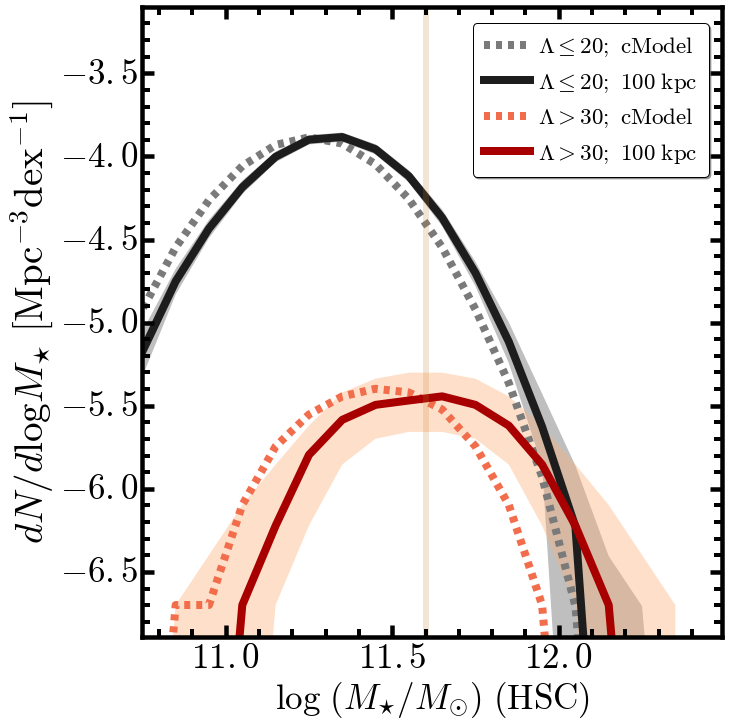

In [69]:
fig = plt.figure(figsize=(10, 10))
ax1 = fig.add_subplot(111)
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.02, hspace=0.00)

ax1 = songPlotSetup(ax1, xlabel=35.0, ylabel=35.0, 
                    xtickFormat='$\mathbf{%4.1f}$', 
                    ytickFormat='$\mathbf{%4.1f}$') 

# nonbcg
ax1.fill_between(mbin, nonbcgMLow2, nonbcgMUpp2, c=BLK(0.5), 
                 edgecolor='none', alpha=0.6)
ax1.plot(mbin, nonbcgMMed1, c=BLK(0.6), linestyle='--', linewidth=8.0,
         label='$\lambda \leq 20;\ \mathrm{cModel}$')
ax1.plot(mbin, nonbcgMMed2, c=BLK(0.9), linewidth=8.0,
         label='$\lambda \leq 20;\ \mathrm{100\ kpc}$')

# redbcg
ax1.fill_between(mbin, redbcgMLow2, redbcgMUpp2, c=ORG(0.4), 
                 edgecolor='none', alpha=0.4)
ax1.plot(mbin, redbcgMMed1, c=ORG(0.6), linestyle='--', linewidth=8.0,
         label='$\lambda > 30;\ \mathrm{cModel}$')
ax1.plot(mbin, redbcgMMed2, c=ORG(0.9), linewidth=8.0,
         label='$\lambda > 30;\ \mathrm{100\ kpc}$')

#ax1.fill_between(mbin, nonbcgMLowS82, nonbcgMUppS82, c=GRN(0.4), 
#                 edgecolor='none', alpha=0.6)

ax1.legend(loc=(0.57, 0.73), shadow=True, fancybox=True, 
           numpoints=1, fontsize=23, scatterpoints=1, 
           markerscale=1.2, borderpad=0.5, handletextpad=0.34)

ax1.set_xlim(10.75, 12.49)
ax1.set_ylim(-6.89, -3.1)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', size=35)
ax1.set_ylabel('$dN/d\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=39)

ax1.axvline(11.6, linestyle='-', linewidth=6.0, c=BROWN0, alpha=0.2)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_pub.pdf'), dpi=150)

plt.show()

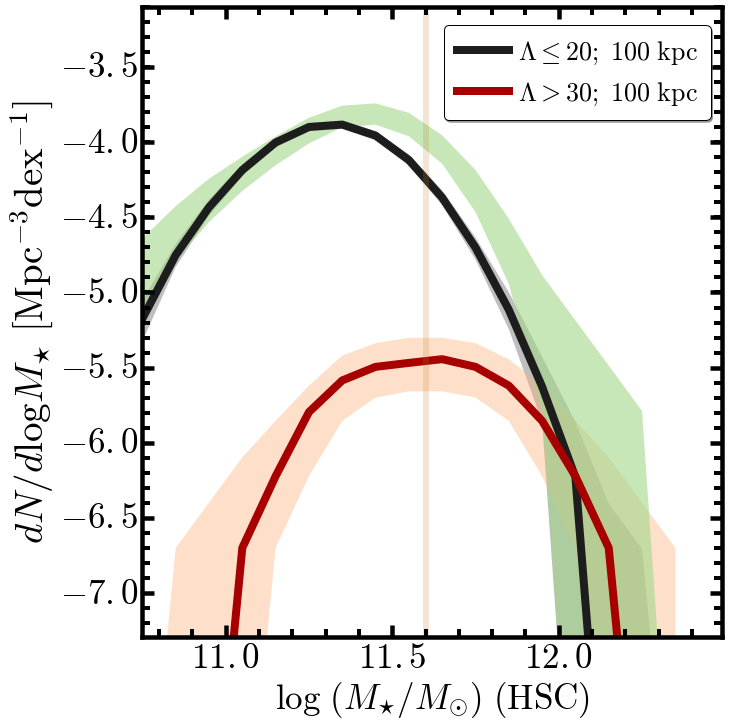

In [70]:
fig = plt.figure(figsize=(10, 10))
ax1 = fig.add_subplot(111)
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.02, hspace=0.00)

ax1 = songPlotSetup(ax1, xlabel=35.0, ylabel=35.0, 
                    xtickFormat='$\mathbf{%4.1f}$', 
                    ytickFormat='$\mathbf{%4.1f}$') 

# nonbcg
ax1.fill_between(mbin, nonbcgMLow2, nonbcgMUpp2, c=BLK(0.5), 
                 edgecolor='none', alpha=0.6)
ax1.plot(mbin, nonbcgMMed2, c=BLK(0.9), linewidth=8.0,
         label='$\lambda \leq 20;\ \mathrm{100\ kpc}$')

# redbcg
ax1.fill_between(mbin, redbcgMLow2, redbcgMUpp2, c=ORG(0.4), 
                 edgecolor='none', alpha=0.4)
ax1.plot(mbin, redbcgMMed2, c=ORG(0.9), linewidth=8.0,
         label='$\lambda > 30;\ \mathrm{100\ kpc}$')

ax1.fill_between(mbin, nonbcgMLowS82, nonbcgMUppS82, c=GRN(0.4), 
                 edgecolor='none', alpha=0.6)

ax1.legend(loc=(0.52, 0.82), shadow=True, fancybox=True, 
           numpoints=1, fontsize=26, scatterpoints=1, 
           markerscale=1.2, borderpad=0.5, handletextpad=0.34)

ax1.set_xlim(10.75, 12.49)
ax1.set_ylim(-7.29, -3.1)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', size=35)
ax1.set_ylabel('$dN/d\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=39)

ax1.axvline(11.6, linestyle='-', linewidth=6.0, c=BROWN0, alpha=0.2)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_s82.pdf'), dpi=200)

plt.show()

## Stellar mass volume density distributions in differnt redshift bins

In [65]:
# 0.2 < z < 0.3 
mbin, nonbcgMZ0 = getMassFunction(nonbcgUse, massCol='logm_100', 
                                  area=nonbcgArea, errValue=0.10, 
                                  returnAll=True, minVal=1.0E-9, 
                                  zLow=0.20, zUpp=0.30)
nonbcgMLowZ0 = np.nanpercentile(nonbcgMZ0, 3.0, axis=0)
nonbcgMUppZ0 = np.nanpercentile(nonbcgMZ0, 97.0, axis=0)
nonbcgMMedZ0 = np.nanmedian(nonbcgMZ0, axis=0)

# 0.3 < z < 0.4 
mbin, nonbcgMZ1 = getMassFunction(nonbcgUse, massCol='logm_100', 
                                  area=nonbcgArea, errValue=0.10, 
                                  returnAll=True, minVal=1.0E-9, 
                                  zLow=0.30, zUpp=0.40)
nonbcgMLowZ1 = np.nanpercentile(nonbcgMZ1, 3.0, axis=0)
nonbcgMUppZ1 = np.nanpercentile(nonbcgMZ1, 97.0, axis=0)
nonbcgMMedZ1 = np.nanmedian(nonbcgMZ1, axis=0)

# 0.4 < z < 0.5 
mbin, nonbcgMZ2 = getMassFunction(nonbcgUse, massCol='logm_100', 
                                  area=nonbcgArea, errValue=0.10, 
                                  returnAll=True, minVal=1.0E-9, 
                                  zLow=0.40, zUpp=0.50)
nonbcgMLowZ2 = np.nanpercentile(nonbcgMZ2, 3.0, axis=0)
nonbcgMUppZ2 = np.nanpercentile(nonbcgMZ2, 97.0, axis=0)
nonbcgMMedZ2 = np.nanmedian(nonbcgMZ2, axis=0)

In [66]:
# 0.3 < z < 0.4 
mbin, redbcgMZ0 = getMassFunction(redbcgUse, massCol='logm_100', 
                                  area=redbcgArea, errValue=0.10, 
                                  returnAll=True, minVal=1.0E-9, 
                                  zLow=0.20, zUpp=0.30)
redbcgMLowZ0 = np.nanpercentile(redbcgMZ0, 3.0, axis=0)
redbcgMUppZ0 = np.nanpercentile(redbcgMZ0, 97.0, axis=0)
redbcgMMedZ0 = np.nanmedian(redbcgMZ0, axis=0)

# 0.3 < z < 0.4 
mbin, redbcgMZ1 = getMassFunction(redbcgUse, massCol='logm_100', 
                                  area=redbcgArea, errValue=0.10, 
                                  returnAll=True, minVal=1.0E-9, 
                                  zLow=0.30, zUpp=0.40)
redbcgMLowZ1 = np.nanpercentile(redbcgMZ1, 3.0, axis=0)
redbcgMUppZ1 = np.nanpercentile(redbcgMZ1, 97.0, axis=0)
redbcgMMedZ1 = np.nanmedian(redbcgMZ1, axis=0)

# 0.4 < z < 0.5 
mbin, redbcgMZ2 = getMassFunction(redbcgUse, massCol='logm_100', 
                                  area=redbcgArea, errValue=0.10, 
                                  returnAll=True, minVal=1.0E-9, 
                                  zLow=0.40, zUpp=0.50)
redbcgMLowZ2 = np.nanpercentile(redbcgMZ2, 3.0, axis=0)
redbcgMUppZ2 = np.nanpercentile(redbcgMZ2, 97.0, axis=0)
redbcgMMedZ2 = np.nanmedian(redbcgMZ2, axis=0)

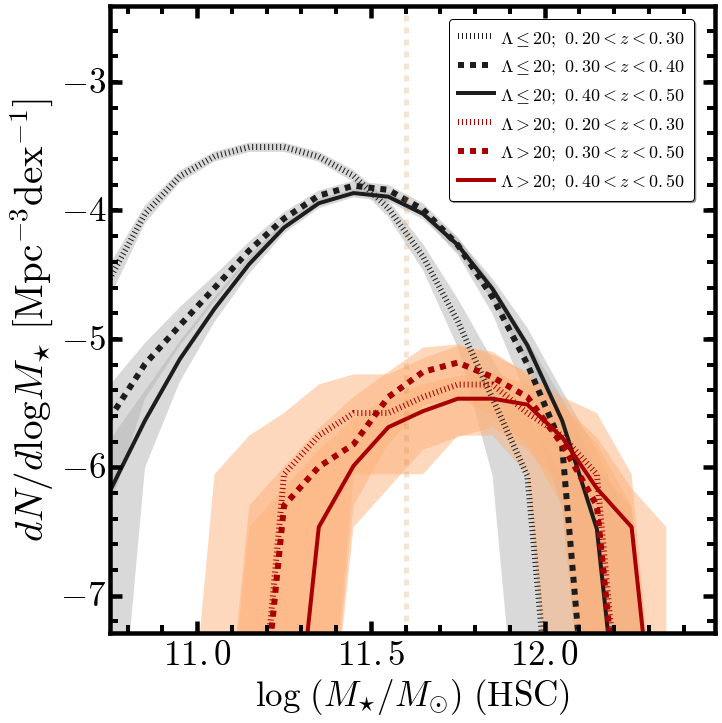

In [67]:
fig = plt.figure(figsize=(10, 10))
ax1 = fig.add_subplot(111)
fig.subplots_adjust(left=0.15, right=0.99, 
                    bottom=0.12, top=0.99,
                    wspace=0.02, hspace=0.00)

ax1 = songPlotSetup(ax1, xlabel=35.0, ylabel=35.0, 
                    xtickFormat='$\mathbf{%4.1f}$') 

# Moustakas+2013 
#ax1.plot(mf_M13['logM'], mf_M13['logPhi'], linestyle='-', 
#         linewidth=8.0, alpha=0.3, 
#         c=BLUE0, label='$\mathrm{Moustakas\ et\ al.\ (2013)}$')

# Bernardi+2013; SerExp
hTerm1 = (2.0 * np.log10(0.72))
hTerm2 = (3.0 * np.log10(0.72))
#ax1.plot(mf_B13['col1'] - hTerm1, mf_B13['col2'] + hTerm2, linestyle='-', 
#         linewidth=8.0, alpha=0.3, 
#         c=PURPLE0, label='$\mathrm{Bernardi\ et\ al.\ (2013)}$')

# nonbcg
ax1.fill_between(mbin, nonbcgMLowZ0, nonbcgMUppZ0, c=BLK(0.4), 
                 edgecolor='none', alpha=0.5)
ax1.plot(mbin, nonbcgMMedZ0, c=BLK(0.9), linewidth=6.0, linestyle=':',
         label='$\lambda \leq 20;\ 0.20 < z < 0.30$')

ax1.fill_between(mbin, nonbcgMLowZ1, nonbcgMUppZ1, c=BLK(0.4), 
                 edgecolor='none', alpha=0.5)
ax1.plot(mbin, nonbcgMMedZ1, c=BLK(0.9), linewidth=6.0, linestyle='--',
         label='$\lambda \leq 20;\ 0.30 < z < 0.40$')

ax1.fill_between(mbin, nonbcgMLowZ2, nonbcgMUppZ2, c=BLK(0.4), 
                 edgecolor='none', alpha=0.5)
ax1.plot(mbin, nonbcgMMedZ2, c=BLK(0.9), linewidth=4.0, linestyle='-',
         label='$\lambda \leq 20;\ 0.40 < z < 0.50$')


# redbcg
ax1.fill_between(mbin, redbcgMLowZ0, redbcgMUppZ0, c=ORG(0.4), 
                 edgecolor='none', alpha=0.5)
ax1.plot(mbin, redbcgMMedZ0, c=ORG(0.9), linewidth=6.0, linestyle=':',
         label='$\lambda > 20;\ 0.20 < z < 0.30$')

ax1.fill_between(mbin, redbcgMLowZ1, redbcgMUppZ1, c=ORG(0.4), 
                 edgecolor='none', alpha=0.5)
ax1.plot(mbin, redbcgMMedZ1, c=ORG(0.9), linewidth=6.0, linestyle='--',
         label='$\lambda > 20;\ 0.30 < z < 0.50$')

ax1.fill_between(mbin, redbcgMLowZ2, redbcgMUppZ2, c=ORG(0.4), 
                 edgecolor='none', alpha=0.5)
ax1.plot(mbin, redbcgMMedZ2, c=ORG(0.9), linewidth=4.0, linestyle='-',
         label='$\lambda > 20;\ 0.40 < z < 0.50$')

ax1.set_xlim(10.75, 12.49)
ax1.set_ylim(-7.29, -2.41)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', size=35)
ax1.set_ylabel('$dN/d\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=39)

ax1.axvline(11.6, linestyle='--', linewidth=5.0, c=BROWN0, alpha=0.2)

ax1.legend(loc=(0.56, 0.69), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=1.2, borderpad=0.5, handletextpad=0.34)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_zbin.pdf'), dpi=200)

plt.show()

## Comparison with the GAMA sample

In [68]:
nonbcgAreaGama = 42.0
redbcgAreaGama = 42.0

mbin, nonbcgGamaM = getMassFunction(nonbcgGama, massCol='logm_100', 
                                    area=nonbcgAreaGama, errValue=0.10, 
                                    returnAll=True, minVal=1.0E-9, 
                                    zLow=0.3, zUpp=0.50)
nonbcgGamaMLow = np.nanpercentile(nonbcgGamaM, 3.0, axis=0)
nonbcgGamaMUpp = np.nanpercentile(nonbcgGamaM, 97.0, axis=0)
nonbcgGamaMMed = np.nanmedian(nonbcgGamaM, axis=0)

mbin, nonbcgGamaMZ = getMassFunction(nonbcgGamaZ, massCol='logm_100', 
                                     area=40.0, errValue=0.10, 
                                     returnAll=True, minVal=1.0E-9, 
                                     zLow=0.3, zUpp=0.40)
nonbcgGamaMLowZ = np.nanpercentile(nonbcgGamaMZ, 3.0, axis=0)
nonbcgGamaMUppZ = np.nanpercentile(nonbcgGamaMZ, 97.0, axis=0)
nonbcgGamaMMedZ = np.nanmedian(nonbcgGamaMZ, axis=0)


mbin, redbcgGamaM = getMassFunction(redbcgGama, massCol='logm_100', 
                                    area=redbcgAreaGama, errValue=0.10, 
                                    returnAll=True, minVal=1.0E-9, 
                                    zLow=0.3, zUpp=0.50)
redbcgGamaMLow = np.nanpercentile(redbcgGamaM, 3.0, axis=0)
redbcgGamaMUpp = np.nanpercentile(redbcgGamaM, 97.0, axis=0)
redbcgGamaMMed = np.nanmedian(redbcgGamaM, axis=0)

mbin, redbcgGamaMZ = getMassFunction(redbcgGamaZ, massCol='logm_100', 
                                     area=40.0, errValue=0.10, 
                                     returnAll=True, minVal=1.0E-9, 
                                     zLow=0.3, zUpp=0.40)
redbcgGamaMLowZ = np.nanpercentile(redbcgGamaMZ, 3.0, axis=0)
redbcgGamaMUppZ = np.nanpercentile(redbcgGamaMZ, 97.0, axis=0)
redbcgGamaMMedZ = np.nanmedian(redbcgGamaMZ, axis=0)

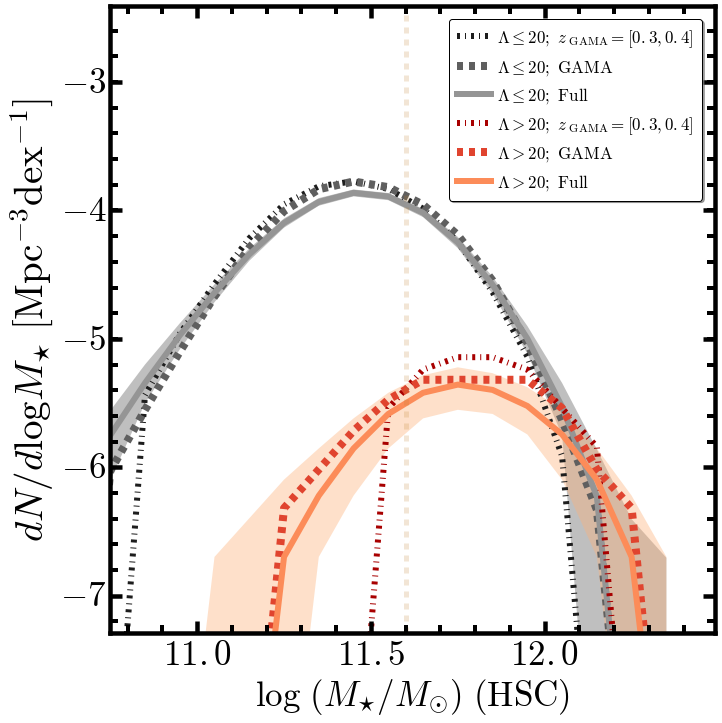

In [69]:
fig = plt.figure(figsize=(10, 10))
ax1 = fig.add_subplot(111)
fig.subplots_adjust(left=0.15, right=0.99, 
                    bottom=0.12, top=0.99,
                    wspace=0.02, hspace=0.00)

ax1 = songPlotSetup(ax1, xlabel=35.0, ylabel=35.0, 
                    xtickFormat='$\mathbf{%4.1f}$') 

# Leauthaud+2015
#ax1.plot(massCommon, np.log10(doubleSchechter(massCommon)), c=GREEN0,
#         linestyle='-', linewidth=8.0, alpha=0.2, 
#         label='$\mathrm{Leauthaud\ et\ al.\ (2015)}$')

# Moustakas+2013 
#ax1.plot(mf_M13['logM'], mf_M13['logPhi'], linestyle='-', 
#         linewidth=8.0, alpha=0.3, 
#         c=BLUE0, label='$\mathrm{Moustakas\ et\ al.\ (2013)}$')

# Bernardi+2013; SerExp
hTerm1 = (2.0 * np.log10(0.72))
hTerm2 = (3.0 * np.log10(0.72))
#ax1.plot(mf_B13['col1'] - hTerm1, mf_B13['col2'] + hTerm2, linestyle='-', 
#         linewidth=8.0, alpha=0.3, 
#         c=PURPLE0, label='$\mathrm{Bernardi\ et\ al.\ (2013)}$')

# d'Souza+2015; 
#ax1.plot(mf_D15['col1'], mf_D15['col2'], linestyle='-', linewidth=13.0, 
#         alpha=0.3, c='orange', label='$\mathrm{d\'Souza\ et\ al.\ (2015)}$')

# nonbcg
ax1.fill_between(mbin, nonbcgMLow2, nonbcgMUpp2, c=BLK(0.5), 
                 edgecolor='none', alpha=0.6)
ax1.plot(mbin, nonbcgGamaMMedZ, c=BLK(0.9), linestyle='-.', linewidth=6.0,
         label='$\lambda \leq 20;\ z_{\mathrm{\ GAMA}}=[0.3,0.4]$')
ax1.plot(mbin, nonbcgGamaMMed, c=BLK(0.7), linestyle='--', linewidth=8.0,
         label='$\lambda \leq 20;\ \mathrm{GAMA}$')
ax1.plot(mbin, nonbcgMMed2, c=BLK(0.5), linewidth=6.0,
         label='$\lambda \leq 20;\ \mathrm{Full}$')

# redbcg
ax1.fill_between(mbin, redbcgMLow2, redbcgMUpp2, c=ORG(0.4), 
                 edgecolor='none', alpha=0.4)
ax1.plot(mbin, redbcgGamaMMedZ, c=ORG(0.9), linestyle='-.', linewidth=6.0,
         label='$\lambda > 20;\ z_{\mathrm{\ GAMA}}=[0.3,0.4]$')
ax1.plot(mbin, redbcgGamaMMed, c=ORG(0.7), linestyle='--', linewidth=8.0,
         label='$\lambda > 20;\ \mathrm{GAMA}$')
ax1.plot(mbin, redbcgMMed2, c=ORG(0.5), linewidth=6.0,
         label='$\lambda > 20;\ \mathrm{Full}$')

ax1.legend(loc=(0.56, 0.69), shadow=True, fancybox=True, 
           numpoints=1, fontsize=17, scatterpoints=1, 
           markerscale=1.2, borderpad=0.5, handletextpad=0.34)

ax1.set_xlim(10.75, 12.49)
ax1.set_ylim(-7.29, -2.41)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', size=35)
ax1.set_ylabel('$dN/d\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=39)

ax1.axvline(11.6, linestyle='--', linewidth=5.0, c=BROWN0, alpha=0.2)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_gama.pdf'), dpi=200)

plt.show()

## Comparison with the S82 photo-z sample 

* Using the cModel stellar mass only

In [70]:
masterDir = os.path.join(homeDir, 'astro4/massive/dr15b/master')

s82data = Table.read(os.path.join(masterDir, 'dr1_s82_clean_zbin_isedfit_fsps2.fits'), 
                     format='fits')

In [71]:
# Stellar mass function using cModel luminosity
s82Use = s82data[(s82data['ZBEST'] <= 0.45) & 
                 (s82data['ZBEST'] >= 0.35) & 
                 (s82data['CHI2'] <= 50.0)]

mbin, s82MAll1 = getMassFunction(s82Use, massCol='MBEST', zCol='ZBEST',
                                 area=25.0, errValue=0.12, 
                                 returnAll=True, minVal=1.0E-9,
                                 verbose=True, zLow=zLow, zUpp=zUpp)
s82MLow1 = np.nanpercentile(s82MAll1, 3.0, axis=0)
s82MUpp1 = np.nanpercentile(s82MAll1, 97.0, axis=0)
s82MMed1 = np.nanmedian(s82MAll1, axis=0)

mbin, s82MAll2 = getMassFunction(s82Use, massCol='MSTAR', zCol='ZBEST',
                                 area=25.0, errValue=0.12, 
                                 returnAll=True, minVal=1.0E-9,
                                 verbose=True, zLow=zLow, zUpp=zUpp)
s82MLow2 = np.nanpercentile(s82MAll2, 3.0, axis=0)
s82MUpp2 = np.nanpercentile(s82MAll2, 97.0, axis=0)
s82MMed2 = np.nanmedian(s82MAll2, axis=0)

# Use fixed error value:  0.12
# Sample include 9783 / 11077 galaxies
# The deltaVolume is    6366395.835 Mpc^3
# Use fixed error value:  0.12
# Sample include 10911 / 11077 galaxies
# The deltaVolume is    6366395.835 Mpc^3


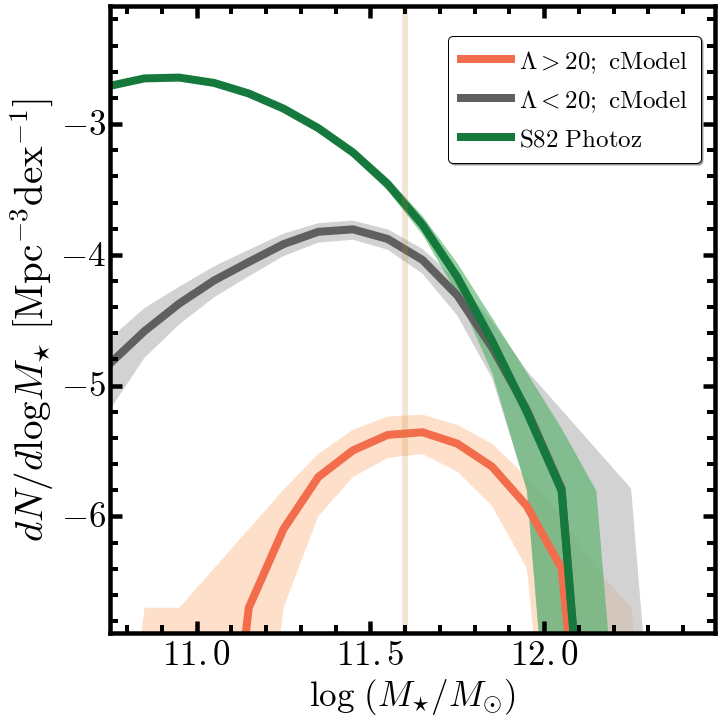

In [72]:
fig = plt.figure(figsize=(10, 10))
ax1 = fig.add_subplot(111)
fig.subplots_adjust(left=0.15, right=0.99, 
                    bottom=0.12, top=0.99,
                    wspace=0.02, hspace=0.00)

ax1 = songPlotSetup(ax1, xlabel=35.0, ylabel=35.0, 
                    xtickFormat='$\mathbf{%4.1f}$') 

# Moustakas+2013 
#ax1.plot(mf_M13['logM'], mf_M13['logPhi'], linestyle='-', 
#         linewidth=8.0, alpha=0.5, 
#         c=BLUE0, label='$\mathrm{Moustakas\ et\ al.\ (2013)}$')

# Bernardi+2013; SerExp
#hTerm1 = (2.0 * np.log10(0.72))
#hTerm2 = (3.0 * np.log10(0.72))
#ax1.plot(mf_B13['col1'] - hTerm1, mf_B13['col2'] + hTerm2, linestyle='-', 
#         linewidth=8.0, alpha=0.3, 
#         c=PURPLE0, label='$\mathrm{Bernardi\ et\ al.\ (2013)}$')

# nonbcg
#ax1.fill_between(mbin, nonbcgMLow1, nonbcgMUpp1, c=BLK(0.5), 
#                 edgecolor='none', alpha=0.6)
#ax1.plot(mbin, nonbcgMMed1, c=BLK(0.6), linestyle='-', linewidth=8.0,
#         label='$\lambda \leq 20;\ \mathrm{cModel}$')
#ax1.plot(mbin, nonbcgMMed2, c=BLK(0.9), linewidth=4.0,
#         label='$\lambda \leq 20;\ \mathrm{100\ kpc}$')

# redbcg
ax1.fill_between(mbin, redbcgMLow1, redbcgMUpp1, c=ORG(0.4), 
                 edgecolor='none', alpha=0.4)
ax1.plot(mbin, redbcgMMed1, c=ORG(0.6), linestyle='-', linewidth=8.0,
         label='$\lambda > 20;\ \mathrm{cModel}$')
#ax1.plot(mbin, redbcgMMed2, c=ORG(0.9), linewidth=4.0,
#         label='$\lambda > 20;\ \mathrm{100\ kpc}$')

# nonbcg in XMM
ax1.fill_between(mbin, nonbcgMLowS82, nonbcgMUppS82, c=BLK(0.4), 
                 edgecolor='none', alpha=0.6)
ax1.plot(mbin, nonbcgMMedS82, c=BLK(0.7), linestyle='-', linewidth=8.0,
         label='$\lambda < 20;\ \mathrm{cModel}$')

# S82 
#ax1.fill_between(mbin, s82MLow1, s82MUpp1, c=GRN(0.4), 
#                 edgecolor='none', alpha=0.5, 
#                 label='$\mathrm{S82\ MBEST}$')
ax1.fill_between(mbin, s82MLow2, s82MUpp2, c=GRN(0.6), 
                 edgecolor='none', alpha=0.6)
ax1.plot(mbin, s82MMed2, c=GRN(0.8), linestyle='-', linewidth=8.0,
         label='$\mathrm{S82\ Photoz}$')


ax1.legend(loc=(0.56, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.5, handletextpad=0.34)

ax1.set_xlim(10.75, 12.49)
ax1.set_ylim(-6.89, -2.1)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})$', size=35)
ax1.set_ylabel('$dN/d\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=39)

ax1.axvline(11.6, linestyle='-', linewidth=6.0, c=BROWN0, alpha=0.2)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_s82_photoz.pdf'), dpi=200)

plt.show()

# Get the average profiles in different mass and redshift bins

In [73]:
redbcgMbin1 = redbcgClean[(redbcgClean['logm_100'] >= 11.5) & 
                          (redbcgClean['logm_100'] <= 11.7) & 
                          (redbcgClean['z_use'] >= 0.30) & 
                          (redbcgClean['z_use'] <= 0.50)]

redbcgMbin2 = redbcgClean[(redbcgClean['logm_100'] >= 11.7) & 
                          (redbcgClean['logm_100'] <= 11.9) & 
                          (redbcgClean['z_use'] >= 0.30) & 
                          (redbcgClean['z_use'] <= 0.50)]

redbcgMbin3 = redbcgClean[(redbcgClean['logm_100'] >= 11.9) & 
                          (redbcgClean['logm_100'] <= 12.2) & 
                          (redbcgClean['z_use'] >= 0.30) & 
                          (redbcgClean['z_use'] <= 0.50)]

## redBCG mass bin1
redbcgProfMbin1 = getStackProfiles(redbcgMbin1, redbcgDir, 
                                   name=(prefix1 + '_fsps1_MBin1'))
redbcgProfMbin2 = getStackProfiles(redbcgMbin2, redbcgDir, 
                                   name=(prefix1 + '_fsps1_MBin2'))
redbcgProfMbin3 = getStackProfiles(redbcgMbin3, redbcgDir, 
                                   name=(prefix1 + '_fsps1_MBin3'))

## Sample redbcg_fsps1_MBin1 : Will deal with 45 galaxies

## Save redbcg_fsps1_MBin1 to /Users/song/astro4/massive/dr15b/sbp/redbcg/redbcg_fsps1_MBin1_profs.pkl
## Sample redbcg_fsps1_MBin2 : Will deal with 53 galaxies

## Save redbcg_fsps1_MBin2 to /Users/song/astro4/massive/dr15b/sbp/redbcg/redbcg_fsps1_MBin2_profs.pkl
## Sample redbcg_fsps1_MBin3 : Will deal with 27 galaxies

## Save redbcg_fsps1_MBin3 to /Users/song/astro4/massive/dr15b/sbp/redbcg/redbcg_fsps1_MBin3_profs.pkl


In [74]:
redbcgZbin1 = redbcgClean[(redbcgClean['logm_100'] >= 11.6) & 
                          (redbcgClean['logm_100'] <= 11.9) & 
                          (redbcgClean['z_use'] >= 0.30) & 
                          (redbcgClean['z_use'] <= 0.40)]

redbcgZbin2 = redbcgClean[(redbcgClean['logm_100'] >= 11.6) & 
                          (redbcgClean['logm_100'] <= 11.9) & 
                          (redbcgClean['z_use'] >= 0.40) & 
                          (redbcgClean['z_use'] <= 0.50)]

## redBCG mass bin1
redbcgProfZbin1 = getStackProfiles(redbcgZbin1, redbcgDir, 
                                   name=(prefix1 + '_fsps1_ZBin1'))
redbcgProfZbin2 = getStackProfiles(redbcgZbin2, redbcgDir, 
                                   name=(prefix1 + '_fsps1_ZBin2'))

## Sample redbcg_fsps1_ZBin1 : Will deal with 54 galaxies

## Save redbcg_fsps1_ZBin1 to /Users/song/astro4/massive/dr15b/sbp/redbcg/redbcg_fsps1_ZBin1_profs.pkl
## Sample redbcg_fsps1_ZBin2 : Will deal with 30 galaxies

## Save redbcg_fsps1_ZBin2 to /Users/song/astro4/massive/dr15b/sbp/redbcg/redbcg_fsps1_ZBin2_profs.pkl


In [75]:
nonbcgMbin1 = nonbcgClean[(nonbcgClean['logm_100'] >= 11.5) & 
                          (nonbcgClean['logm_100'] <= 11.7) & 
                          (nonbcgClean['z_use'] >= 0.30) & 
                          (nonbcgClean['z_use'] <= 0.50)]

nonbcgMbin2 = nonbcgClean[(nonbcgClean['logm_100'] >= 11.7) & 
                          (nonbcgClean['logm_100'] <= 11.9) & 
                          (nonbcgClean['z_use'] >= 0.30) & 
                          (nonbcgClean['z_use'] <= 0.50)]

## nonBCG mass bin1
nonbcgProfMbin1 = getStackProfiles(nonbcgMbin1, nonbcgDir, 
                                   name=(prefix2 + '_fsps1_MBin1'))
nonbcgProfMbin2 = getStackProfiles(nonbcgMbin2, nonbcgDir, 
                                   name=(prefix2 + '_fsps1_MBin2'))

## Sample nonbcg_fsps1_MBin1 : Will deal with 1257 galaxies

## Save nonbcg_fsps1_MBin1 to /Users/song/astro4/massive/dr15b/sbp/nonbcg/nonbcg_fsps1_MBin1_profs.pkl
## Sample nonbcg_fsps1_MBin2 : Will deal with 289 galaxies

## Save nonbcg_fsps1_MBin2 to /Users/song/astro4/massive/dr15b/sbp/nonbcg/nonbcg_fsps1_MBin2_profs.pkl


In [76]:
nonbcgZbin1 = nonbcgClean[(nonbcgClean['logm_100'] >= 11.6) & 
                          (nonbcgClean['logm_100'] <= 11.9) & 
                          (nonbcgClean['z_use'] >= 0.30) & 
                          (nonbcgClean['z_use'] <= 0.40)]

nonbcgZbin2 = nonbcgClean[(nonbcgClean['logm_100'] >= 11.6) & 
                          (nonbcgClean['logm_100'] <= 11.9) & 
                          (nonbcgClean['z_use'] >= 0.40) & 
                          (nonbcgClean['z_use'] <= 0.50)]

## nonBCG mass bin1
nonbcgProfZbin1 = getStackProfiles(nonbcgZbin1, nonbcgDir, 
                                   name=(prefix2 + '_fsps1_ZBin1'))
nonbcgProfZbin2 = getStackProfiles(nonbcgZbin2, nonbcgDir, 
                                   name=(prefix2 + '_fsps1_ZBin2'))

## Sample nonbcg_fsps1_ZBin1 : Will deal with 326 galaxies

## Save nonbcg_fsps1_ZBin1 to /Users/song/astro4/massive/dr15b/sbp/nonbcg/nonbcg_fsps1_ZBin1_profs.pkl
## Sample nonbcg_fsps1_ZBin2 : Will deal with 489 galaxies

## Save nonbcg_fsps1_ZBin2 to /Users/song/astro4/massive/dr15b/sbp/nonbcg/nonbcg_fsps1_ZBin2_profs.pkl


In [77]:
rm1_sm, rm1_mm, rm1_amg, rm1_stdm = organizeSbp(redbcgProfMbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rm2_sm, rm2_mm, rm2_amg, rm2_stdm = organizeSbp(redbcgProfMbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rm3_sm, rm3_mm, rm3_amg, rm3_stdm = organizeSbp(redbcgProfMbin3, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

nm1_sm, nm1_mm, nm1_amg, nm1_stdm = organizeSbp(nonbcgProfMbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
nm2_sm, nm2_mm, nm2_amg, nm2_stdm = organizeSbp(nonbcgProfMbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

rz1_sm, rz1_mm, rz1_amg, rz1_stdm = organizeSbp(redbcgProfZbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rz2_sm, rz2_mm, rz2_amg, rz2_stdm = organizeSbp(redbcgProfZbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

nz1_sm, nz1_mm, nz1_amg, nz1_stdm = organizeSbp(nonbcgProfZbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
nz2_sm, nz2_mm, nz2_amg, nz2_stdm = organizeSbp(nonbcgProfZbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

In [88]:
redbcgMbin1Save = Table()
redbcgMbin1Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
redbcgMbin1Save['medProfLow'] = Column(rm1_mm[0][RSMA_COMMON <= 150.0])
redbcgMbin1Save['medProfUpp'] = Column(rm1_mm[1][RSMA_COMMON <= 150.0])
redbcgMbin1Save['medProf'] = Column(rm1_mm[2][RSMA_COMMON <= 150.0])
redbcgMbin1Save['avgProfLow'] = Column(rm1_amg[0][RSMA_COMMON <= 150.0])
redbcgMbin1Save['avgProfUpp'] = Column(rm1_amg[1][RSMA_COMMON <= 150.0])
redbcgMbin1Save['avgProf'] = Column(rm1_amg[2][RSMA_COMMON <= 150.0])
redbcgMbin1Save['stdProf'] = Column(rm1_stdm[2][RSMA_COMMON <= 150.0])

redbcgMbin1Save.write(redbcgStr + '_mbin1.tex', format='ascii.aastex') 
redbcgMbin1Save.write(redbcgStr + '_mbin1.fits', format='fits', 
                      overwrite=True)

redbcgMbin2Save = Table()
redbcgMbin2Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
redbcgMbin2Save['medProfLow'] = Column(rm2_mm[0][RSMA_COMMON <= 150.0])
redbcgMbin2Save['medProfUpp'] = Column(rm2_mm[1][RSMA_COMMON <= 150.0])
redbcgMbin2Save['medProf'] = Column(rm2_mm[2][RSMA_COMMON <= 150.0])
redbcgMbin2Save['avgProfLow'] = Column(rm2_amg[0][RSMA_COMMON <= 150.0])
redbcgMbin2Save['avgProfUpp'] = Column(rm2_amg[1][RSMA_COMMON <= 150.0])
redbcgMbin2Save['avgProf'] = Column(rm2_amg[2][RSMA_COMMON <= 150.0])
redbcgMbin2Save['stdProf'] = Column(rm2_stdm[2][RSMA_COMMON <= 150.0])

redbcgMbin2Save.write(redbcgStr + '_mbin2.tex', format='ascii.aastex') 
redbcgMbin2Save.write(redbcgStr + '_mbin2.fits', format='fits', 
                      overwrite=True)

redbcgMbin3Save = Table()
redbcgMbin3Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
redbcgMbin3Save['medProfLow'] = Column(rm3_mm[0][RSMA_COMMON <= 150.0])
redbcgMbin3Save['medProfUpp'] = Column(rm3_mm[1][RSMA_COMMON <= 150.0])
redbcgMbin3Save['medProf'] = Column(rm3_mm[2][RSMA_COMMON <= 150.0])
redbcgMbin3Save['avgProfLow'] = Column(rm3_amg[0][RSMA_COMMON <= 150.0])
redbcgMbin3Save['avgProfUpp'] = Column(rm3_amg[1][RSMA_COMMON <= 150.0])
redbcgMbin3Save['avgProf'] = Column(rm3_amg[2][RSMA_COMMON <= 150.0])
redbcgMbin3Save['stdProf'] = Column(rm3_stdm[2][RSMA_COMMON <= 150.0])

redbcgMbin3Save.write(redbcgStr + '_mbin3.tex', format='ascii.aastex') 
redbcgMbin3Save.write(redbcgStr + '_mbin3.fits', format='fits', 
                      overwrite=True)

redbcgZbin1Save = Table()
redbcgZbin1Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
redbcgZbin1Save['medProfLow'] = Column(rz1_mm[0][RSMA_COMMON <= 150.0])
redbcgZbin1Save['medProfUpp'] = Column(rz1_mm[1][RSMA_COMMON <= 150.0])
redbcgZbin1Save['medProf'] = Column(rz1_mm[2][RSMA_COMMON <= 150.0])
redbcgZbin1Save['avgProfLow'] = Column(rz1_amg[0][RSMA_COMMON <= 150.0])
redbcgZbin1Save['avgProfUpp'] = Column(rz1_amg[1][RSMA_COMMON <= 150.0])
redbcgZbin1Save['avgProf'] = Column(rz1_amg[2][RSMA_COMMON <= 150.0])
redbcgZbin1Save['stdProf'] = Column(rz1_stdm[2][RSMA_COMMON <= 150.0])

redbcgZbin1Save.write(redbcgStr + '_zbin1.tex', format='ascii.aastex') 
redbcgZbin1Save.write(redbcgStr + '_zbin1.fits', format='fits', 
                      overwrite=True)

redbcgZbin2Save = Table()
redbcgZbin2Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
redbcgZbin2Save['medProfLow'] = Column(rz2_mm[0][RSMA_COMMON <= 150.0])
redbcgZbin2Save['medProfUpp'] = Column(rz2_mm[1][RSMA_COMMON <= 150.0])
redbcgZbin2Save['medProf'] = Column(rz2_mm[2][RSMA_COMMON <= 150.0])
redbcgZbin2Save['avgProfLow'] = Column(rz2_amg[0][RSMA_COMMON <= 150.0])
redbcgZbin2Save['avgProfUpp'] = Column(rz2_amg[1][RSMA_COMMON <= 150.0])
redbcgZbin2Save['avgProf'] = Column(rz2_amg[2][RSMA_COMMON <= 150.0])
redbcgZbin2Save['stdProf'] = Column(rz2_stdm[2][RSMA_COMMON <= 150.0])

redbcgZbin2Save.write(redbcgStr + '_zbin2.tex', format='ascii.aastex') 
redbcgZbin2Save.write(redbcgStr + '_zbin2.fits', format='fits', 
                      overwrite=True)

nonbcgMbin1Save = Table()
nonbcgMbin1Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
nonbcgMbin1Save['medProfLow'] = Column(nm1_mm[0][RSMA_COMMON <= 150.0])
nonbcgMbin1Save['medProfUpp'] = Column(nm1_mm[1][RSMA_COMMON <= 150.0])
nonbcgMbin1Save['medProf'] = Column(nm1_mm[2][RSMA_COMMON <= 150.0])
nonbcgMbin1Save['avgProfLow'] = Column(nm1_amg[0][RSMA_COMMON <= 150.0])
nonbcgMbin1Save['avgProfUpp'] = Column(nm1_amg[1][RSMA_COMMON <= 150.0])
nonbcgMbin1Save['avgProf'] = Column(nm1_amg[2][RSMA_COMMON <= 150.0])
nonbcgMbin1Save['stdProf'] = Column(nm1_stdm[2][RSMA_COMMON <= 150.0])

nonbcgMbin1Save.write(nonbcgStr + '_mbin1.tex', format='ascii.aastex') 
nonbcgMbin1Save.write(nonbcgStr + '_mbin1.fits', format='fits', 
                      overwrite=True)

nonbcgMbin2Save = Table()
nonbcgMbin2Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
nonbcgMbin2Save['medProfLow'] = Column(nm2_mm[0][RSMA_COMMON <= 150.0])
nonbcgMbin2Save['medProfUpp'] = Column(nm2_mm[1][RSMA_COMMON <= 150.0])
nonbcgMbin2Save['medProf'] = Column(nm2_mm[2][RSMA_COMMON <= 150.0])
nonbcgMbin2Save['avgProfLow'] = Column(nm2_amg[0][RSMA_COMMON <= 150.0])
nonbcgMbin2Save['avgProfUpp'] = Column(nm2_amg[1][RSMA_COMMON <= 150.0])
nonbcgMbin2Save['avgProf'] = Column(nm2_amg[2][RSMA_COMMON <= 150.0])
nonbcgMbin2Save['stdProf'] = Column(nm2_stdm[2][RSMA_COMMON <= 150.0])

nonbcgMbin2Save.write(nonbcgStr + '_mbin2.tex', format='ascii.aastex') 
nonbcgMbin2Save.write(nonbcgStr + '_mbin2.fits', format='fits', 
                      overwrite=True)

nonbcgZbin1Save = Table()
nonbcgZbin1Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
nonbcgZbin1Save['medProfLow'] = Column(nz1_mm[0][RSMA_COMMON <= 150.0])
nonbcgZbin1Save['medProfUpp'] = Column(nz1_mm[1][RSMA_COMMON <= 150.0])
nonbcgZbin1Save['medProf'] = Column(nz1_mm[2][RSMA_COMMON <= 150.0])
nonbcgZbin1Save['avgProfLow'] = Column(nz1_amg[0][RSMA_COMMON <= 150.0])
nonbcgZbin1Save['avgProfUpp'] = Column(nz1_amg[1][RSMA_COMMON <= 150.0])
nonbcgZbin1Save['avgProf'] = Column(nz1_amg[2][RSMA_COMMON <= 150.0])
nonbcgZbin1Save['stdProf'] = Column(nz1_stdm[2][RSMA_COMMON <= 150.0])

nonbcgZbin1Save.write(nonbcgStr + '_zbin1.tex', format='ascii.aastex') 
nonbcgZbin1Save.write(nonbcgStr + '_zbin1.fits', format='fits', 
                      overwrite=True)

nonbcgZbin2Save = Table()
nonbcgZbin2Save['rkpc'] = Column(RSMA_COMMON[RSMA_COMMON <= 150.0])
nonbcgZbin2Save['medProfLow'] = Column(nz2_mm[0][RSMA_COMMON <= 150.0])
nonbcgZbin2Save['medProfUpp'] = Column(nz2_mm[1][RSMA_COMMON <= 150.0])
nonbcgZbin2Save['medProf'] = Column(nz2_mm[2][RSMA_COMMON <= 150.0])
nonbcgZbin2Save['avgProfLow'] = Column(nz2_amg[0][RSMA_COMMON <= 150.0])
nonbcgZbin2Save['avgProfUpp'] = Column(nz2_amg[1][RSMA_COMMON <= 150.0])
nonbcgZbin2Save['avgProf'] = Column(nz2_amg[2][RSMA_COMMON <= 150.0])
nonbcgZbin2Save['stdProf'] = Column(nz2_stdm[2][RSMA_COMMON <= 150.0])

nonbcgZbin2Save.write(nonbcgStr + '_zbin2.tex', format='ascii.aastex') 
nonbcgZbin2Save.write(nonbcgStr + '_zbin2.fits', format='fits', 
                      overwrite=True)

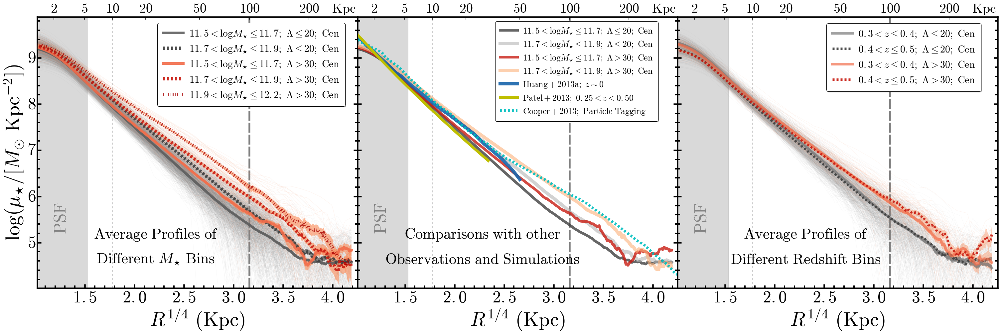

In [89]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.25
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#
label1="$11.5 < \log{M_{\star}} \leq 11.7;\ \lambda > 30;\ \mathrm{Cen}$"
label2="$11.7 < \log{M_{\star}} \leq 11.9;\ \lambda > 30;\ \mathrm{Cen}$"
label3="$11.9 < \log{M_{\star}} \leq 12.2;\ \lambda > 30;\ \mathrm{Cen}$"

label4="$11.5 < \log{M_{\star}} \leq 11.7;\ \lambda \leq 20;\ \mathrm{Cen}$"
label5="$11.7 < \log{M_{\star}} \leq 11.9;\ \lambda \leq 20;\ \mathrm{Cen}$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}$'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(42, 14))
fig.subplots_adjust(left=0.04, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(131)
ax1 = songPlotSetup(ax1, ylabel=50, xlabel=50, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for dd in nm1_sm:
    ax1.plot(RSMA_COMMON, dd, c=color1a, alpha=0.05, linewidth=1.0)
for ee in nm2_sm:
    ax1.plot(RSMA_COMMON, ee, c=color1a, alpha=0.05, linewidth=1.0)
    
for aa in rm1_sm:
    ax1.plot(RSMA_COMMON, aa, c=color2a, alpha=0.08, linewidth=1.0)
for bb in rm2_sm:
    ax1.plot(RSMA_COMMON, bb, c=color2a, alpha=0.08, linewidth=1.2)
for cc in rm3_sm:
    ax1.plot(RSMA_COMMON, cc, c=color2a, alpha=0.08, linewidth=1.4)
# --------------------------------------------------------------------------------------- #
## Median profiles
ax1.fill_between(RSMA_COMMON, nm1_amg[0], nm1_amg[1], 
                 c=cmap1(0.80), edgecolor='none', alpha=0.6, 
                 zorder=5, label=None)

ax1.fill_between(RSMA_COMMON, nm2_amg[0], nm2_amg[1], 
                 c=cmap1(0.80), edgecolor='none', alpha=0.6, 
                 zorder=6, label=None)

ax1.fill_between(RSMA_COMMON, rm1_amg[0], rm1_amg[1], 
                 c=cmap2(0.50), edgecolor='none', alpha=0.6, 
                 zorder=5, label=None)

ax1.fill_between(RSMA_COMMON, rm2_amg[0], rm2_amg[1], 
                 c=cmap2(0.50), edgecolor='none', alpha=0.6, 
                 zorder=6, label=None)

ax1.fill_between(RSMA_COMMON, rm3_amg[0], rm3_amg[1], 
                 c=cmap2(0.50), edgecolor='none', alpha=0.6, 
                 zorder=6, label=None)

ax1.plot(RSMA_COMMON, nm1_amg[2], linestyle='-', linewidth=8.0, 
         c=cmap1(0.7), alpha=0.9, zorder=7, label=label4)

ax1.plot(RSMA_COMMON, nm2_amg[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.8), alpha=0.9, zorder=7, label=label5)

ax1.plot(RSMA_COMMON, rm1_amg[2], linestyle='-', linewidth=8.0, 
         c=cmap2(0.6), alpha=0.9, zorder=8, label=label1)

ax1.plot(RSMA_COMMON, rm2_amg[2], linestyle='--', linewidth=10.0, 
         c=cmap2(0.8), alpha=0.9, zorder=8, label=label2)

ax1.plot(RSMA_COMMON, rm3_amg[2], linestyle='-.', linewidth=10.0, 
         c=cmap2(0.9), alpha=0.8, zorder=8, label=label3)
# --------------------------------------------------------------------------------------- #
## Y Lables
if norm:
    ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                   size=41)
else:
    ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=60)
    
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 c='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)
# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax1.legend(loc=(0.375, 0.67), shadow=True, fancybox=True, 
               numpoints=1, fontsize=30, scatterpoints=1, 
               markerscale=1.2, borderpad=0.6, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(xmin, xmax)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=40)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax2.text(0.92, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=40.0, transform=ax2.transAxes)
# --------------------------------------------------------------------------------------- #
ax1.text(0.37, 0.17, '$\mathrm{Average\ Profiles\ of}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=45.0, transform=ax1.transAxes)
ax1.text(0.37, 0.08, '$\mathrm{Different\ }M_{\star}\ \mathrm{Bins}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=45.0, transform=ax1.transAxes)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #
# --------------------------------------------------------------------------------------- #

vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.25
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#
label1="$11.5 < \log{M_{\star}} \leq 11.7;\ \lambda > 30;\ \mathrm{Cen}$"
label2="$11.7 < \log{M_{\star}} \leq 11.9;\ \lambda > 30;\ \mathrm{Cen}$"
label3="$11.9 < \log{M_{\star}} \leq 12.2;\ \lambda > 30;\ \mathrm{Cen}$"

label4="$11.5 < \log{M_{\star}} \leq 11.7;\ \lambda \leq 20;\ \mathrm{Cen}$"
label5="$11.7 < \log{M_{\star}} \leq 11.9;\ \lambda \leq 20;\ \mathrm{Cen}$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}$'
ytickFormat2='$\mathbf{%g}$'

ax3 = fig.add_subplot(132)
ax3 = songPlotSetup(ax3, ylabel=50, xlabel=50, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Median profiles
ax3.plot(RSMA_COMMON, nm1_amg[2], linestyle='-', linewidth=8.0, 
         c=cmap1(0.8), alpha=0.8, zorder=7, label=label4)

ax3.plot(RSMA_COMMON, nm2_amg[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.4), alpha=0.6, zorder=7, label=label5)

ax3.plot(RSMA_COMMON, rm1_amg[2], linestyle='-', linewidth=8.0, 
         c=cmap2(0.8), alpha=0.8, zorder=8, label=label1)

ax3.plot(RSMA_COMMON, rm2_amg[2], linestyle='-', linewidth=10.0, 
         c=cmap2(0.4), alpha=0.6, zorder=8, label=label2)

# --------------------------------------------------------------------------------------- #
## Y Lables
ax3.yaxis.set_major_formatter(NullFormatter())
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(xmin, xmax)
ax3.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 c='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax3.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax3.transAxes, weight='bold', 
         color='k', alpha=0.4)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax4 = ax3.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax4.set_xlim(xmin, xmax)
ax4.set_xticks(kpcTicks)
ax4.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=40)
for tick in ax4.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax4.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax4.text(0.92, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=40.0, transform=ax4.transAxes)
# --------------------------------------------------------------------------------------- #
ax3.plot(cgs_mprof_full['col1'] ** 0.25, cgs_mprof_full['col2'] + 0.10, 
         linestyle='-', c=BLU(0.8), 
         linewidth=10.0, alpha=0.9, zorder=11, 
         label='$\mathrm{Huang+2013a};\ z\sim 0$')
#ax3.plot(cgs_mprof_inner['col1'] ** 0.25, cgs_mprof_inner['col2'], linestyle='-', c='orange',
#         linewidth=5.0, alpha=0.8, zorder=12)
#ax3.plot(cgs_mprof_outer['col1'] ** 0.25, cgs_mprof_outer['col2'], linestyle='-', c='cyan', 
#         linewidth=5.0, alpha=0.8, zorder=13)


ax3.plot(patel10_mprof['rkpc'] ** 0.25, patel10_mprof['z0'] + 0.10, 
         linestyle='-', c='y',
         linewidth=8.0, alpha=1.0, zorder=13,
         label='$\mathrm{Patel+2013};\ 0.25< z < 0.50$')
#ax3.plot(patel10_mprof['rkpc'] ** 0.25, patel10_mprof['z1'] + 0.10, 
#         linestyle='--', c='y',
#         linewidth=8.0, alpha=1.0, zorder=13)
#ax.plot(patel10_mprof['rkpc'], patel10_mprof['z2'], linestyle='-', c=GRN(0.7))
#ax3.plot(patel10_mprof['rkpc'] ** 0.25, patel10_mprof['z3'], linestyle='-', c=GRN(0.6),
#         linewidth=5.0, alpha=0.5)
#ax.plot(patel10_mprof['rkpc'], patel10_mprof['z4'], linestyle='-', c=PUR(0.6))
#ax3.plot(patel10_mprof['rkpc'] ** 0.25, patel10_mprof['z5'], linestyle='-', c=PUR(0.7),
#         linewidth=5.0, alpha=0.5)
#ax3.plot(patel10_mprof['rkpc'] ** 0.25, patel10_mprof['z6'], linestyle='-', c=PUR(0.8),
#         linewidth=5.0, alpha=0.5)

ax3.plot((10.0 ** cooper13_mprof_all['col1']) ** 0.25, cooper13_mprof_all['col2'] + 0.10, 
         linewidth=8.0, alpha=0.9, linestyle='--', c='c', zorder=12, 
         label='$\mathrm{Cooper+2013;\ Particle\ Tagging}$')
#ax3.plot((10.0 ** cooper13_mprof_ins['col1']) ** 0.25, cooper13_mprof_ins['col2'], 
#         linestyle='--', c='r', linewidth=5.0, alpha=0.8)
#ax3.plot((10.0 ** cooper13_mprof_acc['col1']) ** 0.25, cooper13_mprof_acc['col2'], 
#         linestyle='--', c='b', linewidth=5.0, alpha=0.8)

# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax3.legend(loc=(0.43, 0.615), shadow=True, fancybox=True, 
               numpoints=1, fontsize=26, scatterpoints=1, 
               markerscale=1.2, borderpad=0.6, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
ax3.text(0.39, 0.17, '$\mathrm{Comparisons\ with\ other}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=45.0, transform=ax3.transAxes)
ax3.text(0.39, 0.08, '$\mathrm{Observations\ and\ Simulations}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=45.0, transform=ax3.transAxes)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #
# --------------------------------------------------------------------------------------- #
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.25
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#
label1="$0.3 < z \leq 0.4;\ \lambda > 30;\ \mathrm{Cen}$"
label2="$0.4 < z \leq 0.5;\ \lambda > 30;\ \mathrm{Cen}$"

label3="$0.3 < z \leq 0.4;\ \lambda \leq 20;\ \mathrm{Cen}$"
label4="$0.4 < z \leq 0.5;\ \lambda \leq 20;\ \mathrm{Cen}$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}$'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
ax5 = fig.add_subplot(133)
ax5 = songPlotSetup(ax5, ylabel=50, xlabel=50, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax5.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax5.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for dd in nz1_sm:
    ax5.plot(RSMA_COMMON, dd, c=color1a, alpha=0.05, linewidth=1.0)
for ee in nz2_sm:
    ax5.plot(RSMA_COMMON, ee, c=color1a, alpha=0.05, linewidth=1.0)
    
for aa in rz1_sm:
    ax5.plot(RSMA_COMMON, aa, c=color2a, alpha=0.08, linewidth=1.0)
for bb in rz2_sm:
    ax5.plot(RSMA_COMMON, bb, c=color2a, alpha=0.08, linewidth=1.2)
# --------------------------------------------------------------------------------------- #
## Median profiles
ax5.fill_between(RSMA_COMMON, nz1_amg[0], nz1_amg[1], 
                 c=cmap1(0.80), edgecolor='none', alpha=0.4, 
                 zorder=5, label=None)

ax5.fill_between(RSMA_COMMON, nz2_amg[0], nz2_amg[1], 
                 c=cmap1(0.80), edgecolor='none', alpha=0.4, 
                 zorder=6, label=None)

ax5.fill_between(RSMA_COMMON, rz1_amg[0], rz1_amg[1], 
                 c=cmap2(0.50), edgecolor='none', alpha=0.4, 
                 zorder=5, label=None)

ax5.fill_between(RSMA_COMMON, rz2_amg[0], rz2_amg[1], 
                 c=cmap2(0.50), edgecolor='none', alpha=0.4, 
                 zorder=6, label=None)

ax5.plot(RSMA_COMMON, nz1_amg[2], linestyle='-', linewidth=8.0, 
         c=cmap1(0.6), alpha=0.7, zorder=7, label=label3)

ax5.plot(RSMA_COMMON, nz2_amg[2], linestyle='--', linewidth=7.0, 
         c=cmap1(0.8), alpha=0.9, zorder=7, label=label4)

ax5.plot(RSMA_COMMON, rz1_amg[2], linestyle='-', linewidth=8.0, 
         c=cmap2(0.6), alpha=0.7, zorder=8, label=label1)

ax5.plot(RSMA_COMMON, rz2_amg[2], linestyle='--', linewidth=7.0, 
         c=cmap2(0.8), alpha=0.9, zorder=8, label=label2)
# --------------------------------------------------------------------------------------- #
ax5.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
ax5.yaxis.set_major_formatter(NullFormatter())
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax5.set_xlim(xmin, xmax)
ax5.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax5.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 c='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax5.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax5.transAxes, weight='bold', 
         color='k', alpha=0.4)
# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax5.legend(loc=(0.465, 0.725), shadow=True, fancybox=True, 
               numpoints=1, fontsize=30, scatterpoints=1, 
               markerscale=1.2, borderpad=0.6, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax6 = ax5.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax6.set_xlim(xmin, xmax)
ax6.set_xticks(kpcTicks)
ax6.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=40)
for tick in ax6.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax6.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax6.text(0.92, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=40.0, transform=ax6.transAxes)
# --------------------------------------------------------------------------------------- #
ax5.text(0.40, 0.17, '$\mathrm{Average\ Profiles\ of}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=45.0, transform=ax5.transAxes)
ax5.text(0.40, 0.08, '$\mathrm{Different\ Redshift\ Bins}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=45.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #
# --------------------------------------------------------------------------------------- #

fig.savefig(os.path.join(figDir, 'average_mass_profiles_fsps1.pdf'), dpi=160)

plt.show()

# Match the subsamples better

## No Detailed Match

In [71]:
sampleM100x = 'matchX_m100_' + sedMod
sampleM10x = 'matchX_m10_' + sedMod

redbcgM100x = redbcgClean[(redbcgClean['logm_100'] >= 11.5) &
                          (redbcgClean['logm_100'] <= 11.9) &
                          (redbcgClean['z_use'] <= 0.5) &
                          (redbcgClean['z_use'] >= 0.3) &
                          (redbcgClean['lambda_redm'] >= 25.0) &
                          (redbcgClean['p_cen_1_redm'] >= 0.7)]
print("# %d objects in this sample" % len(redbcgM100x))

nonbcgM100x = nonbcgClean[(nonbcgClean['logm_100'] >= 11.5) &
                          (nonbcgClean['logm_100'] <= 11.9) &
                          (nonbcgClean['z_use'] <= 0.5) &
                          (nonbcgClean['z_use'] >= 0.3)]
print("# %d objects in this sample" % len(nonbcgM100x))

redbcgM10x = redbcgClean[(redbcgClean['logm_10'] >= 11.1) &
                         (redbcgClean['logm_10'] <= 11.6) &
                         (redbcgClean['z_use'] <= 0.5) &
                         (redbcgClean['z_use'] >= 0.3) &
                         (redbcgClean['lambda_redm'] >= 25.0) &
                         (redbcgClean['p_cen_1_redm'] >= 0.7)]
print("# %d objects in this sample" % len(redbcgM10x))

nonbcgM10x = nonbcgClean[(nonbcgClean['logm_10'] >= 11.1) &
                         (nonbcgClean['logm_10'] <= 11.6) &
                         (nonbcgClean['z_use'] <= 0.5) &
                         (nonbcgClean['z_use'] >= 0.3)]
print("# %d objects in this sample" % len(nonbcgM10x))

redbcgM100x.write(os.path.join(sampleDir, 'redBCG_' + sampleM100x + '.fits'), format='fits', 
                  overwrite=True)
redbcgM10x.write(os.path.join(sampleDir, 'redBCG_' + sampleM10x + '.fits'), format='fits', 
                 overwrite=True)
nonbcgM100x.write(os.path.join(sampleDir, 'nonBCG_' + sampleM100x + '.fits'), format='fits', 
                  overwrite=True)
nonbcgM10x.write(os.path.join(sampleDir, 'nonBCG_' + sampleM10x + '.fits'), format='fits', 
                 overwrite=True)

# 71 objects in this sample
# 601 objects in this sample
# 85 objects in this sample
# 1639 objects in this sample


## Matched using logM_100 (Mass within 100 Kpc aperture)


#-----------------------------------------------------------------------------#
# Sample 1 Size:  28
# Sample 2 Size:  70
# All and Unique Matched Sample 143 57


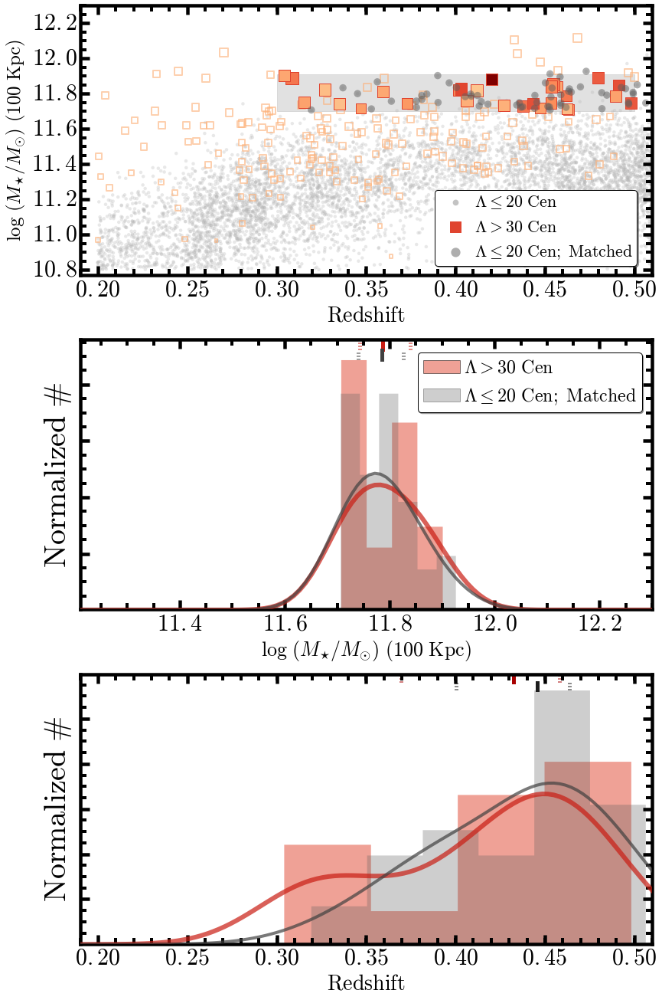

In [73]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.7
m100_1, m100_2, m100_3 = 11.50, 11.70, 11.91
z_1, z_2 = 0.30, 0.50

sampleM100b = 'matchA2_m100_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM100b, nonbcgM100b = kdtreeMatch(redbcgClean, nonbcgClean, 
                                       name=sampleM100b,
                                       mlim1=m100_2, mlim2=m100_3, zlim1=z_1, zlim2=z_2, 
                                       massCol='logm_100', zCol='z_use', 
                                       k1=3, k2=11, k3=3, k4=6, leaf=7,
                                       lamLimit=lamLimit, lamCol='lambda_redm', 
                                       pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                       massCut=(m100_2 + m100_3)/2.0, zCut=0.36, 
                                       massMargin1=0.005, massMargin2=0.08, 
                                       zMargin1=0.001, zMargin2=+0.02,
                                       unique=True, ballTree=False, metric='l1',
                                       folder=sampleDir, figDir=figDir,
                                       xtickFormat='$\mathbf{%4.1f}$', 
                                       ytickFormat='$\mathbf{%4.1f}$',
                                       zKernel=0.03)

#-----------------------------------------------------------------------------#
# Sample 1 Size:  50
# Sample 2 Size:  982
# All and Unique Matched Sample 258 138


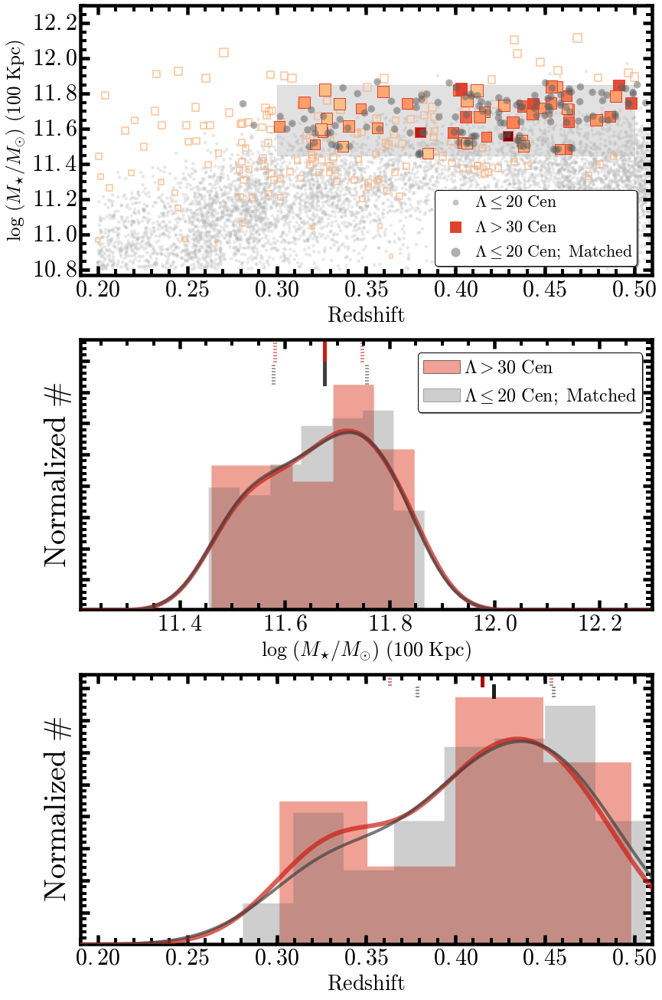

In [81]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.70
m100_1, m100_2, m100_3 = 11.45, 11.70, 11.85
z_1, z_2 = 0.30, 0.50

sampleM100c = 'matchA_m100_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM100c, nonbcgM100c = kdtreeMatch(redbcgClean, nonbcgClean, 
                                       name=sampleM100c,
                                       mlim1=m100_1, mlim2=m100_3, zlim1=z_1, zlim2=z_2, 
                                       massCol='logm_100', zCol='z_use', 
                                       k1=3, k2=15, k3=3, k4=11, leaf=7,
                                       lamLimit=lamLimit, lamCol='lambda_redm', 
                                       pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                       massCut=11.75, zCut=0.36, 
                                       massMargin1=0.005, massMargin2=0.040, 
                                       zMargin1=-0.03, zMargin2=0.02,
                                       unique=True, ballTree=False, metric='l1',
                                       folder=sampleDir, figDir=figDir,
                                       xtickFormat='$\mathbf{%4.1f}$', 
                                       ytickFormat='$\mathbf{%4.1f}$',
                                       zKernel=0.03)

#-----------------------------------------------------------------------------#
# Sample 1 Size:  70
# Sample 2 Size:  633
# All and Unique Matched Sample 395 191


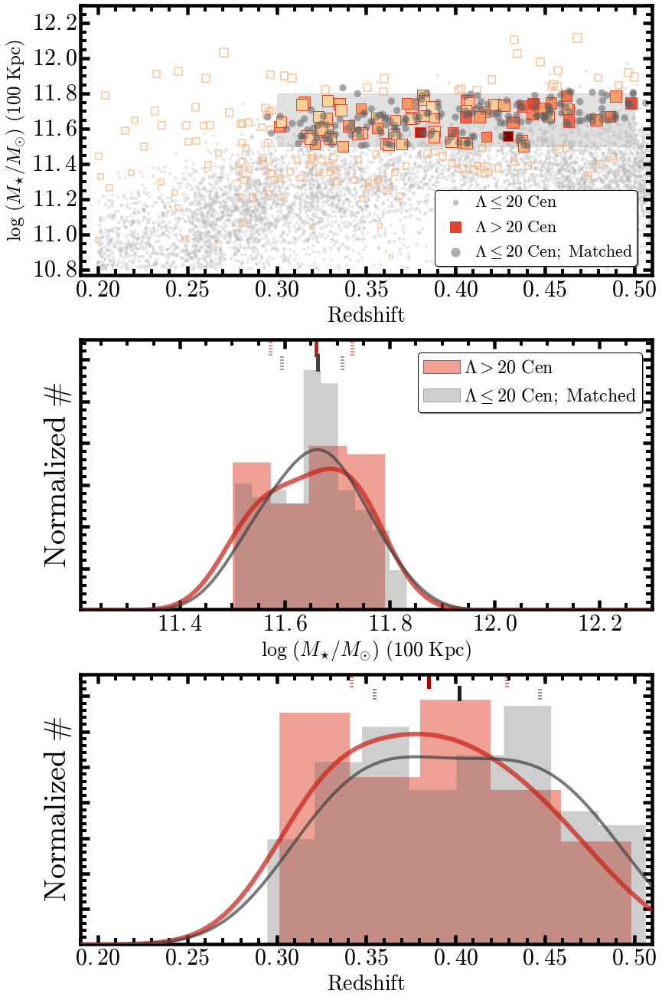

In [87]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 20.0, 0.7
m100_1, m100_2, m100_3 = 11.50, 11.70, 11.80
z_1, z_2 = 0.30, 0.50

sampleM100d = 'matchB_m100_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM100d, nonbcgM100d = kdtreeMatch(redbcgClean, nonbcgClean, 
                                       name=sampleM100d,
                                       mlim1=m100_1, mlim2=m100_3, zlim1=z_1, zlim2=z_2, 
                                       massCol='logm_100', zCol='z_use', 
                                       k1=3, k2=11, k3=2, k4=6, leaf=7,
                                       lamLimit=lamLimit, lamCol='lambda_redm', 
                                       pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                       massCut=11.60, zCut=0.36, 
                                       massMargin1=0.005, massMargin2=0.04, 
                                       zMargin1=-0.01, zMargin2=0.02,
                                       unique=True, ballTree=False, metric='l1',
                                       folder=sampleDir, figDir=figDir,
                                       xtickFormat='$\mathbf{%4.1f}$', 
                                       ytickFormat='$\mathbf{%4.1f}$',
                                       zKernel=0.03)

## Matched using logM_10 (Mass within 10 Kpc aperture)

#-----------------------------------------------------------------------------#
# Sample 1 Size:  42
# Sample 2 Size:  1499
# All and Unique Matched Sample 333 298


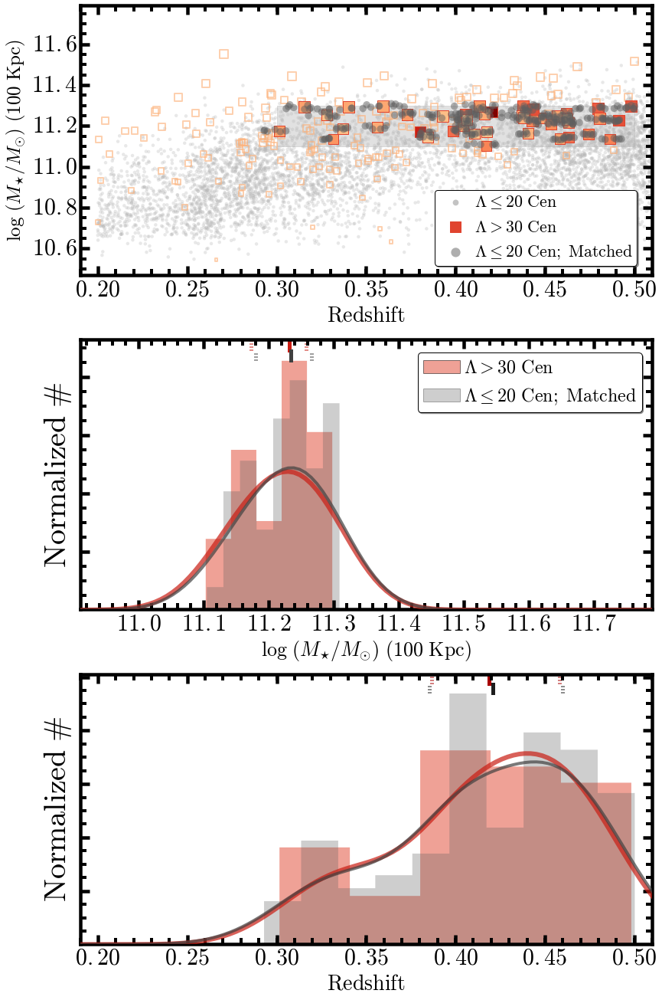

In [90]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.7
m10_1, m10_2, m10_3 = 11.10, 11.30, 11.50
z_1, z_2 = 0.30, 0.50
mmin, mmax = 10.91, 11.79

sampleM10a = 'matchA1_m10_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM10a, nonbcgM10a = kdtreeMatch(redbcgClean, nonbcgClean, 
                                     name=sampleM10a, 
                                     mlim1=m10_1, mlim2=m10_2, zlim1=z_1, zlim2=z_2, 
                                     massCol='logm_10', zCol='z_use', 
                                     k1=6, k2=9, k3=6, k4=9, leaf=7,
                                     lamLimit=lamLimit, lamCol='lambda_redm', 
                                     pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                     massCut=(m10_1 + m10_2)/2.0, zCut=0.36, 
                                     massMargin1=0.005, massMargin2=0.015, 
                                     zMargin1=-0.01, zMargin2=0.001,
                                     unique=True, ballTree=False, metric='l1', 
                                     mmin=mmin, mmax=mmax,
                                     folder=sampleDir, figDir=figDir,
                                     xtickFormat='$\mathbf{%4.1f}$', 
                                     ytickFormat='$\mathbf{%4.1f}$')

#-----------------------------------------------------------------------------#
# Sample 1 Size:  21
# Sample 2 Size:  190
# All and Unique Matched Sample 137 95


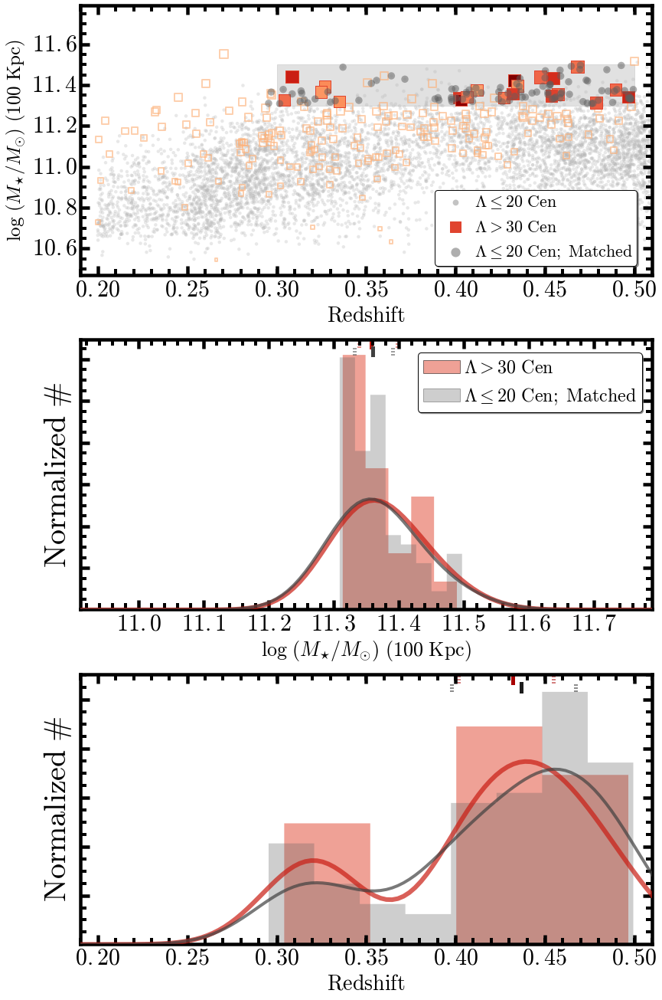

In [92]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.7
m10_1, m10_2, m10_3 = 11.10, 11.30, 11.50
z_1, z_2 = 0.30, 0.50
mmin, mmax = 10.91, 11.79

sampleM10b = 'matchA2_m10_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM10b, nonbcgM10b = kdtreeMatch(redbcgClean, nonbcgClean, 
                                     name=sampleM10b,
                                     mlim1=m10_2, mlim2=m10_3, zlim1=z_1, zlim2=z_2, 
                                     massCol='logm_10', zCol='z_use', 
                                     k1=5, k2=9, k3=6, k4=9, leaf=7,
                                     lamLimit=lamLimit, lamCol='lambda_redm', 
                                     pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                     massCut=(m10_2 + m10_3)/2.0, zCut=0.36, 
                                     massMargin1=0.005, massMargin2=0.015, 
                                     zMargin1=-0.01, zMargin2=0.001,
                                     unique=True, ballTree=False, metric='l1', 
                                     mmin=mmin, mmax=mmax,
                                     folder=sampleDir, figDir=figDir,
                                     xtickFormat='$\mathbf{%4.1f}$', 
                                     ytickFormat='$\mathbf{%4.1f}$')

#-----------------------------------------------------------------------------#
# Sample 1 Size:  63
# Sample 2 Size:  1666
# All and Unique Matched Sample 478 396


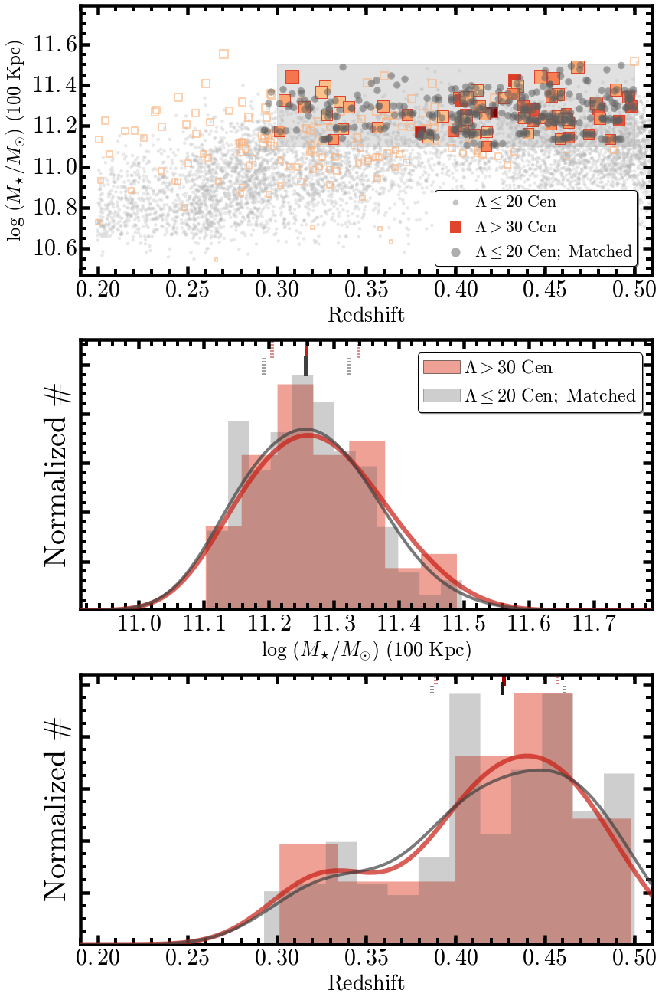

In [94]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.7
m10_1, m10_2, m10_3 = 11.10, 11.30, 11.50
z_1, z_2 = 0.30, 0.50
mmin, mmax = 10.91, 11.79

sampleM10c = 'matchA_m10_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM10c, nonbcgM10c = kdtreeMatch(redbcgClean, nonbcgClean, 
                                     name=sampleM10c,
                                     mlim1=m10_1, mlim2=m10_3, zlim1=z_1, zlim2=z_2, 
                                     massCol='logm_10', zCol='z_use', 
                                     k1=7, k2=8, k3=7, k4=9, leaf=7,
                                     lamLimit=lamLimit, lamCol='lambda_redm', 
                                     pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                     massCut=(m10_1 + m10_3)/2.0, zCut=0.36, 
                                     massMargin1=0.005, massMargin2=0.015, 
                                     zMargin1=-0.01, zMargin2=0.001,
                                     unique=True, ballTree=False, metric='l1', 
                                     mmin=mmin, mmax=mmax,
                                     folder=sampleDir, figDir=figDir,
                                     xtickFormat='$\mathbf{%4.1f}$', 
                                     ytickFormat='$\mathbf{%4.1f}$')

### Try match logm_10 and logm_15 at the same time

#-----------------------------------------------------------------------------#
# Sample 1 Size:  63
# Sample 2 Size:  1608
# All and Unique Matched Sample 425 316


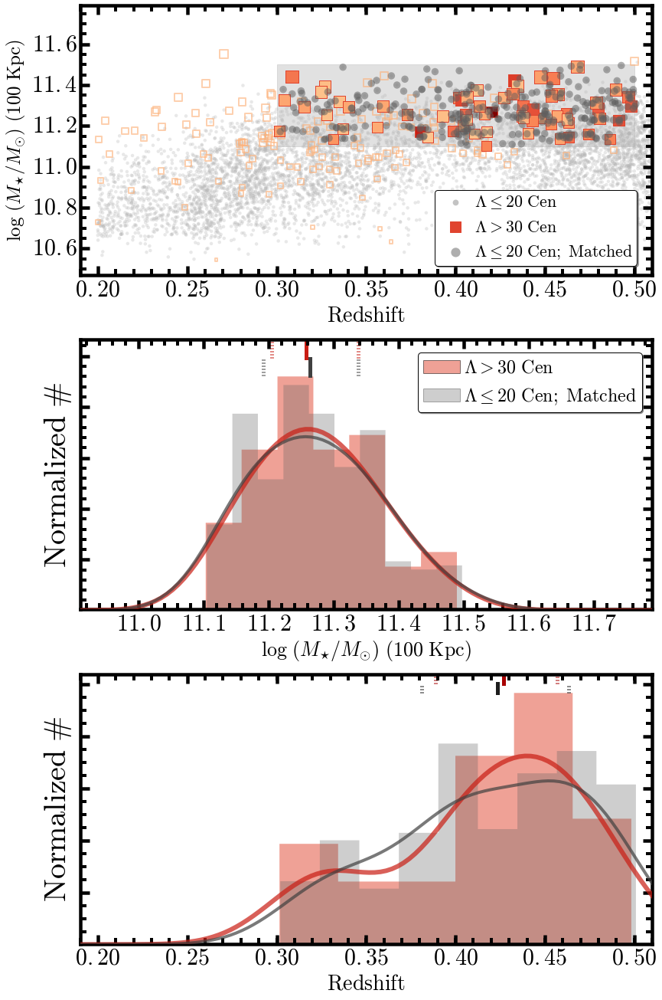

In [95]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.7
m10_1, m10_2, m10_3 = 11.10, 11.30, 11.50
z_1, z_2 = 0.30, 0.50
mmin, mmax = 10.91, 11.79

sampleM10d = 'matchB_m10_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM10d, nonbcgM10d = kdtreeMatch(redbcgClean, nonbcgClean, 
                                     name=sampleM10d,
                                     mlim1=m10_1, mlim2=m10_3, zlim1=z_1, zlim2=z_2, 
                                     massCol='logm_10', zCol='z_use', 
                                     k1=6, k2=9, k3=6, k4=8, leaf=7,
                                     lamLimit=lamLimit, lamCol='lambda_redm', 
                                     pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                     massCut=(m10_1 + m10_3)/2.0, zCut=0.38, 
                                     massMargin1=0.005, massMargin2=0.015, 
                                     zMargin1=0.001, zMargin2=0.001,
                                     unique=True, ballTree=False, metric='l1', 
                                     mmin=mmin, mmax=mmax, mass2='logm_15',
                                     folder=sampleDir, figDir=figDir,
                                     xtickFormat='$\mathbf{%4.1f}$', 
                                     ytickFormat='$\mathbf{%4.1f}$')

## Match the redMem and nonBCG samples

#-----------------------------------------------------------------------------#
# Sample 1 Size:  55
# Sample 2 Size:  1992
# All and Unique Matched Sample 376 319


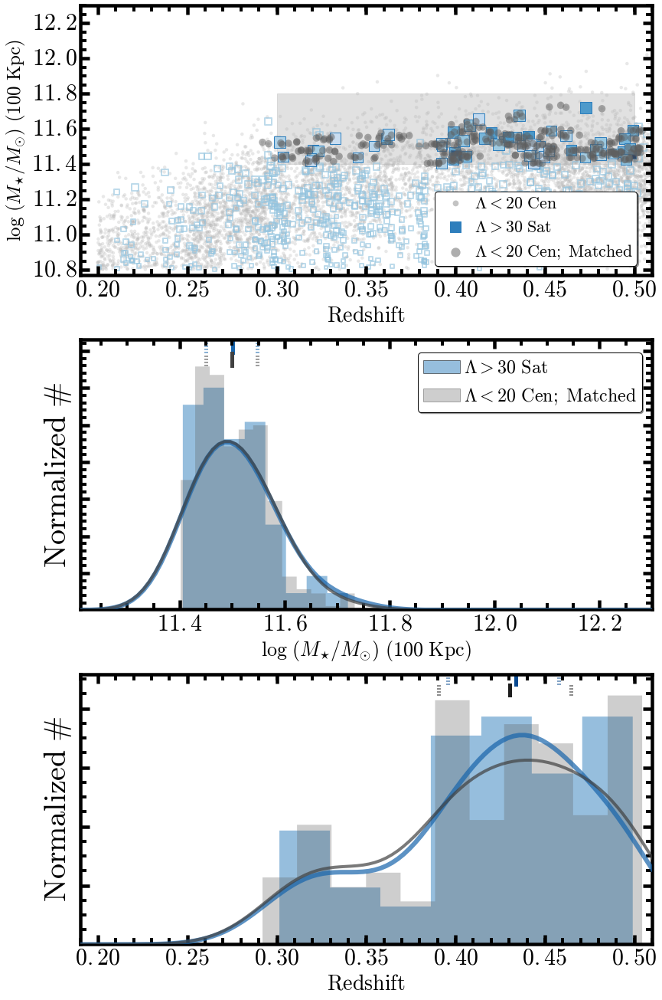

In [98]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.7
m100_1, m100_2 = 11.40, 11.80
z_1, z_2 = 0.30, 0.50

sampleM100h = 'matchH_m100_' + sedMod
print("#-----------------------------------------------------------------------------#")
redmemM100h, nonbcgM100h = kdtreeMatch(redmemClean, nonbcgClean, 
                                       name=sampleM100h, 
                                       mlim1=m100_1, mlim2=m100_2, zlim1=z_1, zlim2=z_2, 
                                       massCol='logm_100', zCol='z_use', 
                                       k1=7, k2=4, k3=7, k4=5, leaf=9,
                                       lamLimit=lamLimit, lamCol='lambda_redm', 
                                       pcenLimit=pcenLimit, pcenCol='p_mem_redm', 
                                       massCut=11.65, zCut=None, 
                                       massMargin1=-0.08, massMargin2=-0.015, 
                                       zMargin1=-0.01, zMargin2=0.005,
                                       unique=True, ballTree=False, metric='l1',
                                       folder=sampleDir, figDir=figDir,
                                       xtickFormat='$\mathbf{%4.1f}$', 
                                       ytickFormat='$\mathbf{%4.1f}$',
                                       prefix1='redMem', prefix2='nonBCG',
                                       color2a=BLU(0.4), color2b=BLU(0.7), cmap2=BLU, 
                                       color1a=BLK(0.4), color1b=BLK(0.7), cmap1=BLK, 
                                       legend2='$\lambda > %d\ \mathrm{Sat}$',
                                       legend1='$\lambda < 20\ \mathrm{Cen}$',
                                       legend3='$\lambda < 20\ \mathrm{Cen;\ Matched}$')

#-----------------------------------------------------------------------------#
# Sample 1 Size:  74
# Sample 2 Size:  1727
# All and Unique Matched Sample 370 324


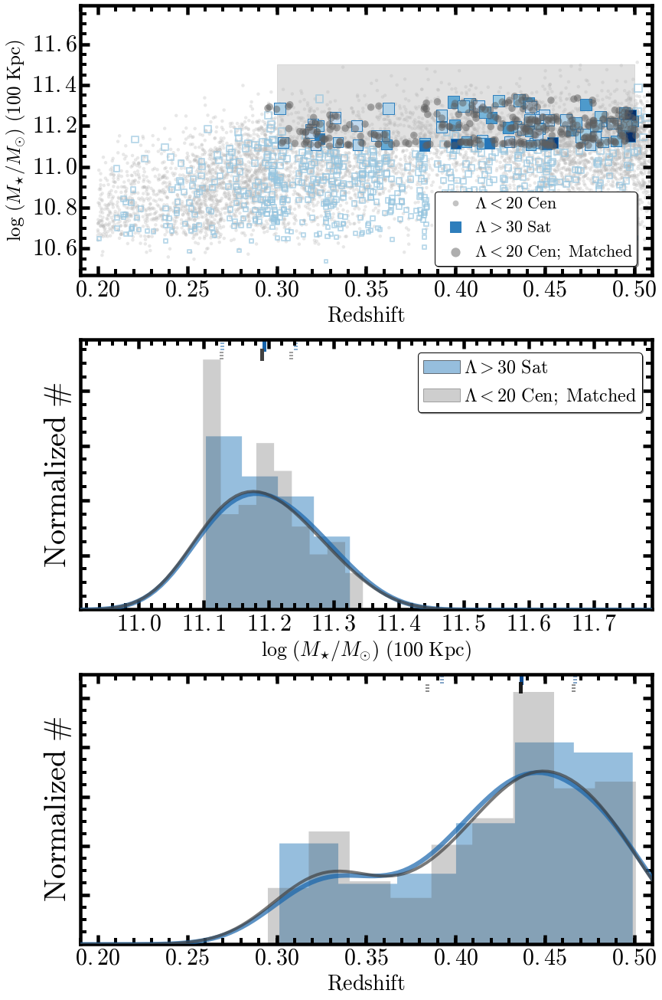

In [100]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.7
m10_1, m10_2 = 11.10, 11.50
z_1, z_2 = 0.30, 0.50
mmin, mmax = 10.91, 11.79

sampleM10h = 'matchH_m10_' + sedMod
print("#-----------------------------------------------------------------------------#")
redmemM10h, nonbcgM10h = kdtreeMatch(redmemClean, nonbcgClean, 
                                       name=sampleM10h, 
                                       mlim1=m10_1, mlim2=m10_2, zlim1=z_1, zlim2=z_2, 
                                       massCol='logm_10', zCol='z_use', 
                                       k1=5, k2=5, k3=7, k4=5, leaf=9,
                                       lamLimit=lamLimit, lamCol='lambda_redm', 
                                       pcenLimit=pcenLimit, pcenCol='p_mem_redm', 
                                       massCut=11.30, zCut=None, 
                                       massMargin1=-0.001, massMargin2=0.015, 
                                       zMargin1=-0.01, zMargin2=0.001,
                                       unique=True, ballTree=False, metric='l1',
                                       folder=sampleDir, figDir=figDir,
                                       xtickFormat='$\mathbf{%4.1f}$', 
                                       ytickFormat='$\mathbf{%4.1f}$',
                                       prefix1='redMem', prefix2='nonBCG',
                                       color2a=BLU(0.4), color2b=BLU(0.7), cmap2=BLU, 
                                       color1a=BLK(0.4), color1b=BLK(0.7), cmap1=BLK, 
                                       mmin=mmin, mmax=mmax, mass2='logm_15',
                                       legend2='$\lambda > %d\ \mathrm{Sat}$',
                                       legend1='$\lambda < 20\ \mathrm{Cen}$',
                                       legend3='$\lambda < 20\ \mathrm{Cen;\ Matched}$')

## Match redBCG and nonBCG using logMs_GAMA

#-----------------------------------------------------------------------------#


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:347: RuntimeWarning: invalid value encountered in greater_equal
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:347: RuntimeWarning: invalid value encountered in less_equal


# Sample 1 Size:  25
# Sample 2 Size:  403


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:360: RuntimeWarning: invalid value encountered in greater_equal
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:360: RuntimeWarning: invalid value encountered in less_equal


# All and Unique Matched Sample 169 107


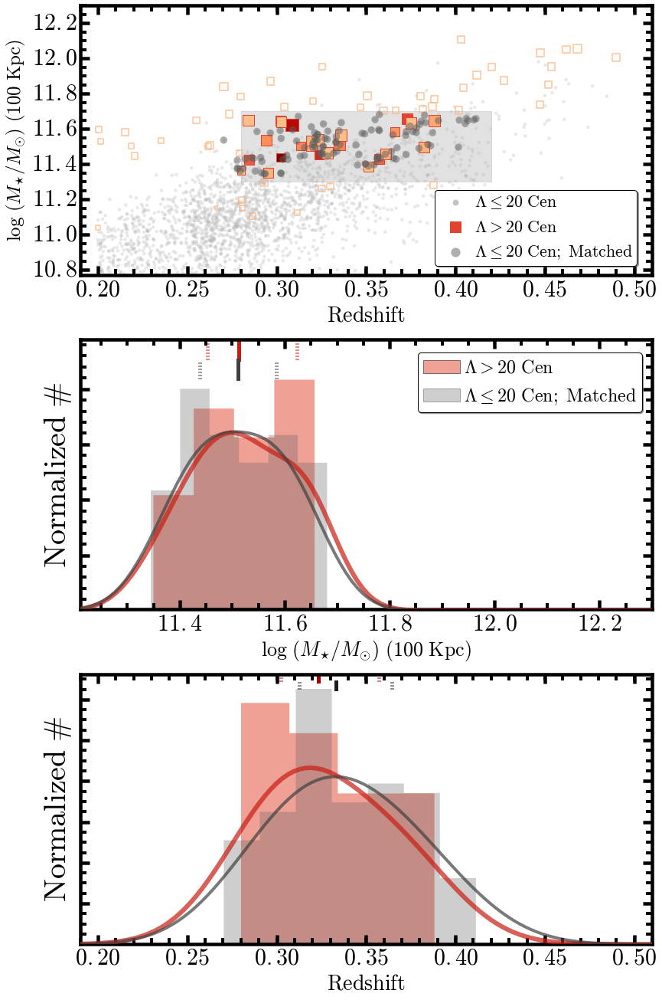

In [101]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 20.0, 0.7
m100_1, m100_2, m100_3 = 11.30, 11.70, 11.70
z_1, z_2 = 0.28, 0.42

sampleM100i = 'matchI_m100_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM100i, nonbcgM100i = kdtreeMatch(redbcgClean, nonbcgClean, 
                                       name=sampleM100i,
                                       mlim1=m100_1, mlim2=m100_3, zlim1=z_1, zlim2=z_2, 
                                       massCol='logms_gama', zCol='z_use', 
                                       k1=5, k2=11, k3=5, k4=9, leaf=7,
                                       lamLimit=lamLimit, lamCol='lambda_redm', 
                                       pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                       massCut=11.55, zCut=0.33, 
                                       massMargin1=0.005, massMargin2=0.010, 
                                       zMargin1=-0.01, zMargin2=-0.001,
                                       unique=True, ballTree=False, metric='l1',
                                       folder=sampleDir, figDir=figDir,
                                       xtickFormat='$\mathbf{%4.1f}$', 
                                       ytickFormat='$\mathbf{%4.1f}$',
                                       zKernel=0.03)

## !! LOAD the available subsamples if possible !! 

In [163]:
lamLimit, pcenLimit = 30.0, 0.7

sampleM100x = 'matchX_m100_' + sedMod
sampleM100a = 'matchA1_m100_' + sedMod
sampleM100b = 'matchA2_m100_' + sedMod
sampleM100c = 'matchA_m100_' + sedMod
sampleM100d = 'matchB_m100_' + sedMod
sampleM100e = 'matchC_m100_' + sedMod
sampleM100f = 'matchD_m100_' + sedMod
sampleM100g = 'matchG_m100_' + sedMod
sampleM100h = 'matchH_m100_' + sedMod
sampleM100i = 'matchI_m100_' + sedMod
sampleM100j = 'matchJ_m100_' + sedMod
sampleM100k = 'matchK_m100_' + sedMod
sampleM100l = 'matchL_m100_' + sedMod

sampleM10x = 'matchX_m10_' + sedMod
sampleM10a = 'matchA1_m10_' + sedMod
sampleM10b = 'matchA2_m10_' + sedMod
sampleM10c = 'matchA_m10_' + sedMod
sampleM10d = 'matchB_m10_' + sedMod
sampleM10f = 'matchD_m10_' + sedMod
sampleM10g = 'matchG_m10_' + sedMod
sampleM10h = 'matchH_m10_' + sedMod

try: 
    redbcgM100x = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100x + '.fits'),
                             format='fits')
    nonbcgM100x = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100x + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100x, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100x, sedMod))
    
try: 
    redbcgM100a = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100a + '.fits'),
                             format='fits')
    nonbcgM100a = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100a + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100a, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100a, sedMod))
    
try:
    redbcgM100b = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100b + '.fits'),
                             format='fits')
    nonbcgM100b = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100b + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100b, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100b, sedMod))
    
try:
    redbcgM100c = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100c + '.fits'),
                             format='fits')
    nonbcgM100c = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100c + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100c, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100c, sedMod))
    
try:
    redbcgM100d = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100d + '.fits'),
                             format='fits')
    nonbcgM100d = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100d + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100d, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100d, sedMod))

try:
    redbcgM100e = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100e + '.fits'),
                             format='fits')
    nonbcgM100e = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100e + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100e, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100e, sedMod))

try:
    redbcgM100f = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100f + '.fits'),
                             format='fits')
    nonbcgM100f = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100f + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100f, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100f, sedMod))
    
try:
    redbcgM100j = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100j + '.fits'),
                             format='fits')
    nonbcgM100j = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100j + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100j, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100j, sedMod))
    
try:
    redbcgM100k = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100k + '.fits'),
                             format='fits')
    nonbcgM100k = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100k + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100k, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100k, sedMod))

try:
    redbcgM100l = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100l + '.fits'),
                             format='fits')
    nonbcgM100l = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100l + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100l, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100l, sedMod))
    
try:
    redbcgM100i = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100i + '.fits'),
                             format='fits')
    nonbcgM100i = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100i + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100i, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100i, sedMod))
    
try:
    redbcgM10x = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10x + '.fits'),
                             format='fits')
    nonbcgM10x = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10x + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10x, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10x, sedMod))
    
try:
    redbcgM10a = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10a + '.fits'),
                             format='fits')
    nonbcgM10a = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10a + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10a, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10a, sedMod))
    
try:
    redbcgM10b = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10b + '.fits'),
                             format='fits')
    nonbcgM10b = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10b + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10b, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10b, sedMod))
    
try:
    redbcgM10c = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10c + '.fits'),
                             format='fits')
    nonbcgM10c = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10c + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10c, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10c, sedMod))
    
try:
    redbcgM10d = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10d + '.fits'),
                             format='fits')
    nonbcgM10d = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10d + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10d, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10d, sedMod))
    
try:
    redbcgM10f = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10f + '.fits'),
                             format='fits')
    nonbcgM10f = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10f + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10f, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10f, sedMod))
    
try:
    redbcgM100g = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100g + '.fits'),
                             format='fits')
    redmemM100g = Table.read(os.path.join(sampleDir, 
                                          'redMem_' + sampleM100g + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100g, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100g, sedMod))
    
try:
    redbcgM10g = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10g + '.fits'),
                             format='fits')
    redmemM10g = Table.read(os.path.join(sampleDir, 
                                          'redMem_' + sampleM10g + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10g, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10g, sedMod))
    

try:
    nonbcgM100h = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100h + '.fits'),
                             format='fits')
    redmemM100h = Table.read(os.path.join(sampleDir, 
                                          'redMem_' + sampleM100h + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100h, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100h, sedMod))
    
try:
    nonbcgM10h = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10h + '.fits'),
                             format='fits')
    redmemM10h = Table.read(os.path.join(sampleDir, 
                                          'redMem_' + sampleM10h + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10h, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10h, sedMod))

## Load: matchX_m100_fsps1, fsps1
## Load: matchA1_m100_fsps1, fsps1
## Load: matchA2_m100_fsps1, fsps1
## Load: matchA_m100_fsps1, fsps1
## Load: matchB_m100_fsps1, fsps1
## Load: matchC_m100_fsps1, fsps1
## Load: matchD_m100_fsps1, fsps1
## Load: matchJ_m100_fsps1, fsps1
## Load: matchK_m100_fsps1, fsps1
## Load: matchL_m100_fsps1, fsps1
## Load: matchI_m100_fsps1, fsps1
## Load: matchX_m10_fsps1, fsps1
## Load: matchA1_m10_fsps1, fsps1
## Load: matchA2_m10_fsps1, fsps1
## Load: matchA_m10_fsps1, fsps1
## Load: matchB_m10_fsps1, fsps1
## Load: matchD_m10_fsps1, fsps1
## Load: matchG_m100_fsps1, fsps1
## Load: matchG_m10_fsps1, fsps1
## Load: matchH_m100_fsps1, fsps1
## Load: matchH_m10_fsps1, fsps1


# Make the logMass v.s. Mass Growth Plot 

## logM_100 v.s. (logM_100 - logM_10)

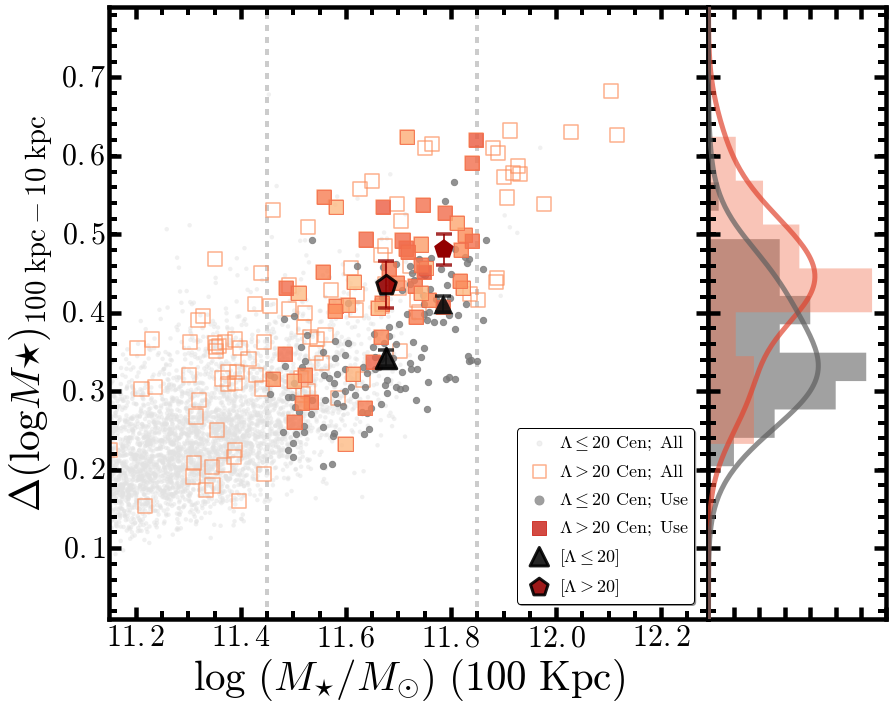

In [104]:
massStr1, massStr2, massStr3 = '100', '100', '10'
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100c, redbcgM100c
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100c, nonbcgM100c
col1, col2, col3 = 'logm_' + massStr1, 'logm_' + massStr2, 'logm_' + massStr3
xSep1, xSep2, xSep3 = None, 11.45, 11.85
xMin, xMax, yMin, yMax = 11.15, 12.29, 0.01, 0.79
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\Delta(\log M{\star})_{\mathrm{%s\ kpc}-\mathrm{%s\ kpc}}$' % (massStr2, massStr3) 
outPng = 'hscMassive_m%s_dm%s-%s_' % (massStr1, massStr2, massStr3) + sedMod + '_m100sample'

gFig1 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.10, colorUpp=0.7, 
                       showBin1=True, showBin2=True, color2a=ORG(0.5),
                       showHist1=False, showHist2=True, yKernel=0.05,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, 
                       save=True, figDir=figDir, outlineBin1=False,
                       xtickFormat='$\mathbf{%4.1f}$')

## logM_10 v.s. (logM_100 - logM_10) -- Using logM_100 subsamples

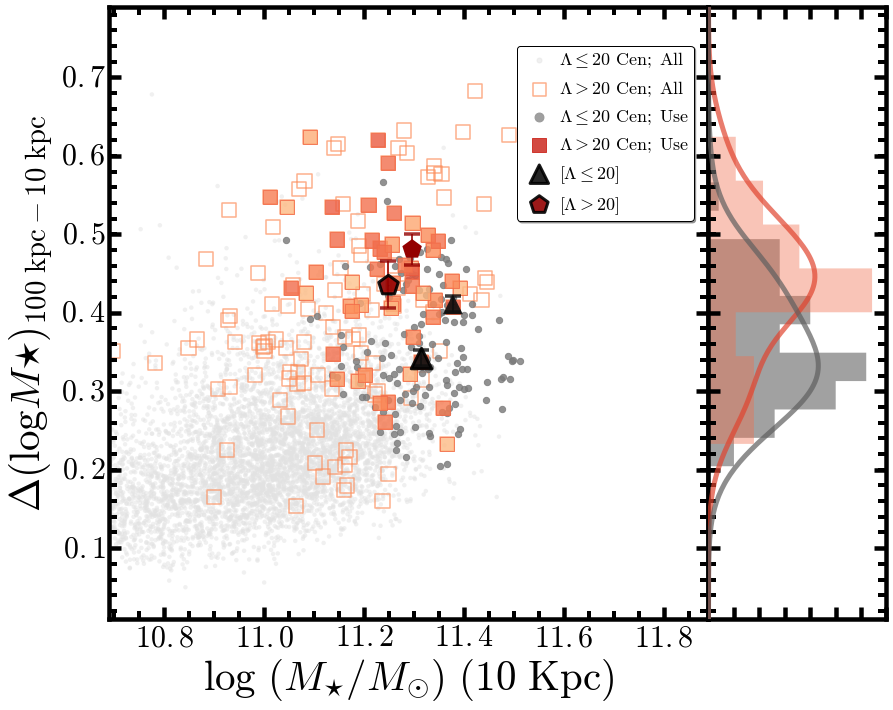

In [111]:
massStr1, massStr2, massStr3 = '10', '100', '10'
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100c, redbcgM100c
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100c, nonbcgM100c
col1, col2, col3 = 'logm_' + massStr1, 'logm_' + massStr2, 'logm_' + massStr3
xSep1, xSep2, xSep3 = None, None, None 
xMin, xMax, yMin, yMax = 10.69, 11.89, 0.01, 0.79
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\Delta(\log M{\star})_{\mathrm{%s\ kpc}-\mathrm{%s\ kpc}}$' % (massStr2, massStr3) 
outPng = 'hscMassive_m%s_dm%s-%s_' % (massStr1, massStr2, massStr3) + sedMod + '_m100sample'

gFig2 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.1, colorUpp=0.70, 
                       showBin1=True, showBin2=True, color2a=ORG(0.5),
                       showHist1=False, showHist2=True, yKernel=0.05,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, save=True,
                       outlineBin1=False, figDir=figDir, 
                       xtickFormat='$\mathbf{%4.1f}$', xLegend=0.68, yLegend=0.65)

## logM_10 v.s. (logM_100 - logM_10) -- Using logM_10 subsamples

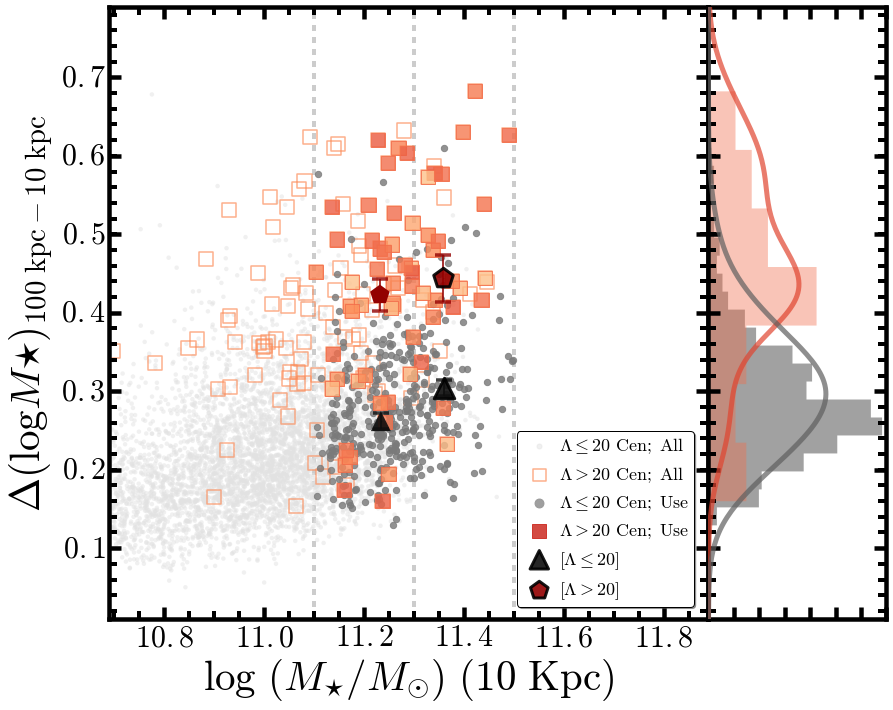

In [110]:
massStr1, massStr2, massStr3 = '10', '100', '10'
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM10a, redbcgM10b, redbcgM10c
sample2a, sample2b, sample2c = nonbcgM10a, nonbcgM10b, nonbcgM10c
col1, col2, col3 = 'logm_' + massStr1, 'logm_' + massStr2, 'logm_' + massStr3
xSep1, xSep2, xSep3 = 11.10, 11.30, 11.50 
xMin, xMax, yMin, yMax = 10.69, 11.89, 0.01, 0.79
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\Delta(\log M{\star})_{\mathrm{%s\ kpc}-\mathrm{%s\ kpc}}$' % (massStr2, massStr3) 
outPng = 'hscMassive_m%s_dm%s-%s_' % (massStr1, massStr2, massStr3) + sedMod + '_m10sample'

gFig3 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.1, colorUpp=0.70, 
                       showBin1=True, showBin2=True, color2a=ORG(0.5),
                       showHist1=False, showHist2=True, yKernel=0.05,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, 
                       save=True, figDir=figDir, outlineBin1=False,
                       xtickFormat='$\mathbf{%4.1f}$', xLegend=0.68, yLegend=0.02)

## logM_100 v.s. (logM_100 - logM_10) -- Using logM_10 subsamples

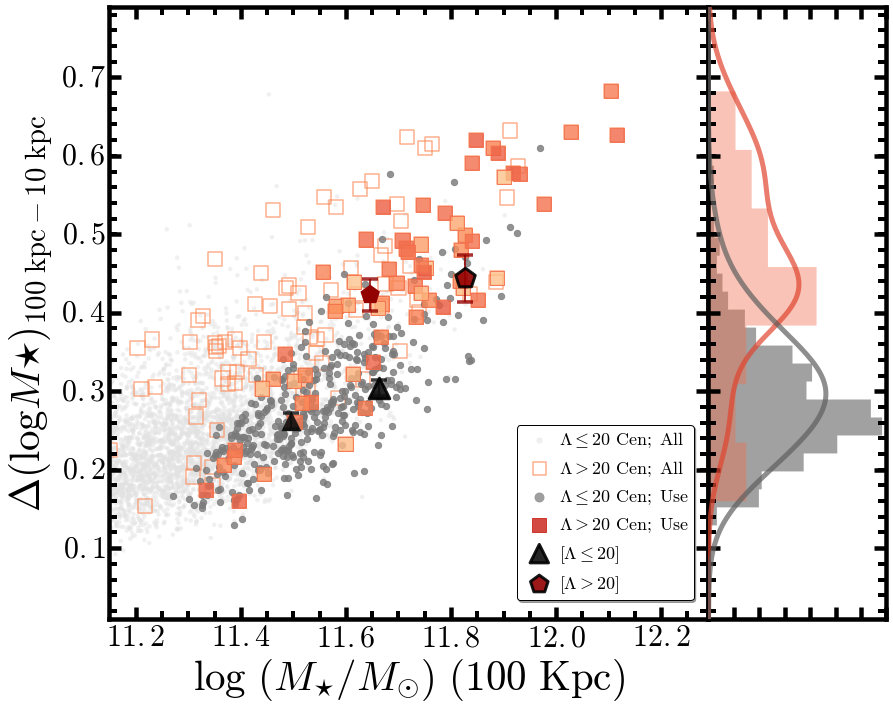

In [112]:
massStr1, massStr2, massStr3 = '100', '100', '10'
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM10a, redbcgM10b, redbcgM10c
sample2a, sample2b, sample2c = nonbcgM10a, nonbcgM10b, nonbcgM10c
col1, col2, col3 = 'logm_' + massStr1, 'logm_' + massStr2, 'logm_' + massStr3
xSep1, xSep2, xSep3 = None, None, None 
xMin, xMax, yMin, yMax = 11.15, 12.29, 0.01, 0.79
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\Delta(\log M{\star})_{\mathrm{%s\ kpc}-\mathrm{%s\ kpc}}$' % (massStr2, massStr3) 
outPng = 'hscMassive_m%s_dm%s-%s_' % (massStr1, massStr2, massStr3) + sedMod + '_m10sample'

gFig4 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.1, colorUpp=0.70, 
                       showBin1=True, showBin2=True, color2a=ORG(0.5),
                       showHist1=False, showHist2=True, yKernel=0.05,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, save=True,
                       outlineBin1=False, figDir=figDir, 
                       xtickFormat='$\mathbf{%4.1f}$', xLegend=0.68, yLegend=0.03)

# Make the Mass v.s. Size and/or Size Increase plots.

In [113]:
# Add a few columns
try:
    redbcgUse.add_column(Column(np.log10(redbcgUse['r50_100']), name='logr50_100'))
    nonbcgUse.add_column(Column(np.log10(nonbcgUse['r50_100']), name='logr50_100'))
except Exception:
    pass
try:
    #redbcgM100a.add_column(Column(np.log10(redbcgM100a['r50_100']), name='logr50_100'))
    #nonbcgM100a.add_column(Column(np.log10(nonbcgM100a['r50_100']), name='logr50_100'))
    redbcgM100b.add_column(Column(np.log10(redbcgM100b['r50_100']), name='logr50_100'))
    nonbcgM100b.add_column(Column(np.log10(nonbcgM100b['r50_100']), name='logr50_100'))
    redbcgM100c.add_column(Column(np.log10(redbcgM100c['r50_100']), name='logr50_100'))
    nonbcgM100c.add_column(Column(np.log10(nonbcgM100c['r50_100']), name='logr50_100'))
except Exception:
    pass

try:
    redbcgUse.add_column(Column(np.log10(redbcgUse['r20_100']), name='logr20_100'))
    nonbcgUse.add_column(Column(np.log10(nonbcgUse['r20_100']), name='logr20_100'))
except Exception:
    pass
try:
    #redbcgM100a.add_column(Column(np.log10(redbcgM100a['r20_100']), name='logr20_100'))
    #nonbcgM100a.add_column(Column(np.log10(nonbcgM100a['r20_100']), name='logr20_100'))
    redbcgM100b.add_column(Column(np.log10(redbcgM100b['r20_100']), name='logr20_100'))
    nonbcgM100b.add_column(Column(np.log10(nonbcgM100b['r20_100']), name='logr20_100'))
    redbcgM100c.add_column(Column(np.log10(redbcgM100c['r20_100']), name='logr20_100'))
    nonbcgM100c.add_column(Column(np.log10(nonbcgM100c['r20_100']), name='logr20_100'))
except Exception:
    pass

try:
    redbcgUse.add_column(Column(np.log10(redbcgUse['r80_100']), name='logr80_100'))
    nonbcgUse.add_column(Column(np.log10(nonbcgUse['r80_100']), name='logr80_100'))
except Exception:
    pass
try:
    #edbcgM100a.add_column(Column(np.log10(redbcgM100a['r80_100']), name='logr80_100'))
    #nonbcgM100a.add_column(Column(np.log10(nonbcgM100a['r80_100']), name='logr80_100'))
    redbcgM100b.add_column(Column(np.log10(redbcgM100b['r80_100']), name='logr80_100'))
    nonbcgM100b.add_column(Column(np.log10(nonbcgM100b['r80_100']), name='logr80_100'))
    redbcgM100c.add_column(Column(np.log10(redbcgM100c['r80_100']), name='logr80_100'))
    nonbcgM100c.add_column(Column(np.log10(nonbcgM100c['r80_100']), name='logr80_100'))
except Exception:
    pass

try:
    #redbcgM100d.add_column(Column(np.log10(redbcgM100u['r50_100']), name='logr50_100'))
    #nonbcgM100d.add_column(Column(np.log10(nonbcgM100u['r50_100']), name='logr50_100'))
    redbcgM100d.add_column(Column(np.log10(redbcgM100u['r20_100']), name='logr20_100'))
    nonbcgM100d.add_column(Column(np.log10(nonbcgM100u['r20_100']), name='logr20_100'))
    redbcgM100d.add_column(Column(np.log10(redbcgM100u['r80_100']), name='logr80_100'))
    nonbcgM100d.add_column(Column(np.log10(nonbcgM100u['r80_100']), name='logr80_100'))
except Exception:
    pass

#try:
#    redbcgM100k.add_column(Column(np.log10(redbcgM100k['r50_100']), name='logr50_100'))
#    nonbcgM100k.add_column(Column(np.log10(nonbcgM100k['r50_100']), name='logr50_100'))
#    redbcgM100k.add_column(Column(np.log10(redbcgM100k['r20_100']), name='logr20_100'))
#    nonbcgM100k.add_column(Column(np.log10(nonbcgM100k['r20_100']), name='logr20_100'))
#    redbcgM100k.add_column(Column(np.log10(redbcgM100k['r80_100']), name='logr80_100'))
#    nonbcgM100k.add_column(Column(np.log10(nonbcgM100k['r80_100']), name='logr80_100'))
#except Exception:
#    pass

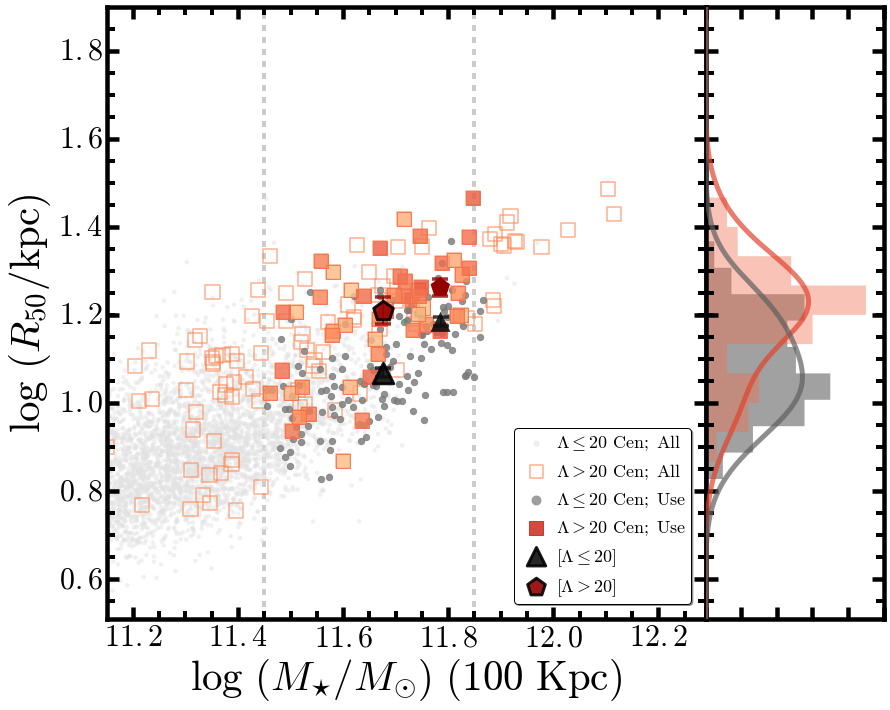

In [115]:
massStr1, massStr2, massStr3 = '100', '100', '10'
#-------------------------------------------------------------------------------#
                     
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100c, redbcgM100c
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100c, nonbcgM100c

col1, col2, col3 = 'logm_100', 'logr50_100', None
xSep1, xSep2, xSep3 = None, 11.45, 11.85
xMin, xMax, yMin, yMax = 11.15, 12.29, 0.51, 1.9 
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\log\ (R_{50}/\mathrm{kpc})}$' 
outPng = 'hscMassive_m100_r50_' + sedMod + '_m100sample'

gFig1 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.10, colorUpp=0.7, 
                       showBin1=True, showBin2=True, color2a=ORG(0.5),
                       showHist1=False, showHist2=True, yKernel=0.08,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, 
                       save=True, figDir=figDir, outlineBin1=False,
                       xtickFormat='$\mathbf{%4.1f}$',
                       ytickFormat='$\mathbf{%3.1f}$')

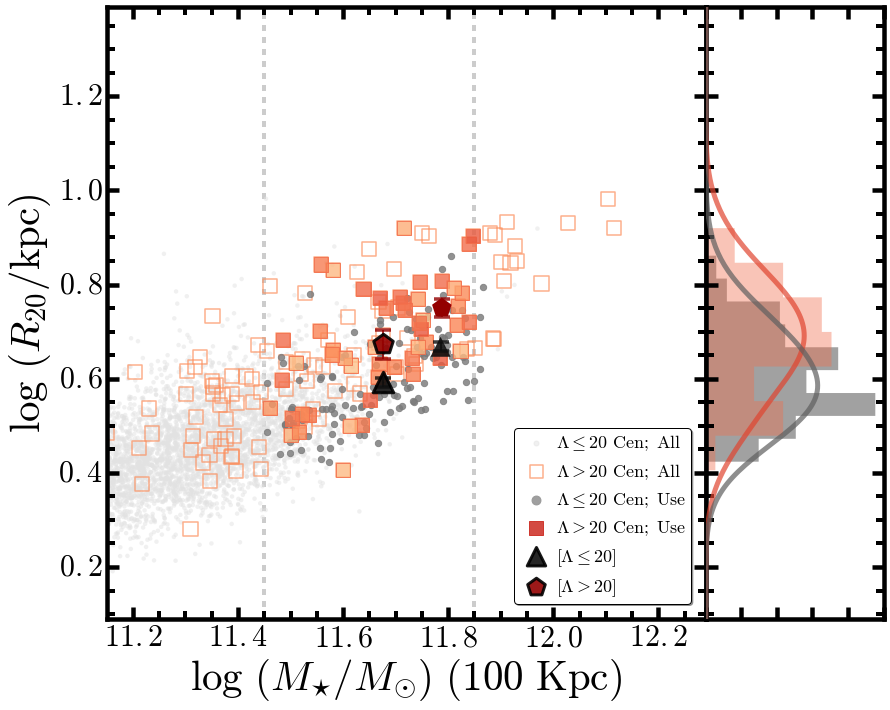

In [116]:
massStr1, massStr2, massStr3 = '100', '100', '10'
#-------------------------------------------------------------------------------#
                     
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100c, redbcgM100c
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100c, nonbcgM100c

col1, col2, col3 = 'logm_100', 'logr20_100', None
xSep1, xSep2, xSep3 = None, 11.45, 11.85
xMin, xMax, yMin, yMax = 11.15, 12.29, 0.09, 1.39 
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\log\ (R_{20}/\mathrm{kpc})}$' 
outPng = 'hscMassive_m100_r20_' + sedMod + '_m100sample'

gFig1 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.10, colorUpp=0.7, 
                       showBin1=True, showBin2=True, color2a=ORG(0.5),
                       showHist1=False, showHist2=True, yKernel=0.08,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, 
                       save=True, figDir=figDir, outlineBin1=False,
                       xtickFormat='$\mathbf{%4.1f}$',
                       ytickFormat='$\mathbf{%3.1f}$')

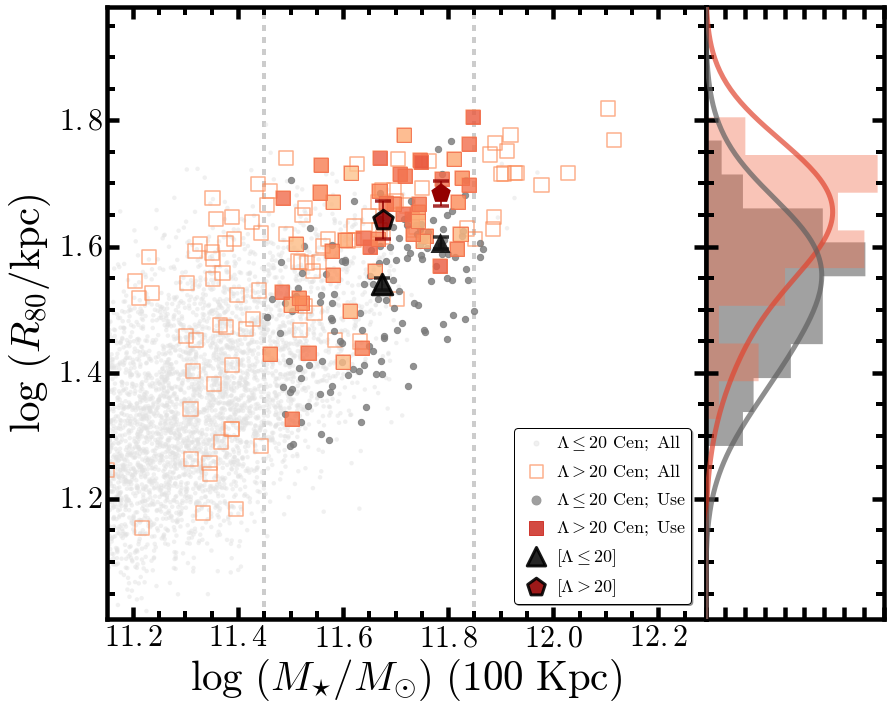

In [118]:
massStr1, massStr2, massStr3 = '100', '100', '10'
#-------------------------------------------------------------------------------#
                     
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100c, redbcgM100c
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100c, nonbcgM100c

col1, col2, col3 = 'logm_100', 'logr80_100', None
xSep1, xSep2, xSep3 = None, 11.45, 11.85
xMin, xMax, yMin, yMax = 11.15, 12.29, 1.01, 1.98 
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\log\ (R_{80}/\mathrm{kpc})}$' 
outPng = 'hscMassive_m100_r80_' + sedMod + '_m100sample'

gFig1 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.10, colorUpp=0.7, 
                       showBin1=True, showBin2=True, color2a=ORG(0.5),
                       showHist1=False, showHist2=True, yKernel=0.08,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, 
                       save=True, figDir=figDir, outlineBin1=False,
                       xtickFormat='$\mathbf{%4.1f}$',
                       ytickFormat='$\mathbf{%3.1f}$')

## logM_100 v.s. logM_10 and logM_5

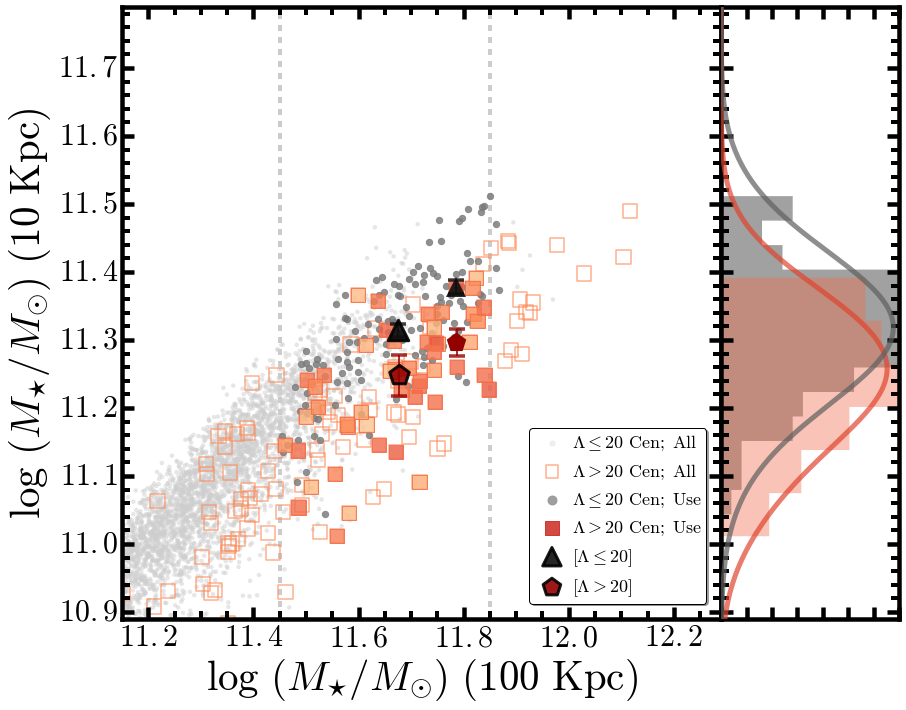

In [119]:
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100c, redbcgM100c
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100c, nonbcgM100c

col1, col2, col3 = 'logm_100', 'logm_10', None
xSep1, xSep2, xSep3 = None, 11.45, 11.85
xMin, xMax, yMin, yMax = 11.15, 12.29, 10.89, 11.79 
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % '100' 
yLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % '10'
outPng = 'hscMassive_m100_m10_' + sedMod + '_m100sample'

gFig8 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.10, colorUpp=0.7, 
                       showBin1=True, showBin2=True, 
                       showHist1=False, showHist2=True, yKernel=0.08,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, 
                       save=True, figDir=figDir, outlineBin1=False,
                       color2a=ORG(0.5), color1a=BLK(0.3),
                       xtickFormat='$\mathbf{%4.1f}$',
                       ytickFormat='$\mathbf{%3.1f}$')

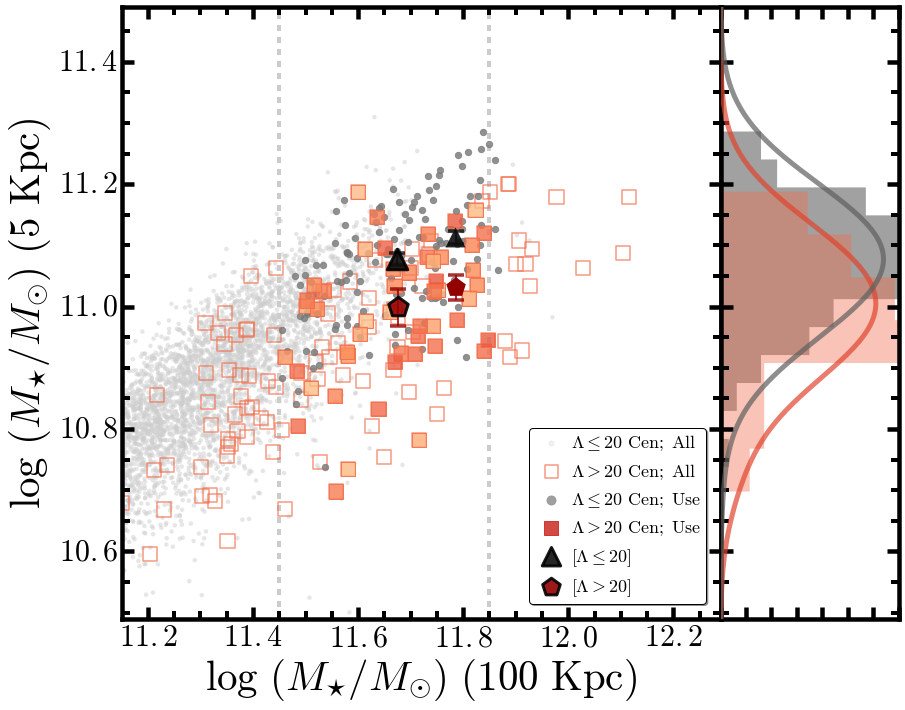

In [120]:
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgUse, nonbcgUse
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100c, redbcgM100c
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100c, nonbcgM100c

sample1a = sample1a[np.isfinite(sample1a['logm_5'])]
sample1b = sample1b[np.isfinite(sample1b['logm_5'])]
sample1c = sample1c[np.isfinite(sample1c['logm_5'])]

sample2a = sample2a[np.isfinite(sample2a['logm_5'])]
sample2b = sample2b[np.isfinite(sample2b['logm_5'])]
sample2c = sample2c[np.isfinite(sample2c['logm_5'])]

col1, col2, col3 = 'logm_100', 'logm_5', None
xSep1, xSep2, xSep3 = None, 11.45, 11.85
xMin, xMax, yMin, yMax = 11.15, 12.29, 10.49, 11.49 
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % '100' 
yLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % '5'
outPng = 'hscMassive_m100_m5_' + sedMod + '_m100sample'

gFig8 = plotMassGrowth(parent1, parent2,
                       sample1a, sample1b, sample1c, 
                       sample2a, sample2b, sample2c, 
                       col1=col1, col2=col2, col3=col3, 
                       xSep1=xSep1, xSep2=xSep2, xSep3=xSep3, 
                       lamLimit=lamLimit, pcenLimit=pcenLimit, 
                       sizeCol1=None, sizeNorm=0.1,
                       colorCol1='z_use', colorLow=0.10, colorUpp=0.7, 
                       showBin1=True, showBin2=True, 
                       showHist1=False, showHist2=True, yKernel=0.08,
                       xMin=xMin, xMax=xMax, yMin=yMin, yMax=yMax,
                       xLabel=xLabel, yLabel=yLabel, outPng=outPng, 
                       save=True, figDir=figDir, outlineBin1=False,
                       color2a=ORG(0.6), color1a=BLK(0.3),
                       xtickFormat='$\mathbf{%4.1f}$',
                       ytickFormat='$\mathbf{%3.1f}$')

# Organize the SBP profiles

## Organize the logM_100 samples

In [122]:
## M100; no-match 
redbcgProfM100x = getStackProfiles(redbcgM100x, redbcgDir, 
                                   name=(prefix1 + '_' + sampleM100x))
nonbcgProfM100x = getStackProfiles(nonbcgM100x, nonbcgDir, 
                                   name=(prefix2 + '_' + sampleM100x))
## M100; low mass bin
#redbcgProfM100a = getStackProfiles(redbcgM100a, redbcgDir, 
#                                   name=(prefix1 + '_' + sampleM100a))
#nonbcgProfM100a = getStackProfiles(nonbcgM100a, nonbcgDir, 
#                                   name=(prefix2 + '_' + sampleM100a))
## M100; high mass bin
redbcgProfM100b = getStackProfiles(redbcgM100b, redbcgDir, 
                                   name=(prefix1 + '_' + sampleM100b))
nonbcgProfM100b = getStackProfiles(nonbcgM100b, nonbcgDir, 
                                   name=(prefix2 + '_' + sampleM100b))
## M100; full sample
redbcgProfM100c = getStackProfiles(redbcgM100c, redbcgDir, 
                                   name=(prefix1 + '_' + sampleM100c))
nonbcgProfM100c = getStackProfiles(nonbcgM100c, nonbcgDir, 
                                   name=(prefix2 + '_' + sampleM100c))
## M100; full sample; low-lambda 
redbcgProfM100d = getStackProfiles(redbcgM100d, redbcgDir, 
                                   name=(prefix1 + '_' + sampleM100d))
nonbcgProfM100d = getStackProfiles(nonbcgM100d, nonbcgDir, 
                                   name=(prefix2 + '_' + sampleM100d))
## M100; full sample; low-z
#redbcgProfM100e = getStackProfiles(redbcgM100e, redbcgDir, 
#                                   name=(prefix1 + '_' + sampleM100e))
#nonbcgProfM100e = getStackProfiles(nonbcgM100e, nonbcgDir, 
#                                   name=(prefix2 + '_' + sampleM100e))
## M100; sdss spec-z sample
#redbcgProfM100f = getStackProfiles(redbcgM100f, redbcgDir, 
#                                   name=(prefix1 + '_' + sampleM100f))
#nonbcgProfM100f = getStackProfiles(nonbcgM100f, nonbcgDir, 
#                                   name=(prefix2 + '_' + sampleM100f))
## M100; GAMA stellar mass
redbcgProfM100i = getStackProfiles(redbcgM100i, redbcgDir, 
                                   name=(prefix1 + '_' + sampleM100i))
nonbcgProfM100i = getStackProfiles(nonbcgM100i, nonbcgDir, 
                                   name=(prefix2 + '_' + sampleM100i))
## M100; nonbcg-GAMA 
#redbcgProfM100j = getStackProfiles(redbcgM100j, redbcgDir, 
#                                   name=(prefix1 + '_' + sampleM100j))
#nonbcgProfM100j = getStackProfiles(nonbcgM100j, nonbcgDir, 
#                                   name=(prefix2 + '_' + sampleM100j))
## M100; nonbcg-GAMAz 
#redbcgProfM100k = getStackProfiles(redbcgM100k, redbcgDir, 
#                                   name=(prefix1 + '_' + sampleM100k))
#nonbcgProfM100k = getStackProfiles(nonbcgM100k, nonbcgDir, 
#                                   name=(prefix2 + '_' + sampleM100k))
## M100; GAMA bcg v.s. GAMA-specz non BCG
#redbcgProfM100l = getStackProfiles(redbcgM100l, redbcgDir, 
#                                   name=(prefix1 + '_' + sampleM100l))
#nonbcgProfM100l = getStackProfiles(nonbcgM100l, nonbcgDir, 
#                                   name=(prefix2 + '_' + sampleM100l))

## Sample redbcg_matchX_m100_bc03a : Will deal with 71 galaxies

## Save redbcg_matchX_m100_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/redbcg/redbcg_matchX_m100_bc03a_profs.pkl
## Sample nonbcg_matchX_m100_bc03a : Will deal with 601 galaxies

## Save nonbcg_matchX_m100_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/nonbcg/nonbcg_matchX_m100_bc03a_profs.pkl
## Sample redbcg_matchA2_m100_bc03a : Will deal with 28 galaxies

## Save redbcg_matchA2_m100_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/redbcg/redbcg_matchA2_m100_bc03a_profs.pkl
## Sample nonbcg_matchA2_m100_bc03a : Will deal with 57 galaxies

## Save nonbcg_matchA2_m100_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/nonbcg/nonbcg_matchA2_m100_bc03a_profs.pkl
## Sample redbcg_matchA_m100_bc03a : Will deal with 50 galaxies

## Save redbcg_matchA_m100_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/redbcg/redbcg_matchA_m100_bc03a_profs.pkl
## Sample nonbcg_matchA_m100_bc03a : Will deal with 138 galaxies

##

## Organize the logM_10 samples

In [123]:
## M10; no-match
redbcgProfM10x = getStackProfiles(redbcgM10x, redbcgDir, 
                                  name=(prefix1 + '_' + sampleM10x))
nonbcgProfM10x = getStackProfiles(nonbcgM10x, nonbcgDir, 
                                  name=(prefix2 + '_' + sampleM10x))
## M10; low m10
redbcgProfM10a = getStackProfiles(redbcgM10a, redbcgDir, 
                                  name=(prefix1 + '_' + sampleM10a))
nonbcgProfM10a = getStackProfiles(nonbcgM10a, nonbcgDir, 
                                  name=(prefix2 + '_' + sampleM10a))
## M10; high m10
redbcgProfM10b = getStackProfiles(redbcgM10b, redbcgDir, 
                                  name=(prefix1 + '_' + sampleM10b))
nonbcgProfM10b = getStackProfiles(nonbcgM10b, nonbcgDir, 
                                  name=(prefix2 + '_' + sampleM10b))
## M10; full sample
redbcgProfM10c = getStackProfiles(redbcgM10c, redbcgDir, 
                                  name=(prefix1 + '_' + sampleM10c))
nonbcgProfM10c = getStackProfiles(nonbcgM10c, nonbcgDir, 
                                  name=(prefix2 + '_' + sampleM10c))
## M10; SDSS spec-z 
#redbcgProfM10f = getStackProfiles(redbcgM10f, redbcgDir, 
#                                  name=(prefix1 + '_' + sampleM10f))
#nonbcgProfM10f = getStackProfiles(nonbcgM10f, nonbcgDir, 
#                                  name=(prefix2 + '_' + sampleM10f))
## M10; m10 + m15
redbcgProfM10d = getStackProfiles(redbcgM10d, redbcgDir, 
                                  name=(prefix1 + '_' + sampleM10d))
nonbcgProfM10d = getStackProfiles(nonbcgM10d, nonbcgDir, 
                                  name=(prefix2 + '_' + sampleM10d))

## Sample redbcg_matchX_m10_bc03a : Will deal with 85 galaxies

## Save redbcg_matchX_m10_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/redbcg/redbcg_matchX_m10_bc03a_profs.pkl
## Sample nonbcg_matchX_m10_bc03a : Will deal with 1639 galaxies

## Save nonbcg_matchX_m10_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/nonbcg/nonbcg_matchX_m10_bc03a_profs.pkl
## Sample redbcg_matchA1_m10_bc03a : Will deal with 42 galaxies

## Save redbcg_matchA1_m10_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/redbcg/redbcg_matchA1_m10_bc03a_profs.pkl
## Sample nonbcg_matchA1_m10_bc03a : Will deal with 298 galaxies

## Save nonbcg_matchA1_m10_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/nonbcg/nonbcg_matchA1_m10_bc03a_profs.pkl
## Sample redbcg_matchA2_m10_bc03a : Will deal with 21 galaxies

## Save redbcg_matchA2_m10_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/redbcg/redbcg_matchA2_m10_bc03a_profs.pkl
## Sample nonbcg_matchA2_m10_bc03a : Will deal with 95 galaxies

## Save nonbc

## Organize the samples for redMem comparisons.

In [124]:
# redMem v.s. redBcg
## M100; sample1
#redbcgProfM100g = getStackProfiles(redbcgM100g, redbcgDir, 
#                                   name=(prefix1 + '_' + sampleM100g))
#redmemProfM100g = getStackProfiles(redmemM100g, redmemDir, 
#                                   name=(prefix2 + '_' + sampleM100g))
## M10; sample1
#redbcgProfM10g = getStackProfiles(redbcgM10g, redbcgDir, 
#                                  name=(prefix1 + '_' + sampleM10g))
#redmemProfM10g = getStackProfiles(redmemM10g, redmemDir, 
#                                  name=(prefix2 + '_' + sampleM10g))

# redMem v.s. nonBcg
## M100; sample1
nonbcgProfM100h = getStackProfiles(nonbcgM100h, nonbcgDir, 
                                   name=(prefix1 + '_' + sampleM100h))
redmemProfM100h = getStackProfiles(redmemM100h, redmemDir, 
                                   name=(prefix2 + '_' + sampleM100h))
## M10; sample1
nonbcgProfM10h = getStackProfiles(nonbcgM10h, nonbcgDir, 
                                  name=(prefix1 + '_' + sampleM10h))
redmemProfM10h = getStackProfiles(redmemM10h, redmemDir, 
                                  name=(prefix2 + '_' + sampleM10h))

## Sample redbcg_matchH_m100_bc03a : Will deal with 319 galaxies

## Save redbcg_matchH_m100_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/nonbcg/redbcg_matchH_m100_bc03a_profs.pkl
## Sample nonbcg_matchH_m100_bc03a : Will deal with 55 galaxies

## Save nonbcg_matchH_m100_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/redmem/nonbcg_matchH_m100_bc03a_profs.pkl
## Sample redbcg_matchH_m10_bc03a : Will deal with 324 galaxies

## Save redbcg_matchH_m10_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/nonbcg/redbcg_matchH_m10_bc03a_profs.pkl
## Sample nonbcg_matchH_m10_bc03a : Will deal with 74 galaxies

## Save nonbcg_matchH_m10_bc03a to /Users/songhuang/astro4/massive/dr15b/sbp/redmem/nonbcg_matchH_m10_bc03a_profs.pkl


## !! LOAD the available profiles if possible !!

In [27]:
## Load the available profiles

sampleM100x = 'matchX_m100_' + sedMod
sampleM100a = 'matchA1_m100_' + sedMod
sampleM100b = 'matchA2_m100_' + sedMod
sampleM100c = 'matchA_m100_' + sedMod
sampleM100d = 'matchB_m100_' + sedMod
sampleM100e = 'matchC_m100_' + sedMod
sampleM100f = 'matchD_m100_' + sedMod
sampleM100g = 'matchG_m100_' + sedMod
sampleM100h = 'matchH_m100_' + sedMod
sampleM100i = 'matchI_m100_' + sedMod
sampleM100j = 'matchJ_m100_' + sedMod
sampleM100k = 'matchK_m100_' + sedMod
sampleM100l = 'matchL_m100_' + sedMod

sampleM10x = 'matchX_m10_' + sedMod
sampleM10a = 'matchA1_m10_' + sedMod
sampleM10b = 'matchA2_m10_' + sedMod
sampleM10c = 'matchA_m10_' + sedMod
sampleM10d = 'matchB_m10_' + sedMod
sampleM10f = 'matchD_m10_' + sedMod
sampleM10g = 'matchG_m10_' + sedMod
sampleM10h = 'matchH_m10_' + sedMod

try:
    redbcgProfM100x = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100x + '_profs.pkl'))
    nonbcgProfM100x = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100x + '_profs.pkl'))
    print("## Load: %s" % sampleM100x)
except Exception: 
    print("## Problem loading: %s" % sampleM100x)
    
try:
    redbcgProfM100a = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100a + '_profs.pkl'))
    nonbcgProfM100a = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100a + '_profs.pkl'))
    print("## Load: %s" % sampleM100a)
except Exception: 
    print("## Problem loading: %s" % sampleM100a)
    
try:
    redbcgProfM100b = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100b + '_profs.pkl'))
    nonbcgProfM100b = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100b + '_profs.pkl'))
    print("## Load: %s" % sampleM100b)
except Exception: 
    print("## Problem loading: %s" % sampleM100b)
    
try:
    redbcgProfM100c = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100c + '_profs.pkl'))
    nonbcgProfM100c = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100c + '_profs.pkl'))
    print("## Load: %s" % sampleM100c)
except Exception: 
    print("## Problem loading: %s" % sampleM100c)
    
try:
    redbcgProfM100d = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100d + '_profs.pkl'))
    nonbcgProfM100d = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100d + '_profs.pkl'))
    print("## Load: %s" % sampleM100d)
except Exception: 
    print("## Problem loading: %s" % sampleM100d)
    
try:
    redbcgProfM100e = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100e + '_profs.pkl'))
    nonbcgProfM100e = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100e + '_profs.pkl'))
    print("## Load: %s" % sampleM100e)
except Exception: 
    print("## Problem loading: %s" % sampleM100e)
    
try:
    redbcgProfM100f = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100f + '_profs.pkl'))
    nonbcgProfM100f = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100f + '_profs.pkl'))
    print("## Load: %s" % sampleM100f)
except Exception: 
    print("## Problem loading: %s" % sampleM100f)
    
try:
    redbcgProfM100i = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100i + '_profs.pkl'))
    nonbcgProfM100i = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100i + '_profs.pkl'))
    print("## Load: %s" % sampleM100i)
except Exception: 
    print("## Problem loading: %s" % sampleM100i)

try:
    redbcgProfM100j = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100j + '_profs.pkl'))
    nonbcgProfM100j = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100j + '_profs.pkl'))
    print("## Load: %s" % sampleM100j)
except Exception: 
    print("## Problem loading: %s" % sampleM100j)
    
try:
    redbcgProfM100k = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100k + '_profs.pkl'))
    nonbcgProfM100k = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100k + '_profs.pkl'))
    print("## Load: %s" % sampleM100k)
except Exception: 
    print("## Problem loading: %s" % sampleM100k)
    
try:
    redbcgProfM100l = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100l + '_profs.pkl'))
    nonbcgProfM100l = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100l + '_profs.pkl'))
    print("## Load: %s" % sampleM100l)
except Exception: 
    print("## Problem loading: %s" % sampleM100l)

#-----------------------------------------#
try:
    redbcgProfM10x = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10x + '_profs.pkl'))
    nonbcgProfM10x = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10x + '_profs.pkl'))
    print("## Load: %s" % sampleM10x)
except Exception: 
    print("## Problem loading: %s" % sampleM10x)
    
try:
    redbcgProfM10a = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10a + '_profs.pkl'))
    nonbcgProfM10a = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10a + '_profs.pkl'))
    print("## Load: %s" % sampleM10a)
except Exception: 
    print("## Problem loading: %s" % sampleM10a)
    
try:
    redbcgProfM10b = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10b + '_profs.pkl'))
    nonbcgProfM10b = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10b + '_profs.pkl'))
    print("## Load: %s" % sampleM10b)
except Exception: 
    print("## Problem loading: %s" % sampleM10b)
    
try:
    redbcgProfM10c = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10c + '_profs.pkl'))
    nonbcgProfM10c = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10c + '_profs.pkl'))
    print("## Load: %s" % sampleM10c)
except Exception: 
    print("## Problem loading: %s" % sampleM10c)
    
try:
    redbcgProfM10d = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10d + '_profs.pkl'))
    nonbcgProfM10d = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10d + '_profs.pkl'))
    print("## Load: %s" % sampleM10d)
except Exception: 
    print("## Problem loading: %s" % sampleM10d)
    
try:
    redbcgProfM10f = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10f + '_profs.pkl'))
    nonbcgProfM10f = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10f + '_profs.pkl'))
    print("## Load: %s" % sampleM10f)
except Exception: 
    print("## Problem loading: %s" % sampleM10f)
    
#-----------------------------------------#
try:
    redbcgProfM100g = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100g + '_profs.pkl'))
    redmemProfM100g = loadPkl(os.path.join(redmemDir, prefix2 + "_" + sampleM100g + '_profs.pkl'))
    print("## Load: %s" % sampleM100g)
except Exception: 
    print("## Problem loading: %s" % sampleM100g)
    
try:
    redbcgProfM10g = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10g + '_profs.pkl'))
    redmemProfM10g = loadPkl(os.path.join(redmemDir, prefix2 + "_" + sampleM10g + '_profs.pkl'))
    print("## Load: %s" % sampleM10g)
except Exception: 
    print("## Problem loading: %s" % sampleM10g)
    
try:
    nonbcgProfM100h = loadPkl(os.path.join(nonbcgDir, prefix1 + "_" + sampleM100h + '_profs.pkl'))
    redmemProfM100h = loadPkl(os.path.join(redmemDir, prefix2 + "_" + sampleM100h + '_profs.pkl'))
    print("## Load: %s" % sampleM100h)
except Exception: 
    print("## Problem loading: %s" % sampleM100h)
    
try:
    nonbcgProfM10h = loadPkl(os.path.join(nonbcgDir, prefix1 + "_" + sampleM10h + '_profs.pkl'))
    redmemProfM10h = loadPkl(os.path.join(redmemDir, prefix2 + "_" + sampleM10h + '_profs.pkl'))
    print("## Load: %s" % sampleM10h)
except Exception: 
    print("## Problem loading: %s" % sampleM10h)

/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:252: UserWarning: ## Can not find /Users/song/astro4/massive/dr15b/sbp/redbcg/redbcg_matchG_m100_A_fsps1_profs.pkl, return None
/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:252: UserWarning: ## Can not find /Users/song/astro4/massive/dr15b/sbp/nonbcg/nonbcg_matchG_m100_A_fsps1_profs.pkl, return None
/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:252: UserWarning: ## Can not find /Users/song/astro4/massive/dr15b/sbp/redbcg/redbcg_matchC_m100_1_fsps1_profs.pkl, return None
/Users/song/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:252: UserWarning: ## Can not find /Users/song/astro4/massive/dr15b/sbp/redbcg/redbcg_matchC_m10_1_fsps1_profs.pkl, return None


## Something wrong with the matches using GAMA stellar mass!


# Comparisons of Mass Profiles

## Profiles for logM_100 Matched Samples

### logm_100, no match sample

71
70
# Sample1:  11.3770210974
# Sample2:  11.2432375192


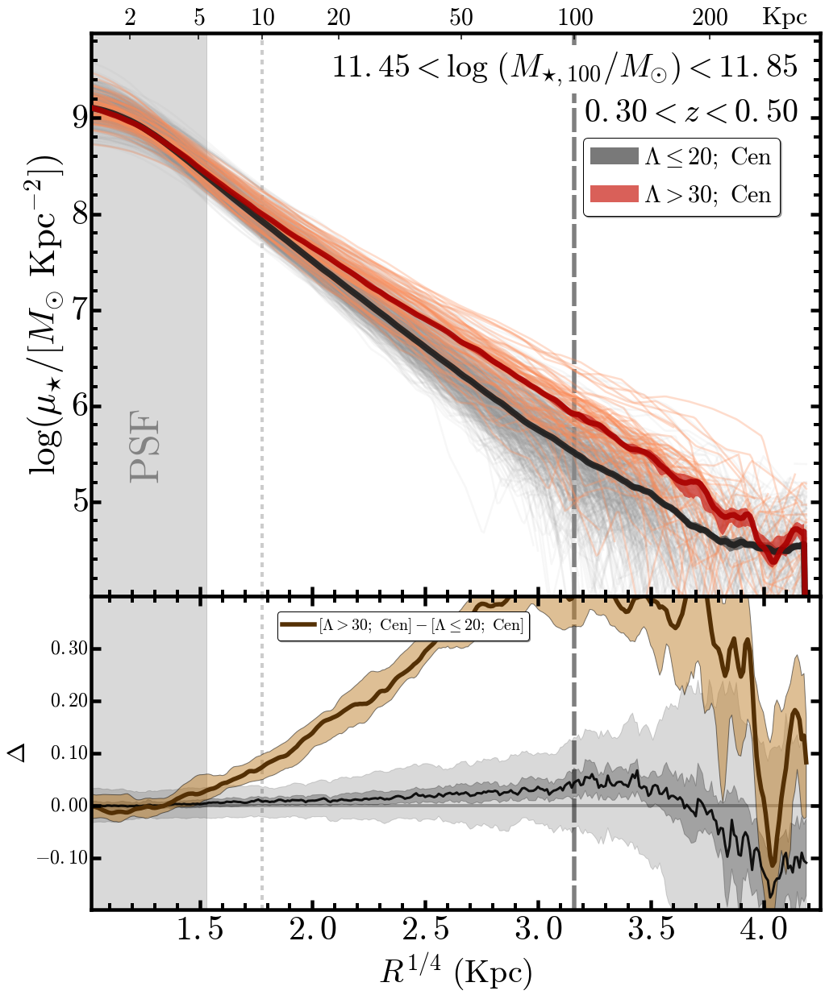

In [126]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100x), copy.deepcopy(nonbcgProfM100x)
mass1, mass2, z1, z2, lamLimit = 11.45, 11.85, 0.30, 0.50, 30.0
outPng = sampleM100x 
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.25
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 88.0)])) <= 4.7:
        del profSample1[jj]
print(len(profSample1))

pFig1b = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=True, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, boxSize=3,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

71
70
601
584
# Sample1:  -0.0105473436968
# Sample2:  -0.0102823804377


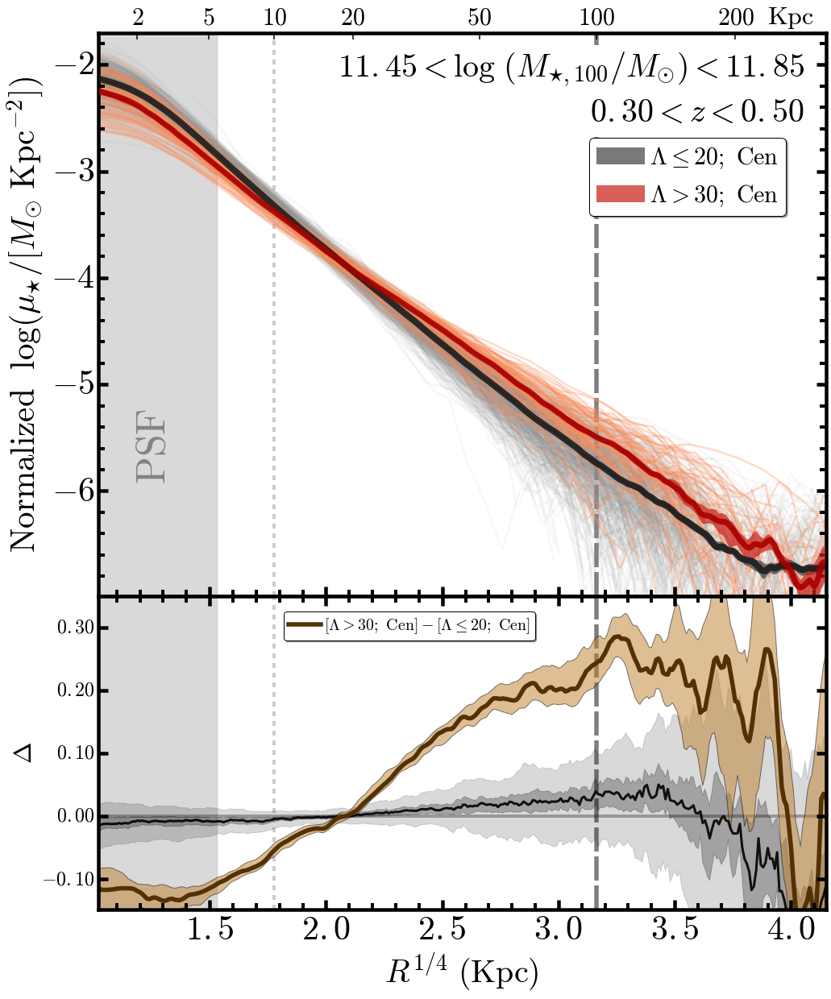

In [128]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100x), copy.deepcopy(nonbcgProfM100x)
mass1, mass2, z1, z2, lamLimit = 11.45, 11.85, 0.30, 0.50, 30.0
outPng = sampleM100x + '_norm1'
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
norm, integrate, normR1 = True, True, 100.0
ymin, ymax = -6.99, -1.7 
dmin, dmax = -0.149, 0.349
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 88.0)])) <= 4.7:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 88.0)])) <= 4.7:
        del profSample2[jj]
print(len(profSample2))

pFig1b = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=True, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, boxSize=3,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

### logM_100 matched;  Sample 2;   Not Normalized

28
27
# Sample1:  11.4902981368
# Sample2:  11.4336437458


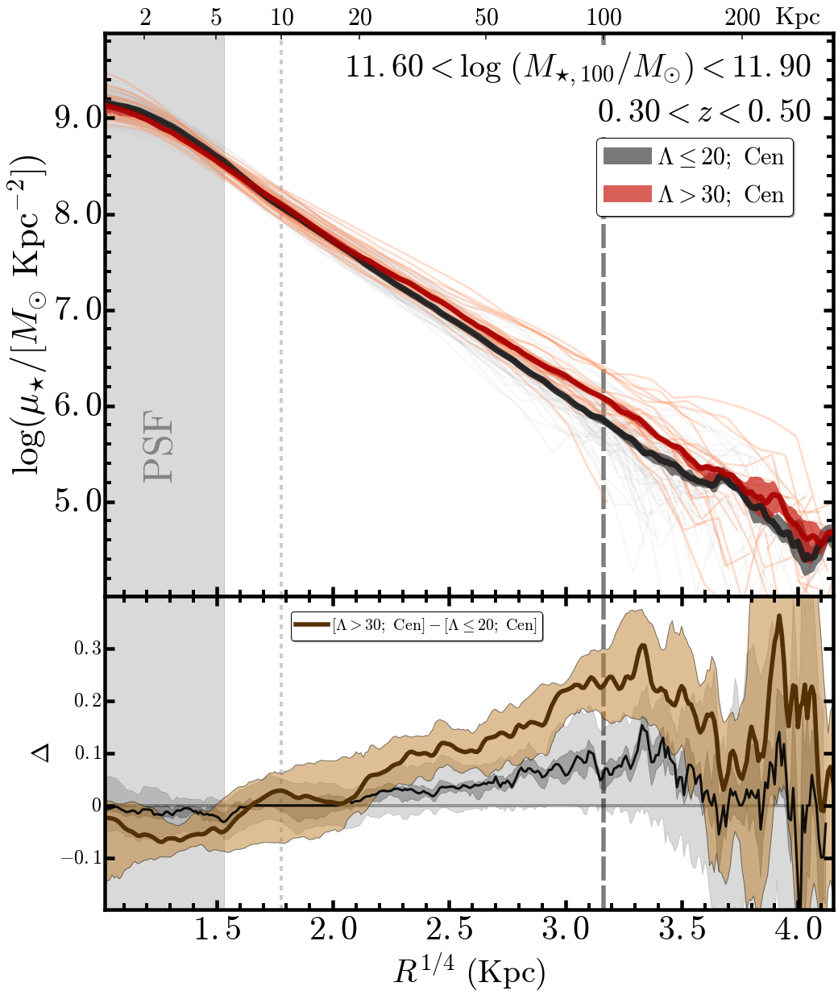

In [130]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100b), copy.deepcopy(nonbcgProfM100b)
mass1, mass2, z1, z2, lamLimit = 11.60, 11.90, 0.3, 0.5, 30.0
outPng = sampleM100b
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 6.0:
        del profSample1[jj]
print(len(profSample1))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$')

### logM_100 matched;  Sample 2;  Normalized

28
22
# Sample1:  -0.00275929896865
# Sample2:  -0.00750307539271


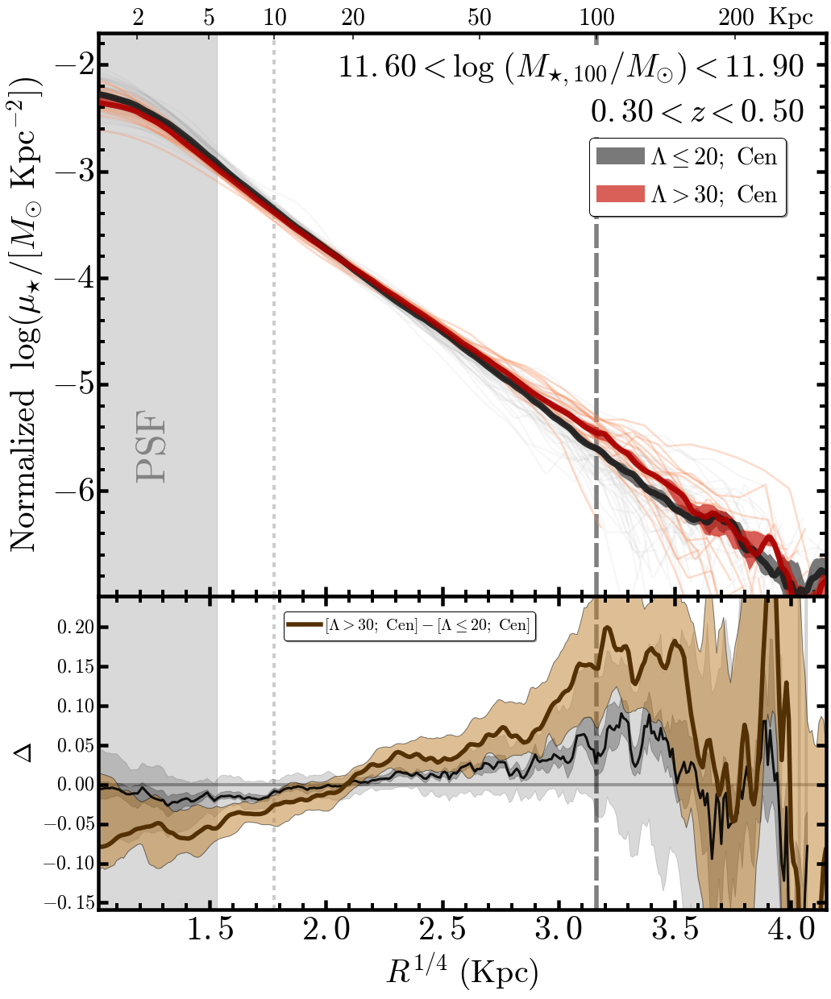

In [131]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100b), copy.deepcopy(nonbcgProfM100b)
mass1, mass2, z1, z2, lamLimit = 11.6, 11.9, 0.30, 0.50, 30.0
outPng = sampleM100b + '_norm1'
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
norm, integrate, normR1 = True, True, 100.0
ymin, ymax = -6.99, -1.7 
dmin, dmax = -0.159, 0.239
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample1[jj]
print(len(profSample1))

pFig1d = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=True, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

### logM_100 matched;  Full Sample;   Not Normalized

50
45
138
136
45
44
# Sample1:  11.3373138379
# Sample2:  11.3289256533


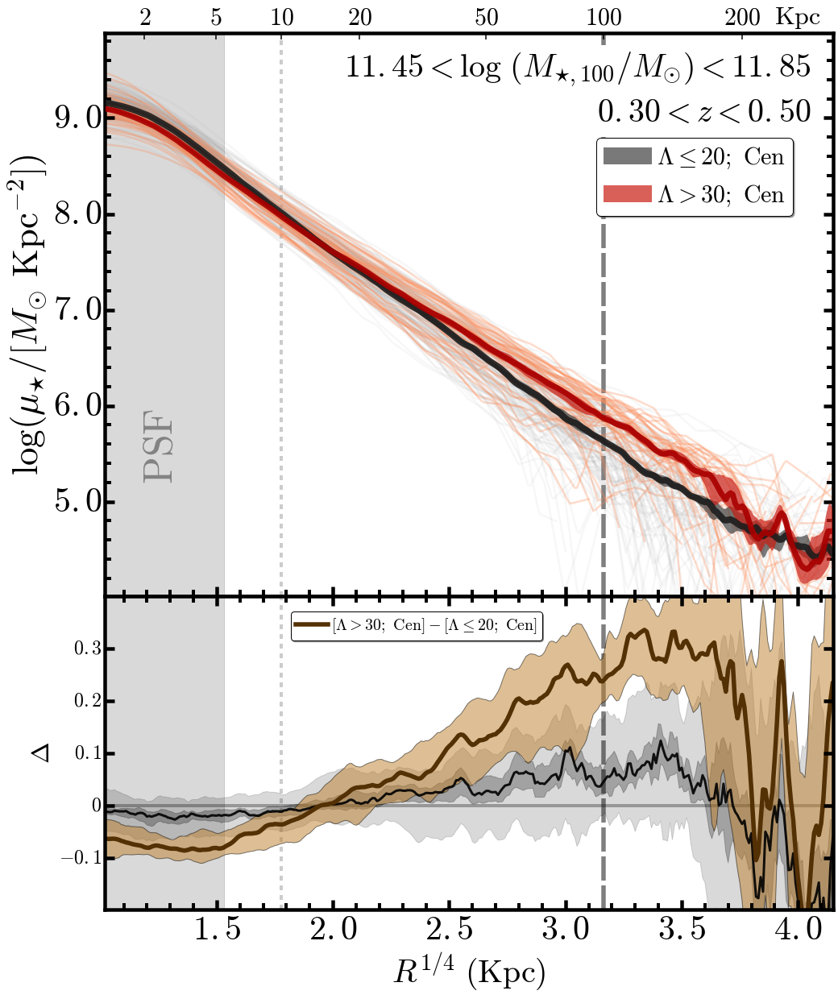

In [132]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100c), copy.deepcopy(nonbcgProfM100c)
mass1, mass2, z1, z2, lamLimit = 11.45, 11.85, 0.3, 0.5, 30.0
outPng = sampleM100c
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
print(len(profSample2))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 90.0)])) < 4.5:
        del profSample1[jj]
print(len(profSample1))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$')

70
67
191
188
67
67
# Sample1:  11.3314538575
# Sample2:  11.3288082688


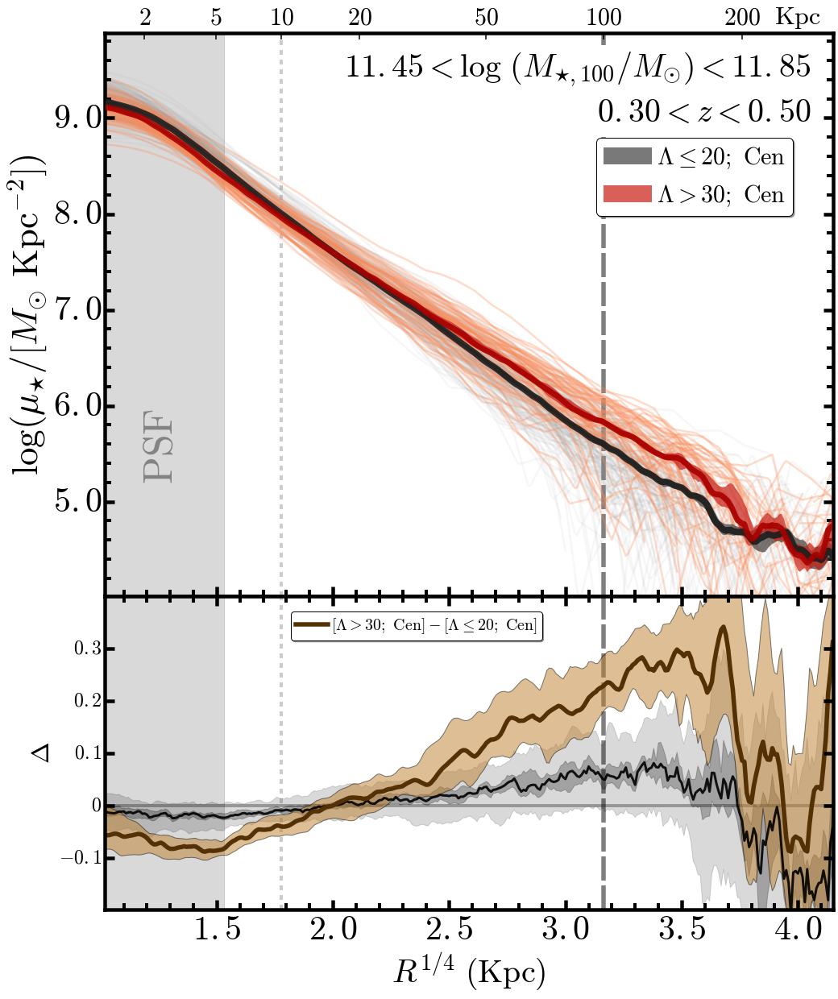

In [133]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100d), copy.deepcopy(nonbcgProfM100d)
mass1, mass2, z1, z2, lamLimit = 11.45, 11.85, 0.3, 0.5, 20.0
outPng = sampleM100d
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
print(len(profSample2))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 90.0)])) < 4.5:
        del profSample1[jj]
print(len(profSample1))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$')

### logM_100 matched;  Full Sample;  Normalized

50
45
138
136
45
44
# Sample1:  -0.0102524945594
# Sample2:  -0.0106080638889


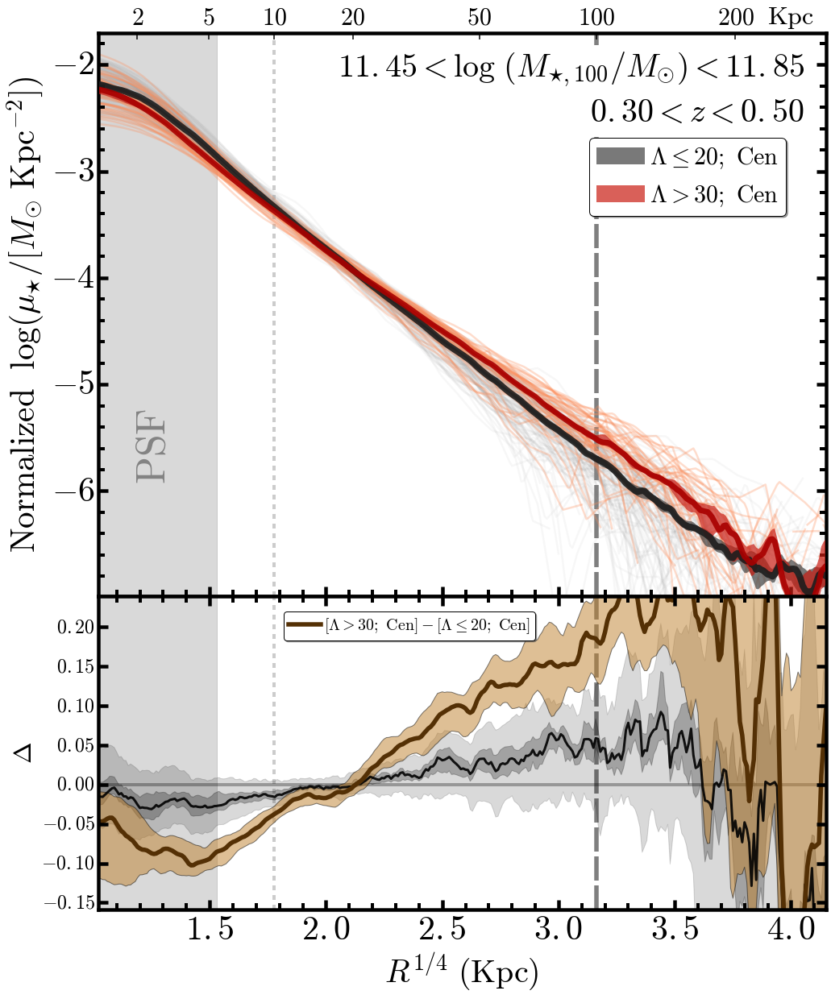

In [134]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100c), copy.deepcopy(nonbcgProfM100c)
mass1, mass2, z1, z2, lamLimit = 11.45, 11.85, 0.3, 0.5, 30.0
outPng = sampleM100c + '_norm1'
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
norm, integrate, normR1 = True, True, 100.0
ymin, ymax = -6.99, -1.7 
dmin, dmax = -0.159, 0.239
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
print(len(profSample2))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 90.0)])) < 4.5:
        del profSample1[jj]
print(len(profSample1))

pFig1d = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=True, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

70
67
191
188
67
67
# Sample1:  -0.0110742178393
# Sample2:  -0.0108875039345


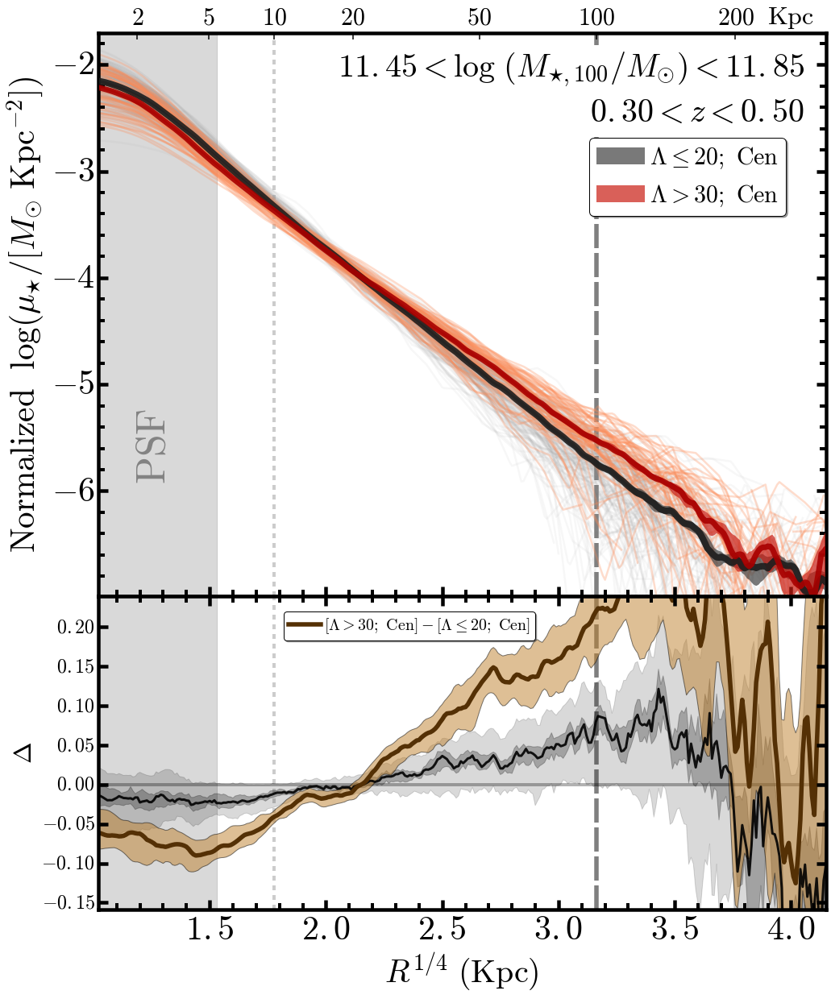

In [135]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100d), copy.deepcopy(nonbcgProfM100d)
mass1, mass2, z1, z2, lamLimit = 11.45, 11.85, 0.3, 0.5, 20.0
outPng = sampleM100d + '_norm1'
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
norm, integrate, normR1 = True, True, 100.0
ymin, ymax = -6.99, -1.7 
dmin, dmax = -0.159, 0.239
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
print(len(profSample2))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 90.0)])) < 4.5:
        del profSample1[jj]
print(len(profSample1))

pFig1d = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=True, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

## Profiles for logM_10 Matched Samples

### logM_10 matched; Sample 1; Not Normalized

42
34
34
34
# Sample1:  10.8703092953
# Sample2:  10.8668377717


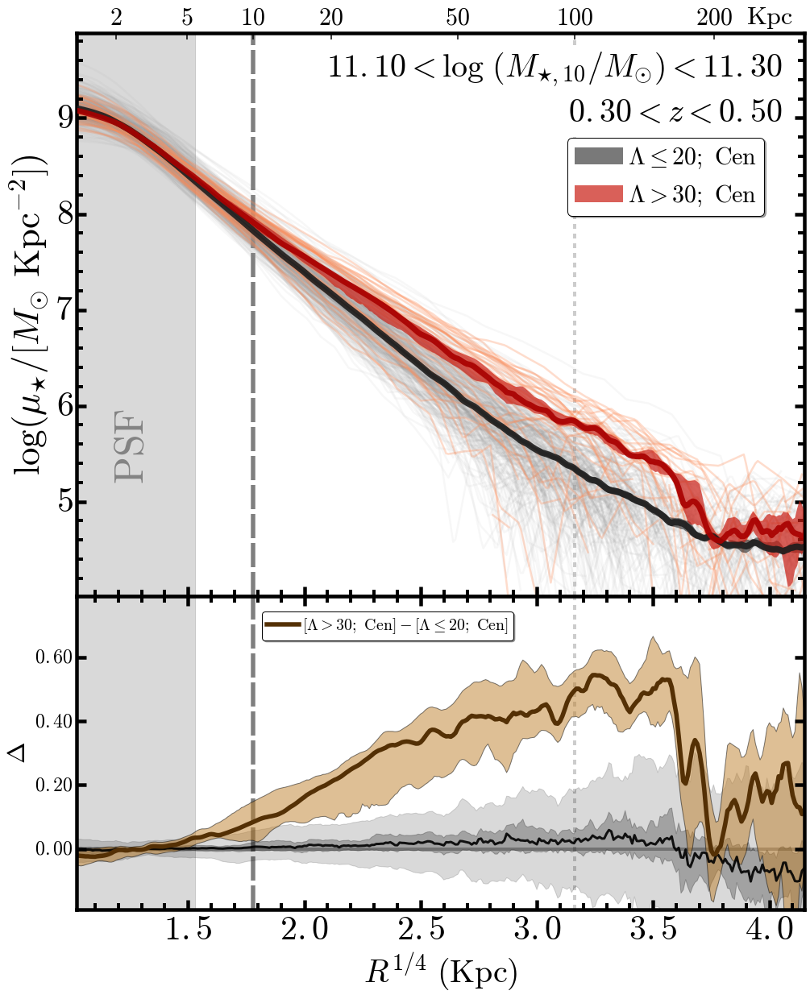

In [138]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10a), copy.deepcopy(nonbcgProfM10a)
mass1, mass2, z1, z2, lamLimit = 11.10, 11.30, 0.3, 0.5, 30.0
outPng = sampleM10a
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.19, 0.79
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.6:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 50.0) & (pp['rKpc'] < 60.0)])) < 4.5:
        del profSample1[jj]
print(len(profSample1))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

### logM_10 matched; Sample 1; Normalized

42
34
34
34
# Sample1:  -0.000814594466645
# Sample2:  -0.00310715970448


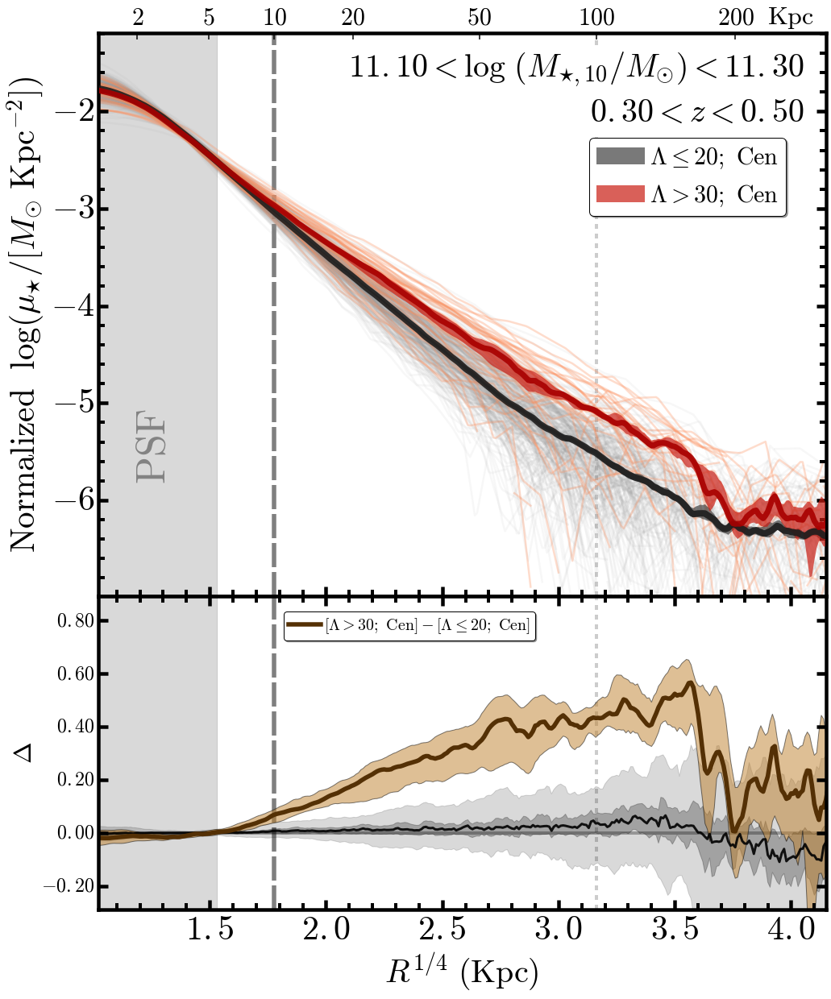

In [139]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10a), copy.deepcopy(nonbcgProfM10a)
mass1, mass2, z1, z2, lamLimit = 11.10, 11.30, 0.3, 0.5, 30.0
outPng = sampleM10a + '_norm1'
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = -6.99, -1.19 
norm, integrate, normR1 = True, True, 10.0
dmin, dmax = -0.29, 0.89
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.6:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 55.0) & (pp['rKpc'] < 70.0)])) < 4.7:
        del profSample1[jj]
print(len(profSample1))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

### logM_10 matched; Sample 2;  Not Normalized

21
15
15
15
# Sample1:  11.0293540553
# Sample2:  11.0031887666


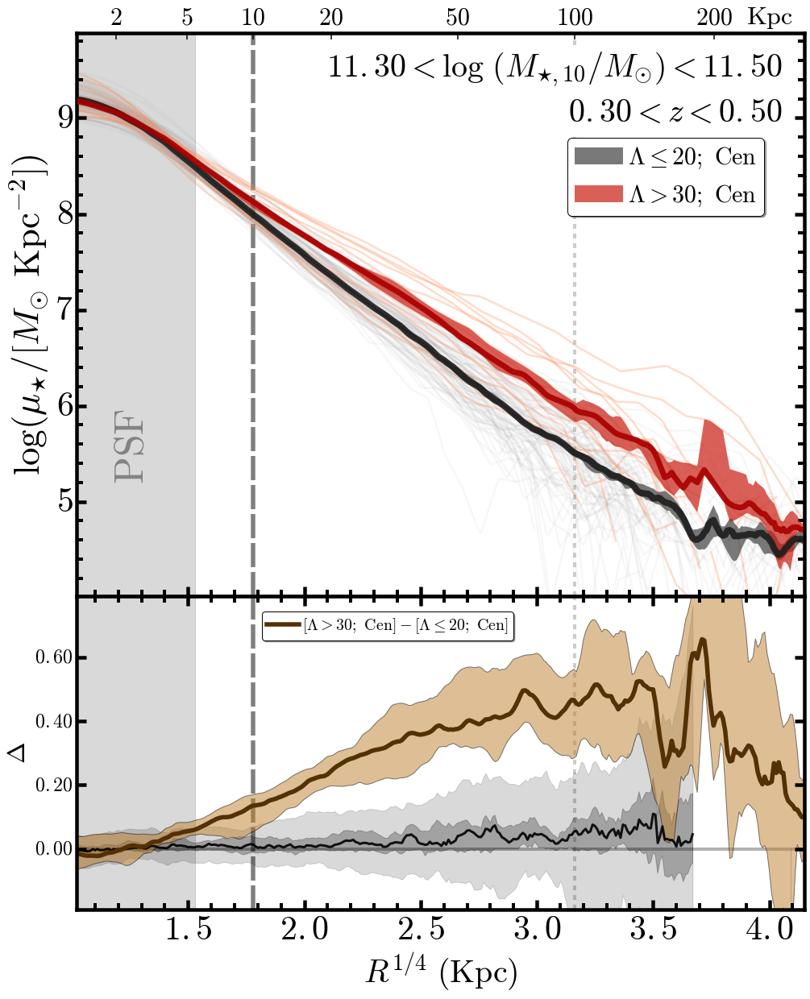

In [140]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10b), copy.deepcopy(nonbcgProfM10b)
mass1, mass2, z1, z2, lamLimit = 11.30, 11.50, 0.3, 0.5, 30.0
outPng = sampleM10b
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.19, 0.79
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.6:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 55.0) & (pp['rKpc'] < 70.0)])) < 4.7:
        del profSample1[jj]
print(len(profSample1))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

### logM_10 matched; Sample 2;  Normalized

21
15
15
15
# Sample1:  -0.00365358875081
# Sample2:  -0.00285772859628


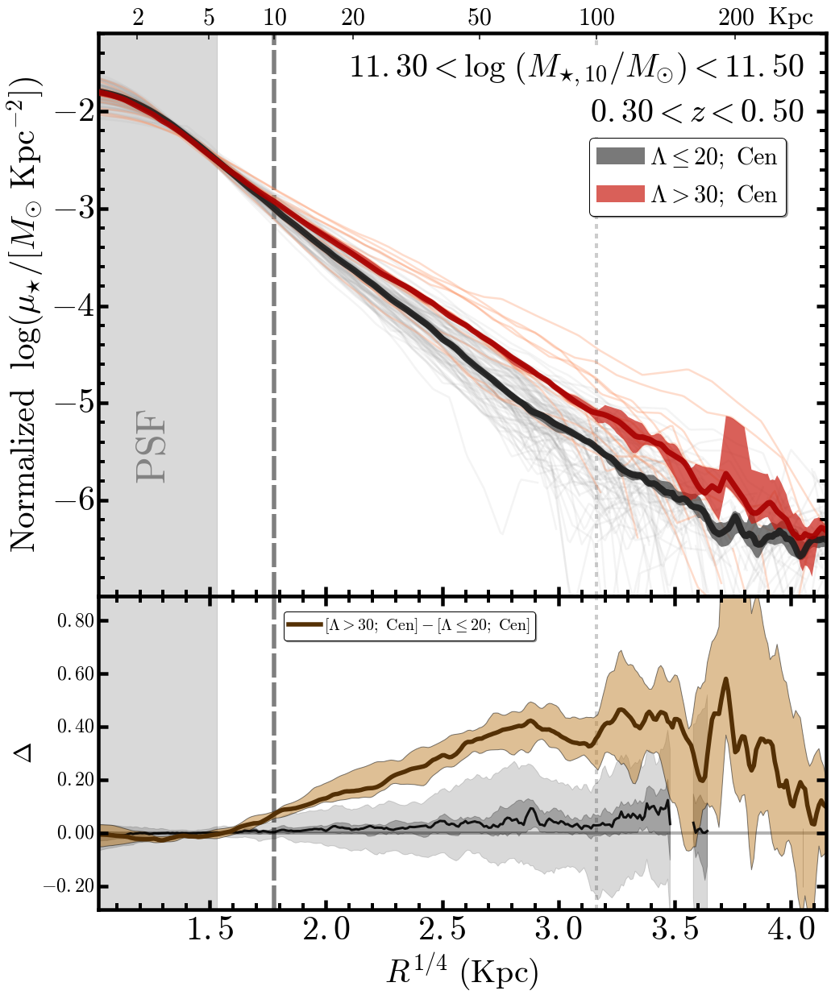

In [141]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10b), copy.deepcopy(nonbcgProfM10b)
mass1, mass2, z1, z2, lamLimit = 11.30, 11.50, 0.3, 0.5, 30.0
outPng = sampleM10b + '_norm1'
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = -6.99, -1.19 
norm, integrate, normR1 = True, True, 10.0
dmin, dmax = -0.29, 0.89
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.6:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 55.0) & (pp['rKpc'] < 70.0)])) < 4.7:
        del profSample1[jj]
print(len(profSample1))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.10, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

### logM_10 matched; Full Sample;  Not Normalized

63
48
48
48
# Sample1:  10.9184127584
# Sample2:  10.9014952292


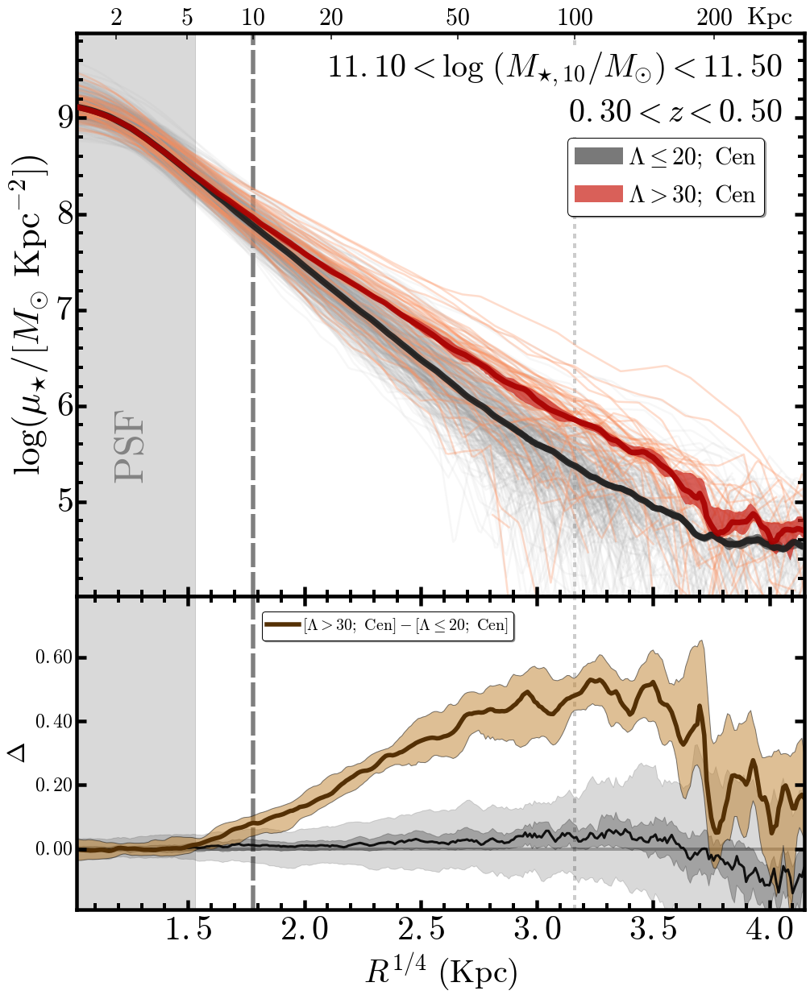

In [142]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10c), copy.deepcopy(nonbcgProfM10c)
mass1, mass2, z1, z2, lamLimit = 11.10, 11.50, 0.3, 0.5, 30.0
outPng = sampleM10c
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.19, 0.79
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.6:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 55.0) & (pp['rKpc'] < 70.0)])) < 4.7:
        del profSample1[jj]
print(len(profSample1))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

### logM_10 matched; Full Sample;  Normalized

63
48
48
48
# Sample1:  -0.00316382399909
# Sample2:  -0.00327676910322


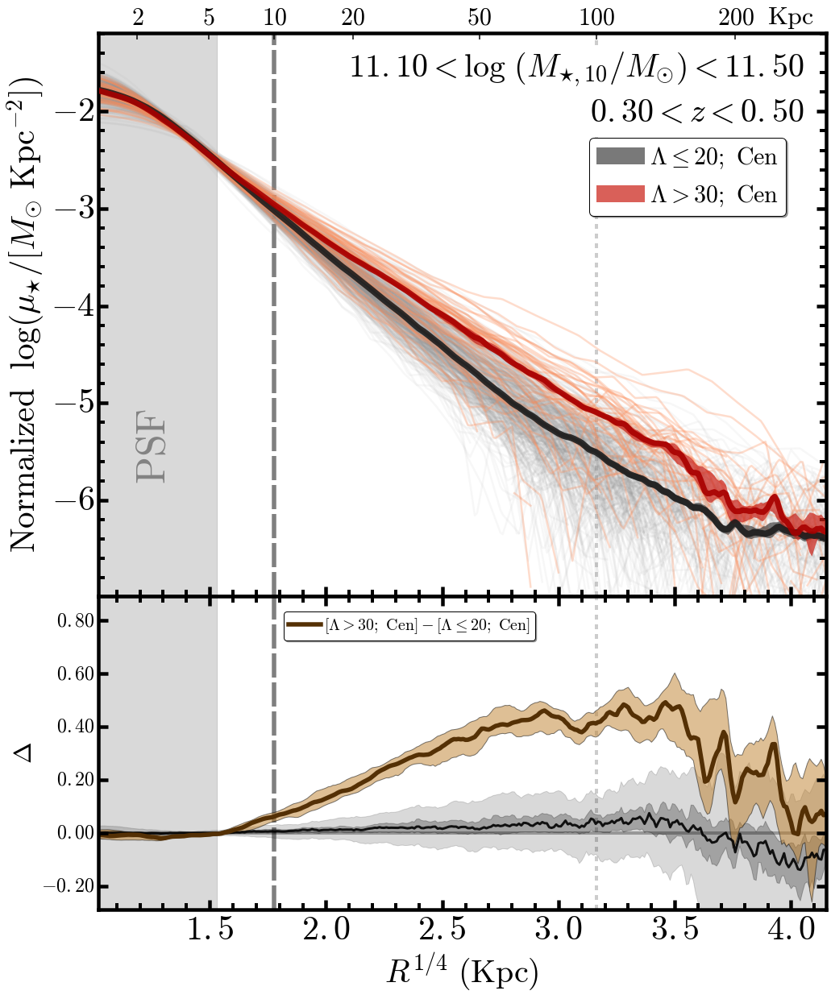

In [143]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10c), copy.deepcopy(nonbcgProfM10c)
mass1, mass2, z1, z2, lamLimit = 11.10, 11.50, 0.3, 0.5, 30.0
outPng = sampleM10c + '_norm1'
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = -6.99, -1.19 
norm, integrate, normR1 = True, True, 10.0
dmin, dmax = -0.29, 0.89
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.6:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 55.0) & (pp['rKpc'] < 70.0)])) < 4.7:
        del profSample1[jj]
print(len(profSample1))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

### logM_10 matched; Strict sample

56
43
43
43
# Sample1:  11.042500286
# Sample2:  11.0230267049


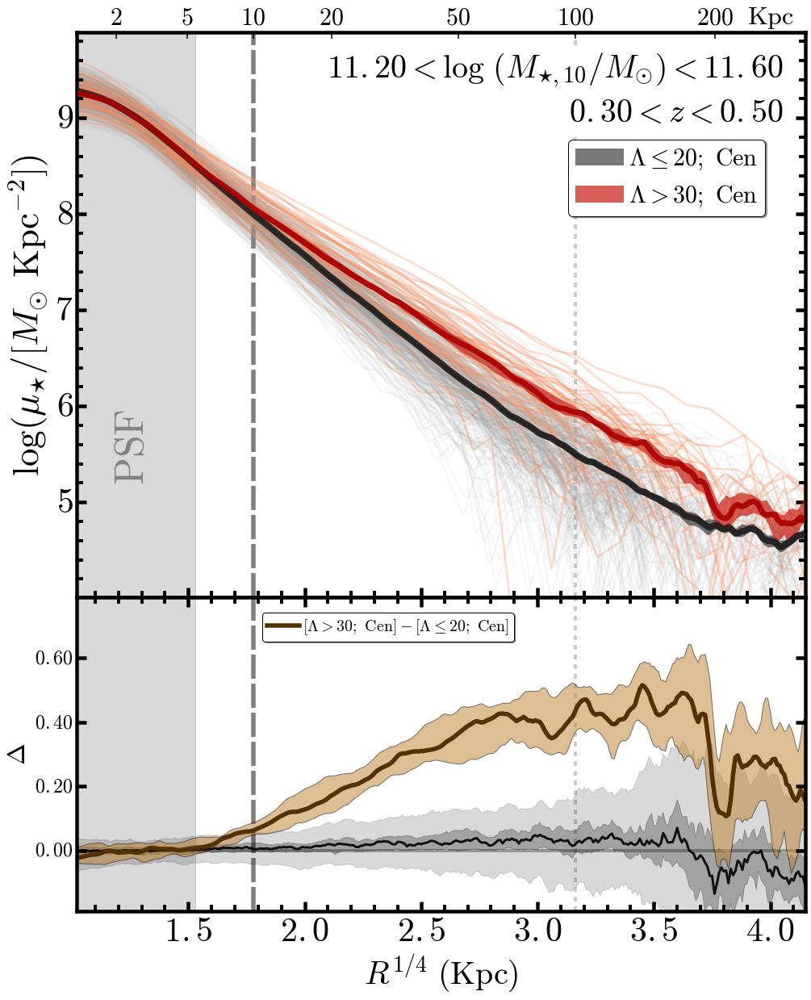

In [278]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10f), copy.deepcopy(nonbcgProfM10f)
mass1, mass2, z1, z2, lamLimit = 11.10, 11.50, 0.3, 0.5, 30.0
outPng = sampleM10f
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.19, 0.79
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.6:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 55.0) & (pp['rKpc'] < 70.0)])) < 4.7:
        del profSample1[jj]
print(len(profSample1))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%2d}$',
                         ytickFormat2='$\mathrm{%4.2f}$')

## Profile comparison between redMem and nonBCG 

55
54
51
319
319
302
# Sample1:  11.1370132889
# Sample2:  11.1512223059


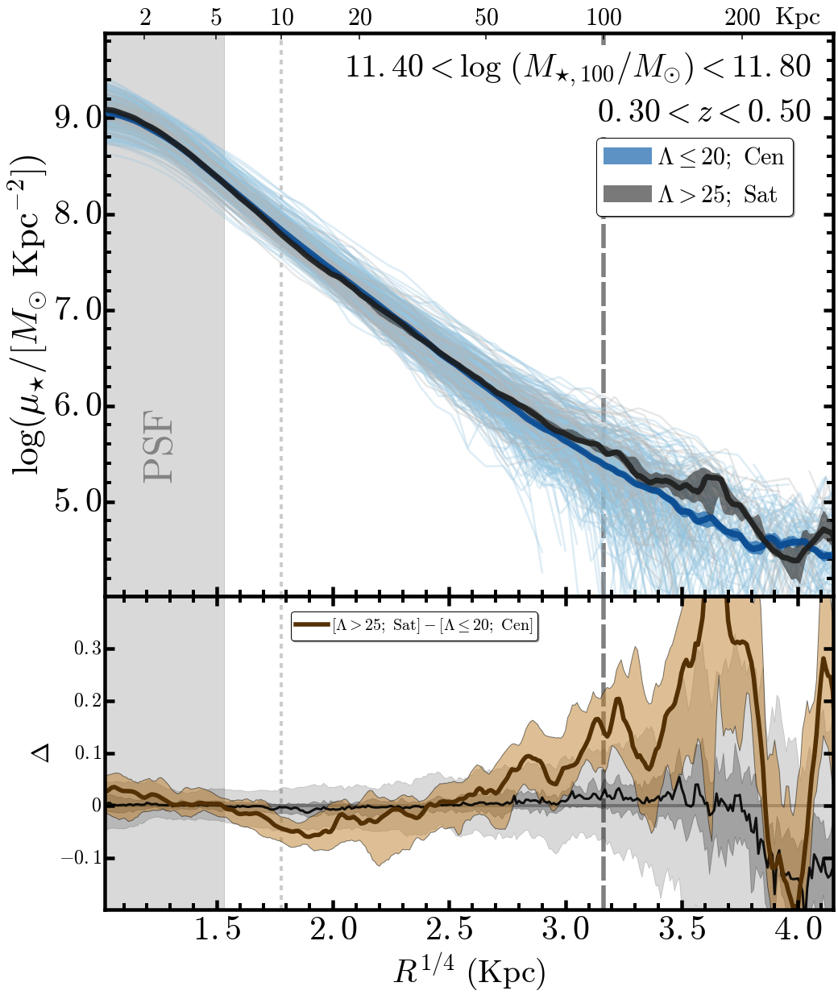

In [144]:
profSample1, profSample2 = copy.deepcopy(redmemProfM100h), copy.deepcopy(nonbcgProfM100h)
mass1, mass2, z1, z2, lamLimit = 11.40, 11.80, 0.30, 0.50, 30.0
outPng = sampleM100h
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for ii, pp in enumerate(profSample1):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 2.0) & (pp['rKpc'] < 3.0)])):
        del profSample1[ii]
print(len(profSample1))

for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 70.0) & (pp['rKpc'] < 88.0)])) <= 4.8:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for ii, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 2.0) & (pp['rKpc'] < 3.0)])):
        del profSample2[ii]
print(len(profSample2))

for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 70.0) & (pp['rKpc'] < 88.0)])) <= 4.8:
        del profSample2[jj]
print(len(profSample2))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.30, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         color2a=BLK(0.4), color2b=BLK(0.7), cmap2=BLK, 
                         color1a=BLU(0.4), color1b=BLU(0.7), cmap1=BLU, 
                         label1="$\lambda \leq 20;\ \mathrm{Cen}$", 
                         label2="$\lambda > 25;\ \mathrm{Sat}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$')

74
73
66
324
324
288
# Sample1:  11.0898492705
# Sample2:  11.088704062


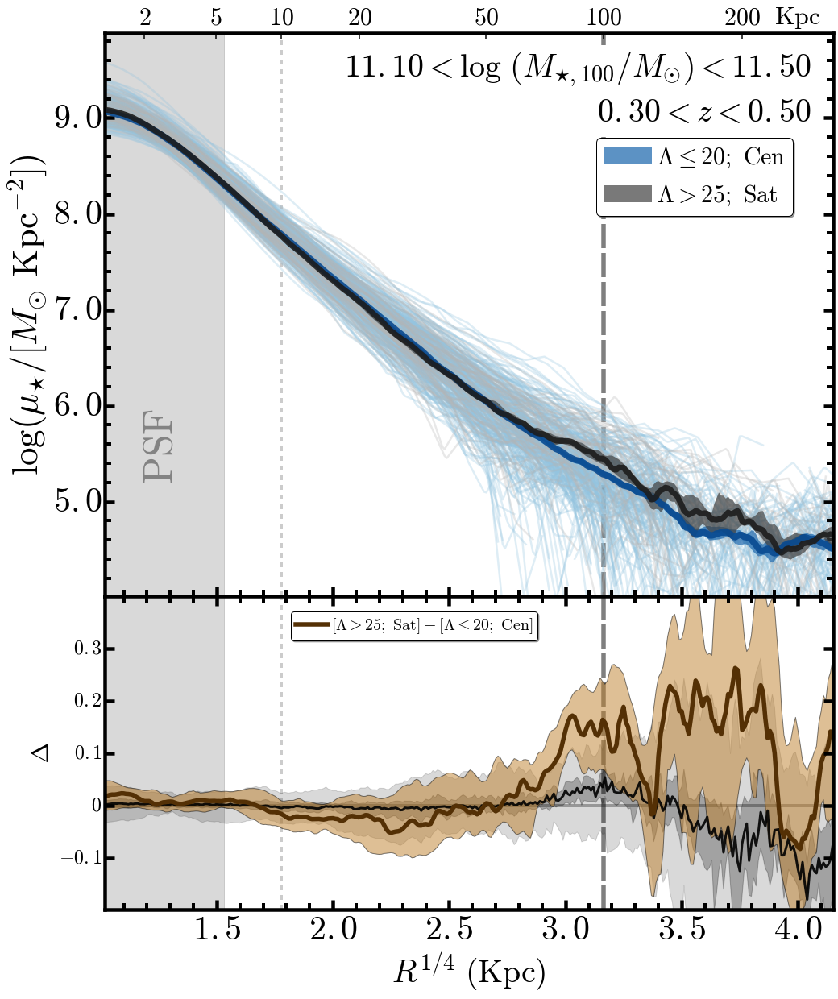

In [145]:
profSample1, profSample2 = copy.deepcopy(redmemProfM10h), copy.deepcopy(nonbcgProfM10h)
mass1, mass2, z1, z2, lamLimit = 11.10, 11.50, 0.30, 0.50, 30.0
outPng = sampleM10h
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for ii, pp in enumerate(profSample1):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 2.0) & (pp['rKpc'] < 3.0)])):
        del profSample1[ii]
print(len(profSample1))

for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 70.0) & (pp['rKpc'] < 88.0)])) <= 4.8:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for ii, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 2.0) & (pp['rKpc'] < 3.0)])):
        del profSample2[ii]
print(len(profSample2))

for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 70.0) & (pp['rKpc'] < 88.0)])) <= 4.8:
        del profSample2[jj]
print(len(profSample2))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.30, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         color2a=BLK(0.4), color2b=BLK(0.7), cmap2=BLK, 
                         color1a=BLU(0.4), color1b=BLU(0.7), cmap1=BLU, 
                         label1="$\lambda \leq 20;\ \mathrm{Cen}$", 
                         label2="$\lambda > 25;\ \mathrm{Sat}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$')

## Samples matched on logMs_GAMA

# Sample1:  11.2414300158
# Sample2:  11.1559898533


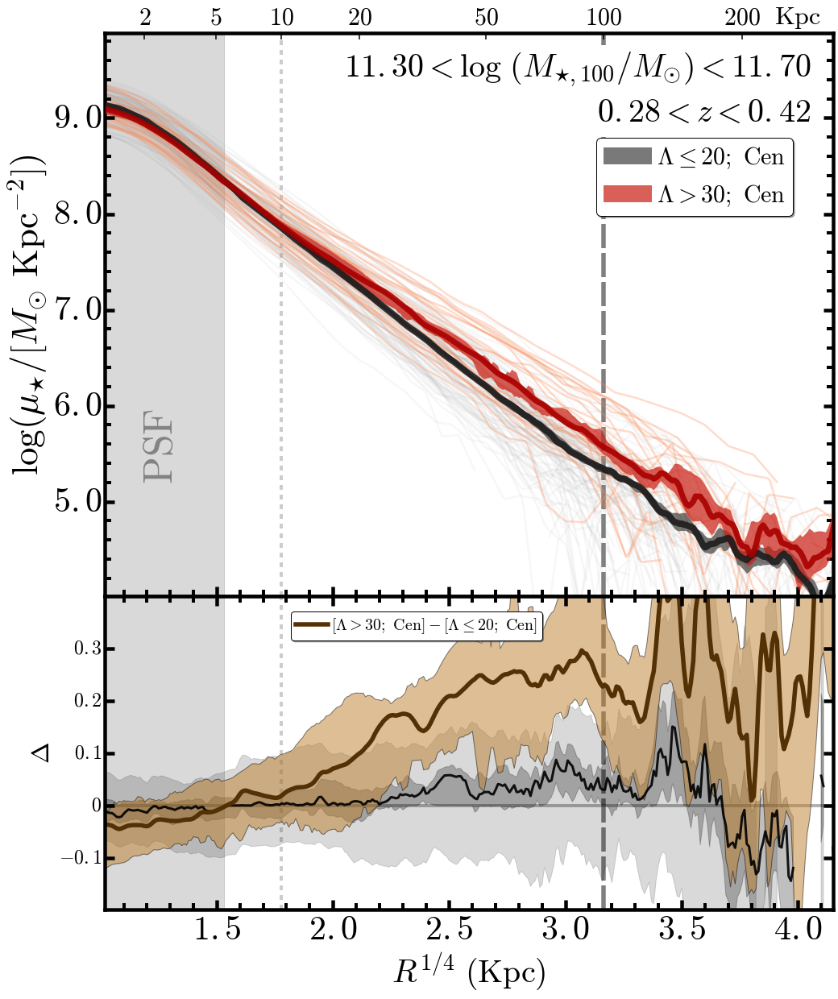

In [146]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100i), copy.deepcopy(nonbcgProfM100i)
mass1, mass2, z1, z2, lamLimit = 11.30, 11.70, 0.28, 0.42, 20.0
outPng = sampleM100i
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$')

# Comparison of Ellipticity and Color Profiles

## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:221: RuntimeWarning: invalid value encountered in subtract


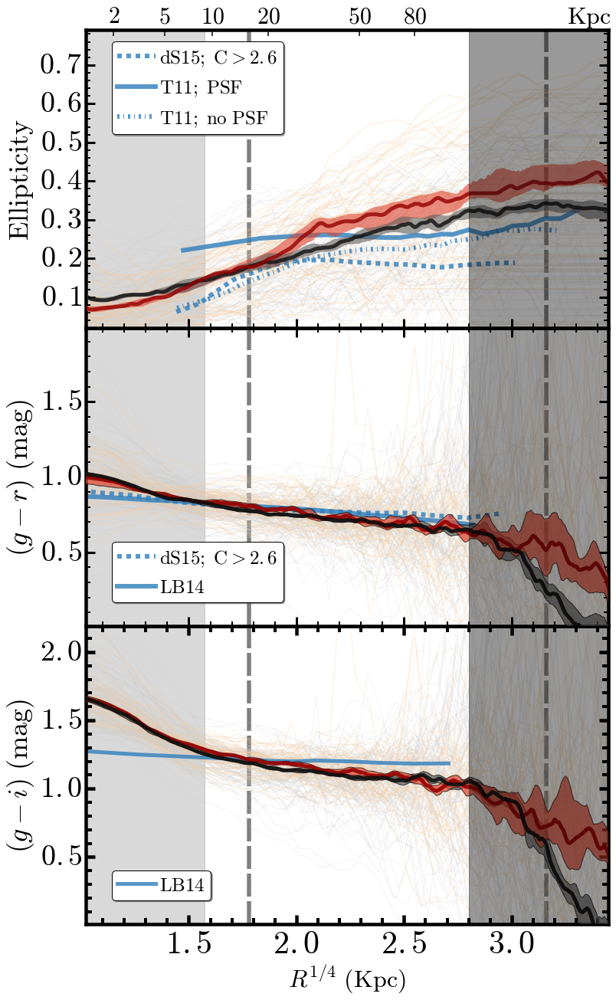

In [147]:
"""
def plotEllColorProfile(profSample1, profSample2, 
                        col1='muI1', col2='LOGM2LI', matchR=100.0,
                        norm=False, integrate=False, divide=True, 
                        normR1=10.0, normR2=12.0, 
                        diffColor1=RED0, diffColor2=RED1, showLMask=False, 
                        xmin=1.02, xmax=4.25, ymin=4.01, ymax=9.79,
                        dmin=-0.199, dmax=0.399,
                        vline1=10.0, vline2=100.0, alpha1=0.20, alpha2=0.50,
                        lw1=2.5, lw2=2.5, 
                        highlight1=False, highlight2=True, lamLimit=30, 
                        mass1=11.55, mass2=11.95, z1=0.2, z2=0.5,
                        label1="$\lambda \leq 20;\ \mathrm{Cen}$", 
                        label2="$\lambda > 30;\ \mathrm{Cen}$",
                        showInfo1=True, showInfo2=True, showLegend=True, 
                        rPsfKpc=5.5, kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0], 
                        save=True, outPng='mass_prof', figDir=None,
                        color1a=BLK(0.5), color1b=BLK(0.7), cmap1=BLK, 
                        color2a=ORG(0.5), color2b=ORG(0.7), cmap2=ORG,
                        xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                        ytickFormat2='$\mathbf{%g}$', showMean=True):
"""
#-------------------------------------------------------------------------------#
profSample1, profSample2 = nonbcgProfM100c, redbcgProfM100c
outPng = sampleM100c
figDir = figDir
save = True
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin1, ymax1 = 0.02, 0.79
ymin2, ymax2 = 0.01, 1.99
ymin3, ymax3 = 0.09, 2.19
norm, integrate, normR1 = False, False, 10.0
rsma0 = 1.02
rsma1 = 3.45
#-------------------------------------------------------------------------------#
indEll1, indEll2 = 0.9, 3.8
indColor1, indColor2 = 0.9, 3.9
colG, colR, colI, colZ = 'muG1', 'muR1', 'muI1', 'muZ1'
colEll = 'ell'
xtickFormat, ytickFormat, ytickFormat2 = '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$'
highlight1, highlight2 = True, True
vline1, vline2 = 10.0, 100.0
rPsfKpc = 6.1
cmap1, cmap2, cmap3 = BLK, ORG, BLU
alpha1, alpha2 = 0.2, 0.2
compareOthers = True
kpcArr = [2.0, 5.0, 10.0, 20.0, 50.0, 80.0]
showLegend = True
xLegend1, yLegend1 = 0.05, 0.65
xLegend2, yLegend2 = 0.05, 0.08
xLegend3, yLegend3 = 0.05, 0.09
#-------------------------------------------------------------------------------#

#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= indEll1)[0], 
                          np.where(RSMA_COMMON <= indEll2)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(profSample1, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(profSample2, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= indColor1)[0], 
                         np.where(RSMA_COMMON <= indColor2)[0])

#### g-i color ####
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(profSample1, 
                                             col1=colG, col2=colI, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=SUN_G, sun2=SUN_I,
                                             index=indColor)
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(profSample2, 
                                             col1=colG, col2=colI, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=SUN_G, sun2=SUN_I, 
                                             index=indColor)

#### g-r color ####
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(profSample1, 
                                             col1=colG, col2=colR, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=SUN_G, sun2=SUN_R,
                                             index=indColor)
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(profSample2, 
                                             col1=colG, col2=colR, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=SUN_G, sun2=SUN_R, 
                                             index=indColor)

#### g-z color ####
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(profSample1, 
                                             col1=colG, col2=colZ, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=SUN_G, sun2=SUN_Z,
                                             index=indColor)
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(profSample2, 
                                             col1=colG, col2=colZ, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=SUN_G, sun2=SUN_Z, 
                                             index=indColor)

# --------------------------------------------------------------------------------------- #
## Setup up figure
fig = plt.figure(figsize=(11, 18))
ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)
ax1 = songPlotSetup(ax1, ylabel=38, xlabel=42, xtickFormat=xtickFormat, ytickFormat=ytickFormat)
ax2 = songPlotSetup(ax2, ylabel=38, xlabel=42, xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
ax3 = songPlotSetup(ax3, ylabel=38, xlabel=42, xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
# ELLIPTICITY PLOT
# --------------------------------------------------------------------------------------- #
## Horiozontal 0.0 line
ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax1 - ymin1) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 c='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax1.fill_between([2.8, 4.15], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 c='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=cmap2(0.3), alpha=alpha2, linewidth=1.8)
    else:
        np.delete(bm_se, j)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 c=cmap2(0.7), edgecolor='none', alpha=0.6, zorder=5)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 c=cmap1(0.7), edgecolor='none', alpha=0.6, zorder=6)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=cmap1(0.95), alpha=0.8, zorder=7)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=cmap2(0.95), alpha=0.8, zorder=8)
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
             c=cmap3(0.7), linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
    ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
    ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
             c=cmap3(0.7), linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')
# --------------------------------------------------------------------------------------- #
## Legend
ax1.legend(loc=(xLegend1, yLegend1), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)
# --------------------------------------------------------------------------------------- #
## Label
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)
# --------------------------------------------------------------------------------------- #
## X, Y, Limit
ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(ymin1, ymax1)
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(xmin, xmax)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1b.text(0.92, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)

# --------------------------------------------------------------------------------------- #
# G-R COLOR PLOT
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax2 - ymin2) / 5.0
ax2.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax2 + ySep, ymax2 + ySep], 
                 c='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax2.fill_between([2.8, 4.15], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax2 + ySep, ymax2 + ySep], 
                 c='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax2.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax2.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax2.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax2.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indColor], ggr, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indColor], bgr, c=cmap2(0.3), alpha=alpha2, linewidth=1.5)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indColor], gm_low, gm_upp, 
                 c=cmap1(0.7), alpha=0.7, zorder=5)
ax2.fill_between(RSMA_COMMON[indColor], bm_low, bm_upp, 
                 c=cmap2(0.7), alpha=0.7, zorder=6)
                 
ax2.plot(RSMA_COMMON[indColor], bm_med, linestyle='-', linewidth=5.0, 
         c=cmap2(0.95), alpha=0.9, zorder=7)
ax2.plot(RSMA_COMMON[indColor], gm_med, linestyle='-', linewidth=5.0, 
         c=cmap1(0.95), alpha=0.9, zorder=8)
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
             c=cmap3(0.7), linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
    ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')
# --------------------------------------------------------------------------------------- #
## Legend
ax2.legend(loc=(xLegend2, yLegend2), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# --------------------------------------------------------------------------------------- #
## Label
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(ymin2, ymax2)
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

# --------------------------------------------------------------------------------------- #
# G-I COLOR PLOT
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax3 - ymin2) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax3 + ySep, ymax3 + ySep], 
                 c='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax3.fill_between([2.8, 4.15], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax3 + ySep, ymax3 + ySep], 
                 c='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indColor], ggi, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indColor], bgi, c=cmap2(0.3), alpha=alpha2, linewidth=1.5)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indColor], gm_low, gm_upp, 
                 c=cmap1(0.7), alpha=0.7, zorder=5)
ax3.fill_between(RSMA_COMMON[indColor], bm_low, bm_upp, 
                 c=cmap2(0.7), alpha=0.7, zorder=6)
                 
ax3.plot(RSMA_COMMON[indColor], bm_med, linestyle='-', linewidth=5.0, 
         c=cmap2(0.95), alpha=0.9, zorder=7)
ax3.plot(RSMA_COMMON[indColor], gm_med, linestyle='-', linewidth=5.0, 
         c=cmap1(0.95), alpha=0.9, zorder=8)
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')
# --------------------------------------------------------------------------------------- #
## Legend
ax3.legend(loc=(xLegend2, yLegend2), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)
# --------------------------------------------------------------------------------------- #
## Label
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(ymin2, ymax3)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
plt.show()

if figDir is not None:
    outPng = os.path.join(figDir, outPng)
    
if save:
    fig.savefig(outPng + '_c.pdf', dpi=160)

#return fig

# Stellar Mass Groth Curve 

138
137
135
50
50
50


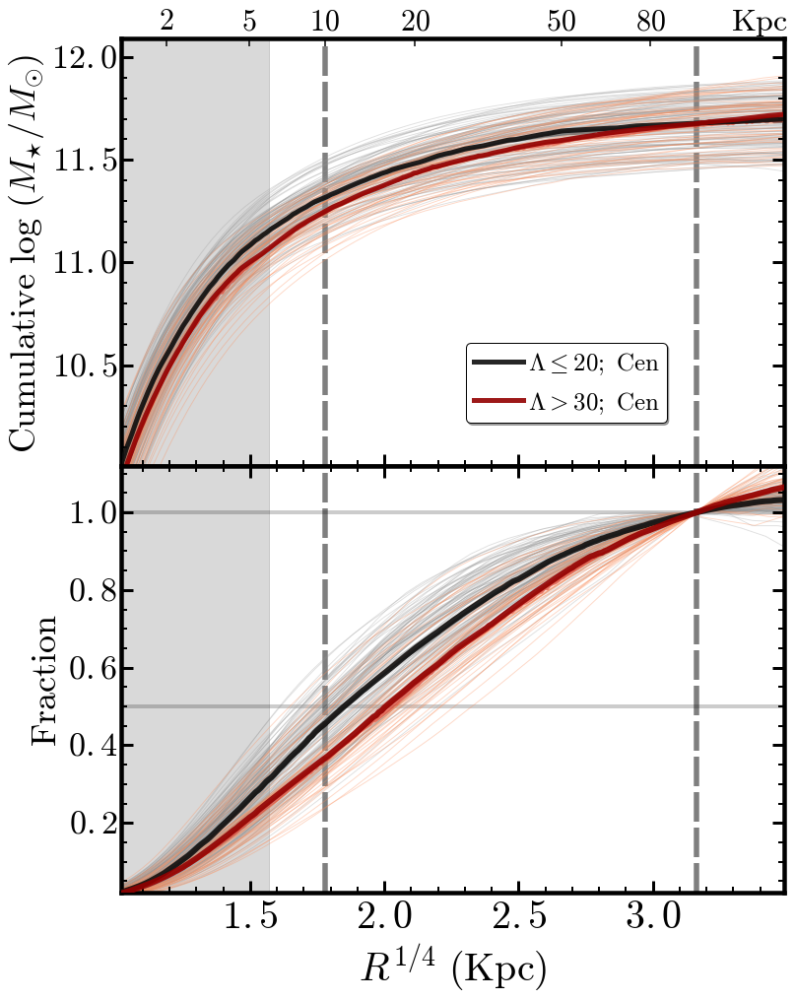

# Figure saved to : /Users/songhuang/astro4/massive/dr15b/sbp/figure/matchA_m100_bc03a_d.pdf


In [148]:
profSample1, profSample2 = copy.deepcopy(nonbcgProfM100c), copy.deepcopy(redbcgProfM100c)
outPng = sampleM100c

figDir = figDir
save = True

# --------------------------------------------------------------------------------------- #
indCoG1, indCoG2 = 0.9, 3.5
xmin, xmax =  1.02, 3.49
ymin1, ymax1 = 10.01, 12.09 
ymin2, ymax2 = 0.02, 1.12
# --------------------------------------------------------------------------------------- #
vline1, vline2 = 10.0, 100.0
hline1, hline2 = 0.5, 1.0
highlight1, highlight2 = True, True
highlight3, highlight4 = False, False 
# --------------------------------------------------------------------------------------- #
rPsfKpc = 6.1
kpcArr = [2.0, 5.0, 10.0, 20.0, 50.0, 80.0]
# --------------------------------------------------------------------------------------- #
showLegend = True
xLegend, yLegend = 0.52, 0.10
label1, label2 = '$\lambda \leq 20;\ \mathrm{Cen}$', '$\lambda > 30;\ \mathrm{Cen}$'
xtickFormat, ytickFormat, ytickFormat2 = '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$'
cmap1, cmap2, cmap3 = BLK, ORG, BLU
alpha1, alpha2 = 0.3, 0.35
# --------------------------------------------------------------------------------------- #

print(len(profSample1))
for ii, pp in enumerate(profSample1):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 2.0) & (pp['rKpc'] < 3.0)])):
        del profSample1[ii]
print(len(profSample1))

for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 70.0) & (pp['rKpc'] < 88.0)])) <= 4.8:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for ii, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 2.0) & (pp['rKpc'] < 3.0)])):
        del profSample2[ii]
print(len(profSample2))

for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 70.0) & (pp['rKpc'] < 88.0)])) <= 4.8:
        del profSample2[jj]
print(len(profSample2))


# --------------------------------------------------------------------------------------- #
indCoG = np.intersect1d(np.where(RSMA_COMMON >= indCoG1)[0], 
                        np.where(RSMA_COMMON <= indCoG2)[0])
## Stellar mass curve of growth
cogS1a, cogM1a, cogA1a, cogD1a = organizeSbp(profSample1, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=False, 
                                             index=indCoG) 
cogS2a, cogM2a, cogA2a, cogD2a = organizeSbp(profSample2, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=False,
                                             index=indCoG) 
## Normalized fraction
cogS1b, cogM1b, cogA1b, cogD1b = organizeSbp(profSample1, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=True, col3='LOGM_100', 
                                             index=indCoG) 
cogS2b, cogM2b, cogA2b, cogD2b = organizeSbp(profSample2, col1='lumI1', col2='LOGM2LI', 
                                             kind='cog', norm=True, col3='LOGM_100',
                                             index=indCoG) 

# --------------------------------------------------------------------------------------- #
## Setup the plot
fig = plt.figure(figsize=(11, 14))
fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax1 = plt.axes(COG2)
ax2 = plt.axes(COG1)

ax1 = songPlotSetup(ax1, ylabel=34, xlabel=40, xtickFormat=xtickFormat, 
                    ytickFormat=ytickFormat)
ax2 = songPlotSetup(ax2, ylabel=34, xlabel=40, xtickFormat=xtickFormat, 
                    ytickFormat=ytickFormat)

# --------------------------------------------------------------------------------------- #
# Fig. A: Stellar mass curve of growth

## Mark the two interesting radius
if vline1 is not None:
    if highlight1:
        ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
if vline2 is not None:
    if highlight2:
        ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)

# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax1 - ymin1) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 c='k', edgecolor='k', alpha=0.15, zorder=0)
# --------------------------------------------------------------------------------------- #
## Individual plots
for cog1 in cogS1a:
    ax1.plot(RSMA_COMMON[indCoG], cog1, c=cmap1(0.5), alpha=alpha1, 
             linewidth=0.9)
for cog2 in cogS2a:
    ax1.plot(RSMA_COMMON[indCoG], cog2, c=cmap2(0.5), alpha=alpha2, 
             linewidth=0.9)
    
## Median profiles
ax1.fill_between(RSMA_COMMON[indCoG], cogM1a[0], cogM1a[2], 
                 c=cmap1(0.7), alpha=0.7, zorder=6, edgecolor='none')
ax1.fill_between(RSMA_COMMON[indCoG], cogM2a[0], cogM2a[2], 
                 c=cmap2(0.7), alpha=0.7, zorder=6, edgecolor='none')
                 
ax1.plot(RSMA_COMMON[indCoG], cogM1a[2], linestyle='-', linewidth=5.0, 
         c=cmap1(0.95), alpha=0.9, zorder=7, 
         label=label1)
ax1.plot(RSMA_COMMON[indCoG], cogM2a[2], linestyle='-', linewidth=5.0, 
         c=cmap2(0.95), alpha=0.9, zorder=7,
         label=label2)


# --------------------------------------------------------------------------------------- #
## X, Y, Limit
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin1, ymax1)

# --------------------------------------------------------------------------------------- #
## Label
ax1.set_ylabel('$\mathrm{Cumulative\ }\log\ (M_{\star}/M_{\odot})$', size=36)
    
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax1.legend(loc=(xLegend, yLegend), shadow=True, fancybox=True, 
               numpoints=1, fontsize=25, scatterpoints=1, 
               markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(xmin, xmax)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1b.text(0.92, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)

# --------------------------------------------------------------------------------------- #
# Fig. B: Fraction of stellar mass 

## Mark the two interesting radius
if vline1 is not None:
    if highlight1:
        ax2.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax2.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
if vline2 is not None:
    if highlight2:
        ax2.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax2.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)

# --------------------------------------------------------------------------------------- #
## Mark interesting fraction
if hline1 is not None:
    if highlight3:
        ax2.axhline(hline1, linewidth=5.5, c='k', linestyle='-', 
                    zorder=0, alpha=0.5)
    else:
        ax2.axhline(hline1, linewidth=4.0, c='k', linestyle='-', 
                    zorder=0, alpha=0.2)
if hline2 is not None:
    if highlight4:
        ax2.axhline(hline2, linewidth=5.5, c='k', linestyle='-', 
                    zorder=0, alpha=0.5)
    else:
        ax2.axhline(hline2, linewidth=4.0, c='k', linestyle='-', 
                    zorder=0, alpha=0.2)
    
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax2 - ymin2) / 5.0
ax2.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax2 + ySep, ymax2 + ySep], 
                 c='k', edgecolor='k', alpha=0.15, zorder=0)
# --------------------------------------------------------------------------------------- #
## Individual plots
for cog1 in cogS1b:
    ax2.plot(RSMA_COMMON[indCoG], (10.0 ** cog1), c=cmap1(0.5), alpha=alpha1, 
             linewidth=0.9)
for cog2 in cogS2b:
    ax2.plot(RSMA_COMMON[indCoG], (10.0 ** cog2), c=cmap2(0.5), alpha=alpha2, 
             linewidth=0.9)
    
## Median profiles
ax2.fill_between(RSMA_COMMON[indCoG], 10.0 ** cogM1b[0], 10.0 ** cogM1b[2], 
                 c=cmap1(0.7), alpha=0.7, zorder=6, edgecolor='none')
ax2.fill_between(RSMA_COMMON[indCoG], 10.0 ** cogM2b[0], 10.0 ** cogM2b[2], 
                 c=cmap2(0.7), alpha=0.7, zorder=6, edgecolor='none')
                 
ax2.plot(RSMA_COMMON[indCoG], 10.0 ** cogM1b[2], linestyle='-', linewidth=6.0, 
         c=cmap1(0.95), alpha=0.9, zorder=7)
ax2.plot(RSMA_COMMON[indCoG], 10.0 ** cogM2b[2], linestyle='-', linewidth=6.0, 
         c=cmap2(0.95), alpha=0.9, zorder=7)

# --------------------------------------------------------------------------------------- #
## X, Y, Limit
ax2.set_xlim(xmin, xmax)
ax2.set_ylim(ymin2, ymax2)
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

# --------------------------------------------------------------------------------------- #
## Label
ax2.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=40)
ax2.set_ylabel('$\mathrm{Fraction}$', size=36)

# --------------------------------------------------------------------------------------- #
plt.show()

if figDir is not None:
    outPng = os.path.join(figDir, outPng)
if save:
    fig.savefig(outPng + '_d.pdf', dpi=160)
    print("# Figure saved to : %s" % outPng + '_d.pdf')

#return fig